# Aprendizaje Automático I - Trabajo Práctico N°2

- Antuña, Franco (A-4637/1)
- Asad, Gonzalo (A-4595/1)
- Castells, Sergio (C-7334/2)

## Descripción del dataset

El dataset contiene información climática de Australia de los últimos años, incluyendo si para el día siguiente llovió o no en la columna 'RainTomorrow'. El contenido de cada columna se describe a continuación:

* Date: La fecha de la observación en formato YYYY-MM-DD.
* Location: La ciudad o estación meteorológica donde se realizó la observación.
* MinTemp: La temperatura mínima registrada en grados Celsius.
* MaxTemp: La temperatura máxima registrada en grados Celsius.
* Rainfall: La cantidad de lluvia registrada en milímetros.
* Evaporation: La cantidad de agua evaporada (en milímetros) en 24 horas hasta las 9 AM.
* Sunshine: El número de horas de sol registrado.
* WindGustDir: La dirección del viento más fuerte registrado durante el día.
* WindGustSpeed: La velocidad del viento más fuerte registrado en kilómetros por hora.
* WindDir9am: La dirección del viento a las 9 AM.
* WindDir3pm: La dirección del viento a las 3 PM.
* WindSpeed9am: La velocidad del viento a las 9 AM en kilómetros por hora.
* WindSpeed3pm: La velocidad del viento a las 3 PM en kilómetros por hora.
* Humidity9am: La humedad relativa a las 9 AM como porcentaje.
* Humidity3pm: La humedad relativa a las 3 PM como porcentaje.
* Pressure9am: La presión atmosférica a las 9 AM medida en hPa (hectopascales).
* Pressure3pm: La presión atmosférica a las 3 PM medida en hPa.
* Cloud9am: La fracción del cielo cubierto de nubes a las 9 AM (medido en octas: una escala de 0 a 8).
* Cloud3pm: La fracción del cielo cubierto de nubes a las 3 PM (medido en octas).
* Temp9am: La temperatura registrada a las 9 AM en grados Celsius.
* Temp3pm: La temperatura registrada a las 3 PM en grados Celsius.
* RainToday: Un valor binario (Yes/No) que indica si llovió o no en las últimas 24 horas.
* RainTomorrow: Un valor binario (Yes/No) que indica si llovió o no al día siguiente (esta es la variable objetivo para modelos predictivos).

Fuente: https://www.kaggle.com/datasets/jsphyg/weather-dataset-rattle-package

## Preparación del entorno

In [1]:
# !pip install gdown
# !pip install optuna
# !pip install pycaret
# !pip install shap

In [2]:
import gdown
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.impute import KNNImputer, SimpleImputer
from sklearn.preprocessing import RobustScaler, OneHotEncoder, LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_curve, roc_auc_score, auc
from sklearn.model_selection import cross_val_score, KFold
# import autosklearn.classification
from pycaret.classification import *
from imblearn.over_sampling import RandomOverSampler, SMOTE
import optuna
import shap
import joblib

import tensorflow as tf
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import f1_score

In [97]:
# Definir el ID del archivo
file_id = '1gH6RH6Xya2-KK089FgSOaCd6RESLWbOe'

# Crear la URL de descarga
download_url = f'https://drive.google.com/uc?id={file_id}'

# Descargar el archivo
output = 'weatherAUS.csv'
gdown.download(download_url, output, quiet=True)

'weatherAUS.csv'

In [98]:
df = pd.read_csv('weatherAUS.csv')

Elegimos 10 ciudades al azar para usar durante todo el trabajo práctico.

In [99]:
# Selecciono 10 ciudades aleatorias de la columna 'Location'
ciudades_aleatorias = df['Location'].drop_duplicates().sample(n=10, random_state=42)
# Muestro las ciudades seleccionadas
print(ciudades_aleatorias)
# Filtro el DataFrame original usando las 10 ciudades seleccionadas
df_filtrado = df[df['Location'].isin(ciudades_aleatorias)].reset_index()

39538      Williamtown
136071    AliceSprings
142304       Katherine
133031      Launceston
52062      MountGinini
80998         Dartmoor
77989         Watsonia
74980         Portland
93280       Townsville
58142          Bendigo
Name: Location, dtype: object


Eliminamos todas las filas donde la variable 'RainTomorrow' tiene valor NaN, ya que pierde el sentido tenerlas si vamos a hacer un modelo que las prediga.

In [100]:
index_NaN = df_filtrado[df_filtrado['RainTomorrow'].isna()].index
df_filtrado.drop(index_NaN, inplace=True)
df_filtrado.reset_index(drop=True, inplace=True)
df_filtrado.drop('index', axis=1, inplace=True)

Hacemos la separación del dataset entre la variable de salida 'RainTomorrow' y el resto de los datos. A estos últimos los separamos entre datasets de entrenamiento y de pruebas.

In [102]:
# Dividimos el dataset en datos de entrenamiento y de testeo
X = df_filtrado.drop('RainTomorrow', axis=1)
y = df_filtrado['RainTomorrow']

# Creamos datasets de entrenamiento y de pruebas
X_train, X_test, y_train, y_test = train_test_split(X, y.values.reshape(-1,1), test_size=0.2, random_state=42)

X_train.shape, X_test.shape, y_train.shape, y_test.shape

((22466, 22), (5617, 22), (22466, 1), (5617, 1))

## Análisis descriptivo

Observamos rápidamente el contenido del dataset de entrenamiento.

In [109]:
train_data = X_train.reset_index(drop=True)
train_data = pd.concat([train_data, pd.DataFrame(y_train, columns=['RainTomorrow'])], axis=1)
train_data.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2010-12-01,Watsonia,15.4,26.3,0.0,5.4,0.6,SE,30.0,W,...,87.0,68.0,1016.0,1013.3,7.0,7.0,18.0,22.9,No,Yes
1,2008-12-30,MountGinini,5.0,10.0,0.0,NaN,NaN,NaN,NaN,W,...,65.0,100.0,NaN,NaN,NaN,NaN,8.4,5.5,No,Yes
2,2012-09-16,Dartmoor,8.8,15.1,0.4,0.8,1.0,WSW,37.0,NW,...,100.0,78.0,1021.1,1019.5,NaN,NaN,11.6,13.9,No,No
3,2010-02-15,Dartmoor,16.1,25.2,0.4,1.6,7.8,ESE,44.0,SSE,...,87.0,65.0,1015.7,1016.0,NaN,NaN,18.8,23.5,No,No
4,2012-05-15,Dartmoor,8.8,14.9,1.4,1.2,0.6,S,22.0,NaN,...,100.0,82.0,1030.8,1028.3,NaN,NaN,10.8,14.2,Yes,No


Estudiamos el tipo de los datos.

In [110]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22466 entries, 0 to 22465
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           22466 non-null  object 
 1   Location       22466 non-null  object 
 2   MinTemp        22358 non-null  float64
 3   MaxTemp        22432 non-null  float64
 4   Rainfall       22195 non-null  float64
 5   Evaporation    14826 non-null  float64
 6   Sunshine       11635 non-null  float64
 7   WindGustDir    22048 non-null  object 
 8   WindGustSpeed  22050 non-null  float64
 9   WindDir9am     20765 non-null  object 
 10  WindDir3pm     22153 non-null  object 
 11  WindSpeed9am   22294 non-null  float64
 12  WindSpeed3pm   22307 non-null  float64
 13  Humidity9am    21900 non-null  float64
 14  Humidity3pm    21440 non-null  float64
 15  Pressure9am    19215 non-null  float64
 16  Pressure3pm    19214 non-null  float64
 17  Cloud9am       14128 non-null  float64
 18  Cloud3

Vemos que la mayoría de las variables son del tipo 'float64' a excepción de 'Date', 'Location', 'WindGustDir', 'WindDir9am', 'WindDit3pm', 'RainToday' y 'RainTomorrow', que son del tipo 'object'. Luego analizamos la existencia de datos duplicados.

In [111]:
train_data.duplicated().sum()

0

No existen datos duplicados en el dataset.

Observamos las características descriptivas del dataset.

In [112]:
train_data.describe(include='all')

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
count,22466,22466,22358.000000,22432.000000,22195.000000,14826.000000,11635.000000,22048,22050.000000,20765,...,21900.000000,21440.000000,19215.000000,19214.000000,14128.000000,13482.000000,22085.000000,21683.000000,22195,22466
unique,3040,10,NaN,NaN,NaN,NaN,NaN,16,NaN,16,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,2
top,2015-08-19,Townsville,NaN,NaN,NaN,NaN,NaN,NW,NaN,SE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,No,No
freq,10,2464,NaN,NaN,NaN,NaN,NaN,1691,NaN,1767,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17080,17218
mean,NaN,NaN,11.136976,22.308791,2.370390,5.778302,7.400791,NaN,39.852880,NaN,...,70.873516,54.038153,1016.985803,1014.563188,4.518049,4.611556,16.065216,20.630715,NaN,NaN
std,NaN,NaN,7.130376,8.464360,8.432189,4.505051,3.904221,NaN,13.066766,NaN,...,21.599808,22.324861,7.222081,7.303454,2.942374,2.763651,7.719187,8.163236,NaN,NaN
min,NaN,NaN,-8.200000,-4.800000,0.000000,0.000000,0.000000,NaN,7.000000,NaN,...,1.000000,1.000000,985.000000,980.200000,0.000000,0.000000,-7.200000,-5.400000,NaN,NaN
25%,NaN,NaN,6.100000,15.800000,0.000000,2.600000,4.300000,NaN,31.000000,NaN,...,59.000000,39.000000,1012.200000,1009.600000,1.000000,2.000000,10.600000,14.500000,NaN,NaN
50%,NaN,NaN,10.400000,21.500000,0.000000,5.200000,8.200000,NaN,39.000000,NaN,...,73.000000,55.000000,1017.000000,1014.500000,5.000000,5.000000,15.000000,19.800000,NaN,NaN
75%,NaN,NaN,15.800000,28.900000,0.800000,8.000000,10.600000,NaN,46.000000,NaN,...,89.000000,69.000000,1021.700000,1019.500000,7.000000,7.000000,21.700000,26.700000,NaN,NaN


A simple vista, se detectan cosas extrañas como la variable 'Rainfall', donde el Q3 = 0.8, mientras que su variable máxima es 236.8 dando a entender que tiene un sesgo. Algo similar al caso anterior ocurre con la variable 'Evaporation'. Vemos que en todas las variables numéricas, su media se encuentra bastante cercana a su mediana, haciendo parecer que se encuentran bastante balanceadas.
Estas hipótesis serán comprobadas más adelante, durante el análisis visual exploratorio.

## Análisis exploratorio

Filtramos las variables del tipo Object.

In [104]:
non_categoric_cols = train_data.select_dtypes(exclude='object').columns

Para evitar mensajes asociados a cambios planeados en futuras versiones de las librerías en uso, hacemos uso de la función 'filterwarnings'.

In [105]:
warnings.filterwarnings('ignore', category=FutureWarning)

Graficamos los diagramas de caja y bigotes junto con los histogramas de cada variable numérica.

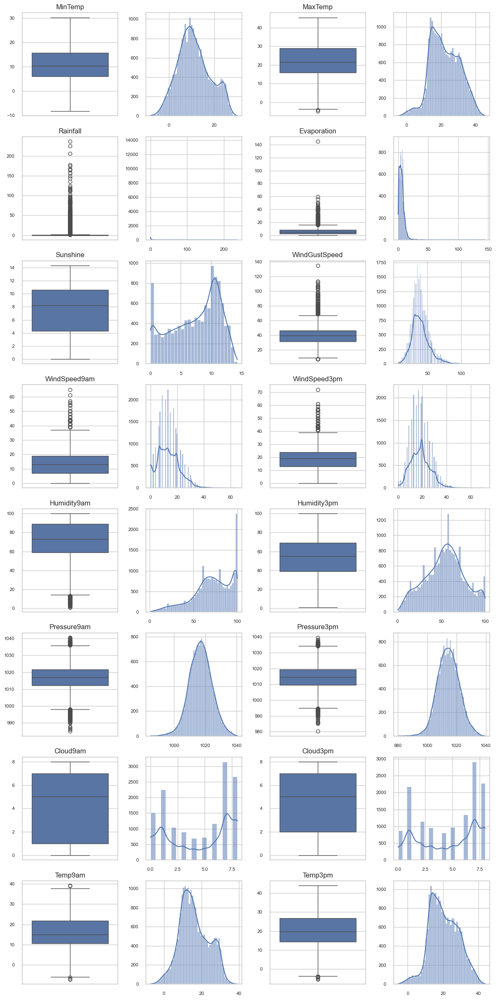

In [106]:
# Crear diagrama de caja individual para cada variable
plt.figure(figsize=(12, 24))
idx = 0
for column in non_categoric_cols:
    # Boxplot
    plt.subplot(8, 4, idx+1)
    sns.boxplot(data = train_data[column])
    plt.title(column)
    plt.ylabel('')
    plt.xticks([])
    plt.yticks(fontsize=8)

    # Distplot
    plt.subplot(8, 4, idx+2)
    sns.histplot(data=train_data, x=column, kde=True)
    plt.xlabel('')
    plt.ylabel('')
    plt.xticks(fontsize=8)
    plt.yticks(fontsize=8)

    idx += 2

plt.tight_layout()
plt.show()

Observamos que hay muchos comportamientos diferentes entre las variables:
*   Las variables "Pressure9am" y "Pressure3pm" poseen una distribución bastante simétrica.Tienen una forma campanular aunque con la información provista arriba no podemos asegurar que su distribución sea normal.
*   Las variables "Temp9am", "Temp3pm", "MaxTemp", "MinTemp", "Rainfall", "Evaporation", "WindGustSpeed", "WindSpeed9am" y "WindSpeed3pm" tienen distribuciones con diferentes sesgos hacia la izquierda o derecha. Casos a destacar son las variables 'Rainfall' y 'Evaporation', donde sus sesgos son mucho más fuertes que en el resto de las variables.
*   El resto de las variables poseen más de una moda, como ocurre con las variables 'Sunshine', 'Cloud9am' y 'Cloud3pm'.

Hay presencia de outliers en la mayoría de las variables, pero en la mayoría de los casos parece desprenderse del comportamiento natural del clima.

Graficamos las dispersiones entre todos los pares de variables numéricas.

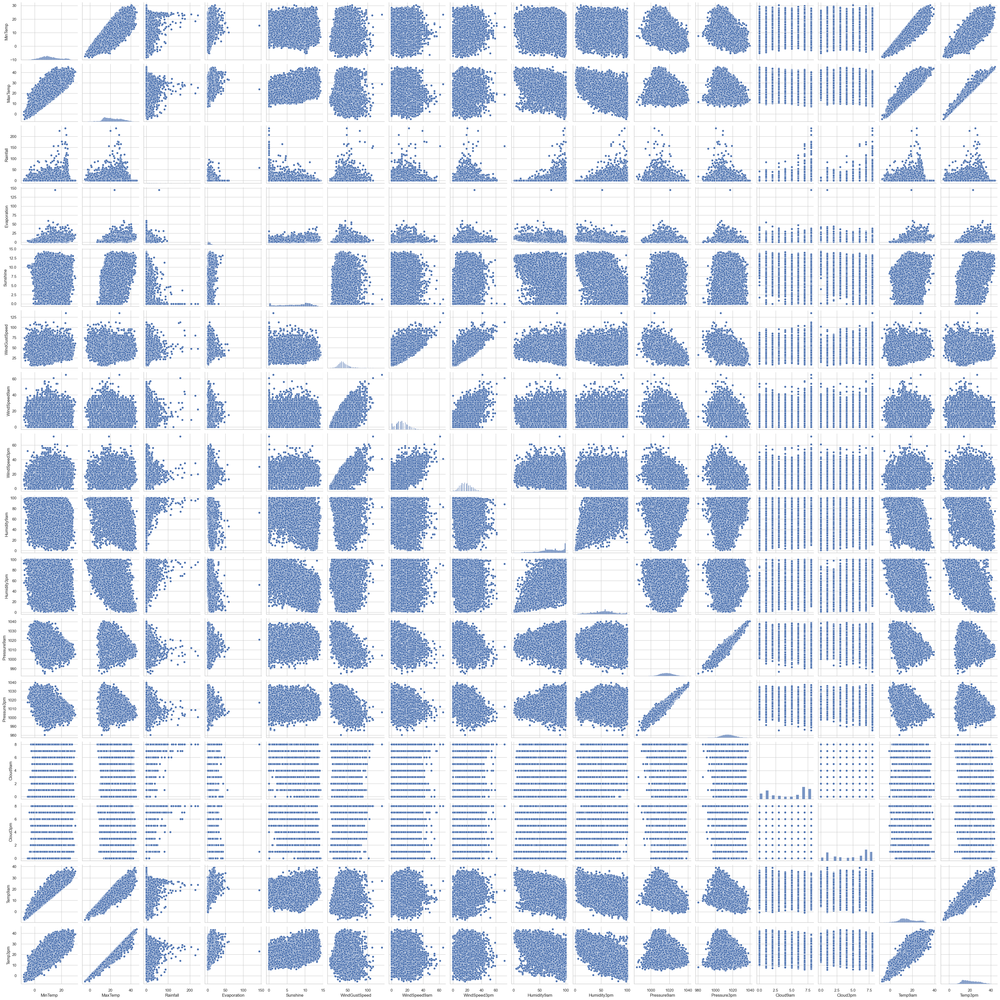

In [107]:
sns.pairplot(train_data[non_categoric_cols])
plt.show()

Observando rápidamente las dispersiones entre pares de variables, a simple vista se pueden detectar varias que podrían ser lineales. Sin embargo, la mayoría de las mismas tienen comportamientos más parecidos a una "nube de puntos".

Calculamos la matriz de correlación de las variables y la graficamos en un mapa de calor.

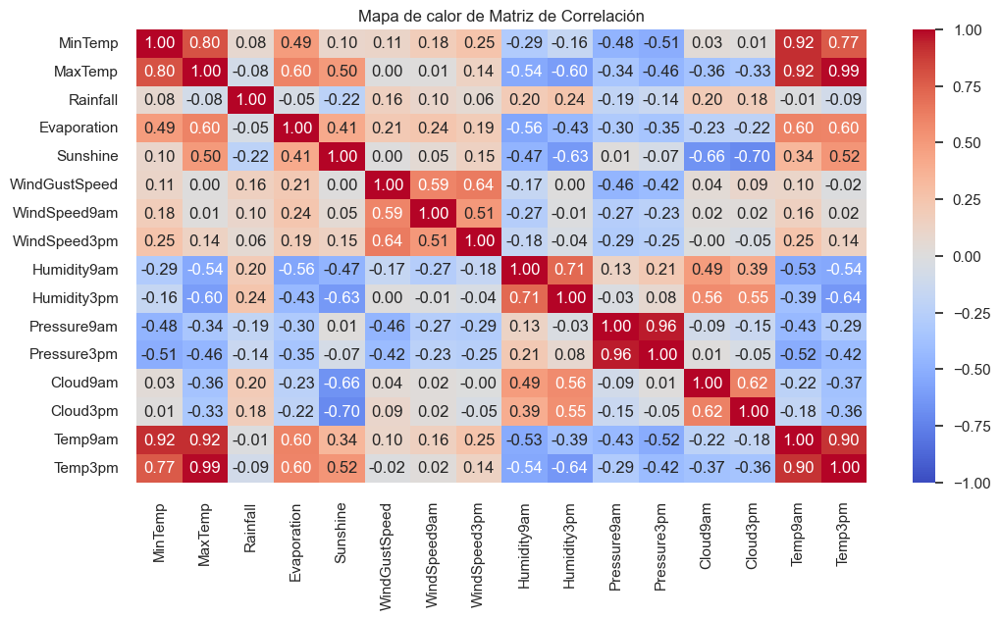

In [108]:
sns.set(style="whitegrid")
plt.figure(figsize=(12, 6))
sns.heatmap(train_data[non_categoric_cols].corr(method = 'pearson'), annot=True, cmap='coolwarm', fmt=".2f", vmin=-1, vmax=1)
plt.title('Mapa de calor de Matriz de Correlación')
plt.show()

Observamos muchas correlaciones lineales fuertes, entre las que se destacan:
*   'MaxTemp' con 'Temp3pm' y con 'Temp9am' directamente
*   'MinTemp' con 'Temp9am' directamente
*   'Pressure9am' con 'Pressure3pm' directamente
*   'MinTemp' con 'MaxTemp' directamente
*   'Sunshine' con 'Cloud3pm' y 'Cloud9am' inversamente

Todas las correlaciones son previsibles, de un comportamiento que nos resulta natural entender.

## Limpieza, imputación y escalado

Categorizamos las variables tipo Object a excepción de 'Date' en los datasets de entrenamiento y de pruebas.

In [113]:
# Buscamos columnas tipo object
categoric_cols = train_data.select_dtypes(exclude='float64').columns.drop(['RainTomorrow','Date'])

# Categorizamos columnas
X_train[categoric_cols] = X_train[categoric_cols].astype('category')
X_test[categoric_cols] = X_test[categoric_cols].astype('category')

Convertimos la columna Date a tipo datetime.

In [114]:
# Convertimos la columna 'Date' a tipo datetime
X_train['Date'] = pd.to_datetime(X_train['Date'])
X_test['Date'] = pd.to_datetime(X_test['Date'])

En base a las observaciones sobre los boxplots, elegimos eliminar tres datos que consideramos outliers. No deberán afectar significativamente a las predicciones por ser menos del 0,1% de la totalidad de los datos y nos asegurará una mejor imputación y escalado.

In [115]:
indexes = []

indexes.append(X_train[X_train['Evaporation'] > 130.0].index[0])
indexes.append(X_train[X_train['WindGustSpeed'] > 120.0].index[0])
indexes.append(X_train[X_train['WindSpeed3pm'] > 70].index[0])

X_train.drop(indexes, inplace=True)
y_train = np.delete(y_train, indexes)

Contabilizamos los datos nulos.

In [116]:
train_data.isna().sum()

Date                 0
Location             0
MinTemp            108
MaxTemp             34
Rainfall           271
Evaporation       7640
Sunshine         10831
WindGustDir        418
WindGustSpeed      416
WindDir9am        1701
WindDir3pm         313
WindSpeed9am       172
WindSpeed3pm       159
Humidity9am        566
Humidity3pm       1026
Pressure9am       3251
Pressure3pm       3252
Cloud9am          8338
Cloud3pm          8984
Temp9am            381
Temp3pm            783
RainToday          271
RainTomorrow         0
dtype: int64

La variable 'Date' es del tipo 'Timestamp' que no es admitido a la hora de imputar o entrenar el modelo. Es por eso que su información se descompone en dos nuevas variables 'Year' y 'Month' con el año y el mes respectivamente, que consideramos ser las variables más significativas de la fecha.

In [117]:
X_train_modified = X_train.copy()
X_test_modified = X_test.copy()

# Descomponer la columna "Date"
# X_train_modified['Year'] = X_train_modified['Date'].dt.year
X_train_modified['Month'] = X_train_modified['Date'].dt.month
# X_test_modified['Year'] = X_test_modified['Date'].dt.year
X_test_modified['Month'] = X_test_modified['Date'].dt.month

# Eliminar la columna "Date"
X_train_modified = X_train_modified.drop('Date', axis=1)
X_test_modified = X_test_modified.drop('Date', axis=1)

Codificamos el resto de las variables tipo object o category para poder así utilizarlos durante la imputación y el entrenamiento del modelo. Los datos faltantes (NaN) se mantienen como tales.

**Codificacion de la variable "Location"** --> Se Codifica en función de los valores de Latitud y Longitud

Justificación:

Codificar la variable categórica "Location" usando las coordenadas de latitud y longitud puede ser un buen enfoque, dependiendo del contexto del problema.

Cuándo es un buen criterio:

1) Modelos que dependen de la ubicación geográfica: Si la ubicación geográfica de la ciudad es relevante para el problema
(por ejemplo, en modelos relacionados con clima, geografía, logística o transporte), las coordenadas de latitud y longitud
pueden capturar mejor la relación entre la ubicación y el objetivo del modelo.

Ejemplo: Si se está construyendo un modelo que predice el clima, la cercanía geográfica a la costa, la altitud o la posición relativa pueden ser importantes.

Ventajas:

* La codificación de latitud y longitud permite que el modelo capture distancias geográficas entre las ciudades, algo que no se podría lograr fácilmente con otras codificaciones como One-Hot Encoding.

* Reducción de la dimensionalidad: Codificar ciudades con latitud y longitud reduce significativamente el número de columnas en comparación con One-Hot Encoding, que crearía una columna para cada ciudad. Si se tienen muchas ciudades, esta técnica es más eficiente y compacta.

2) Modelos que pueden beneficiarse de las relaciones espaciales: Modelos como los k-Nearest Neighbors (k-NN) o incluso modelos de redes neuronales pueden beneficiarse de la codificación por coordenadas, ya que podrían aprender a agrupar o clasificar basándose en proximidad geográfica.

In [118]:
# CODIFICACIÓN DE LA VARIABLE "Location" --> Se Codifica en función de los valores de Latitud y Longitud

# Creo el diccionario con las coordenadas (latitud, longitud)
location_coordinates = {
    'Williamtown': (-32.7925, 151.8397),
    'AliceSprings': (-23.6980, 133.8807),
    'Katherine': (-14.4657, 132.2635),
    'Launceston': (-41.4332, 147.1441),
    'MountGinini': (-35.5292, 148.7722),
    'Dartmoor': (-38.0667, 141.2167),
    'Watsonia': (-37.7161, 145.0831),
    'Portland': (-38.3496, 141.5881),
    'Townsville': (-19.2564, 146.8186),
    'Bendigo': (-36.7570, 144.2794),
}

# Creo las columnas 'Latitude' y 'Longitude' en los datasets de entrenamiento y testeo
X_train_modified['Latitude'] = X_train_modified['Location'].map(lambda x: location_coordinates[x][0] if x in location_coordinates else np.nan)
X_train_modified['Longitude'] = X_train_modified['Location'].map(lambda x: location_coordinates[x][1] if x in location_coordinates else np.nan)

X_test_modified['Latitude'] = X_train_modified['Location'].map(lambda x: location_coordinates[x][0] if x in location_coordinates else np.nan)
X_test_modified['Longitude'] = X_train_modified['Location'].map(lambda x: location_coordinates[x][1] if x in location_coordinates else np.nan)

# Elimino la columna "Location"
X_train_modified.drop('Location', axis=1, inplace=True)
X_test_modified.drop('Location', axis=1, inplace=True)

**Codificación de la variable "Month"** --> Se Codifica usando la técnica seno-coseno

La técnica de codificación seno-coseno es un método que se utiliza para representar variables categóricas o cíclicas de manera que se preserve su naturaleza cíclica. Esta técnica es particularmente útil para variables que tienen una periodicidad natural, como:

* Mes del año (donde enero y diciembre están cerca)
* Hora del día (donde la medianoche y las 23:59 están cerca)
* Día de la semana (donde domingo y lunes están cerca)

Cuando se tiene una variable cíclica (por ejemplo, las horas del día), los valores más altos y más bajos están muy cerca uno del otro en la realidad, pero si esos valores se codifican como enteros regulares, el modelo puede interpretar erróneamente que los valores altos están muy lejos de los bajos.

Por ejemplo: Hora del día: Si se codifica las 23 horas como un valor entero, el valor 23 parecería mucho mayor que el valor 0 (medianoche), aunque en realidad están a solo una hora de distancia.

Para resolver este problema, se puede usar la codificación seno-coseno, que transforma las variables cíclicas en coordenadas circulares. Esto hace que la relación de cercanía entre los extremos de la variable quede preservada.

Siempre que se use codificación seno-coseno para representar una variable cíclica, se necesitará generar dos columnas por variable:
una para el seno y otra para el coseno. Esto se debe a que se está representando la variable en un espacio bidimensional que captura
tanto la posición en el ciclo (mediante el seno) como la dirección (mediante el coseno).

La combinación de las dos columnas (seno y coseno) permite capturar completamente la naturaleza cíclica de la variable:

* Seno representa la variación vertical en un círculo. Cuando el valor es alto, se encuentra en la parte superior del círculo, y cuando es bajo, se encuentra en la parte inferior.
* Coseno representa la variación horizontal en un círculo. Cuando el valor es alto, se encuentra en la parte derecha del círculo, y cuando es bajo, se encuentra en la parte izquierda.

Juntos, seno y coseno describen una posición en el ciclo de manera completa y continua. Si solo se usara una de las dos funciones, se perdería parte de la información y no se capturaría adecuadamente la relación cíclica entre los valores.

In [119]:
# CODIFICACIÓN DE LA VARIABLE "Month" --> Se Codifica usando la técnica seno-coseno

# Creo las columnas 'Month_sin' y 'Month_con' en los datasets de entrenamiento y testeo
X_train_modified["Month_sin"] = np.where(pd.isna(X_train_modified["Month"]), np.nan, np.sin(2 * np.pi * X_train_modified["Month"] / 12))
X_train_modified["Month_cos"] = np.where(pd.isna(X_train_modified["Month"]), np.nan, np.cos(2 * np.pi * X_train_modified["Month"] / 12))

X_test_modified["Month_sin"] = np.where(pd.isna(X_test_modified["Month"]), np.nan, np.sin(2 * np.pi * X_test_modified["Month"] / 12))
X_test_modified["Month_cos"] = np.where(pd.isna(X_test_modified["Month"]), np.nan, np.cos(2 * np.pi * X_test_modified["Month"] / 12))

# Elimino la columna "Month"
X_train_modified.drop("Month", axis=1, inplace=True)
X_test_modified.drop("Month", axis=1, inplace=True)

In [120]:
# CODIFICACIÓN DE LAS VARIABLES  "WindGustDir", "WindDir9am", "WindDir3pm" --> Se Codifican usando la técnica seno-coseno

# Defino un diccionario con los ángulos correspondientes a cada dirección
wind_direction_angles = {
    'N': 0,
    'NNE': 22.5,
    'NE': 45,
    'ENE': 67.5,
    'E': 90,
    'ESE': 112.5,
    'SE': 135,
    'SSE': 157.5,
    'S': 180,
    'SSW': 202.5,
    'SW': 225,
    'WSW': 247.5,
    'W': 270,
    'WNW': 292.5,
    'NW': 315,
    'NNW': 337.5,
}

wind_direction_encoded = {}
for key, value in wind_direction_angles.items():
    wind_direction_encoded[key] = np.sin(np.deg2rad(value)), np.cos(np.deg2rad(value))


# Creo las columnas 'WindGustDir_sin' y 'WindGustDir_cos' en los datasets de entrenamiento y testeo
X_train_modified['WindGustDir_sin'] = X_train_modified['WindGustDir'].map(lambda x: wind_direction_encoded[x][0] if x in wind_direction_encoded else np.nan)
X_train_modified['WindGustDir_cos'] = X_train_modified['WindGustDir'].map(lambda x: wind_direction_encoded[x][1] if x in wind_direction_encoded else np.nan)

X_test_modified['WindGustDir_sin'] = X_test_modified['WindGustDir'].map(lambda x: wind_direction_encoded[x][0] if x in wind_direction_encoded else np.nan)
X_test_modified['WindGustDir_cos'] = X_test_modified['WindGustDir'].map(lambda x: wind_direction_encoded[x][1] if x in wind_direction_encoded else np.nan)

# Creo las columnas 'WindDir9am_sin' y 'WindDir9am_cos' en los datasets de entrenamiento y testeo
X_train_modified['WindDir9am_sin'] = X_train_modified['WindDir9am'].map(lambda x: wind_direction_encoded[x][0] if x in wind_direction_encoded else np.nan)
X_train_modified['WindDir9am_cos'] = X_train_modified['WindDir9am'].map(lambda x: wind_direction_encoded[x][1] if x in wind_direction_encoded else np.nan)

X_test_modified['WindDir9am_sin'] = X_test_modified['WindDir9am'].map(lambda x: wind_direction_encoded[x][0] if x in wind_direction_encoded else np.nan)
X_test_modified['WindDir9am_cos'] = X_test_modified['WindDir9am'].map(lambda x: wind_direction_encoded[x][1] if x in wind_direction_encoded else np.nan)

# Creo las columnas 'WindDir3pm_sin' y 'WindDir3pm_cos' en los datasets de entrenamiento y testeo
X_train_modified['WindDir3pm_sin'] = X_train_modified['WindDir3pm'].map(lambda x: wind_direction_encoded[x][0] if x in wind_direction_encoded else np.nan)
X_train_modified['WindDir3pm_cos'] = X_train_modified['WindDir3pm'].map(lambda x: wind_direction_encoded[x][1] if x in wind_direction_encoded else np.nan)

X_test_modified['WindDir3pm_sin'] = X_test_modified['WindDir3pm'].map(lambda x: wind_direction_encoded[x][0] if x in wind_direction_encoded else np.nan)
X_test_modified['WindDir3pm_cos'] = X_test_modified['WindDir3pm'].map(lambda x: wind_direction_encoded[x][1] if x in wind_direction_encoded else np.nan)

# Elimino las columnas "WindGustDir", "WindDir9am", "WindDir3pm"
X_train_modified.drop("WindGustDir", axis=1, inplace=True)
X_test_modified.drop("WindGustDir", axis=1, inplace=True)
X_train_modified.drop("WindDir9am", axis=1, inplace=True)
X_test_modified.drop("WindDir9am", axis=1, inplace=True)
X_train_modified.drop("WindDir3pm", axis=1, inplace=True)
X_test_modified.drop("WindDir3pm", axis=1, inplace=True)

In [121]:
# CODIFICACIÓN DE LA VARIABLE "RainToday"" --> Se implementa codificación binaria
X_train_modified['RainToday'] = X_train_modified['RainToday'].map({'Yes': 1, 'No': 0}, na_action='ignore')
X_test_modified['RainToday'] = X_test_modified['RainToday'].map({'Yes': 1, 'No': 0}, na_action='ignore')

In [122]:
# CODIFICACIÓN DE LA VARIABLE "Year"" --> Se implementa codificación One-Hot Encoding
# Esta codificación es adecuada en el caso de que cada año deba considerarse como una categoría distinta (es decir, no existe una relación secuencial clara entre ellos)

#Genero la codificación de los datasets de entrenamiento y testeo
#X_train_modified = pd.get_dummies(X_train_modified, columns=['Year'], prefix='Year')
#X_test_modified = pd.get_dummies(X_test_modified, columns=['Year'], prefix='Year')

Imputamos los datos faltantes de acuerdo al siguiente criterio:
* Si la variable posee una distribución simétrica, imputamos con la media
* Si la variable posee una distribución asimétrica, imputamos con la mediana
* Si la variable posee una distribución multimodal, imputamos con los k vecinos más cercanos
* Si la variable era categórica u objeto, imputamos con los k vecinos más cercanos

In [127]:
# Creamos los imputadores
imputador_media = SimpleImputer(strategy='mean')
imputador_mediana = SimpleImputer(strategy='median')
imputador_knn = KNNImputer()

# Lista de variables a imputar
lista_media = ["Pressure9am", "Pressure3pm"]
lista_mediana = ["Temp9am", "Temp3pm", "MaxTemp", "MinTemp", "Rainfall", "Evaporation"] #, "WindGustSpeed", "WindSpeed9am", "WindSpeed3pm"]

# Copiamos datasets de entrenamiento
X_train_imputado = X_train_modified.copy()
X_test_imputado = X_test_modified.copy()

# Imputamos con la media
X_train_imputado[lista_media] = imputador_media.fit_transform(X_train_imputado[lista_media])
X_test_imputado[lista_media] = imputador_media.transform(X_test_imputado[lista_media])

# Imputamos con la mediana
X_train_imputado[lista_mediana] = imputador_mediana.fit_transform(X_train_imputado[lista_mediana])
X_test_imputado[lista_mediana] = imputador_mediana.transform(X_test_imputado[lista_mediana])

# Imputación kNN
X_train_imputado[X_train_modified.columns] = imputador_knn.fit_transform(X_train_imputado[X_train_modified.columns])
X_test_imputado[X_train_modified.columns] = imputador_knn.transform(X_test_imputado[X_train_modified.columns])

MemoryError: Unable to allocate 1.00 GiB for an array with shape (5975, 22463) and data type float64

Comparación de las distribuciones de las variables antes y después de imputar

In [ ]:
# Declaro una lista con las variables imputadas (columnas que contenían NaNs)
lista_imputadas = X_train_modified.columns[X_train_modified.isna().any()].tolist()


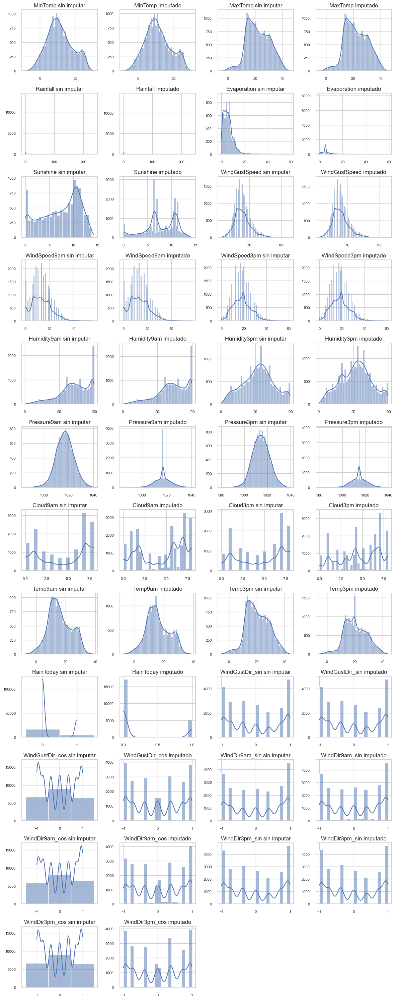

In [ ]:
# Comparo las distribuciones de las variables antes y después de imputar
plt.figure(figsize=(12, 30))
idx = 0

# Variables Cuantitativas
#for column in non_categoric_cols:
for column in lista_imputadas:
    # Distplot
    plt.subplot(12, 4, idx+1)
    sns.histplot(data=X_train_modified, x=X_train_modified[column], kde=True)
    plt.title(f'{column} sin imputar')
    plt.xlabel('')
    plt.ylabel('')
    plt.xticks(fontsize=8)
    plt.yticks(fontsize=8)

    # Distplot
    plt.subplot(12, 4, idx+2)
    sns.histplot(data=X_train_imputado, x=X_train_imputado[column], kde=True)
    plt.title(f'{column} imputado')
    plt.xlabel('')
    plt.ylabel('')
    plt.xticks(fontsize=8)
    plt.yticks(fontsize=8)

    idx += 2

plt.tight_layout()
plt.show()

Escalamos los datos con un escalador robusto, ya que estamos incluyendo outliers en nuestro dataset final.

In [ ]:
# Escalado de Variables

# Copiamos datasets de entrenamiento
X_train_escalado = X_train_imputado.copy()
X_test_escalado = X_test_imputado.copy()

# Instanciacion del escalador
scaler = RobustScaler()

# Escalado de variables
X_train_escalado = scaler.fit_transform(X_train_escalado)
X_test_escalado = scaler.transform(X_test_escalado)

Observamos la cantidad de días lluviosos y no lluviosos por ciudad para evaluar el balanceo.

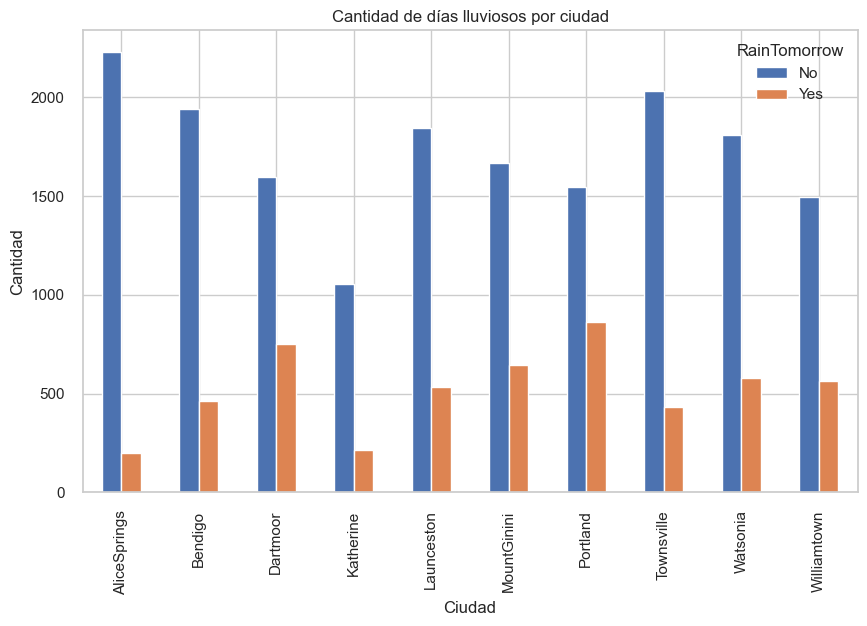

In [ ]:
train_data.groupby(['Location', 'RainTomorrow']).size().unstack().plot(kind='bar', stacked=False, figsize=(10, 6))
plt.xlabel('Ciudad')
plt.ylabel('Cantidad')
plt.title('Cantidad de días lluviosos por ciudad')
plt.legend(title='RainTomorrow')
plt.show()

El dataset se encuentra bastante desbalanceado, donde la cantidad de días no lluviosos superan en gran cantidad a los días lluviosos en todas las ciudades. Es importante detectar si el dataset es balanceado o no, ya que determinará si se debe utilizar algún método de balanceo para evitar un sesgo en el modelo. Con el dataset actual, el modelo tendería a clasificar todos los días como días no lluviosos sin importar mucho el resto de los datos, simplemente por su frecuencia de aparición.

In [ ]:
joblib.dump(imputador_media, 'imputador_media.joblib')
joblib.dump(imputador_mediana, 'imputador_mediana.joblib')
joblib.dump(imputador_knn, 'imputador_knn.joblib')
joblib.dump(scaler, 'scaler.joblib')

['scaler.joblib']

## Regresión Logística

Teniendo el dataset preparado, pasamos a entrenar un modelo de regresión logística con los datos de entrenamiento y probarlo con los datos de prueba.

In [33]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
# Inicializar y entrenar un modelo de regresión logística
model = LogisticRegression(random_state=42, max_iter=10000)
model.fit(X_train_escalado, y_train)

# Realizar predicciones en el conjunto de prueba
y_pred = model.predict(X_test_escalado)

# Calcular métricas
accuracy = accuracy_score(y_test, y_pred)

confusion_matrix = confusion_matrix(y_test, y_pred)

classification_report = classification_report(y_test, y_pred)

# Imprimir métricas
print("Métricas para logreg:")
print(f'Exactitud: {accuracy}')
print("Matriz de confusión:")
print(confusion_matrix)
print("Reporte de clasificación:")
print(classification_report)

Métricas para logreg:
Exactitud: 0.7685597293929144
Matriz de confusión:
[[4301    1]
 [1299   16]]
Reporte de clasificación:
              precision    recall  f1-score   support

          No       0.77      1.00      0.87      4302
         Yes       0.94      0.01      0.02      1315

    accuracy                           0.77      5617
   macro avg       0.85      0.51      0.45      5617
weighted avg       0.81      0.77      0.67      5617



In [95]:
f1_logreg = f1_score(y_test, y_pred, average='macro')

TypeError: '<' not supported between instances of 'str' and 'float'

Si bien la exactitud (accuracy) calculada con los resultados al usar los datos de prueba sería "moderada", es importante recordar que no se trata de una buena medida para usar en modelos desbalanceados como este. El modelo buscará clasificar la mayoría de los casos como días "no lluviosos" maximizando las probabilidades de acierto, pecando de un fuerte sesgo por el desbalance del dataset.

Si nos paramos en la métrica de precisión (precision), observamos que es muy alta para el caso de días lluviosos y moderada para los días no lluviosos. Este indicador habla de cuántos de los datos clasificados como posisitivos fueron realmente positivos. Viendo la matriz de confusión, vemos que el modelo clasificó 4301 verdaderos positivos y 1297 falsos positivos para la clase 'No', demostrando que al estar tan sesgado, clasifica erróneamente muchos datos que en realidad debieron ser 'Yes'. Esto no ocurre con la clase 'Yes', donde logra clasificar bien 18 datos de los 19 que clasifico bajo esa clase.

Ahora, desde el punto de vista de la exhaustividad (recall), vemos otra cosa. Este indicador habla de cuántos datos fueron clasificados correctamente dentro de una misma clase. En el caso de la clase 'No', vemos que clasificó 4301 verdaderos positivos y tan solo 1 falso negativo, dicho de otra manera, tan solo dos de los casos que dijo que eran 'Yes' eran en realidad 'No', hablando de que el modelo es muy bueno clasificando correctamente esta clase. No podemos decir lo mismo de la clase 'Yes', donde la relación clasificaciones correctas contra incorrectas es completamente al revés. Esto es un fenómeno común con datasets desbalanceados, donde el recall de una clase es muy alto mientras que en la otra es muy bajo.

Finalmente, el F1-Score toma en cuenta tanto la precisión como la exhaustividad, calculando la media armónica entre ambos indicadores. Este indicador sirve de "resumen" de indicadores, penalizando cuando alguno de ellos es demasiado bajo, que es lo que vemos en la clase 'Yes' debido a su muy baja exhaustividad.

Calculamos luego la curva ROC y sus parámetros más importantes.

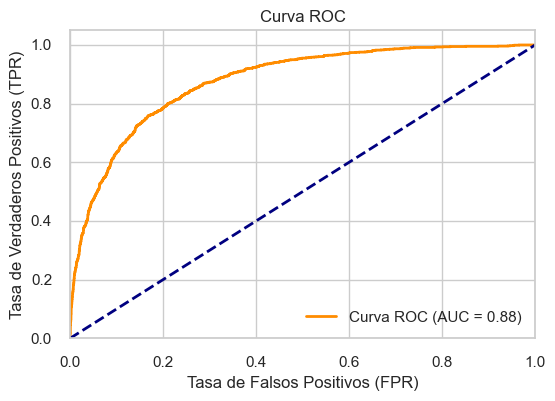

Umbral óptimo: 0.25459245833327876
FPR óptimo: 0.1689911668991167
TPR óptimo: 0.7596958174904943


In [34]:
# Curva ROC

# Obtengo las probabilidades de predicción del modelo
y_probs = model.predict_proba(X_test_escalado)[:, 1]

# Calculo la ROC y el AUC
fpr, tpr, thresholds = roc_curve(y_test, y_probs, pos_label='Yes')
roc_auc = auc(fpr, tpr)

# Grafico la curva ROC
plt.figure(figsize=(6, 4))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='Curva ROC (AUC = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Tasa de Falsos Positivos (FPR)')
plt.ylabel('Tasa de Verdaderos Positivos (TPR)')
plt.title('Curva ROC')
plt.legend(loc="lower right")
plt.show()

# Encontrar el punto óptimo (Youden's J statistic)
optimal_idx = np.argmax(tpr - fpr)
optimal_threshold = thresholds[optimal_idx]
optimal_fpr = fpr[optimal_idx]
optimal_tpr = tpr[optimal_idx]

print(f"Umbral óptimo: {optimal_threshold}")
print(f"FPR óptimo: {optimal_fpr}")
print(f"TPR óptimo: {optimal_tpr}")

En primer lugar, observamos a simple vista que el área bajo la curva (AUC) es 0.87, un valor considerablemente mayor a 0.5, lo que dice que se encuentra cerca de contener al punto [0, 1]. Esto es importante, ya que ese punto es el que tiene la tasa máxima de verdaderos positivos y mínima de falsos positivos.

Para encontrar el umbral óptimo, primero buscamos los TPR y FPR óptimos, que son aquellos que consiguen dar con las coordenadas del punto más cercano a [0, 1]. Lo calculamos obteniendo el mayor resultado posible de la diferencia entre TPR y FPR (maximiza TPR y minimiza FPR). Finalmente, obteniendo los índices de este punto, buscamos con qué umbral se obtuvo al calcular la curva ROC. Vemos que el umbral óptimo se encuentra en 0.25, la mitad de 0.5 que es el umbral que suelen tener por defecto los modelos de clasificación.

Para considerar si el fitting es bueno o no, es necesario pararse en una métrica. Por ser un modelo desbalanceado, descartamos la exactitud (accuracy). La precisión (precision) diría que el modelo es bueno para ambas clases, pero esto no ocurre si comparamos usando la exhaustividad (recall).

Para determinar si el modelo ajusta bien, usamos la métrica de resumen F1-Score, que vemos que es alta para la clase 'No' y muy baja para la clase 'Yes', por lo que el modelo no está consiguiendo un buen fitting.

### Estudio con datos balanceados

Para balancear el dataset usamos SMOTE.

In [35]:
# Balanceo
smote = SMOTE(random_state=42)

X_train_balanced, y_train_balanced = smote.fit_resample(X_train_escalado, y_train)

In [36]:
# Graficar Distribucion de Datos

# train_data_balanced = pd.DataFrame(X_train_balanced, columns=X_train_imputado.columns)
# train_data_balanced = pd.concat([train_data_balanced.drop('index', axis=1), pd.DataFrame(y_train_balanced, columns=['RainTomorrow'])], axis=1)

# train_data_balanced[['Latitude','Longitude', 'RainTomorrow']]

# train_data_balanced.groupby(['Latitude', 'Longitude', 'RainTomorrow']).size().unstack().plot(kind='bar', stacked=False, figsize=(10, 6))
# plt.xlabel('Ciudad')
# plt.ylabel('Cantidad')
# plt.title('Cantidad de días lluviosos por ciudad')
# plt.legend(title='RainTomorrow')
# plt.show()

Ahora ajustamos un modelo con los datos de entrenamiento balanceados, para evaluar sus métricas y comparar con el modelo anterior.

In [37]:
# Inicializar y entrenar un modelo de regresión logística
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

model_balanced = LogisticRegression(random_state=42, max_iter=10000)
model_balanced.fit(X_train_balanced, y_train_balanced)

# Realizar predicciones en el conjunto de prueba
y_pred_balanced = model_balanced.predict(X_test_escalado)

# Calcular métricas
accuracy_balanced = accuracy_score(y_test, y_pred_balanced)

confusion_matrix_balanced = confusion_matrix(y_test, y_pred_balanced)

classification_report_balanced = classification_report(y_test, y_pred_balanced)

# Imprimir métricas
print("Métricas para logreg:")
print(f'Exactitud: {accuracy_balanced}')
print("Matriz de confusión:")
print(confusion_matrix_balanced)
print("Reporte de clasificación:")
print(classification_report_balanced)

Métricas para logreg:
Exactitud: 0.7557414990208297
Matriz de confusión:
[[3126 1176]
 [ 196 1119]]
Reporte de clasificación:
              precision    recall  f1-score   support

          No       0.94      0.73      0.82      4302
         Yes       0.49      0.85      0.62      1315

    accuracy                           0.76      5617
   macro avg       0.71      0.79      0.72      5617
weighted avg       0.83      0.76      0.77      5617



El modelo balanceado logra mejorar algunas de los indicadores respecto al caso anterior. En este caso, usar la exactitud (accuracy) para evaluar el desempeño del modelo no sería incorrecto, clasificando correctamente el 75% de los datos respecto al total.

Desde el punto de la vista de la precisión (precision), la clase 'No' muestra una mejora significativa, lo cual es esperable al ser un modelo menos sesgado. La clase 'Yes', por el contrario, tiene una peor precisión, por lo que no es garantía que los días lluviosos predichos sean correctos (casi un 50% de probabilidades).

Desde el punto de vista de la exhaustividad (recall), vemos que el balanceo hizo una diferencia, consiguiendo valores similares para ambas clases. Esta métrica empeoró para la clase 'No', pero sigue siendo moderadamente buena.

La métrica F1-Score nos muestra un valor similar al anterior para la clase 'No' y mucho mejor para la clase 'Yes'.

En términos generales, podríamos pensar que este modelo hace un mejor fitting que el anterior pero hay que tener cuidado con algo: tiene una baja precisión con la clase 'Yes', prediciendo erróneamente muchos días lluviosos que son los que más nos interesan. Sin embargo, tiene muy bajos falsos negativos para la clase 'Yes'. Teniendo en cuenta estas cosas, creemos que el modelo balanceado sigue siendo mejor que el anterior, nuevamente usando las métricas F1-Score.

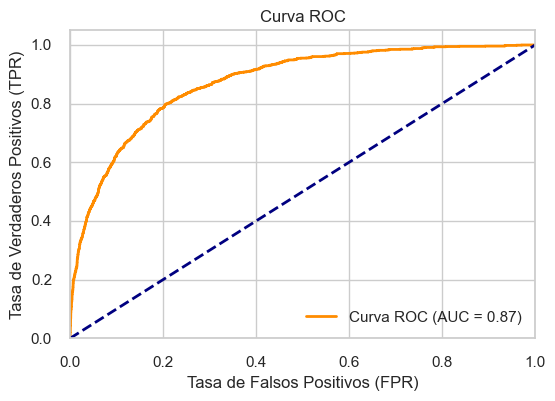

Umbral óptimo: 0.5177667472457482
FPR óptimo: 0.20757787075778708
TPR óptimo: 0.8


In [38]:
# Curva ROC

# Obtengo las probabilidades de predicción del modelo
y_probs_balanced = model_balanced.predict_proba(X_test_escalado)[:, 1]

# Calculo la ROC y el AUC
fpr, tpr, thresholds = roc_curve(y_test, y_probs_balanced, pos_label='Yes')
roc_auc = auc(fpr, tpr)

# Grafico la curva ROC
plt.figure(figsize=(6, 4))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='Curva ROC (AUC = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Tasa de Falsos Positivos (FPR)')
plt.ylabel('Tasa de Verdaderos Positivos (TPR)')
plt.title('Curva ROC')
plt.legend(loc="lower right")
plt.show()

# Encontrar el punto óptimo (Youden's J statistic)
optimal_idx = np.argmax(tpr - fpr)
optimal_threshold = thresholds[optimal_idx]
optimal_fpr = fpr[optimal_idx]
optimal_tpr = tpr[optimal_idx]

print(f"Umbral óptimo: {optimal_threshold}")
print(f"FPR óptimo: {optimal_fpr}")
print(f"TPR óptimo: {optimal_tpr}")

En este caso, el área bajo la curva es muy parecido al caso anterior, sin embargo cambia mucho el valor de umbral óptimo. En este caso, se encuentra en 0.52, extremadamente cercano al que suele usarse por defecto.

## Modelo Base

Generamos ahora algunos modelos base para comparar con las métricas de los modelos anteriores. El primero de ellos se basa en clasificar a todos los datos con la clase mayoritaria, que en el dataset original y desbalanceado es 'No' (día no lluvioso).

In [39]:
# Inicializar y entrenar un modelo de regresión logística
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

warnings.filterwarnings('ignore')

# Inicializar y entrenar un modelo base usando los valores más frecuentes (en la mayoría)
df_base_model = pd.DataFrame(y_train, columns=['RainTomorrow'])

# Realizar predicciones basados en los valores más frecuentes
most_frequent = df_base_model['RainTomorrow'].mode()[0]
df_base_model['Prediction'] = most_frequent

# Calcular métricas
accuracy_base_freq = accuracy_score(df_base_model['RainTomorrow'], df_base_model['Prediction'])

confusion_matrix_base_freq = confusion_matrix(df_base_model['RainTomorrow'], df_base_model['Prediction'])

classification_report_base_freq = classification_report(df_base_model['RainTomorrow'], df_base_model['Prediction'])

# Imprimir métricas
print("Métricas para modelo base:")
print(f'Valor más frecuente: {most_frequent}')
print(f'Exactitud: {accuracy_base_freq}')
print("Matriz de confusión:")
print(confusion_matrix_base_freq)
print("Reporte de clasificación:")
print(classification_report_base_freq)

Métricas para modelo base:
Valor más frecuente: No
Exactitud: 0.7664604015492142
Matriz de confusión:
[[17217     0]
 [ 5246     0]]
Reporte de clasificación:
              precision    recall  f1-score   support

          No       0.77      1.00      0.87     17217
         Yes       0.00      0.00      0.00      5246

    accuracy                           0.77     22463
   macro avg       0.38      0.50      0.43     22463
weighted avg       0.59      0.77      0.67     22463



Como es de esperar, el desempeño de este modelo es muy pobre, fallando en predecir absolutamente todos los días lluviosos que son los más importantes. Por este motivo, todas las métricas de la case 'Yes' son cero.

Por otro lado, la precisión (precision) de la clase 'No' también baja, ya que tiene todos los falsos positivos que se originan de no clasificar correctamente aquellos datos que deberían participar a la clase 'Yes'.

A continuación, creamos un segundo modelo base que realiza una predicción basándose en si hubo lluvias o no 365 días en el pasado.

In [40]:
# Inicializar y entrenar un modelo de regresión logística
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

warnings.filterwarnings('ignore')

# Inicializar y entrenar un modelo base usando el valor de 365 días atrás
df_x_train = pd.DataFrame(X_train, columns=['Date', 'RainToday'])
df_y_train = pd.DataFrame(y_train, columns=['RainTomorrow'])
df_base_model = pd.concat([df_x_train, df_y_train], axis=1)
df_base_model['Date'] = pd.to_datetime(df['Date'])
df_base_model = df_base_model.sort_values(by='Date')

# Realizar predicciones basados en lo que ocurrió 365 días atrás
df_base_model['Prediction'] = df_base_model['RainToday'].shift(365)  # Ajusta 365 según los datos
# df_base_model = df_base_model.dropna(subset=['Prediction'])
df_base_model = df_base_model.dropna()

# Calcular métricas
accuracy_base_365_days = accuracy_score(df_base_model['RainTomorrow'], df_base_model['Prediction'])

confusion_matrix_base_365_days = confusion_matrix(df_base_model['RainTomorrow'], df_base_model['Prediction'])

classification_report_base_365_days = classification_report(df_base_model['RainTomorrow'], df_base_model['Prediction'])

# Imprimir métricas
print("Métricas para modelo base:")
print(f'Exactitud: {accuracy_base_365_days}')
print("Matriz de confusión:")
print(confusion_matrix_base_365_days)
print("Reporte de clasificación:")
print(classification_report_base_365_days)

Métricas para modelo base:
Exactitud: 0.6460959810545378
Matriz de confusión:
[[8493 2545]
 [2536  783]]
Reporte de clasificación:
              precision    recall  f1-score   support

          No       0.77      0.77      0.77     11038
         Yes       0.24      0.24      0.24      3319

    accuracy                           0.65     14357
   macro avg       0.50      0.50      0.50     14357
weighted avg       0.65      0.65      0.65     14357



Este modelo base sigue siendo bastante pobre para predecir la clase 'Yes' (días lluviosos), reflejado en sus bajas métricas de precisión (precision) y exhaustividad (recall). Se puede entender que la clase 'No' tiene métricas moderadamente altas debido a que la probabilidad de que existan días no lluviosos es mucho más alta de que los haya. A pesar de esto, hay que destacar que el hecho de que haya predecido correctamente casi el 25% de los días lluviosos quiere decir que año a año hay una buena probabilidad de que los días lluviosos coincidan entre sí.

Este modelo tiene el problema de que no es robusto a la ausencia de datos. Si un día no se registró en el dataset, no se podrá predecir 365 días a futuro.

Por último, creamos un modelo base que realiza una predicción de forma aleatoria.

In [41]:
# Inicializar y entrenar un modelo de regresión logística
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

warnings.filterwarnings('ignore')

# Inicializar y entrenar un modelo base usando valores aleatorios
df_base_model = pd.DataFrame(y_train, columns=['RainTomorrow'])

# Realizar predicciones basados en valores aleatorios
df_base_model['Prediction'] = np.random.choice(['Yes', 'No'], size=len(df_base_model))

# Calcular métricas
accuracy_base_random = accuracy_score(df_base_model['RainTomorrow'], df_base_model['Prediction'])

confusion_matrix_base_random = confusion_matrix(df_base_model['RainTomorrow'], df_base_model['Prediction'])

classification_report_base_random = classification_report(df_base_model['RainTomorrow'], df_base_model['Prediction'])

# Imprimir métricas
print("Métricas para modelo base:")
print(f'Exactitud: {accuracy_base_random}')
print("Matriz de confusión:")
print(confusion_matrix_base_random)
print("Reporte de clasificación:")
print(classification_report_base_random)

Métricas para modelo base:
Exactitud: 0.5053643769754708
Matriz de confusión:
[[8728 8489]
 [2622 2624]]
Reporte de clasificación:
              precision    recall  f1-score   support

          No       0.77      0.51      0.61     17217
         Yes       0.24      0.50      0.32      5246

    accuracy                           0.51     22463
   macro avg       0.50      0.50      0.47     22463
weighted avg       0.64      0.51      0.54     22463



Este modelo no es confiable de ninguna manera. El hecho de que acierte en su prediccón o no es completamente aleatorio y los resultados cambian en cada ejecución.

## Optimización de Hiperparámetros

### Validación Cruzada k-Folds

Se ensaya una validación cruzada k-Folds sobre el modelo de regresión logística parametrizado de la misma manera que en los casos anteriores y usando el dataset balanceado.

In [42]:
clf = LogisticRegression(random_state=42, max_iter=10000)
cv = KFold(n_splits=5, shuffle=True, random_state=42)

scores = cross_val_score(clf, X_train_balanced, y_train_balanced, cv=cv, scoring='f1_macro')

Se grafica la métrica 'f1-Score' de cada fold y se calcula el promedio. En este caso se utiliza la variante 'f1 macro'  la cual calcula el f1-score para cada clase y toma el promedio sin ponderación, es decir que trata a todas las clases por igual independientemente de su tamaño.

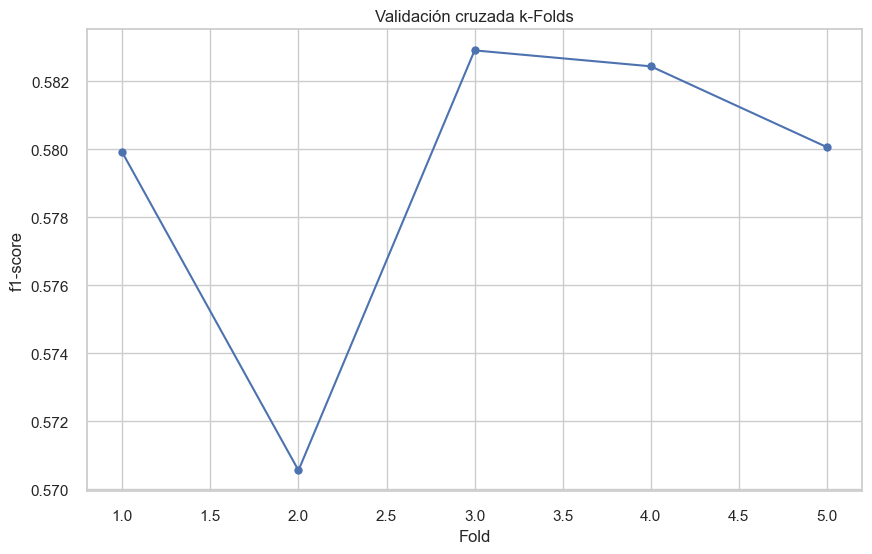


f1-score promedio para datos de entrenamiento: 0.5792


In [43]:
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(scores) + 1), scores, marker='o', label="k-Folds")

plt.xlabel("Fold")
plt.ylabel("f1-score")
# plt.ylabel("Accuracy")
plt.title("Validación cruzada k-Folds")
# plt.legend()
plt.grid(True)
plt.show()

print(f"\nf1-score promedio para datos de entrenamiento: {scores.mean():.4f}")

Existe una baja diferencia entre las métricas de cada fold, indicando que el modelo entrenado con cualquier selección de datos presenta un comportamiento similar. Esto habla de que, muy probablemente, haya una buena cantidad de datos de forma que los folds sean de similares características para el entrenamiento.

### Optuna

Se realiza ahora la optimización de hiperparámetros utilizando Optuna. Se elige este método frente a GridSearchCV ya que, al evaluar todas las combinaciones de hiperparámetros puede demorar mucho tiempo. También se desestimo RandomSearchCV debido a que podría devolver un resultado subóptimo por su aleatoriedad en la selección de hiperparámetros.

Se decide optimizar los siguientes hiperparámetros:
* Penalty: Para determinar qué técnica de regularización da mejor resultado sobre el entrenamiento del modelo.
* C: Para determinar qué fuerza de regularización es la óptima.
* Solver: Para determinar qué algoritmo de optimización alcanza un mejor resultado.

In [44]:
# Se define la función objetivo, en este caso, calculando f1-score
def objective(trial):
  # Se definen los hiperparámetros a ensayar
  random_state = trial.suggest_int("random_state", 42, 42)
  max_iter = trial.suggest_int("max_iter", 10000, 10000)
  C = trial.suggest_float("C", 2.0, 10.0)
  penalty = trial.suggest_categorical("penalty", ["l1", "l2"])
  solver = trial.suggest_categorical("solver", ["liblinear", "saga"])

  # Se crea el modelo
  #clf = cv(random_state=random_state, max_iter=max_iter, C=C, penalty=penalty, solver=solver)
  clf = LogisticRegression(random_state=random_state, max_iter=max_iter, C=C, penalty=penalty, solver=solver)

  return cross_val_score(clf, X_train_balanced, y_train_balanced, n_jobs=-1, cv=3, scoring='f1_macro').mean()

# Se crea un caso de estudio
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=10)

# Se obtiene el mejor resultado
trial = study.best_trial

print("\nf1-score: {}".format(trial.value))
print("\nMejores hiperparámetros: {}".format(trial.params))

[I 2024-11-27 11:11:08,063] A new study created in memory with name: no-name-421da419-8096-42c3-9a3c-a4491928846f
[I 2024-11-27 11:12:37,885] Trial 0 finished with value: 0.5787865485228011 and parameters: {'random_state': 42, 'max_iter': 10000, 'C': 8.218987836173959, 'penalty': 'l2', 'solver': 'saga'}. Best is trial 0 with value: 0.5787865485228011.
[I 2024-11-27 11:14:04,647] Trial 1 finished with value: 0.5788633501370849 and parameters: {'random_state': 42, 'max_iter': 10000, 'C': 2.0266189561808243, 'penalty': 'l1', 'solver': 'saga'}. Best is trial 1 with value: 0.5788633501370849.
[I 2024-11-27 11:15:29,855] Trial 2 finished with value: 0.5787865485228011 and parameters: {'random_state': 42, 'max_iter': 10000, 'C': 7.946072225653208, 'penalty': 'l2', 'solver': 'saga'}. Best is trial 1 with value: 0.5788633501370849.
[I 2024-11-27 11:17:09,911] Trial 3 finished with value: 0.5787805397907366 and parameters: {'random_state': 42, 'max_iter': 10000, 'C': 9.484827842936301, 'penalty'


f1-score: 0.5788633501370849

Mejores hiperparámetros: {'random_state': 42, 'max_iter': 10000, 'C': 2.0266189561808243, 'penalty': 'l1', 'solver': 'saga'}


Se observa que en cada prueba (trial) la métrica f1-score no posee una variación significativa, por lo que utilizar un método de optimización de hiperparámetros en este problema quizá no sea realmente necesario.

Se grafica la historia de optimización del estudio.

In [45]:
optuna.visualization.plot_optimization_history(study)

Se grafican los f1-score para cada hiperparámetro para cada prueba.

In [46]:
optuna.visualization.plot_slice(study)

In [47]:
# Carga de hiperparámetros optimizados
# random_state = trial.params['random_state']
# max_iter = trial.params['max_iter']
# C = trial.params['C']
# penalty = trial.params['penalty']
# solver = trial.params['solver']

# Obtener el mejor estimador
best_logreg = LogisticRegression(**trial.params)

# Entrenamiento del árbol
best_logreg.fit(X_train_balanced, y_train_balanced)

# Realizar predicciones
y_pred = best_logreg.predict(X_test_escalado)

# Calcular métricas
accuracy_logreg = accuracy_score(y_test, y_pred)

confusion_matrix_logreg = confusion_matrix(y_test, y_pred)

classification_report_logreg = classification_report(y_test, y_pred)

# Imprimir métricas
print("Métricas para logreg optimizado:")
print(f'Exactitud: {accuracy_logreg}')
print("Matriz de confusión:")
print(confusion_matrix_logreg)
print("Reporte de clasificación:")
print(classification_report_logreg)

Métricas para logreg optimizado:
Exactitud: 0.7552074060886594
Matriz de confusión:
[[3126 1176]
 [ 199 1116]]
Reporte de clasificación:
              precision    recall  f1-score   support

          No       0.94      0.73      0.82      4302
         Yes       0.49      0.85      0.62      1315

    accuracy                           0.76      5617
   macro avg       0.71      0.79      0.72      5617
weighted avg       0.83      0.76      0.77      5617



El modelo optimizado logra alcanzar unos buenos valores en sus métricas logrando clasificar correctamente casi un 75% de los datos de prueba correctamente (accuracy). 

Desde el punto de la vista de la precisión (precision), la clase 'Yes' sigue siendo la menos favorecida, por lo que no es garantía que los días lluviosos predichos sean correctos.

Desde el punto de vista de la exhaustividad (recall), las métricas son en general favorables.

La métrica F1-Score también muestra buenos resultados.

En términos generales, este modelo no logra mejorar demasiado al obtenido con una regresión logística sobre el dataset balanceado, por lo que la optimización de hiperparámetros no tuvo un efecto significativo sobre el mismo.

## Explicabilidad de Modelos

### Definición de Explicador

Se define el explicador usando de base el modelo obtenido tras la optimización de hiperparámetros.

In [48]:
# Definiciones
index = 0
feature_names = X_test_modified.columns

# Creación del explicador en base al modelo obtenido
explainer = shap.Explainer(best_logreg, X_train_balanced, feature_names=feature_names)
shap_values = explainer(X_test_escalado)

### Gráficos Locales

Se realiza un gráfico de fuerza (Force Plot) sobre uno de los registros.

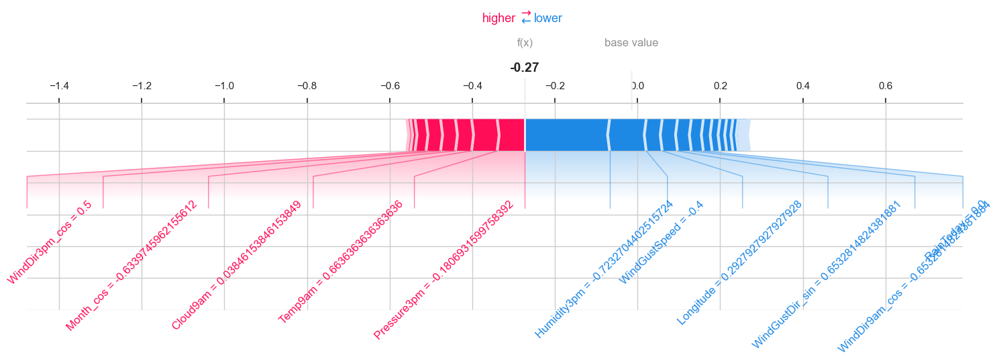

In [49]:
# Force Plot
shap.force_plot(explainer.expected_value, shap_values[index].values,
                X_test_escalado[index], feature_names=feature_names,
                matplotlib=True, figsize=(18, 4), text_rotation=45)

El gráfico de fuerza muestra cómo cada característica (feature, variable del modelo) contriuye a la predicción de una instancia específica, en este caso a la que tiene índice 0. Las barras de color magenta son las características que empujan la predicción hacia un valor más alto, que en este caso representarían una predicción de 'Yes' (día lluvioso). Las barras azules, por el contrario, son las características que empujan la predicción hacia un valor más bajo, es decir, un 'No' (día no lluvioso).

Se observa que la suma de las barras azules es mayor a la suma de las barras rojas, siendo la característica 'Humidity3pm' la que empuja la predicción más hacia la predicción 'No'. Siendo así, la predicción sobre esta instancia se inclina a ser la de un día no lluvioso, presentándose el valor final sobre la barra negra.

Se realiza un gráfico cascada (Waterfall Plot) sobre uno de los registros.

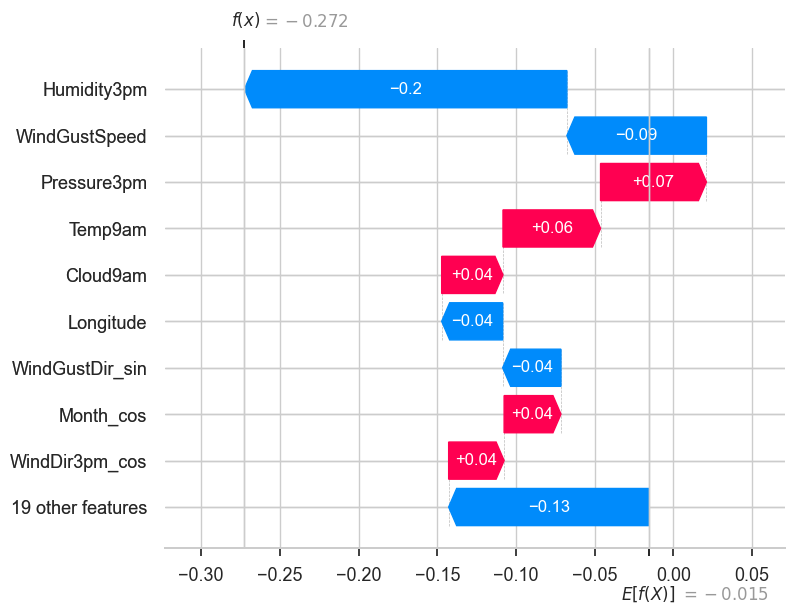

In [50]:
# Waterfall
explanation = shap.Explanation(values=shap_values[index].values,
                               base_values=explainer.expected_value,
                               feature_names=feature_names)
shap.plots.waterfall(explanation)

El gráfico de cascada muestra también la explicabilidad de cada característica sobre la predicción del modelo en la instancia especificada. El significado de los colores de las barras es identico al del gráfico de fuerza.

Rápidamente, se observa que 29 características poseen una explicación realmente baja sobre la predicción, acumulando tan solo un -0.01. Los aportes de las próximas 6 variables que se ecuentran por encima en el gráfico sobre la predicción es similiar en magnitud, pero son más las variables que empujan la predicción hacia un 'No'. Finalmente, la variable 'Pressure3pm' intenta llevar la predicción hacia el lado de 'Yes', pero no puede contra lo que se llevaba acumulado ni contra el peso de las variables 'Humidity3pm' y 'WindGustSpeed', que terminan de definir la explicabilidad hacia el lado de 'No'.

### Gráficos Globales

Se realiza un gráfico de importancia de características (Feature Importance Plot).

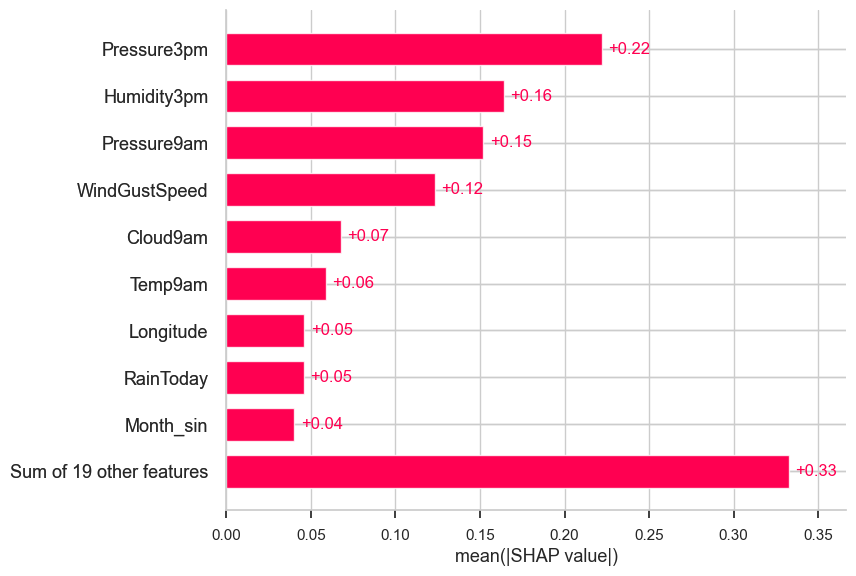

In [51]:
# Feature Importance
shap.plots.bar(shap_values)

El gráfico de barras anterior muestra las medias de los valores SHAP de cada característica y las ordena de mayor a menor.

Son 29 las características que sumadas explican casi el 44% del resultado de la predicción en promedio en el total de los datos. Sin embargo, se destaca la importancia de la variable 'Pressure3pm' en la explicabilidad de las predicciones globales, siendo en promedio del 23%. Otras variables que también tienen una relevancia muy alta en las predicciones son 'Humidity3pm', 'Pressure9am' y 'WindGustSpeed, con un 17%, 15% y 12% de explicabilidad promedio en los datos globales.

Se realiza un gráfico de enjambre de abejas (Bee Swarm Plot).

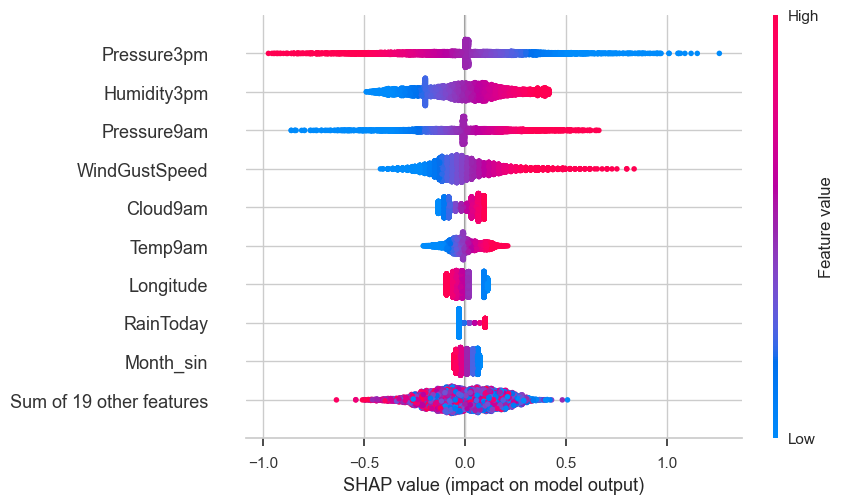

In [52]:
# Bee Swarm
shap.plots.beeswarm(shap_values)

El gráfico de enjambre de abejas muestra de cada característica los valores SHAP y los valores crudos de cada punto. Las características se ordenan de arriba hacia abajo, yendo de las que tienen mayor explicabilidad global promedio sobre las predicciones hacia las que tienen una menor. Los puntos que tienden al color rojo poseen valores crudos más altos, mientras que los puntos que tienden al color azul poseen valores crudos más bajos. Por otro lado, los puntos que se encuentran hacia la izquierda del eje central poseen valores SHAP negativos y los que se encuentran hacia la derecha del eje central poseen valores SHAP positivos.

Se interpretan algunos casos interesantes:
* La variable 'Pressure3pm' tiene una distribución de valores SHAP muy uniforme, donde los valores más bajos son las que tienen un SHAP más alto y visceversa. Esto se interpreta como que una baja presión a las 3 P.M. empuja la predicción hacia un día lluvioso y lo contrario para una alta presión. También se observa una alta concentración de puntos cerca del valor SHAP cero, indicando que muchos de los datos no influyen sobre la predicción.
* La variable 'Pressure9am' posee un comportamiento similar al caso anterior, con la excepción que en este caso los niveles alto de presión empujan la predicción hacia un día lluvioso y visceversa, presentando una explicación casi inversa que el caso anterior sobre las predicciones.
* La variable 'RainToday' tiene alta concentración de puntos en sus dos extremos, siendo el extremo izquierdo el que tiene mayor concentración. Del gráfico se podría interpretar que si el día de hoy no es lluvioso, la variable empujará la predicción hacia un día no lluvioso también. Lo contrario ocurre cuando la variable habla de que el día actual es lluvioso, sin embargo hay una concentración mejor. Esto quizá hable de que no siempre un día lluvioso en el día actual lleve a predecir un día lluvioso al día siguiente.
* La variable 'WindGustSpeed' muestra una alta concentración de puntos en torno a un valor de SHAP igual a 0, lo que indica que su explicación es relativamente baja sobre las predicciones en la mayoría de los casos. Por otro lado, los valores más altos de velocidad de viento tienden a empujar la predicción hacia un día lluvioso y lo contrario para velocidades de viento bajas.

## AutoML

In [58]:
# Hay que convertir en DataFrame los datos de entrenamiento y prueba para poder trabajar con PyCaret
X_train_balanced_df = pd.DataFrame(X_train_balanced)  
y_train_balanced_srl = pd.Series(y_train_balanced, name='target') 

train_data = pd.concat([X_train_balanced_df, y_train_balanced_srl], axis=1)

X_test_escalado_df = pd.DataFrame(X_test_escalado)

In [59]:
# Inicializar el entorno de clasificación
clf = setup(data = train_data, target = 'target')
#clf = setup(data = X_train, target = y_train.ravel())
cv = KFold(n_splits=5, shuffle=True, random_state=42)

# Crear, entrenar y comparar varios modelos
best_model = compare_models(fold=cv)
# Esta función entrena y evalúa el rendimiento de todos los estimadores disponibles en la biblioteca de modelos mediante validación cruzada.
# El resultado de esta función es una tabla con los puntajes promedio de la validación cruzada. Se puede acceder a las métricas evaluadas durante
# la validación cruzada mediante la función get_metrics. Se pueden agregar o eliminar métricas personalizadas mediante la función add_metric y remove_metric.

best_model_f1 = automl(optimize = 'F1', use_holdout = True)
# Esta función devuelve el mejor modelo de todos los entrenados en la sesión actual en función del parámetro "optimize".
# Se puede acceder a las métricas evaluadas mediante la función get_metrics.



,Description,Value
0,Session id,7221
1,Target,target
2,Target type,Binary
3,Target mapping,"No: 0, Yes: 1"
4,Original data shape,"(34434, 29)"
5,Transformed data shape,"(34434, 29)"
6,Transformed train set shape,"(24103, 29)"
7,Transformed test set shape,"(10331, 29)"
8,Numeric features,28
9,Preprocess,True


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
et,Extra Trees Classifier,0.8702,0.9344,0.8702,0.8710,0.8702,0.7404,0.7412,4.2920
rf,Random Forest Classifier,0.8515,0.9147,0.8515,0.8623,0.8504,0.7030,0.7136,11.0860
lightgbm,Light Gradient Boosting Machine,0.8407,0.8797,0.8407,0.8628,0.8382,0.6813,0.7031,1.1960
gbc,Gradient Boosting Classifier,0.8220,0.8688,0.8220,0.8459,0.8189,0.6439,0.6673,13.2660
ada,Ada Boost Classifier,0.7648,0.8296,0.7648,0.7696,0.7638,0.5296,0.5343,3.3260
dt,Decision Tree Classifier,0.7336,0.7336,0.7336,0.7339,0.7335,0.4671,0.4674,1.0640
knn,K Neighbors Classifier,0.6810,0.7690,0.6810,0.7134,0.6685,0.3621,0.3930,1.7100
qda,Quadratic Discriminant Analysis,0.5947,0.6289,0.5947,0.5963,0.5933,0.1896,0.1910,0.3300
ridge,Ridge Classifier,0.5782,0.6030,0.5782,0.5792,0.5773,0.1567,0.1575,0.2940
lda,Linear Discriminant Analysis,0.5782,0.6030,0.5782,0.5792,0.5773,0.1567,0.1575,0.2400


In [60]:
best_model_f1

ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='sqrt',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_samples_leaf=1,
                     min_samples_split=2, min_weight_fraction_leaf=0.0,
                     monotonic_cst=None, n_estimators=100, n_jobs=-1,
                     oob_score=False, random_state=7221, verbose=0,
                     warm_start=False)

El algoritmo Pycaret de AutoML entrena múltiples módelos de clasificación (en este caso) utilizando los datos de entrenamiento crudos, es decir, sin imputaciones, escalados o balanceos. Luego, evalúa distintas métricas y los ordena según una de ellas.

Algunos puntos a destacar, es que automáticamente reconoce cosas como:
* Tipo de target
* Cantidad de variables categóricas
* Cantidad de variables numéricas
* Cantidad de filas con valores nulos

En este caso, se configuró automáticamente para:
* Hacer un tipo de imputación simple
* Imputar variables numéricas por la media
* Imputar variables categóricas por la moda
* Usar StratifiedKFold como método de validación cruzada con 10 folds

Pycaret realizó un ensayo sobre 15 modelos, entre los cuales se destacó 'Extra Trees Classifier', ya que logró obtener los mejores resultados en todas las métricas evaluadas. El único aspecto en donde no fue superador es en el tiempo de ejecución, donde fue regular entre el resto de los ensayos, pero sigue siendo lo suficientemente bajo.

*Observación: El desempeño de Pycaret depende del entorno en donde sea ejecutado. Los resultados aqui exibidos fueron obtenidos ejecutando el script en la plataforma Google Colab®. Sin embargo la ejecución del mismo script fue realizada también en Visual Studio Code donde no solo el mejor modelo resultó ser otro sino que además las métricas obtenidas fueron más desfavorables.*

Ahora, se ensaya el modelo con los datos de prueba.

In [61]:
# Hacer predicciones sobre nuevos datos
# y_pred = predict_model(tuned_model, data=X_test)
y_pred = predict_model(best_model_f1, data=X_test_escalado_df)

# Calcular métricasa
accuracy_automl = accuracy_score(y_test, y_pred.prediction_label)

confusion_matrix_automl = confusion_matrix(y_test, y_pred.prediction_label)

classification_report_automl = classification_report(y_test, y_pred.prediction_label)

# Imprimir métricas
print("Métricas para AutoML:")
print(f'Exactitud: {accuracy_automl}')
print("Matriz de confusión:")
print(confusion_matrix_automl)
print("Reporte de clasificación:")
print(classification_report_automl)

Métricas para AutoML:
Exactitud: 0.7842264554032402
Matriz de confusión:
[[4095  207]
 [1005  310]]
Reporte de clasificación:
              precision    recall  f1-score   support

          No       0.80      0.95      0.87      4302
         Yes       0.60      0.24      0.34      1315

    accuracy                           0.78      5617
   macro avg       0.70      0.59      0.60      5617
weighted avg       0.76      0.78      0.75      5617



La exactitud de este modelo se encuentra entre las más altas ensayadas hasta el momento.

Desde la métrica de precisión, se observan valores altos para ambas clases. Esto indicaría que el modelo tiene una alta taza de éxito clasificando datos positivos cuando realmente lo son.

Sin embargo, desde el punto de vista de la exhaustividad, vemos otra cosa. La clase 'No' posee una exhaustividad muy alta, por lo que sus predicciones son muy fiables. Por el contrario, en el caso de la clase 'Yes' esta métrica es considerablemente más baja, del 25%. Esto significa que su valor no es confiable.

Finalmente, el F1-Score resume las métricas de precisión y exhaustividad, mostrando que la clase 'No' es la que será mejor predicha.

Todo lo visto es coherente con el desbalance del dataset. Pycaret no hace balanceo automáticamente y esto se refleja en un sesgo, por el cual el modelo tiende a predecir la clase mayoritaria con mayor frecuencia, lo que podría llevar a resultados inexactos donde la clase minoritaria es crucial (el caso del presente trabajo). Métricas como la precicisión pueden ser engañosas en este tipo de datasets ya que un modelo que siempre predice a la clase mayoritaria puede tener una alta precisión pero a su vez tener una baja exhaustividad para la clase minoritaria.

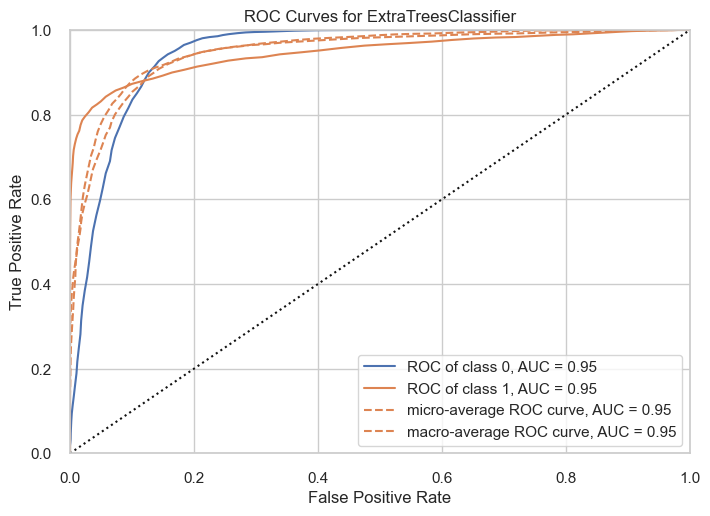

In [62]:
# Visualizar el gráfico ROC
plot_model(best_model_f1, plot='auc')

El área bajo la curva ROC es de 0.95. Se observa una diferencia significativa en comparación con los modelos de regresión logística.

## Red Neuronal

Para simplificar los ensayos de redes neuronales, creamos una clase que tuviera las principales funciones de creación, entrenamiento y prueba de las mismas.

In [63]:
class NeuralNetwork:
    def __init__(self, epochs=50, batch_size=16, learning_rate=0.01, dropout_rate=0, alpha=0.1, n1=10, n2=15, n3=10):
        #inicializo algunos parámetros como épocas, batch_size, learning rate
        #(no son necesarios)
        #se puede agregar la cantidad de capas, la cantidad de neuronas por capa (pensando en hacer una clase que pueda ser usada para cualquier caso)
        self.epochs = epochs
        self.batch_size = batch_size
        self.learning_rate = learning_rate
        self.dropout_rate = dropout_rate
        self.alpha = alpha
        self.n1 = n1
        self.n2 = n2
        self.n3 = n3
        self.model = None

    def build_model(self, input_shape, num_classes):
        # ejemplo con 3 capas ocultas de 10, 15 y 10 neuronas y activación sigmoidea a la salida (multiclase, recibe la cantidad de clases como input, además del input_shape)
        model = tf.keras.models.Sequential([
            tf.keras.layers.Dense(self.n1, activation='relu', input_shape=(input_shape,), kernel_regularizer=tf.keras.regularizers.l2(self.alpha)),
            tf.keras.layers.Dropout(self.dropout_rate),
            tf.keras.layers.Dense(self.n2, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(self.alpha)),
            tf.keras.layers.Dropout(self.dropout_rate),
            tf.keras.layers.Dense(self.n3, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(self.alpha)),
            tf.keras.layers.Dropout(self.dropout_rate),
            # tf.keras.layers.Dense(20, activation='leaky_relu', kernel_regularizer=tf.keras.regularizers.l2(self.alpha)),
            tf.keras.layers.Dense(num_classes, activation='sigmoid')
        ])

        #compilo el modelo con el optimizador Adam, la función de pérdida [categorical_crossentropy, binary_crossentropy, dice, tversky, categorical_focal_crossentropy, binary_focal_crossentropy] y la métrica [accuracy, binary_accuracy, categorical_accuracy, recall, precision]
        #totalmente optimizable e incluso pueden ser parámetros de la función build_model

        metrics = [ tf.keras.metrics.TruePositives(name='tp'),
                    tf.keras.metrics.FalsePositives(name='fp'),
                    tf.keras.metrics.TrueNegatives(name='tn'),
                    tf.keras.metrics.FalseNegatives(name='fn'),
                    tf.keras.metrics.BinaryAccuracy(name='accuracy'),
                    tf.keras.metrics.Precision(name='precision'),
                    tf.keras.metrics.Recall(name='recall'),
                    tf.keras.metrics.AUC(name='auc'),
                    tf.keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve
              ]

        optimizer = tf.keras.optimizers.Adam(learning_rate=self.learning_rate)
        model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=metrics)#[tf.keras.metrics.OneHotIoU(num_classes=num_classes, target_class_ids=list(range(num_classes)))])

        self.model = model

    def fit(self, X_train, y_train, X_valid, y_valid):
        # simplemente el fit del modelo. Devuelvo la evolución de la función de pérdida, ya que es interesante ver como varía a medida que aumentan las épocas!
        history=self.model.fit(X_train, y_train, validation_data=(X_valid, y_valid), epochs=self.epochs, batch_size=self.batch_size)
        return history.history['loss'], history.history['val_loss']

    def evaluate(self, X_test, y_test):
        ### evalúo en test
        loss, tp, fp, tn, fn, accuracy, precision, recall, auc, prc = self.model.evaluate(X_test, y_test)
        print(f"test loss: {loss:.4f}")
        print(f"test tp: {tp}")
        print(f"test fp: {fp}")
        print(f"test tn: {tn}")
        print(f"test fn: {fn}")
        print(f"test accuracy: {accuracy:.4f}")
        print(f"test precision: {precision:.4f}")
        print(f"test recall: {recall:.4f}")
        print(f"test auc: {auc:.4f}")
        print(f"test prc: {prc:.4f}")

    def predict(self, X_new):
        ### predicciones
        predictions = self.model.predict(X_new)
        return predictions

    def get_params(self, deep=True):
        return {
            'epochs': self.epochs,
            'batch_size': self.batch_size,
            'learning_rate': self.learning_rate,
            'dropout_rate': self.dropout_rate,
            'n1': self.n1,
            'n2': self.n2,
            'n3': self.n3,
        }

    def set_params(self, **parameters):
        for parameter, value in parameters.items():
            setattr(self, parameter, value)
        return self

    def save(self, filename):
        ## guarda el modelo
        self.model.save(filename)

    def load(self, filename):
        ## carga el modelo
        self.model = tf.keras.models.load_model(filename)

Lamentablemente por falta de experiencia, al principio de todo el trabajo, no se consideró dividir el set de datos en entrenamiento, prueba y validación, obviando la creación de este último. Siendo que las redes neuronales necesitan un conjunto de validación, necesitamos particionar los datos una vez más para obtenerlos y esto representa un gran problema: volver al principio del trabajo para dividir el dataset de esa manera significaría tener que reescribir todos los resultados obtenidos hasta el momento.

Es por este motivo, que se optó dividir los datos de entrenamiento para obtener datos de validación, *siendo concientes que esto introduce una fuga de datos*. Se supone que la fuga de datos no es algo tan grave en los datos de validación como si lo es con los datos de prueba.

En futuras experiencias, se contemplará dividir el dataset en entrenamiento, validación y pruebas desde un principio.

In [64]:
X_test_nn = X_test_escalado
y_test_nn_aux = y_test.reshape(-1,1)

# Dividimos el dataset de entrenamiento para conseguir datos de validación
X_train_nn, X_valid_nn, y_train_nn_aux, y_valid_nn_aux = train_test_split(X_train_balanced, y_train_balanced.reshape(-1,1), test_size=0.2, random_state=42)

Se crea y entrena la red neuronal.

In [65]:
nn = NeuralNetwork(epochs=300, batch_size=300, learning_rate=0.005, dropout_rate=0.3, alpha = 0.005, n1 = 25, n2 = 23, n3 = 21)

## en este caso tenemos 2 clases, por lo que necesitamos hacer una codificación en la salida, para este modelo en particular.
y_train_nn = np.where(y_train_nn_aux == 'Yes', 1, 0)
y_valid_nn = np.where(y_valid_nn_aux == 'Yes', 1, 0)
y_test_nn = np.where(y_test_nn_aux == 'Yes', 1, 0)

#buildeo el modelo
nn.build_model(input_shape=X_train_nn.shape[1], num_classes=y_train_nn.shape[1])

# entreno el modelo
history=nn.fit(X_train_nn, y_train_nn, X_valid_nn, y_valid_nn)

# # evaluo metricas
nn.evaluate(X_test_nn, y_test_nn)

Epoch 1/300
92/92 ━━━━━━━━━━━━━━━━━━━━ 14s 45ms/step - accuracy: 0.5124 - auc: 0.5148 - fn: 4018.8164 - fp: 2850.1736 - loss: 0.9547 - prc: 0.5177 - precision: 0.5176 - recall: 0.4614 - tn: 4230.3569 - tp: 3112.8367 - val_accuracy: 0.5436 - val_auc: 0.5776 - val_fn: 2649.0000 - val_fp: 494.0000 - val_loss: 0.7281 - val_prc: 0.5712 - val_precision: 0.6129 - val_recall: 0.2279 - val_tn: 2962.0000 - val_tp: 782.0000
Epoch 2/300
92/92 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step - accuracy: 0.5404 - auc: 0.5561 - fn: 4106.1392 - fp: 2772.6609 - loss: 0.7182 - prc: 0.5545 - precision: 0.5533 - recall: 0.4478 - tn: 4739.4263 - tp: 3451.2869 - val_accuracy: 0.5766 - val_auc: 0.5902 - val_fn: 1758.0000 - val_fp: 1158.0000 - val_loss: 0.6973 - val_prc: 0.5815 - val_precision: 0.5910 - val_recall: 0.4876 - val_tn: 2298.0000 - val_tp: 1673.0000
Epoch 3/300
92/92 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - accuracy: 0.5554 - auc: 0.5762 - fn: 3823.0203 - fp: 2489.0708 - loss: 0.6977 - prc: 0.5644 - precision: 0.5651

Se carga el mejor modelo de clasificación obtenido con redes neuronales.

In [66]:
# # Definir el ID del archivo
# file_id = '1C6p8zqd0eVBLEuoYvaRfw3PQUuQ5HvwR'

# # Crear la URL de descarga
# download_url = f'https://drive.google.com/uc?id={file_id}'

# # Descargar el archivo
# output = 'red_neuronal.keras'
# gdown.download(download_url, output, quiet=True)

# # Crear el modelo
# nn = NeuralNetwork()

# # Cargar el modelo
# nn.load('red_neuronal.keras')

Luego, se evalúa el desempeño del modelo de redes neuronales.

In [67]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

# Realizar predicciones en el conjunto de prueba
y_pred_nn = nn.predict(X_test_nn)

# Convertir a 'Yes' y 'No'
y_test_nn_conv = np.where(y_test_nn == 1, 'Yes', 'No')
y_pred_nn_conv = np.where(y_pred_nn[:] < 0.5, 'No', 'Yes')

# Calcular métricas
accuracy_nn = accuracy_score(y_test_nn_conv, y_pred_nn_conv)

confusion_matrix_nn = confusion_matrix(y_test_nn_conv, y_pred_nn_conv)

classification_report_nn = classification_report(y_test_nn_conv, y_pred_nn_conv)

# Imprimir métricas
print("Métricas para Red Neuronal:")
print(f'Exactitud: {accuracy_nn}')
print("Matriz de confusión:")
print(confusion_matrix_nn)
print("Reporte de clasificación:")
print(classification_report_nn)

176/176 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
Métricas para Red Neuronal:
Exactitud: 0.7224497062488873
Matriz de confusión:
[[2934 1368]
 [ 191 1124]]
Reporte de clasificación:
              precision    recall  f1-score   support

          No       0.94      0.68      0.79      4302
         Yes       0.45      0.85      0.59      1315

    accuracy                           0.72      5617
   macro avg       0.69      0.77      0.69      5617
weighted avg       0.82      0.72      0.74      5617



La exactitud en este modelo es moderada a alta, sin embargo es importante recordar que los datos de prueba no se encuentran balanceados, por lo que usar esta métrica no sería la mejor opción de evaluación de desempeño

Si nos paramos en la métrica de precisión (precision), observamos que es muy alta para el caso de días no lluviosos y media-baja para los días lluviosos. Vemos que el modelo es muy preciso a la hora de predecir los días no lluviosos, pero tiene una alta tasa de falsos positivos para los días lluviosos.

Ahora, desde el punto de vista de la exhaustividad (recall), vemos que ambas clases tienen valores similares y moderados. De esta manera, el porcentaje de datos clasificados correctamente dentro de cada clase son muy parecidos.

Finalmente, el F1-Score que toma en cuenta tanto la precisión como la exhaustividad, muestra un buen rendimiento para la clase de días no lluviosos y moderada-baja para la clase de días lluviosos.

Se calcula luego la curva ROC y sus parámetros más importantes.

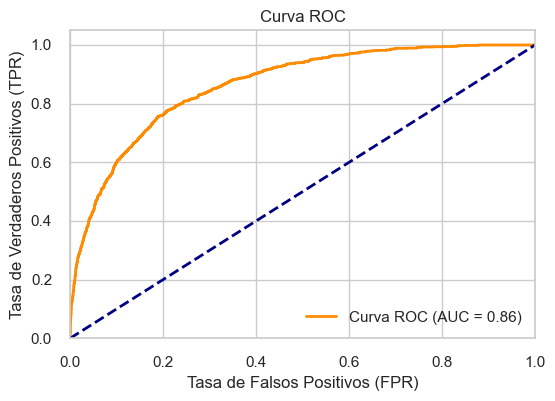

Umbral óptimo: 0.5318883657455444
FPR óptimo: 0.2101348210134821
TPR óptimo: 0.7779467680608365


In [68]:
# Curva ROC

# Calculo la ROC y el AUC
fpr, tpr, thresholds = roc_curve(y_test, y_pred_nn, pos_label='Yes')
roc_auc = auc(fpr, tpr)

# Grafico la curva ROC
plt.figure(figsize=(6, 4))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='Curva ROC (AUC = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Tasa de Falsos Positivos (FPR)')
plt.ylabel('Tasa de Verdaderos Positivos (TPR)')
plt.title('Curva ROC')
plt.legend(loc="lower right")
plt.show()

# Encontrar el punto óptimo (Youden's J statistic)
optimal_idx = np.argmax(tpr - fpr)
optimal_threshold = thresholds[optimal_idx]
optimal_fpr = fpr[optimal_idx]
optimal_tpr = tpr[optimal_idx]

print(f"Umbral óptimo: {optimal_threshold}")
print(f"FPR óptimo: {optimal_fpr}")
print(f"TPR óptimo: {optimal_tpr}")

El área bajo la curva (AUC) es ligeramente menor a las evaluaciones hechas con regresiones lineales (0.84 contra ~0.87), per no lo consideramos significativo. El umbral óptimo se encuentra en 0.52, muy cercano al valor por defecto.

### Optimización de Hiperparámetros con Optuna

Se realiza ahora la optimización de hiperparámetros utilizando Optuna.

Se decide optimizar los siguientes hiperparámetros:
* learning_rate: Ritmo de aprendizaje para la función de optimización.
* dropout_rate: Probabilidad de eliminación de conexiones.
* n1: Cantidad de neuronas en capa 1.
* n2: Cantidad de neuronas en capa 2.
* n3: Cantidad de neuronas en capa 3.

In [69]:
# Se define la función objetivo, en este caso, calculando la exactitud
def objective(trial):
  # Se definen los hiperparámetros a ensayar
  epochs = trial.suggest_int("epochs", 50, 50)
  batch_size = trial.suggest_int("batch_size", 300, 300)
  learning_rate = trial.suggest_categorical("learning_rate", [0.001, 0.01, 0.1])
  dropout_rate = trial.suggest_categorical("dropout_rate", [0.2, 0.3, 0.4])
  n1 = trial.suggest_categorical("n1", [10, 15, 20, 25, 30])
  n2 = trial.suggest_categorical("n2", [10, 15, 20, 25, 30])
  n3 = trial.suggest_categorical("n3", [10, 15, 20, 25, 30])

  # Se crea el modelo
  clf = NeuralNetwork(epochs=epochs, batch_size=batch_size, learning_rate=learning_rate, dropout_rate=dropout_rate, n1=n1, n2=n2, n3=n3)

  # Dividir los datos en entrenamiento y validación
  cv = StratifiedKFold(n_splits=5)

  scores = []
  for train_index, test_index in cv.split(X_train_balanced, y_train_balanced):
    X_train_fold, X_valid_fold = X_train_balanced[train_index], X_train_balanced[test_index]
    y_train_fold, y_valid_fold = y_train_balanced[train_index], y_train_balanced[test_index]

    y_train_fold = np.where(y_train_fold == 'Yes', 1, 0)
    y_valid_fold = np.where(y_valid_fold == 'Yes', 1, 0)

    y_train_fold = y_train_fold.reshape(-1,1)
    y_valid_fold = y_valid_fold.reshape(-1,1)

    print("X_train_fold shape:", X_train_fold.shape)
    print("y_train_fold shape:", y_train_fold.shape)

    # Se construye el modelo
    clf.build_model(input_shape=X_train_fold.shape[1], num_classes=y_train_fold.shape[1])

    # Se entrena el modelo
    clf.fit(X_train_fold, y_train_fold, X_valid_fold, y_valid_fold)

    # Se predice y calculan las métricas
    y_pred_fold = clf.predict(X_valid_fold)
    y_pred_fold = np.where(y_pred_fold[:] < 0.5, 0, 1)
    scores.append(f1_score(y_valid_fold, y_pred_fold, average='macro'))

  return np.mean(scores)

# Se crea un caso de estudio
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=10)

# Se obtiene el mejor resultado
trial = study.best_trial

print("\nExactitud: {}".format(trial.value))
print("\nMejores hiperparámetros: {}".format(trial.params))

[I 2024-11-27 11:47:13,580] A new study created in memory with name: no-name-e46da2c1-e429-4847-9437-3196f83b311b


X_train_fold shape: (27547, 28)
y_train_fold shape: (27547, 1)
Epoch 1/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 14s 55ms/step - accuracy: 0.4983 - auc: 0.5012 - fn: 4396.2295 - fp: 2918.6147 - loss: 1.1381 - prc: 0.5054 - precision: 0.4987 - recall: 0.4058 - tn: 4357.3672 - tp: 2891.9541 - val_accuracy: 0.5001 - val_auc: 0.5000 - val_fn: 0.0000e+00 - val_fp: 3443.0000 - val_loss: 0.6932 - val_prc: 0.5001 - val_precision: 0.5001 - val_recall: 1.0000 - val_tn: 0.0000e+00 - val_tp: 3444.0000
Epoch 2/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - accuracy: 0.5109 - auc: 0.5056 - fn: 2450.0000 - fp: 4210.9639 - loss: 0.6932 - prc: 0.5069 - precision: 0.5098 - recall: 0.7094 - tn: 2558.1082 - tp: 4350.2432 - val_accuracy: 0.5001 - val_auc: 0.5000 - val_fn: 0.0000e+00 - val_fp: 3443.0000 - val_loss: 0.6946 - val_prc: 0.5001 - val_precision: 0.5001 - val_recall: 1.0000 - val_tn: 0.0000e+00 - val_tp: 3444.0000
Epoch 3/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - accuracy: 0.5005 - auc: 0.4963 - fn: 3381.587

[I 2024-11-27 11:56:39,029] Trial 0 finished with value: 0.3333204253191607 and parameters: {'epochs': 50, 'batch_size': 300, 'learning_rate': 0.1, 'dropout_rate': 0.4, 'n1': 10, 'n2': 10, 'n3': 30}. Best is trial 0 with value: 0.3333204253191607.


X_train_fold shape: (27547, 28)
y_train_fold shape: (27547, 1)
Epoch 1/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 12s 41ms/step - accuracy: 0.5031 - auc: 0.5044 - fn: 3806.8000 - fp: 3186.3474 - loss: 1.4996 - prc: 0.5046 - precision: 0.5030 - recall: 0.4467 - tn: 3860.0210 - tp: 3207.8210 - val_accuracy: 0.5001 - val_auc: 0.5000 - val_fn: 0.0000e+00 - val_fp: 3443.0000 - val_loss: 0.6968 - val_prc: 0.5001 - val_precision: 0.5001 - val_recall: 1.0000 - val_tn: 0.0000e+00 - val_tp: 3444.0000
Epoch 2/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - accuracy: 0.4995 - auc: 0.4972 - fn: 3667.2783 - fp: 3610.6494 - loss: 0.6951 - prc: 0.4961 - precision: 0.4954 - recall: 0.4989 - tn: 3695.5464 - tp: 3586.2578 - val_accuracy: 0.4999 - val_auc: 0.5000 - val_fn: 3444.0000 - val_fp: 0.0000e+00 - val_loss: 0.6936 - val_prc: 0.5001 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_tn: 3443.0000 - val_tp: 0.0000e+00
Epoch 3/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - accuracy: 0.5052 - auc: 0.4990 - fn: 

[I 2024-11-27 12:04:39,068] Trial 1 finished with value: 0.333333332083949 and parameters: {'epochs': 50, 'batch_size': 300, 'learning_rate': 0.1, 'dropout_rate': 0.4, 'n1': 20, 'n2': 20, 'n3': 15}. Best is trial 1 with value: 0.333333332083949.


X_train_fold shape: (27547, 28)
y_train_fold shape: (27547, 1)
Epoch 1/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 10s 42ms/step - accuracy: 0.5044 - auc: 0.5098 - fn: 3189.8494 - fp: 3744.5591 - loss: 6.4048 - prc: 0.5106 - precision: 0.4991 - recall: 0.5625 - tn: 3330.6990 - tp: 3830.5269 - val_accuracy: 0.5293 - val_auc: 0.5399 - val_fn: 2230.0000 - val_fp: 1012.0000 - val_loss: 3.7346 - val_prc: 0.5417 - val_precision: 0.5454 - val_recall: 0.3525 - val_tn: 2431.0000 - val_tp: 1214.0000
Epoch 2/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.5177 - auc: 0.5238 - fn: 4898.0503 - fp: 1966.9395 - loss: 3.1962 - prc: 0.5344 - precision: 0.5331 - recall: 0.3296 - tn: 5138.0405 - tp: 2301.9597 - val_accuracy: 0.5271 - val_auc: 0.5467 - val_fn: 2817.0000 - val_fp: 440.0000 - val_loss: 1.9760 - val_prc: 0.5488 - val_precision: 0.5876 - val_recall: 0.1821 - val_tn: 3003.0000 - val_tp: 627.0000
Epoch 3/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.5288 - auc: 0.5454 - fn: 5551.9497 - fp: 

[I 2024-11-27 12:10:51,260] Trial 2 finished with value: 0.33334623884873726 and parameters: {'epochs': 50, 'batch_size': 300, 'learning_rate': 0.001, 'dropout_rate': 0.2, 'n1': 30, 'n2': 15, 'n3': 20}. Best is trial 2 with value: 0.33334623884873726.


X_train_fold shape: (27547, 28)
y_train_fold shape: (27547, 1)
Epoch 1/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 10s 35ms/step - accuracy: 0.5194 - auc: 0.5232 - fn: 3326.0100 - fp: 3414.3635 - loss: 5.1814 - prc: 0.5225 - precision: 0.5182 - recall: 0.5223 - tn: 3643.8081 - tp: 3735.9597 - val_accuracy: 0.5435 - val_auc: 0.5521 - val_fn: 1808.0000 - val_fp: 1336.0000 - val_loss: 3.1459 - val_prc: 0.5508 - val_precision: 0.5505 - val_recall: 0.4750 - val_tn: 2107.0000 - val_tp: 1636.0000
Epoch 2/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.5256 - auc: 0.5352 - fn: 3670.8000 - fp: 2863.3999 - loss: 2.7429 - prc: 0.5323 - precision: 0.5280 - recall: 0.4666 - tn: 4053.8000 - tp: 3228.9399 - val_accuracy: 0.5275 - val_auc: 0.5486 - val_fn: 1208.0000 - val_fp: 2046.0000 - val_loss: 1.7725 - val_prc: 0.5460 - val_precision: 0.5222 - val_recall: 0.6492 - val_tn: 1397.0000 - val_tp: 2236.0000
Epoch 3/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.5229 - auc: 0.5341 - fn: 3537.5400 - fp

[I 2024-11-27 12:22:08,130] Trial 3 finished with value: 0.333333332083949 and parameters: {'epochs': 50, 'batch_size': 300, 'learning_rate': 0.001, 'dropout_rate': 0.3, 'n1': 25, 'n2': 10, 'n3': 25}. Best is trial 2 with value: 0.33334623884873726.


X_train_fold shape: (27547, 28)
y_train_fold shape: (27547, 1)
Epoch 1/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 15s 55ms/step - accuracy: 0.5136 - auc: 0.5171 - fn: 4472.6528 - fp: 2471.2842 - loss: 2.3872 - prc: 0.5170 - precision: 0.5192 - recall: 0.3573 - tn: 4638.5581 - tp: 2573.2317 - val_accuracy: 0.5001 - val_auc: 0.5000 - val_fn: 0.0000e+00 - val_fp: 3443.0000 - val_loss: 0.6936 - val_prc: 0.5001 - val_precision: 0.5001 - val_recall: 1.0000 - val_tn: 0.0000e+00 - val_tp: 3444.0000
Epoch 2/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - accuracy: 0.4992 - auc: 0.5009 - fn: 1966.6337 - fp: 5227.9307 - loss: 0.6933 - prc: 0.5031 - precision: 0.5000 - recall: 0.7968 - tn: 1919.0198 - tp: 5205.1685 - val_accuracy: 0.4999 - val_auc: 0.5000 - val_fn: 3444.0000 - val_fp: 0.0000e+00 - val_loss: 0.6931 - val_prc: 0.5001 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_tn: 3443.0000 - val_tp: 0.0000e+00
Epoch 3/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - accuracy: 0.4990 - auc: 0.4997 - fn: 

[I 2024-11-27 12:34:33,680] Trial 4 finished with value: 0.333333332083949 and parameters: {'epochs': 50, 'batch_size': 300, 'learning_rate': 0.01, 'dropout_rate': 0.2, 'n1': 15, 'n2': 10, 'n3': 30}. Best is trial 2 with value: 0.33334623884873726.


X_train_fold shape: (27547, 28)
y_train_fold shape: (27547, 1)
Epoch 1/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 14s 53ms/step - accuracy: 0.4980 - auc: 0.5062 - fn: 3150.7634 - fp: 3907.4624 - loss: 6.8911 - prc: 0.5210 - precision: 0.4990 - recall: 0.5862 - tn: 3132.2258 - tp: 3905.1829 - val_accuracy: 0.5110 - val_auc: 0.5089 - val_fn: 3175.0000 - val_fp: 193.0000 - val_loss: 3.9996 - val_prc: 0.5192 - val_precision: 0.5823 - val_recall: 0.0781 - val_tn: 3250.0000 - val_tp: 269.0000
Epoch 2/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.5184 - auc: 0.5173 - fn: 5358.4194 - fp: 1423.3656 - loss: 3.4289 - prc: 0.5321 - precision: 0.5384 - recall: 0.2563 - tn: 5621.0430 - tp: 1692.8064 - val_accuracy: 0.5149 - val_auc: 0.5227 - val_fn: 3182.0000 - val_fp: 159.0000 - val_loss: 2.0969 - val_prc: 0.5316 - val_precision: 0.6223 - val_recall: 0.0761 - val_tn: 3284.0000 - val_tp: 262.0000
Epoch 3/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.5205 - auc: 0.5189 - fn: 6093.5254 - fp: 

[I 2024-11-27 12:46:52,793] Trial 5 finished with value: 0.33330751855437235 and parameters: {'epochs': 50, 'batch_size': 300, 'learning_rate': 0.001, 'dropout_rate': 0.4, 'n1': 25, 'n2': 20, 'n3': 25}. Best is trial 2 with value: 0.33334623884873726.


X_train_fold shape: (27547, 28)
y_train_fold shape: (27547, 1)
Epoch 1/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 20s 72ms/step - accuracy: 0.5164 - auc: 0.5244 - fn: 3471.8218 - fp: 3654.3367 - loss: 2.0376 - prc: 0.5324 - precision: 0.5197 - recall: 0.5496 - tn: 3588.0496 - tp: 3851.0791 - val_accuracy: 0.4999 - val_auc: 0.5000 - val_fn: 3444.0000 - val_fp: 0.0000e+00 - val_loss: 0.6947 - val_prc: 0.5001 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_tn: 3443.0000 - val_tp: 0.0000e+00
Epoch 2/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 6s 22ms/step - accuracy: 0.4985 - auc: 0.4953 - fn: 2995.8835 - fp: 4027.9028 - loss: 0.6937 - prc: 0.4984 - precision: 0.4703 - recall: 0.5221 - tn: 2964.6892 - tp: 4026.0291 - val_accuracy: 0.5001 - val_auc: 0.5000 - val_fn: 0.0000e+00 - val_fp: 3443.0000 - val_loss: 0.6932 - val_prc: 0.5001 - val_precision: 0.5001 - val_recall: 1.0000 - val_tn: 0.0000e+00 - val_tp: 3444.0000
Epoch 3/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - accuracy: 0.5014 - auc: 0.4974 - fn: 

[I 2024-11-27 13:00:43,493] Trial 6 finished with value: 0.3333591456135256 and parameters: {'epochs': 50, 'batch_size': 300, 'learning_rate': 0.01, 'dropout_rate': 0.3, 'n1': 10, 'n2': 10, 'n3': 15}. Best is trial 6 with value: 0.3333591456135256.


X_train_fold shape: (27547, 28)
y_train_fold shape: (27547, 1)
Epoch 1/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 14s 54ms/step - accuracy: 0.5010 - auc: 0.5028 - fn: 3681.6345 - fp: 3367.3225 - loss: 2.8516 - prc: 0.5031 - precision: 0.5011 - recall: 0.4693 - tn: 3678.3118 - tp: 3368.3655 - val_accuracy: 0.5001 - val_auc: 0.5000 - val_fn: 0.0000e+00 - val_fp: 3443.0000 - val_loss: 0.6935 - val_prc: 0.5001 - val_precision: 0.5001 - val_recall: 1.0000 - val_tn: 0.0000e+00 - val_tp: 3444.0000
Epoch 2/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 2s 20ms/step - accuracy: 0.4976 - auc: 0.4950 - fn: 2728.9810 - fp: 4596.4668 - loss: 0.6933 - prc: 0.4981 - precision: 0.4992 - recall: 0.7170 - tn: 2659.6858 - tp: 4562.4287 - val_accuracy: 0.4999 - val_auc: 0.5000 - val_fn: 3444.0000 - val_fp: 0.0000e+00 - val_loss: 0.6932 - val_prc: 0.5001 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_tn: 3443.0000 - val_tp: 0.0000e+00
Epoch 3/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step - accuracy: 0.5010 - auc: 0.4975 - fn: 

[I 2024-11-27 13:11:36,590] Trial 7 finished with value: 0.3333204253191607 and parameters: {'epochs': 50, 'batch_size': 300, 'learning_rate': 0.01, 'dropout_rate': 0.4, 'n1': 20, 'n2': 25, 'n3': 15}. Best is trial 6 with value: 0.3333591456135256.


X_train_fold shape: (27547, 28)
y_train_fold shape: (27547, 1)
Epoch 1/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 15s 58ms/step - accuracy: 0.4971 - auc: 0.4969 - fn: 3951.7573 - fp: 3134.5535 - loss: 2.7869 - prc: 0.5029 - precision: 0.4958 - recall: 0.3812 - tn: 3887.4077 - tp: 3090.3010 - val_accuracy: 0.4999 - val_auc: 0.5000 - val_fn: 3444.0000 - val_fp: 0.0000e+00 - val_loss: 0.6936 - val_prc: 0.5001 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_tn: 3443.0000 - val_tp: 0.0000e+00
Epoch 2/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - accuracy: 0.4989 - auc: 0.4973 - fn: 3213.2278 - fp: 3780.7524 - loss: 0.6934 - prc: 0.5029 - precision: 0.5026 - recall: 0.5304 - tn: 3171.2673 - tp: 3779.2476 - val_accuracy: 0.5001 - val_auc: 0.5000 - val_fn: 0.0000e+00 - val_fp: 3443.0000 - val_loss: 0.6932 - val_prc: 0.5001 - val_precision: 0.5001 - val_recall: 1.0000 - val_tn: 0.0000e+00 - val_tp: 3444.0000
Epoch 3/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - accuracy: 0.5004 - auc: 0.4994 - fn: 

[I 2024-11-27 13:25:23,210] Trial 8 finished with value: 0.3333204253191607 and parameters: {'epochs': 50, 'batch_size': 300, 'learning_rate': 0.01, 'dropout_rate': 0.4, 'n1': 25, 'n2': 30, 'n3': 10}. Best is trial 6 with value: 0.3333591456135256.


X_train_fold shape: (27547, 28)
y_train_fold shape: (27547, 1)
Epoch 1/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 10s 36ms/step - accuracy: 0.4962 - auc: 0.4834 - fn: 4216.9175 - fp: 2936.5259 - loss: 5.1382 - prc: 0.4938 - precision: 0.4915 - recall: 0.3589 - tn: 4175.0410 - tp: 2900.3196 - val_accuracy: 0.4982 - val_auc: 0.5026 - val_fn: 601.0000 - val_fp: 2855.0000 - val_loss: 3.1623 - val_prc: 0.5062 - val_precision: 0.4989 - val_recall: 0.8255 - val_tn: 588.0000 - val_tp: 2843.0000
Epoch 2/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step - accuracy: 0.5017 - auc: 0.5058 - fn: 1930.4056 - fp: 5180.8398 - loss: 2.7602 - prc: 0.5122 - precision: 0.5011 - recall: 0.7225 - tn: 1914.4340 - tp: 5144.0757 - val_accuracy: 0.5005 - val_auc: 0.5091 - val_fn: 222.0000 - val_fp: 3218.0000 - val_loss: 1.8202 - val_prc: 0.5131 - val_precision: 0.5003 - val_recall: 0.9355 - val_tn: 225.0000 - val_tp: 3222.0000
Epoch 3/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.5009 - auc: 0.5102 - fn: 2200.9785 - fp: 

[I 2024-11-27 13:38:54,245] Trial 9 finished with value: 0.333333332083949 and parameters: {'epochs': 50, 'batch_size': 300, 'learning_rate': 0.001, 'dropout_rate': 0.2, 'n1': 25, 'n2': 10, 'n3': 15}. Best is trial 6 with value: 0.3333591456135256.



Exactitud: 0.3333591456135256

Mejores hiperparámetros: {'epochs': 50, 'batch_size': 300, 'learning_rate': 0.01, 'dropout_rate': 0.3, 'n1': 10, 'n2': 10, 'n3': 15}


Los mejores hiperparámetros resultan ser:

{'epochs': 50, 'batch_size': 300, 'learning_rate': 0.01, 'dropout_rate': 0.3, 'n1': 20, 'n2': 20, 'n3': 15}

Muy cercanos a los utilizados en el modelo configurado anteriormente.

Se grafica la historia de optimización del modelo.

In [70]:
optuna.visualization.plot_optimization_history(study)

Se grafican las exactitudes para cada hiperparámetro para cada prueba.

In [71]:
optuna.visualization.plot_slice(study)

In [72]:
# Obtener el mejor estimador
best_nn = NeuralNetwork(**trial.params)

# Se construye el modelo
best_nn.build_model(input_shape=X_train_nn.shape[1], num_classes=y_train_nn.shape[1])

# Se entrena el modelo
best_nn.fit(X_train_nn, y_train_nn, X_valid_nn, y_valid_nn)

# Realizar predicciones en el conjunto de prueba
y_pred_nn = best_nn.predict(X_test_nn)

# Convertir a 'Yes' y 'No'
y_test_nn_conv = np.where(y_test_nn == 1, 'Yes', 'No')
y_pred_nn_conv = np.where(y_pred_nn[:] < 0.5, 'No', 'Yes')

# Calcular métricas
accuracy_nn = accuracy_score(y_test_nn_conv, y_pred_nn_conv)

confusion_matrix_nn = confusion_matrix(y_test_nn_conv, y_pred_nn_conv)

classification_report_nn = classification_report(y_test_nn_conv, y_pred_nn_conv)

# Imprimir métricas
print("Métricas para red neuronal optimizada:")
print(f'Exactitud: {accuracy_nn}')
print("Matriz de confusión:")
print(confusion_matrix_nn)
print("Reporte de clasificación:")
print(classification_report_nn)

Epoch 1/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 9s 30ms/step - accuracy: 0.5026 - auc: 0.5044 - fn: 3877.4841 - fp: 3241.3789 - loss: 2.0015 - prc: 0.5132 - precision: 0.5052 - recall: 0.4741 - tn: 3895.3684 - tp: 3280.4421 - val_accuracy: 0.4982 - val_auc: 0.5000 - val_fn: 0.0000e+00 - val_fp: 3456.0000 - val_loss: 0.6935 - val_prc: 0.4982 - val_precision: 0.4982 - val_recall: 1.0000 - val_tn: 0.0000e+00 - val_tp: 3431.0000
Epoch 2/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.5028 - auc: 0.5016 - fn: 2626.1924 - fp: 4623.6826 - loss: 0.6934 - prc: 0.5057 - precision: 0.5043 - recall: 0.7208 - tn: 2588.0288 - tp: 4650.5000 - val_accuracy: 0.5018 - val_auc: 0.5000 - val_fn: 3431.0000 - val_fp: 0.0000e+00 - val_loss: 0.6931 - val_prc: 0.4982 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_tn: 3456.0000 - val_tp: 0.0000e+00
Epoch 3/50
92/92 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.4980 - auc: 0.4945 - fn: 3545.5613 - fp: 3573.0205 - loss: 0.6932 - prc: 0.4956 - precision

In [73]:
nn.save('nn.keras')
best_nn.save('best_nn.keras')

Nuevamente, la métrica de exactitud se desestimará ya que los datos de prueba no están balanceados.

Desde el punto de vista de la precisión, la clase 'No' tiene una métrica casi perfecta, mientras que para la clase 'Yes' se observa nuevamente que tiene una tasa muy alta de falsos positivos.

Desde el punto de vista de la exhaustividad se ve algo inusual, es la clase 'No' la que muestra peores métricas, clasificando correctamente únicamente casi la mitad de los datos. Por otro lado, la clase 'Yes' logra clasificar correctamente la mayoría de los datos.

Finalmente, la medida resumen de F1-Score, presenta valores no realmente buenos para ninguna de las dos clases, como es de esperar en base a sus precisiones y exhaustividades.

### Explicabilidad

#### Definición del explicador

Se define el explicador usando de base el modelo de redes neuronales obtenido tras la optimización de hiperparámetros.

In [74]:
# Definiciones
index = 0
feature_names = X_test_modified.columns

# Creación del explicador en base al modelo obtenido
explainer = shap.Explainer(nn.predict, X_train_balanced, feature_names=feature_names)#, max_evals=75)
shap_values = explainer(X_test_escalado)

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   0%|          | 1/5617 [00:00<?, ?it/s]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   0%|          | 3/5617 [00:36<11:11:01,  7.17s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:   0%|          | 4/5617 [00:46<13:13:19,  8.48s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:   0%|          | 5/5617 [01:01<16:39:48, 10.69s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   0%|          | 6/5617 [01:14<18:09:34, 11.65s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:   0%|          | 7/5617 [01:23<16:32:52, 10.62s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:   0%|          | 8/5617 [01:31<15:37:55, 10.03s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   0%|          | 9/5617 [01:39<14:37:36,  9.39s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   0%|          | 10/5617 [01:49<14:31:38,  9.33s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   0%|          | 11/5617 [01:57<13:57:52,  8.97s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   0%|          | 12/5617 [02:05<13:39:47,  8.78s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   0%|          | 13/5617 [02:14<13:33:47,  8.71s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   0%|          | 14/5617 [02:23<13:37:09,  8.75s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   0%|          | 15/5617 [02:30<12:59:28,  8.35s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   0%|          | 16/5617 [02:39<13:08:14,  8.44s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   0%|          | 17/5617 [02:46<12:49:34,  8.25s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   0%|          | 18/5617 [02:55<12:53:16,  8.29s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:   0%|          | 19/5617 [03:03<12:47:06,  8.22s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   0%|          | 20/5617 [03:10<12:08:35,  7.81s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   0%|          | 21/5617 [03:16<11:39:08,  7.50s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   0%|          | 22/5617 [03:24<11:36:59,  7.47s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   0%|          | 23/5617 [03:32<11:52:07,  7.64s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   0%|          | 24/5617 [03:40<12:17:16,  7.91s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   0%|          | 25/5617 [03:49<12:35:57,  8.11s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   0%|          | 26/5617 [03:57<12:36:44,  8.12s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   0%|          | 27/5617 [04:05<12:31:12,  8.06s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   0%|          | 28/5617 [04:13<12:19:51,  7.94s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   1%|          | 29/5617 [04:22<12:45:19,  8.22s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|          | 30/5617 [04:29<12:20:26,  7.95s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|          | 31/5617 [04:37<12:21:45,  7.97s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|          | 32/5617 [04:45<12:32:09,  8.08s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   1%|          | 33/5617 [04:54<12:48:49,  8.26s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   1%|          | 34/5617 [05:01<12:24:38,  8.00s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   1%|          | 35/5617 [05:12<13:34:23,  8.75s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|          | 36/5617 [05:20<13:15:09,  8.55s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|          | 37/5617 [05:29<13:21:56,  8.62s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   1%|          | 38/5617 [05:37<13:15:15,  8.55s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   1%|          | 39/5617 [05:46<13:27:53,  8.69s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|          | 40/5617 [05:56<13:50:27,  8.93s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   1%|          | 41/5617 [06:03<13:06:25,  8.46s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|          | 42/5617 [06:13<13:50:09,  8.93s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   1%|          | 43/5617 [06:21<13:11:24,  8.52s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|          | 44/5617 [06:29<13:13:11,  8.54s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   1%|          | 45/5617 [06:36<12:33:49,  8.12s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   1%|          | 46/5617 [06:44<12:31:00,  8.09s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|          | 47/5617 [06:52<12:30:57,  8.09s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|          | 48/5617 [07:00<12:21:15,  7.99s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   1%|          | 49/5617 [07:08<12:15:06,  7.92s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   1%|          | 50/5617 [07:14<11:33:34,  7.48s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   1%|          | 51/5617 [07:22<11:39:11,  7.54s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|          | 52/5617 [07:31<12:15:06,  7.93s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:   1%|          | 53/5617 [07:39<12:22:27,  8.01s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|          | 54/5617 [07:47<12:14:44,  7.92s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:   1%|          | 55/5617 [07:55<12:17:23,  7.95s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   1%|          | 56/5617 [08:03<12:33:17,  8.13s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|          | 57/5617 [08:11<12:20:04,  7.99s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   1%|          | 58/5617 [08:20<12:36:51,  8.17s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|          | 59/5617 [08:28<12:54:47,  8.36s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|          | 60/5617 [08:37<12:48:50,  8.30s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 940us/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 927us/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|          | 61/5617 [08:45<12:47:32,  8.29s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   1%|          | 62/5617 [08:53<12:32:53,  8.13s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|          | 63/5617 [09:01<12:26:41,  8.07s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   1%|          | 64/5617 [09:09<12:38:37,  8.20s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|          | 65/5617 [09:17<12:32:43,  8.13s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   1%|          | 66/5617 [09:26<12:49:40,  8.32s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 951us/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   1%|          | 67/5617 [09:33<12:11:50,  7.91s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:   1%|          | 68/5617 [09:41<12:19:27,  8.00s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|          | 69/5617 [09:49<12:18:06,  7.98s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   1%|          | 70/5617 [09:57<12:08:39,  7.88s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   1%|▏         | 71/5617 [10:04<12:06:47,  7.86s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 962us/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   1%|▏         | 72/5617 [10:11<11:40:51,  7.58s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   1%|▏         | 73/5617 [10:20<12:05:06,  7.85s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|▏         | 74/5617 [10:28<12:28:26,  8.10s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|▏         | 75/5617 [10:35<11:46:46,  7.65s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|▏         | 76/5617 [10:42<11:26:18,  7.43s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step 


PermutationExplainer explainer:   1%|▏         | 77/5617 [10:50<11:47:04,  7.66s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|▏         | 78/5617 [10:57<11:35:46,  7.54s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|▏         | 79/5617 [11:06<12:10:04,  7.91s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   1%|▏         | 80/5617 [11:14<12:19:25,  8.01s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   1%|▏         | 81/5617 [11:23<12:25:41,  8.08s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   1%|▏         | 82/5617 [11:32<13:11:01,  8.57s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   1%|▏         | 83/5617 [11:39<12:22:40,  8.05s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 774us/step


PermutationExplainer explainer:   1%|▏         | 84/5617 [11:46<11:43:53,  7.63s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 880us/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   2%|▏         | 85/5617 [11:52<11:13:54,  7.31s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   2%|▏         | 86/5617 [12:00<11:12:31,  7.30s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 87/5617 [12:07<11:10:20,  7.27s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 88/5617 [12:14<10:49:41,  7.05s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 89/5617 [12:19<9:55:17,  6.46s/it] 

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   2%|▏         | 90/5617 [12:25<9:50:55,  6.42s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 91/5617 [12:31<9:46:41,  6.37s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 92/5617 [12:38<9:48:15,  6.39s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 93/5617 [12:44<9:53:18,  6.44s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 94/5617 [12:50<9:39:00,  6.29s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step


PermutationExplainer explainer:   2%|▏         | 95/5617 [12:57<10:02:12,  6.54s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 96/5617 [13:04<10:17:55,  6.72s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   2%|▏         | 97/5617 [13:10<10:00:37,  6.53s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 98/5617 [13:17<10:12:01,  6.65s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 99/5617 [13:24<10:04:08,  6.57s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 100/5617 [13:30<9:58:14,  6.51s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 101/5617 [13:37<10:00:55,  6.54s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 102/5617 [13:43<9:50:21,  6.42s/it] 

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 103/5617 [13:49<9:39:40,  6.31s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 104/5617 [13:56<9:57:41,  6.50s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 105/5617 [14:03<10:05:26,  6.59s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 106/5617 [14:10<10:18:47,  6.74s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 107/5617 [14:17<10:29:20,  6.85s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 108/5617 [14:24<10:40:55,  6.98s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   2%|▏         | 109/5617 [14:32<11:10:23,  7.30s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 894us/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:   2%|▏         | 110/5617 [14:39<11:07:36,  7.27s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   2%|▏         | 111/5617 [14:47<11:07:06,  7.27s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   2%|▏         | 112/5617 [14:55<11:29:15,  7.51s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   2%|▏         | 113/5617 [15:03<11:40:21,  7.63s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 114/5617 [15:12<12:24:57,  8.12s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   2%|▏         | 115/5617 [15:21<12:39:41,  8.28s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 116/5617 [15:28<12:16:09,  8.03s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   2%|▏         | 117/5617 [15:36<12:08:09,  7.94s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   2%|▏         | 118/5617 [15:42<11:33:45,  7.57s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 119/5617 [15:49<11:15:36,  7.37s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   2%|▏         | 120/5617 [15:56<10:54:18,  7.14s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 121/5617 [16:03<10:43:25,  7.02s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 122/5617 [16:09<10:30:20,  6.88s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 123/5617 [16:16<10:24:55,  6.82s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 124/5617 [16:22<10:10:15,  6.67s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:   2%|▏         | 125/5617 [16:29<9:59:55,  6.55s/it] 

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step  


PermutationExplainer explainer:   2%|▏         | 126/5617 [16:35<9:45:11,  6.39s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 127/5617 [16:40<9:26:48,  6.19s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   2%|▏         | 128/5617 [16:46<9:12:55,  6.04s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   2%|▏         | 129/5617 [16:52<9:08:58,  6.00s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 887us/step


PermutationExplainer explainer:   2%|▏         | 130/5617 [16:58<9:22:13,  6.15s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 131/5617 [17:04<9:05:29,  5.97s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 132/5617 [17:10<9:00:16,  5.91s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 133/5617 [17:15<8:36:03,  5.65s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 134/5617 [17:22<9:10:47,  6.03s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   2%|▏         | 135/5617 [17:29<9:40:50,  6.36s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   2%|▏         | 136/5617 [17:36<9:52:20,  6.48s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 137/5617 [17:42<9:45:21,  6.41s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   2%|▏         | 138/5617 [17:49<9:58:18,  6.55s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   2%|▏         | 139/5617 [17:56<10:23:42,  6.83s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   2%|▏         | 140/5617 [18:03<10:23:59,  6.84s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 141/5617 [18:09<10:00:55,  6.58s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 142/5617 [18:15<9:57:16,  6.55s/it] 

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 143/5617 [18:22<10:04:20,  6.62s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   3%|▎         | 144/5617 [18:28<9:45:36,  6.42s/it] 

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 145/5617 [18:35<9:43:54,  6.40s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   3%|▎         | 146/5617 [18:41<9:44:11,  6.41s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 147/5617 [18:47<9:35:53,  6.32s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 148/5617 [18:53<9:28:53,  6.24s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   3%|▎         | 149/5617 [18:59<9:19:02,  6.13s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   3%|▎         | 150/5617 [19:06<9:30:11,  6.26s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 883us/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 151/5617 [19:11<9:14:01,  6.08s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   3%|▎         | 152/5617 [19:18<9:35:01,  6.31s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 153/5617 [19:24<9:22:41,  6.18s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 154/5617 [19:30<9:28:36,  6.25s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 155/5617 [19:37<9:40:07,  6.37s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 156/5617 [19:43<9:27:38,  6.24s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   3%|▎         | 157/5617 [19:50<9:46:14,  6.44s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   3%|▎         | 158/5617 [19:56<9:48:22,  6.47s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 159/5617 [20:03<9:43:07,  6.41s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 160/5617 [20:09<9:39:08,  6.37s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 161/5617 [20:16<9:48:43,  6.47s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 162/5617 [20:22<9:40:16,  6.38s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:   3%|▎         | 163/5617 [20:29<9:47:46,  6.47s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   3%|▎         | 164/5617 [20:35<9:42:00,  6.40s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 165/5617 [20:41<9:34:23,  6.32s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   3%|▎         | 166/5617 [20:47<9:27:44,  6.25s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 167/5617 [20:53<9:18:28,  6.15s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 168/5617 [20:59<9:14:29,  6.11s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 169/5617 [21:06<9:46:53,  6.46s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 170/5617 [21:12<9:30:21,  6.28s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 171/5617 [21:18<9:16:34,  6.13s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 172/5617 [21:24<9:19:16,  6.16s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 173/5617 [21:30<9:17:40,  6.15s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 174/5617 [21:36<9:11:56,  6.08s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 175/5617 [21:42<9:14:01,  6.11s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   3%|▎         | 176/5617 [21:49<9:16:20,  6.13s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   3%|▎         | 177/5617 [21:56<9:39:30,  6.39s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   3%|▎         | 178/5617 [22:03<10:07:08,  6.70s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   3%|▎         | 179/5617 [22:09<10:01:58,  6.64s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 816us/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 180/5617 [22:15<9:32:39,  6.32s/it] 

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   3%|▎         | 181/5617 [22:24<10:32:30,  6.98s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   3%|▎         | 182/5617 [22:31<10:38:54,  7.05s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 183/5617 [22:37<10:10:45,  6.74s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   3%|▎         | 184/5617 [22:44<10:13:13,  6.77s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 185/5617 [22:50<9:59:32,  6.62s/it] 

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:   3%|▎         | 186/5617 [22:58<10:45:53,  7.14s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 187/5617 [23:05<10:31:26,  6.98s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   3%|▎         | 188/5617 [23:12<10:46:52,  7.15s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   3%|▎         | 189/5617 [23:21<11:25:59,  7.58s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:   3%|▎         | 190/5617 [23:28<11:18:24,  7.50s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 191/5617 [23:36<11:18:20,  7.50s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 192/5617 [23:43<11:07:59,  7.39s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   3%|▎         | 193/5617 [23:49<10:46:02,  7.15s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   3%|▎         | 194/5617 [23:56<10:37:12,  7.05s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   3%|▎         | 195/5617 [24:04<10:50:14,  7.20s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   3%|▎         | 196/5617 [24:11<10:49:01,  7.18s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   4%|▎         | 197/5617 [24:19<11:09:25,  7.41s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 6s 35ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   4%|▎         | 198/5617 [24:32<13:45:31,  9.14s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   4%|▎         | 199/5617 [24:40<13:01:45,  8.66s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▎         | 200/5617 [24:47<12:20:28,  8.20s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▎         | 201/5617 [24:54<12:01:21,  7.99s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   4%|▎         | 202/5617 [25:02<12:00:01,  7.98s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   4%|▎         | 203/5617 [25:11<12:10:21,  8.09s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   4%|▎         | 204/5617 [25:19<12:08:06,  8.07s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   4%|▎         | 205/5617 [25:26<11:47:45,  7.85s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   4%|▎         | 206/5617 [25:34<11:44:42,  7.81s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▎         | 207/5617 [25:41<11:31:49,  7.67s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▎         | 208/5617 [25:48<11:01:45,  7.34s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▎         | 209/5617 [25:54<10:26:40,  6.95s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   4%|▎         | 210/5617 [26:00<10:16:29,  6.84s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   4%|▍         | 211/5617 [26:07<10:15:09,  6.83s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 212/5617 [26:14<10:26:16,  6.95s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 213/5617 [26:21<10:20:43,  6.89s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 214/5617 [26:27<10:03:40,  6.70s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 215/5617 [26:34<10:05:52,  6.73s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   4%|▍         | 216/5617 [26:41<10:10:29,  6.78s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   4%|▍         | 217/5617 [26:47<9:59:31,  6.66s/it] 

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 218/5617 [26:54<9:54:20,  6.61s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 219/5617 [27:00<9:54:23,  6.61s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   4%|▍         | 220/5617 [27:06<9:33:03,  6.37s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   4%|▍         | 221/5617 [27:13<9:40:52,  6.46s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 222/5617 [27:19<9:30:55,  6.35s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 223/5617 [27:25<9:20:10,  6.23s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 224/5617 [27:31<9:09:56,  6.12s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 225/5617 [27:37<9:21:34,  6.25s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   4%|▍         | 226/5617 [27:43<8:56:53,  5.98s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   4%|▍         | 227/5617 [27:49<9:15:04,  6.18s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 228/5617 [27:56<9:24:01,  6.28s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 229/5617 [28:04<10:01:28,  6.70s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 230/5617 [28:10<9:54:23,  6.62s/it] 

167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 231/5617 [28:17<10:03:44,  6.73s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 232/5617 [28:24<10:06:20,  6.76s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 233/5617 [28:31<10:08:18,  6.78s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 234/5617 [28:36<9:22:08,  6.27s/it] 

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 235/5617 [28:41<9:09:30,  6.13s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 236/5617 [28:47<8:47:18,  5.88s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 237/5617 [28:53<8:46:19,  5.87s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 238/5617 [28:58<8:21:33,  5.59s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 239/5617 [29:03<8:23:24,  5.62s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 862us/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 240/5617 [29:09<8:26:16,  5.65s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   4%|▍         | 241/5617 [29:14<8:13:01,  5.50s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   4%|▍         | 242/5617 [29:20<8:28:02,  5.67s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 243/5617 [29:25<8:16:07,  5.54s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 244/5617 [29:32<8:42:06,  5.83s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 245/5617 [29:38<8:55:32,  5.98s/it]

156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 246/5617 [29:44<8:58:45,  6.02s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   4%|▍         | 247/5617 [29:50<8:59:26,  6.03s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 248/5617 [29:56<8:49:48,  5.92s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 249/5617 [30:02<8:47:41,  5.90s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 250/5617 [30:08<8:44:00,  5.86s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 251/5617 [30:13<8:40:58,  5.83s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   4%|▍         | 252/5617 [30:21<9:16:09,  6.22s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▍         | 253/5617 [30:26<9:00:29,  6.05s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▍         | 254/5617 [30:33<9:15:17,  6.21s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▍         | 255/5617 [30:39<9:01:44,  6.06s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▍         | 256/5617 [30:45<9:18:18,  6.25s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▍         | 257/5617 [30:52<9:23:39,  6.31s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:   5%|▍         | 258/5617 [30:58<9:13:21,  6.20s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   5%|▍         | 259/5617 [31:04<9:11:36,  6.18s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▍         | 260/5617 [31:10<9:09:23,  6.15s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:   5%|▍         | 261/5617 [31:16<9:16:29,  6.23s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   5%|▍         | 262/5617 [31:22<9:13:14,  6.20s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   5%|▍         | 263/5617 [31:29<9:16:18,  6.23s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▍         | 264/5617 [31:35<9:25:14,  6.34s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   5%|▍         | 265/5617 [31:42<9:42:25,  6.53s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   5%|▍         | 266/5617 [31:49<9:39:57,  6.50s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▍         | 267/5617 [31:55<9:42:24,  6.53s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   5%|▍         | 268/5617 [32:01<9:23:15,  6.32s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 993us/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 942us/step


PermutationExplainer explainer:   5%|▍         | 269/5617 [32:07<9:05:27,  6.12s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▍         | 270/5617 [32:13<9:01:27,  6.08s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▍         | 271/5617 [32:18<8:50:41,  5.96s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▍         | 272/5617 [32:25<9:00:51,  6.07s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   5%|▍         | 273/5617 [32:31<9:09:25,  6.17s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▍         | 274/5617 [32:39<9:44:21,  6.56s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   5%|▍         | 275/5617 [32:45<9:26:43,  6.37s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▍         | 276/5617 [32:51<9:37:06,  6.48s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▍         | 277/5617 [32:57<9:21:26,  6.31s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   5%|▍         | 278/5617 [33:04<9:21:26,  6.31s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▍         | 279/5617 [33:09<8:54:32,  6.01s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   5%|▍         | 280/5617 [33:15<9:06:41,  6.15s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   5%|▌         | 281/5617 [33:22<9:13:15,  6.22s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▌         | 282/5617 [33:27<9:00:44,  6.08s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▌         | 283/5617 [33:34<9:08:27,  6.17s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   5%|▌         | 284/5617 [33:41<9:46:46,  6.60s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▌         | 285/5617 [33:48<9:52:00,  6.66s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   5%|▌         | 286/5617 [33:55<9:43:05,  6.56s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▌         | 287/5617 [34:01<9:44:24,  6.58s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▌         | 288/5617 [34:08<9:41:45,  6.55s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▌         | 289/5617 [34:14<9:24:11,  6.35s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▌         | 290/5617 [34:20<9:33:12,  6.46s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▌         | 291/5617 [34:27<9:33:24,  6.46s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▌         | 292/5617 [34:33<9:15:56,  6.26s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▌         | 293/5617 [34:38<9:07:53,  6.17s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   5%|▌         | 294/5617 [34:44<9:00:27,  6.09s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▌         | 295/5617 [34:51<9:19:51,  6.31s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▌         | 296/5617 [34:58<9:24:13,  6.36s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   5%|▌         | 297/5617 [35:05<9:36:12,  6.50s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▌         | 298/5617 [35:11<9:34:38,  6.48s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   5%|▌         | 299/5617 [35:17<9:18:14,  6.30s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▌         | 300/5617 [35:22<8:58:11,  6.07s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   5%|▌         | 301/5617 [35:29<9:13:46,  6.25s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▌         | 302/5617 [35:35<9:14:25,  6.26s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▌         | 303/5617 [35:42<9:25:15,  6.38s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▌         | 304/5617 [35:49<9:37:50,  6.53s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▌         | 305/5617 [35:55<9:18:20,  6.31s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   5%|▌         | 306/5617 [36:01<9:19:10,  6.32s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▌         | 307/5617 [36:08<9:26:21,  6.40s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   5%|▌         | 308/5617 [36:14<9:36:09,  6.51s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   6%|▌         | 309/5617 [36:21<9:31:26,  6.46s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   6%|▌         | 310/5617 [36:27<9:20:28,  6.34s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   6%|▌         | 311/5617 [36:33<9:31:30,  6.46s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 312/5617 [36:39<9:17:48,  6.31s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 313/5617 [36:46<9:14:14,  6.27s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 314/5617 [36:52<9:09:33,  6.22s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   6%|▌         | 315/5617 [36:58<9:17:35,  6.31s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 316/5617 [37:04<9:11:16,  6.24s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   6%|▌         | 317/5617 [37:11<9:20:11,  6.34s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 318/5617 [37:17<9:14:56,  6.28s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 319/5617 [37:24<9:23:18,  6.38s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   6%|▌         | 320/5617 [37:30<9:14:24,  6.28s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 321/5617 [37:37<9:35:16,  6.52s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   6%|▌         | 322/5617 [37:43<9:33:56,  6.50s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 323/5617 [37:50<9:36:19,  6.53s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 324/5617 [37:56<9:29:02,  6.45s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 325/5617 [38:03<9:34:48,  6.52s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   6%|▌         | 326/5617 [38:09<9:37:05,  6.54s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:   6%|▌         | 327/5617 [38:20<11:15:57,  7.67s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 328/5617 [38:26<10:29:12,  7.14s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 329/5617 [38:32<10:23:19,  7.07s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   6%|▌         | 330/5617 [38:39<10:05:53,  6.88s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 331/5617 [38:45<9:42:11,  6.61s/it] 

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 332/5617 [38:51<9:29:23,  6.46s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   6%|▌         | 333/5617 [38:57<9:11:47,  6.27s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 334/5617 [39:04<9:27:54,  6.45s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 335/5617 [39:10<9:34:16,  6.52s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 336/5617 [39:16<9:14:36,  6.30s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   6%|▌         | 337/5617 [39:22<9:10:08,  6.25s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 338/5617 [39:28<8:56:00,  6.09s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   6%|▌         | 339/5617 [39:35<9:09:27,  6.25s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 340/5617 [39:41<9:02:56,  6.17s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 341/5617 [39:47<9:04:13,  6.19s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   6%|▌         | 342/5617 [39:54<9:16:36,  6.33s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 343/5617 [39:59<8:58:41,  6.13s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   6%|▌         | 344/5617 [40:07<9:35:04,  6.54s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 345/5617 [40:12<9:06:42,  6.22s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 346/5617 [40:18<9:01:14,  6.16s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 347/5617 [40:25<9:08:37,  6.25s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 348/5617 [40:31<9:03:55,  6.19s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   6%|▌         | 349/5617 [40:37<9:16:13,  6.34s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 350/5617 [40:44<9:18:12,  6.36s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▌         | 351/5617 [40:51<9:32:06,  6.52s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▋         | 352/5617 [40:57<9:35:54,  6.56s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▋         | 353/5617 [41:05<9:55:03,  6.78s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   6%|▋         | 354/5617 [41:11<9:49:21,  6.72s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▋         | 355/5617 [41:18<9:42:44,  6.64s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   6%|▋         | 356/5617 [41:24<9:41:48,  6.64s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   6%|▋         | 357/5617 [41:31<9:38:15,  6.60s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▋         | 358/5617 [41:37<9:31:52,  6.52s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:   6%|▋         | 359/5617 [41:44<9:32:27,  6.53s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▋         | 360/5617 [41:49<9:07:44,  6.25s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▋         | 361/5617 [41:56<9:27:45,  6.48s/it]

172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▋         | 362/5617 [42:04<9:54:01,  6.78s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   6%|▋         | 363/5617 [42:10<9:41:51,  6.64s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   6%|▋         | 364/5617 [42:17<9:37:31,  6.60s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   6%|▋         | 365/5617 [42:34<14:24:05,  9.87s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   7%|▋         | 366/5617 [42:43<13:56:06,  9.55s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:   7%|▋         | 367/5617 [42:53<14:18:50,  9.82s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   7%|▋         | 368/5617 [43:05<15:06:45, 10.36s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   7%|▋         | 369/5617 [43:16<15:11:52, 10.43s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   7%|▋         | 370/5617 [43:25<14:50:44, 10.19s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   7%|▋         | 371/5617 [43:35<14:33:57, 10.00s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   7%|▋         | 372/5617 [43:45<14:44:16, 10.12s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:   7%|▋         | 373/5617 [43:53<13:46:31,  9.46s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 374/5617 [44:02<13:36:44,  9.35s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 375/5617 [44:09<12:34:29,  8.64s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:   7%|▋         | 376/5617 [44:17<12:04:39,  8.30s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   7%|▋         | 377/5617 [44:26<12:41:52,  8.72s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   7%|▋         | 378/5617 [44:35<12:43:04,  8.74s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   7%|▋         | 379/5617 [44:44<12:53:08,  8.86s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:   7%|▋         | 380/5617 [44:55<13:38:27,  9.38s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   7%|▋         | 381/5617 [45:04<13:33:32,  9.32s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   7%|▋         | 382/5617 [45:14<13:39:48,  9.40s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:   7%|▋         | 383/5617 [45:25<14:28:58,  9.96s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 384/5617 [45:34<14:14:16,  9.79s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   7%|▋         | 385/5617 [45:45<14:47:56, 10.18s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   7%|▋         | 386/5617 [45:55<14:40:09, 10.10s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   7%|▋         | 387/5617 [46:04<13:52:23,  9.55s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   7%|▋         | 388/5617 [46:15<14:42:13, 10.12s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   7%|▋         | 389/5617 [46:24<14:11:20,  9.77s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   7%|▋         | 390/5617 [46:35<14:56:56, 10.30s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   7%|▋         | 391/5617 [46:44<14:19:38,  9.87s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   7%|▋         | 392/5617 [46:55<14:43:00, 10.14s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   7%|▋         | 393/5617 [47:05<14:35:39, 10.06s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 394/5617 [47:14<14:02:59,  9.68s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 395/5617 [47:24<14:05:46,  9.72s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 396/5617 [47:30<12:37:43,  8.71s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 397/5617 [47:37<11:51:03,  8.17s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 398/5617 [47:43<11:05:46,  7.65s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 399/5617 [47:50<10:29:50,  7.24s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   7%|▋         | 400/5617 [47:56<9:58:55,  6.89s/it] 

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 401/5617 [48:02<9:36:31,  6.63s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 402/5617 [48:09<9:46:32,  6.75s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 403/5617 [48:15<9:42:21,  6.70s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   7%|▋         | 404/5617 [48:22<9:41:11,  6.69s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 405/5617 [48:28<9:30:20,  6.57s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 406/5617 [48:35<9:35:27,  6.63s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   7%|▋         | 407/5617 [48:42<9:39:39,  6.68s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 408/5617 [48:48<9:20:19,  6.45s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 409/5617 [48:55<9:35:34,  6.63s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:   7%|▋         | 410/5617 [49:02<9:55:42,  6.86s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 411/5617 [49:09<9:55:22,  6.86s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 412/5617 [49:15<9:36:22,  6.64s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 413/5617 [49:23<9:55:58,  6.87s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 414/5617 [49:29<9:51:19,  6.82s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   7%|▋         | 415/5617 [49:37<10:14:50,  7.09s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 416/5617 [49:44<10:01:58,  6.94s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   7%|▋         | 417/5617 [49:50<9:42:58,  6.73s/it] 

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 418/5617 [49:56<9:39:30,  6.69s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 419/5617 [50:03<9:27:07,  6.55s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 420/5617 [50:09<9:25:43,  6.53s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   7%|▋         | 421/5617 [50:16<9:27:43,  6.56s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 422/5617 [50:22<9:23:32,  6.51s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 423/5617 [50:29<9:41:41,  6.72s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   8%|▊         | 424/5617 [50:36<9:38:17,  6.68s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 425/5617 [50:42<9:25:56,  6.54s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   8%|▊         | 426/5617 [50:49<9:38:02,  6.68s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 427/5617 [50:56<9:30:20,  6.59s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   8%|▊         | 428/5617 [51:02<9:27:19,  6.56s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 429/5617 [51:09<9:35:51,  6.66s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   8%|▊         | 430/5617 [51:15<9:26:54,  6.56s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   8%|▊         | 431/5617 [51:22<9:25:35,  6.54s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 432/5617 [51:28<9:26:02,  6.55s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 433/5617 [51:36<9:50:33,  6.84s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 434/5617 [51:42<9:31:40,  6.62s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 435/5617 [51:48<9:25:34,  6.55s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 436/5617 [51:55<9:34:44,  6.66s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 437/5617 [52:06<11:17:42,  7.85s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 438/5617 [52:14<11:24:58,  7.94s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   8%|▊         | 439/5617 [52:23<11:48:21,  8.21s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 440/5617 [52:31<11:41:23,  8.13s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 441/5617 [52:38<11:04:44,  7.71s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   8%|▊         | 442/5617 [52:44<10:34:02,  7.35s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   8%|▊         | 443/5617 [52:52<10:41:05,  7.43s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 444/5617 [53:00<10:59:00,  7.64s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 445/5617 [53:06<10:32:19,  7.34s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   8%|▊         | 446/5617 [53:13<10:14:58,  7.14s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 447/5617 [53:20<10:00:40,  6.97s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 448/5617 [53:27<10:07:00,  7.05s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   8%|▊         | 449/5617 [53:34<9:56:45,  6.93s/it] 

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   8%|▊         | 450/5617 [53:42<10:24:14,  7.25s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 451/5617 [53:48<9:54:41,  6.91s/it] 

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 452/5617 [53:54<9:43:53,  6.78s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   8%|▊         | 453/5617 [54:01<9:35:52,  6.69s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 454/5617 [54:07<9:17:12,  6.48s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   8%|▊         | 455/5617 [54:13<9:18:15,  6.49s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 456/5617 [54:19<9:13:42,  6.44s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 457/5617 [54:26<9:05:18,  6.34s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 458/5617 [54:32<8:55:22,  6.23s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 459/5617 [54:38<9:00:49,  6.29s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 460/5617 [54:44<8:58:15,  6.26s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 461/5617 [54:51<9:21:53,  6.54s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 462/5617 [54:59<9:51:30,  6.88s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:   8%|▊         | 463/5617 [55:07<10:17:00,  7.18s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 464/5617 [55:14<10:12:00,  7.13s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   8%|▊         | 465/5617 [55:21<10:09:00,  7.09s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   8%|▊         | 466/5617 [55:27<9:49:27,  6.87s/it] 

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 467/5617 [55:34<9:47:09,  6.84s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   8%|▊         | 468/5617 [55:41<9:58:12,  6.97s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 469/5617 [55:48<9:50:36,  6.88s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 470/5617 [55:55<9:55:18,  6.94s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   8%|▊         | 471/5617 [56:02<9:55:49,  6.95s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 472/5617 [56:09<9:53:27,  6.92s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   8%|▊         | 473/5617 [56:15<9:23:54,  6.58s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 474/5617 [56:21<9:12:27,  6.45s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   8%|▊         | 475/5617 [56:28<9:26:16,  6.61s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   8%|▊         | 476/5617 [56:35<9:48:43,  6.87s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   8%|▊         | 477/5617 [56:42<9:32:50,  6.69s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   9%|▊         | 478/5617 [56:48<9:20:18,  6.54s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   9%|▊         | 479/5617 [56:54<9:14:52,  6.48s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   9%|▊         | 480/5617 [57:01<9:21:45,  6.56s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   9%|▊         | 481/5617 [57:08<9:26:52,  6.62s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   9%|▊         | 482/5617 [57:15<9:47:04,  6.86s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   9%|▊         | 483/5617 [57:23<10:18:20,  7.23s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   9%|▊         | 484/5617 [57:32<11:06:25,  7.79s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   9%|▊         | 485/5617 [57:41<11:27:55,  8.04s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   9%|▊         | 486/5617 [57:50<11:48:38,  8.29s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   9%|▊         | 487/5617 [57:59<12:15:59,  8.61s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   9%|▊         | 488/5617 [58:07<12:00:17,  8.43s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   9%|▊         | 489/5617 [58:15<12:00:47,  8.43s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   9%|▊         | 490/5617 [58:25<12:40:15,  8.90s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   9%|▊         | 491/5617 [58:35<13:03:15,  9.17s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   9%|▉         | 492/5617 [58:43<12:34:12,  8.83s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:   9%|▉         | 493/5617 [58:53<12:52:51,  9.05s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   9%|▉         | 494/5617 [59:00<11:58:44,  8.42s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   9%|▉         | 495/5617 [59:05<10:32:33,  7.41s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   9%|▉         | 496/5617 [59:11<9:47:19,  6.88s/it] 

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   9%|▉         | 497/5617 [59:16<9:09:09,  6.44s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   9%|▉         | 498/5617 [59:21<8:43:27,  6.14s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   9%|▉         | 499/5617 [59:27<8:43:27,  6.14s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   9%|▉         | 500/5617 [59:32<8:09:12,  5.74s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   9%|▉         | 501/5617 [59:38<8:19:16,  5.86s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   9%|▉         | 502/5617 [59:45<8:27:49,  5.96s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   9%|▉         | 503/5617 [59:51<8:45:02,  6.16s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   9%|▉         | 504/5617 [59:57<8:42:24,  6.13s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   9%|▉         | 505/5617 [1:00:03<8:23:55,  5.91s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   9%|▉         | 506/5617 [1:00:09<8:21:03,  5.88s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   9%|▉         | 507/5617 [1:00:14<8:17:53,  5.85s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   9%|▉         | 508/5617 [1:00:20<8:12:57,  5.79s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   9%|▉         | 509/5617 [1:00:25<8:06:14,  5.71s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   9%|▉         | 510/5617 [1:00:31<7:54:03,  5.57s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   9%|▉         | 511/5617 [1:00:37<8:23:52,  5.92s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   9%|▉         | 512/5617 [1:00:44<8:27:09,  5.96s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   9%|▉         | 513/5617 [1:00:49<8:16:28,  5.84s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:   9%|▉         | 514/5617 [1:00:55<8:13:43,  5.81s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   9%|▉         | 515/5617 [1:01:02<8:54:03,  6.28s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:   9%|▉         | 516/5617 [1:01:11<10:00:23,  7.06s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   9%|▉         | 517/5617 [1:01:20<10:45:07,  7.59s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   9%|▉         | 518/5617 [1:01:28<11:06:34,  7.84s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   9%|▉         | 519/5617 [1:01:37<11:29:58,  8.12s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   9%|▉         | 520/5617 [1:01:45<11:32:44,  8.15s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   9%|▉         | 521/5617 [1:01:54<11:35:08,  8.18s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   9%|▉         | 522/5617 [1:02:02<11:31:18,  8.14s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   9%|▉         | 523/5617 [1:02:12<12:21:17,  8.73s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   9%|▉         | 524/5617 [1:02:22<13:04:07,  9.24s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   9%|▉         | 525/5617 [1:02:30<12:29:59,  8.84s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   9%|▉         | 526/5617 [1:02:39<12:22:42,  8.75s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   9%|▉         | 527/5617 [1:02:47<12:16:31,  8.68s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:   9%|▉         | 528/5617 [1:02:56<12:17:38,  8.70s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   9%|▉         | 529/5617 [1:03:04<11:51:11,  8.39s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   9%|▉         | 530/5617 [1:03:12<11:59:53,  8.49s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   9%|▉         | 531/5617 [1:03:21<12:13:27,  8.65s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:   9%|▉         | 532/5617 [1:03:29<11:45:52,  8.33s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:   9%|▉         | 533/5617 [1:03:37<11:51:09,  8.39s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|▉         | 534/5617 [1:03:47<12:09:03,  8.61s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|▉         | 535/5617 [1:03:56<12:25:30,  8.80s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|▉         | 536/5617 [1:04:05<12:29:15,  8.85s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  10%|▉         | 537/5617 [1:04:13<12:09:35,  8.62s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|▉         | 538/5617 [1:04:22<12:13:33,  8.67s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|▉         | 539/5617 [1:04:33<13:13:59,  9.38s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|▉         | 540/5617 [1:04:40<12:19:08,  8.74s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  10%|▉         | 541/5617 [1:04:48<12:09:45,  8.63s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  10%|▉         | 542/5617 [1:04:58<12:48:23,  9.08s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  10%|▉         | 543/5617 [1:05:08<13:05:11,  9.28s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|▉         | 544/5617 [1:05:16<12:20:07,  8.75s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  10%|▉         | 545/5617 [1:05:24<12:07:55,  8.61s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  10%|▉         | 546/5617 [1:05:33<12:17:49,  8.73s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|▉         | 547/5617 [1:05:43<12:49:16,  9.10s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|▉         | 548/5617 [1:05:51<12:21:44,  8.78s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  10%|▉         | 549/5617 [1:06:00<12:19:38,  8.76s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  10%|▉         | 550/5617 [1:06:11<13:35:51,  9.66s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|▉         | 551/5617 [1:06:19<12:31:13,  8.90s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|▉         | 552/5617 [1:06:26<12:00:13,  8.53s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  10%|▉         | 553/5617 [1:06:35<12:08:53,  8.64s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  10%|▉         | 554/5617 [1:06:44<12:04:57,  8.59s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  10%|▉         | 555/5617 [1:06:53<12:33:25,  8.93s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|▉         | 556/5617 [1:07:01<11:59:47,  8.53s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  10%|▉         | 557/5617 [1:07:09<11:59:31,  8.53s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|▉         | 558/5617 [1:07:19<12:13:51,  8.70s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  10%|▉         | 559/5617 [1:07:27<12:10:39,  8.67s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|▉         | 560/5617 [1:07:35<12:03:20,  8.58s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|▉         | 561/5617 [1:07:44<11:59:10,  8.53s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|█         | 562/5617 [1:07:54<12:27:48,  8.88s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|█         | 563/5617 [1:08:02<12:26:01,  8.86s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  10%|█         | 564/5617 [1:08:11<12:27:58,  8.88s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  10%|█         | 565/5617 [1:08:21<12:43:00,  9.06s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  10%|█         | 566/5617 [1:08:29<12:32:39,  8.94s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  10%|█         | 567/5617 [1:08:37<11:52:49,  8.47s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|█         | 568/5617 [1:08:46<12:01:49,  8.58s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|█         | 569/5617 [1:08:57<13:11:07,  9.40s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|█         | 570/5617 [1:09:05<12:41:18,  9.05s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|█         | 571/5617 [1:09:13<12:12:29,  8.71s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  10%|█         | 572/5617 [1:09:21<11:58:35,  8.55s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|█         | 573/5617 [1:09:30<11:58:17,  8.54s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  10%|█         | 574/5617 [1:09:38<11:57:02,  8.53s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|█         | 575/5617 [1:09:46<11:42:06,  8.36s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  10%|█         | 576/5617 [1:09:55<11:52:44,  8.48s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  10%|█         | 577/5617 [1:10:05<12:23:04,  8.85s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|█         | 578/5617 [1:10:13<12:15:17,  8.76s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|█         | 579/5617 [1:10:22<12:24:30,  8.87s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|█         | 580/5617 [1:10:31<12:05:17,  8.64s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|█         | 581/5617 [1:10:39<12:00:31,  8.58s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  10%|█         | 582/5617 [1:10:46<11:18:56,  8.09s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  10%|█         | 583/5617 [1:10:53<10:59:13,  7.86s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  10%|█         | 584/5617 [1:11:02<11:31:43,  8.25s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  10%|█         | 585/5617 [1:11:10<11:18:15,  8.09s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  10%|█         | 586/5617 [1:11:18<11:15:04,  8.05s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  10%|█         | 587/5617 [1:11:26<11:10:05,  7.99s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  10%|█         | 588/5617 [1:11:36<11:57:27,  8.56s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  10%|█         | 589/5617 [1:11:45<12:20:47,  8.84s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  11%|█         | 590/5617 [1:11:54<12:06:57,  8.68s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  11%|█         | 591/5617 [1:12:03<12:23:25,  8.87s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  11%|█         | 592/5617 [1:12:15<13:34:30,  9.73s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  11%|█         | 593/5617 [1:12:24<13:35:34,  9.74s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  11%|█         | 594/5617 [1:12:34<13:18:51,  9.54s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  11%|█         | 595/5617 [1:12:42<12:58:38,  9.30s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  11%|█         | 596/5617 [1:12:50<12:21:20,  8.86s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  11%|█         | 597/5617 [1:13:00<12:58:11,  9.30s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  11%|█         | 598/5617 [1:13:10<13:14:01,  9.49s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  11%|█         | 599/5617 [1:13:20<13:10:41,  9.45s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  11%|█         | 600/5617 [1:13:30<13:22:15,  9.59s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  11%|█         | 601/5617 [1:13:38<12:49:32,  9.21s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  11%|█         | 602/5617 [1:13:47<12:53:02,  9.25s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  11%|█         | 603/5617 [1:13:56<12:49:44,  9.21s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  11%|█         | 604/5617 [1:14:05<12:27:15,  8.94s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  11%|█         | 605/5617 [1:14:14<12:36:42,  9.06s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  11%|█         | 606/5617 [1:14:23<12:23:39,  8.90s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  11%|█         | 607/5617 [1:14:32<12:38:24,  9.08s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  11%|█         | 608/5617 [1:14:40<11:59:21,  8.62s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  11%|█         | 609/5617 [1:14:49<12:27:19,  8.95s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  11%|█         | 610/5617 [1:14:59<12:43:40,  9.15s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  11%|█         | 611/5617 [1:15:08<12:43:32,  9.15s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  11%|█         | 612/5617 [1:15:17<12:26:48,  8.95s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  11%|█         | 613/5617 [1:15:26<12:48:50,  9.22s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  11%|█         | 614/5617 [1:15:35<12:37:57,  9.09s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  11%|█         | 615/5617 [1:15:43<12:01:54,  8.66s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  11%|█         | 616/5617 [1:15:53<12:35:05,  9.06s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  11%|█         | 617/5617 [1:16:03<12:50:36,  9.25s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  11%|█         | 618/5617 [1:16:12<12:44:50,  9.18s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  11%|█         | 619/5617 [1:16:20<12:18:31,  8.87s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  11%|█         | 620/5617 [1:16:30<12:55:05,  9.31s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  11%|█         | 621/5617 [1:16:39<12:54:35,  9.30s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  11%|█         | 622/5617 [1:16:47<12:21:14,  8.90s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  11%|█         | 623/5617 [1:16:57<12:39:36,  9.13s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  11%|█         | 624/5617 [1:17:06<12:24:15,  8.94s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  11%|█         | 625/5617 [1:17:14<12:08:42,  8.76s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  11%|█         | 626/5617 [1:17:21<11:38:37,  8.40s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  11%|█         | 627/5617 [1:17:32<12:25:31,  8.96s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  11%|█         | 628/5617 [1:17:39<11:52:11,  8.57s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  11%|█         | 629/5617 [1:17:48<11:42:39,  8.45s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  11%|█         | 630/5617 [1:17:57<12:03:50,  8.71s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  11%|█         | 631/5617 [1:18:07<12:52:33,  9.30s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  11%|█▏        | 632/5617 [1:18:19<13:35:21,  9.81s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  11%|█▏        | 633/5617 [1:18:28<13:14:47,  9.57s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  11%|█▏        | 634/5617 [1:18:39<14:10:55, 10.25s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  11%|█▏        | 635/5617 [1:18:48<13:43:19,  9.92s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  11%|█▏        | 636/5617 [1:18:56<12:31:40,  9.05s/it]

172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  11%|█▏        | 637/5617 [1:19:05<12:48:56,  9.26s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  11%|█▏        | 638/5617 [1:19:15<12:49:15,  9.27s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  11%|█▏        | 639/5617 [1:19:24<12:47:26,  9.25s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  11%|█▏        | 640/5617 [1:19:33<12:35:57,  9.11s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  11%|█▏        | 641/5617 [1:19:42<12:33:37,  9.09s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  11%|█▏        | 642/5617 [1:19:50<12:04:25,  8.74s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  11%|█▏        | 643/5617 [1:19:59<12:14:36,  8.86s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  11%|█▏        | 644/5617 [1:20:07<11:53:21,  8.61s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  11%|█▏        | 645/5617 [1:20:14<11:12:56,  8.12s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  12%|█▏        | 646/5617 [1:20:24<12:14:08,  8.86s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  12%|█▏        | 647/5617 [1:20:31<11:31:30,  8.35s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 648/5617 [1:20:41<11:50:44,  8.58s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  12%|█▏        | 649/5617 [1:20:51<12:25:53,  9.01s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  12%|█▏        | 650/5617 [1:21:00<12:29:07,  9.05s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 651/5617 [1:21:09<12:29:51,  9.06s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  12%|█▏        | 652/5617 [1:21:17<12:21:03,  8.96s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  12%|█▏        | 653/5617 [1:21:27<12:29:15,  9.06s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 654/5617 [1:21:38<13:27:07,  9.76s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  12%|█▏        | 655/5617 [1:21:46<12:49:11,  9.30s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  12%|█▏        | 656/5617 [1:21:57<13:19:21,  9.67s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  12%|█▏        | 657/5617 [1:22:04<12:21:41,  8.97s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 658/5617 [1:22:12<11:47:24,  8.56s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 659/5617 [1:22:20<11:48:51,  8.58s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  12%|█▏        | 660/5617 [1:22:32<13:07:51,  9.54s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 661/5617 [1:22:41<12:45:04,  9.26s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 662/5617 [1:22:49<12:17:41,  8.93s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  12%|█▏        | 663/5617 [1:22:58<12:17:31,  8.93s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 664/5617 [1:23:08<12:39:24,  9.20s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 665/5617 [1:23:17<12:33:13,  9.13s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 666/5617 [1:23:26<12:25:24,  9.03s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 667/5617 [1:23:34<12:01:38,  8.75s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  12%|█▏        | 668/5617 [1:23:42<11:52:28,  8.64s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 669/5617 [1:23:50<11:46:47,  8.57s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  12%|█▏        | 670/5617 [1:23:58<11:27:03,  8.33s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 671/5617 [1:24:08<12:12:38,  8.89s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  12%|█▏        | 672/5617 [1:24:18<12:31:41,  9.12s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  12%|█▏        | 673/5617 [1:24:27<12:27:27,  9.07s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 674/5617 [1:24:35<12:11:46,  8.88s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 675/5617 [1:24:45<12:29:40,  9.10s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  12%|█▏        | 676/5617 [1:24:55<12:58:34,  9.45s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  12%|█▏        | 677/5617 [1:25:04<12:31:13,  9.12s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 678/5617 [1:25:10<11:31:24,  8.40s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  12%|█▏        | 679/5617 [1:25:18<11:01:59,  8.04s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  12%|█▏        | 680/5617 [1:25:24<10:16:30,  7.49s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  12%|█▏        | 681/5617 [1:25:32<10:31:10,  7.67s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  12%|█▏        | 682/5617 [1:25:40<10:31:59,  7.68s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  12%|█▏        | 683/5617 [1:25:47<10:20:52,  7.55s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 684/5617 [1:25:57<11:16:28,  8.23s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  12%|█▏        | 685/5617 [1:26:05<11:22:49,  8.31s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 686/5617 [1:26:14<11:37:22,  8.49s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 687/5617 [1:26:24<12:23:18,  9.05s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  12%|█▏        | 688/5617 [1:26:32<11:54:36,  8.70s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 689/5617 [1:26:41<12:02:33,  8.80s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 690/5617 [1:26:52<12:37:49,  9.23s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  12%|█▏        | 691/5617 [1:27:00<12:24:59,  9.07s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  12%|█▏        | 692/5617 [1:27:08<11:49:21,  8.64s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 693/5617 [1:27:16<11:46:48,  8.61s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  12%|█▏        | 694/5617 [1:27:25<11:50:48,  8.66s/it]

156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 695/5617 [1:27:34<12:02:42,  8.81s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  12%|█▏        | 696/5617 [1:27:43<11:53:41,  8.70s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  12%|█▏        | 697/5617 [1:27:50<11:23:30,  8.34s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  12%|█▏        | 698/5617 [1:28:00<11:55:02,  8.72s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 699/5617 [1:28:09<12:10:15,  8.91s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  12%|█▏        | 700/5617 [1:28:18<12:08:21,  8.89s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  12%|█▏        | 701/5617 [1:28:27<12:06:39,  8.87s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  12%|█▏        | 702/5617 [1:28:36<12:09:44,  8.91s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  13%|█▎        | 703/5617 [1:28:45<12:00:26,  8.80s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  13%|█▎        | 704/5617 [1:28:53<11:42:40,  8.58s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  13%|█▎        | 705/5617 [1:29:00<11:02:54,  8.10s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  13%|█▎        | 706/5617 [1:29:07<10:44:36,  7.88s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  13%|█▎        | 707/5617 [1:29:16<11:05:01,  8.13s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  13%|█▎        | 708/5617 [1:29:24<11:20:06,  8.31s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  13%|█▎        | 709/5617 [1:29:33<11:17:58,  8.29s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  13%|█▎        | 710/5617 [1:29:43<12:06:27,  8.88s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  13%|█▎        | 711/5617 [1:29:51<11:45:32,  8.63s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  13%|█▎        | 712/5617 [1:30:00<11:59:12,  8.80s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  13%|█▎        | 713/5617 [1:30:08<11:36:56,  8.53s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  13%|█▎        | 714/5617 [1:30:18<12:05:17,  8.88s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  13%|█▎        | 715/5617 [1:30:26<12:00:46,  8.82s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  13%|█▎        | 716/5617 [1:30:35<12:00:20,  8.82s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  13%|█▎        | 717/5617 [1:30:45<12:24:33,  9.12s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  13%|█▎        | 718/5617 [1:30:54<12:15:23,  9.01s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  13%|█▎        | 719/5617 [1:31:03<12:17:58,  9.04s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  13%|█▎        | 720/5617 [1:31:13<12:35:43,  9.26s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  13%|█▎        | 721/5617 [1:31:24<13:19:31,  9.80s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  13%|█▎        | 722/5617 [1:31:32<12:52:55,  9.47s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  13%|█▎        | 723/5617 [1:31:41<12:18:46,  9.06s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  13%|█▎        | 724/5617 [1:31:50<12:21:13,  9.09s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  13%|█▎        | 725/5617 [1:32:00<12:42:10,  9.35s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  13%|█▎        | 726/5617 [1:32:08<12:15:45,  9.03s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  13%|█▎        | 727/5617 [1:32:16<11:52:02,  8.74s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  13%|█▎        | 728/5617 [1:32:26<12:26:39,  9.16s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  13%|█▎        | 729/5617 [1:32:35<12:26:02,  9.16s/it]

156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  13%|█▎        | 730/5617 [1:32:43<11:51:56,  8.74s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  13%|█▎        | 731/5617 [1:32:52<11:48:25,  8.70s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  13%|█▎        | 732/5617 [1:33:01<12:04:16,  8.90s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  13%|█▎        | 733/5617 [1:33:09<11:38:39,  8.58s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  13%|█▎        | 734/5617 [1:33:15<10:51:12,  8.00s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  13%|█▎        | 735/5617 [1:33:24<10:59:07,  8.10s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  13%|█▎        | 736/5617 [1:33:34<11:48:18,  8.71s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  13%|█▎        | 737/5617 [1:33:43<12:08:06,  8.95s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  13%|█▎        | 738/5617 [1:33:52<11:47:41,  8.70s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  13%|█▎        | 739/5617 [1:33:58<10:55:28,  8.06s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  13%|█▎        | 740/5617 [1:34:04<9:53:00,  7.30s/it] 

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  13%|█▎        | 741/5617 [1:34:13<10:31:52,  7.78s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  13%|█▎        | 742/5617 [1:34:20<10:19:47,  7.63s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  13%|█▎        | 743/5617 [1:34:28<10:38:31,  7.86s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  13%|█▎        | 744/5617 [1:34:37<10:58:56,  8.11s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  13%|█▎        | 745/5617 [1:34:45<11:08:14,  8.23s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  13%|█▎        | 746/5617 [1:34:54<11:14:09,  8.30s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  13%|█▎        | 747/5617 [1:35:03<11:34:13,  8.55s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  13%|█▎        | 748/5617 [1:35:11<11:30:25,  8.51s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  13%|█▎        | 749/5617 [1:35:19<11:14:57,  8.32s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  13%|█▎        | 750/5617 [1:35:28<11:28:07,  8.48s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  13%|█▎        | 751/5617 [1:35:38<11:50:01,  8.75s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  13%|█▎        | 752/5617 [1:35:47<12:12:14,  9.03s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  13%|█▎        | 753/5617 [1:35:55<11:40:33,  8.64s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  13%|█▎        | 754/5617 [1:36:02<11:11:03,  8.28s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  13%|█▎        | 755/5617 [1:36:11<11:07:55,  8.24s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  13%|█▎        | 756/5617 [1:36:20<11:29:17,  8.51s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  13%|█▎        | 757/5617 [1:36:29<11:42:39,  8.67s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  13%|█▎        | 758/5617 [1:36:39<12:21:54,  9.16s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  14%|█▎        | 759/5617 [1:36:49<12:42:00,  9.41s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  14%|█▎        | 760/5617 [1:36:58<12:22:12,  9.17s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  14%|█▎        | 761/5617 [1:37:05<11:29:47,  8.52s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  14%|█▎        | 762/5617 [1:37:15<12:01:28,  8.92s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▎        | 763/5617 [1:37:23<11:52:39,  8.81s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▎        | 764/5617 [1:37:33<12:14:22,  9.08s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  14%|█▎        | 765/5617 [1:37:43<12:41:58,  9.42s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 931us/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 807us/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  14%|█▎        | 766/5617 [1:37:50<11:45:46,  8.73s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▎        | 767/5617 [1:37:59<11:39:25,  8.65s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  14%|█▎        | 768/5617 [1:38:06<11:20:28,  8.42s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  14%|█▎        | 769/5617 [1:38:15<11:12:53,  8.33s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▎        | 770/5617 [1:38:24<11:49:56,  8.79s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  14%|█▎        | 771/5617 [1:38:33<11:49:55,  8.79s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  14%|█▎        | 772/5617 [1:38:41<11:29:51,  8.54s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  14%|█▍        | 773/5617 [1:38:49<11:06:28,  8.26s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  14%|█▍        | 774/5617 [1:38:58<11:32:42,  8.58s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  14%|█▍        | 775/5617 [1:39:08<12:01:57,  8.95s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  14%|█▍        | 776/5617 [1:39:16<11:40:12,  8.68s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▍        | 777/5617 [1:39:24<11:20:39,  8.44s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  14%|█▍        | 778/5617 [1:39:34<12:02:04,  8.95s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▍        | 779/5617 [1:39:43<12:07:43,  9.03s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  14%|█▍        | 780/5617 [1:39:52<12:09:33,  9.05s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▍        | 781/5617 [1:40:02<12:16:01,  9.13s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▍        | 782/5617 [1:40:11<12:12:10,  9.09s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  14%|█▍        | 783/5617 [1:40:18<11:34:23,  8.62s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  14%|█▍        | 784/5617 [1:40:27<11:28:09,  8.54s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  14%|█▍        | 785/5617 [1:40:34<11:13:59,  8.37s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  14%|█▍        | 786/5617 [1:40:43<11:06:57,  8.28s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  14%|█▍        | 787/5617 [1:40:52<11:42:49,  8.73s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▍        | 788/5617 [1:41:00<11:25:15,  8.51s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▍        | 789/5617 [1:41:10<11:45:22,  8.77s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  14%|█▍        | 790/5617 [1:41:18<11:41:49,  8.72s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▍        | 791/5617 [1:41:27<11:45:24,  8.77s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▍        | 792/5617 [1:41:37<12:05:49,  9.03s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▍        | 793/5617 [1:41:46<12:06:26,  9.04s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  14%|█▍        | 794/5617 [1:41:54<11:44:30,  8.76s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▍        | 795/5617 [1:42:02<11:29:15,  8.58s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▍        | 796/5617 [1:42:13<12:30:49,  9.34s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  14%|█▍        | 797/5617 [1:42:24<13:01:17,  9.73s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▍        | 798/5617 [1:42:32<12:19:38,  9.21s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  14%|█▍        | 799/5617 [1:42:41<12:11:03,  9.10s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▍        | 800/5617 [1:42:49<11:57:52,  8.94s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  14%|█▍        | 801/5617 [1:42:59<12:03:53,  9.02s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▍        | 802/5617 [1:43:07<11:57:00,  8.93s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▍        | 803/5617 [1:43:16<12:02:04,  9.00s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▍        | 804/5617 [1:43:25<11:58:50,  8.96s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▍        | 805/5617 [1:43:34<11:44:28,  8.78s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  14%|█▍        | 806/5617 [1:43:43<11:49:20,  8.85s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▍        | 807/5617 [1:43:53<12:24:00,  9.28s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  14%|█▍        | 808/5617 [1:44:03<12:49:40,  9.60s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  14%|█▍        | 809/5617 [1:44:09<11:25:08,  8.55s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  14%|█▍        | 810/5617 [1:44:17<10:54:30,  8.17s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▍        | 811/5617 [1:44:26<11:16:34,  8.45s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  14%|█▍        | 812/5617 [1:44:35<11:28:47,  8.60s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  14%|█▍        | 813/5617 [1:44:43<11:32:23,  8.65s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  14%|█▍        | 814/5617 [1:44:52<11:36:19,  8.70s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  15%|█▍        | 815/5617 [1:45:03<12:31:22,  9.39s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  15%|█▍        | 816/5617 [1:45:13<12:39:42,  9.49s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  15%|█▍        | 817/5617 [1:45:22<12:22:02,  9.28s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  15%|█▍        | 818/5617 [1:45:32<12:39:02,  9.49s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  15%|█▍        | 819/5617 [1:45:43<13:15:03,  9.94s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  15%|█▍        | 820/5617 [1:45:50<12:19:37,  9.25s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  15%|█▍        | 821/5617 [1:45:59<11:59:24,  9.00s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  15%|█▍        | 822/5617 [1:46:08<11:51:07,  8.90s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  15%|█▍        | 823/5617 [1:46:17<12:12:03,  9.16s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  15%|█▍        | 824/5617 [1:46:26<11:58:05,  8.99s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  15%|█▍        | 825/5617 [1:46:34<11:48:34,  8.87s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  15%|█▍        | 826/5617 [1:46:46<13:02:58,  9.81s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  15%|█▍        | 827/5617 [1:46:55<12:27:11,  9.36s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  15%|█▍        | 828/5617 [1:47:03<11:49:57,  8.89s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  15%|█▍        | 829/5617 [1:47:13<12:19:56,  9.27s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  15%|█▍        | 830/5617 [1:47:22<12:16:02,  9.23s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  15%|█▍        | 831/5617 [1:47:30<11:46:31,  8.86s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  15%|█▍        | 832/5617 [1:47:40<12:17:44,  9.25s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  15%|█▍        | 833/5617 [1:47:49<12:10:42,  9.16s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  15%|█▍        | 834/5617 [1:47:58<11:55:55,  8.98s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  15%|█▍        | 835/5617 [1:48:06<11:40:35,  8.79s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  15%|█▍        | 836/5617 [1:48:15<11:59:04,  9.02s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  15%|█▍        | 837/5617 [1:48:24<11:57:03,  9.00s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  15%|█▍        | 838/5617 [1:48:33<11:56:08,  8.99s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  15%|█▍        | 839/5617 [1:48:41<11:30:15,  8.67s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  15%|█▍        | 840/5617 [1:48:51<11:44:39,  8.85s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  15%|█▍        | 841/5617 [1:48:59<11:33:10,  8.71s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  15%|█▍        | 842/5617 [1:49:09<12:14:24,  9.23s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  15%|█▌        | 843/5617 [1:49:18<11:57:35,  9.02s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  15%|█▌        | 844/5617 [1:49:25<11:09:36,  8.42s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  15%|█▌        | 845/5617 [1:49:38<13:02:48,  9.84s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  15%|█▌        | 846/5617 [1:49:48<12:52:14,  9.71s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  15%|█▌        | 847/5617 [1:50:01<14:19:27, 10.81s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  15%|█▌        | 848/5617 [1:50:26<20:12:08, 15.25s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  15%|█▌        | 849/5617 [1:50:37<18:23:40, 13.89s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  15%|█▌        | 850/5617 [1:50:45<15:49:40, 11.95s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  15%|█▌        | 851/5617 [1:50:51<13:25:54, 10.15s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  15%|█▌        | 852/5617 [1:51:00<13:11:59,  9.97s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  15%|█▌        | 853/5617 [1:51:08<12:15:33,  9.26s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  15%|█▌        | 854/5617 [1:51:13<10:43:13,  8.10s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  15%|█▌        | 855/5617 [1:51:19<9:41:58,  7.33s/it] 

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  15%|█▌        | 856/5617 [1:51:25<9:17:18,  7.02s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  15%|█▌        | 857/5617 [1:51:30<8:33:45,  6.48s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  15%|█▌        | 858/5617 [1:51:36<8:29:30,  6.42s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  15%|█▌        | 859/5617 [1:51:42<8:17:26,  6.27s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  15%|█▌        | 860/5617 [1:51:49<8:18:32,  6.29s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  15%|█▌        | 861/5617 [1:51:55<8:12:59,  6.22s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  15%|█▌        | 862/5617 [1:52:02<8:28:31,  6.42s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  15%|█▌        | 863/5617 [1:52:08<8:24:02,  6.36s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  15%|█▌        | 864/5617 [1:52:14<8:08:57,  6.17s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  15%|█▌        | 865/5617 [1:52:19<7:58:27,  6.04s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  15%|█▌        | 866/5617 [1:52:26<8:16:10,  6.27s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  15%|█▌        | 867/5617 [1:52:33<8:32:51,  6.48s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  15%|█▌        | 868/5617 [1:52:39<8:12:54,  6.23s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  15%|█▌        | 869/5617 [1:52:44<7:57:42,  6.04s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  15%|█▌        | 870/5617 [1:52:50<7:48:05,  5.92s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  16%|█▌        | 871/5617 [1:52:56<8:00:23,  6.07s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  16%|█▌        | 872/5617 [1:53:04<8:26:37,  6.41s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  16%|█▌        | 873/5617 [1:53:09<7:57:32,  6.04s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  16%|█▌        | 874/5617 [1:53:13<7:18:53,  5.55s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  16%|█▌        | 875/5617 [1:53:18<7:08:50,  5.43s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  16%|█▌        | 876/5617 [1:53:24<7:18:53,  5.55s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  16%|█▌        | 877/5617 [1:53:30<7:18:44,  5.55s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  16%|█▌        | 878/5617 [1:53:36<7:39:01,  5.81s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  16%|█▌        | 879/5617 [1:53:42<7:35:51,  5.77s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 913us/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  16%|█▌        | 880/5617 [1:53:47<7:28:22,  5.68s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  16%|█▌        | 881/5617 [1:53:53<7:34:49,  5.76s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  16%|█▌        | 882/5617 [1:54:00<7:52:17,  5.98s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  16%|█▌        | 883/5617 [1:54:06<8:03:03,  6.12s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  16%|█▌        | 884/5617 [1:54:12<8:06:48,  6.17s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  16%|█▌        | 885/5617 [1:54:21<9:01:37,  6.87s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  16%|█▌        | 886/5617 [1:54:30<9:43:36,  7.40s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  16%|█▌        | 887/5617 [1:54:38<9:59:06,  7.60s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  16%|█▌        | 888/5617 [1:54:48<10:58:26,  8.35s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  16%|█▌        | 889/5617 [1:54:57<11:22:23,  8.66s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  16%|█▌        | 890/5617 [1:55:06<11:32:43,  8.79s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  16%|█▌        | 891/5617 [1:55:14<11:10:36,  8.51s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  16%|█▌        | 892/5617 [1:55:24<11:46:51,  8.98s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  16%|█▌        | 893/5617 [1:55:33<11:33:10,  8.80s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  16%|█▌        | 894/5617 [1:55:39<10:38:50,  8.12s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  16%|█▌        | 895/5617 [1:55:48<11:01:41,  8.41s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  16%|█▌        | 896/5617 [1:55:55<10:13:10,  7.79s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  16%|█▌        | 897/5617 [1:56:01<9:46:37,  7.46s/it] 

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  16%|█▌        | 898/5617 [1:56:09<9:48:26,  7.48s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  16%|█▌        | 899/5617 [1:56:15<9:19:14,  7.11s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  16%|█▌        | 900/5617 [1:56:22<9:14:56,  7.06s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  16%|█▌        | 901/5617 [1:56:30<9:41:07,  7.39s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  16%|█▌        | 902/5617 [1:56:40<10:49:10,  8.26s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  16%|█▌        | 903/5617 [1:56:49<10:57:57,  8.37s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  16%|█▌        | 904/5617 [1:56:59<11:44:48,  8.97s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  16%|█▌        | 905/5617 [1:57:07<11:00:25,  8.41s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  16%|█▌        | 906/5617 [1:57:14<10:36:07,  8.10s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  16%|█▌        | 907/5617 [1:57:23<11:09:06,  8.52s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  16%|█▌        | 908/5617 [1:57:31<10:45:46,  8.23s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
86/86 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  16%|█▌        | 909/5617 [1:57:39<10:43:35,  8.20s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  16%|█▌        | 910/5617 [1:57:47<10:26:50,  7.99s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  16%|█▌        | 911/5617 [1:57:54<10:17:41,  7.88s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  16%|█▌        | 912/5617 [1:58:04<10:51:51,  8.31s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  16%|█▋        | 913/5617 [1:58:11<10:37:03,  8.13s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  16%|█▋        | 914/5617 [1:58:19<10:38:36,  8.15s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  16%|█▋        | 915/5617 [1:58:26<10:06:48,  7.74s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  16%|█▋        | 916/5617 [1:58:35<10:27:34,  8.01s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  16%|█▋        | 917/5617 [1:58:45<11:22:45,  8.72s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  16%|█▋        | 918/5617 [1:58:54<11:24:42,  8.74s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  16%|█▋        | 919/5617 [1:59:01<10:47:10,  8.27s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  16%|█▋        | 920/5617 [1:59:12<11:48:36,  9.05s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  16%|█▋        | 921/5617 [1:59:21<11:54:03,  9.12s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  16%|█▋        | 922/5617 [1:59:29<11:24:22,  8.75s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  16%|█▋        | 923/5617 [1:59:36<10:48:29,  8.29s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  16%|█▋        | 924/5617 [1:59:44<10:28:02,  8.03s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  16%|█▋        | 925/5617 [1:59:51<9:55:22,  7.61s/it] 

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step  
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 827us/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step 


PermutationExplainer explainer:  16%|█▋        | 926/5617 [1:59:55<8:51:40,  6.80s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  17%|█▋        | 927/5617 [2:00:04<9:33:56,  7.34s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 928/5617 [2:00:15<10:48:11,  8.29s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 929/5617 [2:00:24<11:23:39,  8.75s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  17%|█▋        | 930/5617 [2:00:36<12:33:46,  9.65s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  17%|█▋        | 931/5617 [2:00:46<12:29:43,  9.60s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 932/5617 [2:00:56<12:50:40,  9.87s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 933/5617 [2:01:08<13:37:34, 10.47s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 934/5617 [2:01:19<14:01:24, 10.78s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  17%|█▋        | 935/5617 [2:01:29<13:34:20, 10.44s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  17%|█▋        | 936/5617 [2:01:36<12:19:09,  9.47s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  17%|█▋        | 937/5617 [2:01:42<10:51:43,  8.36s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  17%|█▋        | 938/5617 [2:01:51<11:05:57,  8.54s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  17%|█▋        | 939/5617 [2:02:00<11:24:29,  8.78s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  17%|█▋        | 940/5617 [2:02:16<14:13:52, 10.95s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 4s 23ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 941/5617 [2:02:36<17:33:05, 13.51s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 942/5617 [2:02:53<18:54:19, 14.56s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  17%|█▋        | 943/5617 [2:03:06<18:30:05, 14.25s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  17%|█▋        | 944/5617 [2:03:15<16:27:26, 12.68s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  17%|█▋        | 945/5617 [2:03:23<14:20:40, 11.05s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  17%|█▋        | 946/5617 [2:03:30<12:58:22, 10.00s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  17%|█▋        | 947/5617 [2:03:38<12:11:03,  9.39s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 948/5617 [2:03:47<11:50:11,  9.13s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  17%|█▋        | 949/5617 [2:03:56<11:46:30,  9.08s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 950/5617 [2:04:04<11:27:16,  8.84s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  17%|█▋        | 951/5617 [2:04:11<10:35:32,  8.17s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 952/5617 [2:04:20<11:16:00,  8.69s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  17%|█▋        | 953/5617 [2:04:29<11:13:17,  8.66s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 954/5617 [2:04:38<11:14:40,  8.68s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 955/5617 [2:04:48<11:39:23,  9.00s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 956/5617 [2:04:58<12:03:27,  9.31s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  17%|█▋        | 957/5617 [2:05:08<12:24:46,  9.59s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  17%|█▋        | 958/5617 [2:05:15<11:29:15,  8.88s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 959/5617 [2:05:25<12:02:20,  9.30s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  17%|█▋        | 960/5617 [2:05:35<12:04:37,  9.34s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  17%|█▋        | 961/5617 [2:05:42<11:22:01,  8.79s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  17%|█▋        | 962/5617 [2:05:50<10:53:00,  8.42s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  17%|█▋        | 963/5617 [2:06:01<11:53:43,  9.20s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  17%|█▋        | 964/5617 [2:06:10<12:03:48,  9.33s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 965/5617 [2:06:19<11:49:49,  9.15s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  17%|█▋        | 966/5617 [2:06:29<12:12:19,  9.45s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 967/5617 [2:06:40<12:32:09,  9.71s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 968/5617 [2:06:50<12:41:31,  9.83s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 969/5617 [2:06:59<12:35:20,  9.75s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 970/5617 [2:07:10<12:45:32,  9.88s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  17%|█▋        | 971/5617 [2:07:20<12:56:08, 10.02s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  17%|█▋        | 972/5617 [2:07:29<12:40:58,  9.83s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  17%|█▋        | 973/5617 [2:07:39<12:34:13,  9.74s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 974/5617 [2:07:48<12:31:46,  9.71s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 975/5617 [2:07:58<12:17:51,  9.54s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  17%|█▋        | 976/5617 [2:08:07<12:17:30,  9.53s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  17%|█▋        | 977/5617 [2:08:23<14:34:59, 11.31s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 978/5617 [2:08:33<14:06:36, 10.95s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 979/5617 [2:08:41<13:14:16, 10.28s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  17%|█▋        | 980/5617 [2:08:54<13:58:41, 10.85s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  17%|█▋        | 981/5617 [2:09:02<13:08:24, 10.20s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  17%|█▋        | 982/5617 [2:09:10<12:22:19,  9.61s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  18%|█▊        | 983/5617 [2:09:21<12:36:31,  9.80s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  18%|█▊        | 984/5617 [2:09:32<13:16:32, 10.32s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  18%|█▊        | 985/5617 [2:09:42<12:57:07, 10.07s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  18%|█▊        | 986/5617 [2:09:56<14:25:41, 11.22s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 987/5617 [2:10:07<14:22:07, 11.17s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 988/5617 [2:10:17<13:51:20, 10.78s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  18%|█▊        | 989/5617 [2:10:25<12:58:21, 10.09s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  18%|█▊        | 990/5617 [2:10:36<13:26:48, 10.46s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  18%|█▊        | 991/5617 [2:10:46<13:05:18, 10.19s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  18%|█▊        | 992/5617 [2:10:59<14:01:19, 10.91s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  18%|█▊        | 993/5617 [2:11:09<13:43:55, 10.69s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  18%|█▊        | 994/5617 [2:11:22<14:32:54, 11.33s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  18%|█▊        | 995/5617 [2:11:34<14:54:35, 11.61s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 996/5617 [2:11:49<16:17:23, 12.69s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  18%|█▊        | 997/5617 [2:11:59<15:11:20, 11.84s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  18%|█▊        | 998/5617 [2:12:10<15:01:19, 11.71s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  18%|█▊        | 999/5617 [2:12:20<14:26:05, 11.25s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  18%|█▊        | 1000/5617 [2:12:29<13:33:29, 10.57s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  18%|█▊        | 1001/5617 [2:12:39<13:13:02, 10.31s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  18%|█▊        | 1002/5617 [2:12:48<12:38:57,  9.87s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  18%|█▊        | 1003/5617 [2:12:57<12:20:34,  9.63s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  18%|█▊        | 1004/5617 [2:13:07<12:17:54,  9.60s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  18%|█▊        | 1005/5617 [2:13:16<12:25:38,  9.70s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 1006/5617 [2:13:25<12:05:17,  9.44s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 1007/5617 [2:13:36<12:30:16,  9.76s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  18%|█▊        | 1008/5617 [2:13:46<12:36:54,  9.85s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  18%|█▊        | 1009/5617 [2:13:55<12:14:31,  9.56s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  18%|█▊        | 1010/5617 [2:14:03<11:40:31,  9.12s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  18%|█▊        | 1011/5617 [2:14:13<12:02:15,  9.41s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  18%|█▊        | 1012/5617 [2:14:24<12:32:52,  9.81s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  18%|█▊        | 1013/5617 [2:14:34<12:45:04,  9.97s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  18%|█▊        | 1014/5617 [2:14:41<11:40:01,  9.12s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  18%|█▊        | 1015/5617 [2:14:48<10:36:05,  8.29s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 1016/5617 [2:14:54<9:56:43,  7.78s/it] 

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 1017/5617 [2:15:01<9:29:17,  7.43s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  18%|█▊        | 1018/5617 [2:15:08<9:23:26,  7.35s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  18%|█▊        | 1019/5617 [2:15:15<9:17:12,  7.27s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 1020/5617 [2:15:21<8:47:31,  6.89s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 1021/5617 [2:15:27<8:38:17,  6.77s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 1022/5617 [2:15:34<8:21:59,  6.55s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 1023/5617 [2:15:40<8:31:12,  6.68s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  18%|█▊        | 1024/5617 [2:15:47<8:19:01,  6.52s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 1025/5617 [2:15:54<8:31:54,  6.69s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 1026/5617 [2:16:01<8:38:51,  6.78s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 1027/5617 [2:16:07<8:18:34,  6.52s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 1028/5617 [2:16:12<7:58:54,  6.26s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 1029/5617 [2:16:19<7:57:48,  6.25s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 1030/5617 [2:16:26<8:21:14,  6.56s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 1031/5617 [2:16:32<8:15:01,  6.48s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 1032/5617 [2:16:38<8:06:48,  6.37s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  18%|█▊        | 1033/5617 [2:16:45<8:12:58,  6.45s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 1034/5617 [2:16:52<8:22:46,  6.58s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 1035/5617 [2:16:59<8:31:09,  6.69s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  18%|█▊        | 1036/5617 [2:17:04<8:08:33,  6.40s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  18%|█▊        | 1037/5617 [2:17:10<7:57:36,  6.26s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 1038/5617 [2:17:17<7:58:42,  6.27s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  18%|█▊        | 1039/5617 [2:17:24<8:26:32,  6.64s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▊        | 1040/5617 [2:17:30<8:20:03,  6.56s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▊        | 1041/5617 [2:17:37<8:27:15,  6.65s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▊        | 1042/5617 [2:17:44<8:23:15,  6.60s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▊        | 1043/5617 [2:17:50<8:18:54,  6.54s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  19%|█▊        | 1044/5617 [2:17:57<8:26:24,  6.64s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▊        | 1045/5617 [2:18:04<8:34:22,  6.75s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▊        | 1046/5617 [2:18:10<8:14:46,  6.49s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▊        | 1047/5617 [2:18:16<8:12:32,  6.47s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▊        | 1048/5617 [2:18:23<8:23:16,  6.61s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  19%|█▊        | 1049/5617 [2:18:29<7:58:56,  6.29s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  19%|█▊        | 1050/5617 [2:18:35<7:48:08,  6.15s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▊        | 1051/5617 [2:18:41<7:47:56,  6.15s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  19%|█▊        | 1052/5617 [2:18:46<7:24:40,  5.84s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  19%|█▊        | 1053/5617 [2:18:50<6:49:50,  5.39s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▉        | 1054/5617 [2:18:56<6:53:26,  5.44s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  19%|█▉        | 1055/5617 [2:19:01<6:55:17,  5.46s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▉        | 1056/5617 [2:19:07<6:52:43,  5.43s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▉        | 1057/5617 [2:19:12<6:49:47,  5.39s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▉        | 1058/5617 [2:19:18<6:59:56,  5.53s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  19%|█▉        | 1059/5617 [2:19:24<7:18:50,  5.78s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  19%|█▉        | 1060/5617 [2:19:31<7:33:02,  5.97s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▉        | 1061/5617 [2:19:36<7:08:45,  5.65s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▉        | 1062/5617 [2:19:41<7:10:38,  5.67s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  19%|█▉        | 1063/5617 [2:19:47<7:04:51,  5.60s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▉        | 1064/5617 [2:19:53<7:10:19,  5.67s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  19%|█▉        | 1065/5617 [2:19:58<7:11:45,  5.69s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▉        | 1066/5617 [2:20:05<7:25:38,  5.88s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▉        | 1067/5617 [2:20:10<7:19:23,  5.79s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▉        | 1068/5617 [2:20:16<7:25:38,  5.88s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▉        | 1069/5617 [2:20:22<7:12:29,  5.71s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step  


PermutationExplainer explainer:  19%|█▉        | 1070/5617 [2:20:27<7:12:11,  5.70s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▉        | 1071/5617 [2:20:33<7:12:44,  5.71s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▉        | 1072/5617 [2:20:39<7:14:20,  5.73s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▉        | 1073/5617 [2:20:45<7:28:33,  5.92s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▉        | 1074/5617 [2:20:51<7:32:17,  5.97s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  19%|█▉        | 1075/5617 [2:20:57<7:23:54,  5.86s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▉        | 1076/5617 [2:21:03<7:21:15,  5.83s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  19%|█▉        | 1077/5617 [2:21:10<7:59:15,  6.33s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  19%|█▉        | 1078/5617 [2:21:22<9:54:46,  7.86s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▉        | 1079/5617 [2:21:30<9:56:31,  7.89s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  19%|█▉        | 1080/5617 [2:21:35<9:10:35,  7.28s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  19%|█▉        | 1081/5617 [2:21:51<12:29:53,  9.92s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  19%|█▉        | 1082/5617 [2:22:08<14:58:05, 11.88s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  19%|█▉        | 1083/5617 [2:22:15<13:03:58, 10.37s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 970us/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  19%|█▉        | 1084/5617 [2:22:21<11:36:10,  9.21s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 985us/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  19%|█▉        | 1085/5617 [2:22:27<10:16:32,  8.16s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 969us/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  19%|█▉        | 1086/5617 [2:22:33<9:35:15,  7.62s/it] 

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  19%|█▉        | 1087/5617 [2:22:45<11:00:03,  8.74s/it]

172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  19%|█▉        | 1088/5617 [2:22:56<12:04:53,  9.60s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  19%|█▉        | 1089/5617 [2:23:05<11:34:10,  9.20s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  19%|█▉        | 1090/5617 [2:23:12<10:58:39,  8.73s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  19%|█▉        | 1091/5617 [2:23:23<11:46:35,  9.37s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  19%|█▉        | 1092/5617 [2:23:32<11:28:24,  9.13s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  19%|█▉        | 1093/5617 [2:23:43<12:20:31,  9.82s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  19%|█▉        | 1094/5617 [2:23:52<11:55:13,  9.49s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 4s 25ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  19%|█▉        | 1095/5617 [2:24:09<14:58:30, 11.92s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  20%|█▉        | 1096/5617 [2:24:27<17:13:53, 13.72s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  20%|█▉        | 1097/5617 [2:24:47<19:18:13, 15.37s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  20%|█▉        | 1098/5617 [2:24:57<17:18:22, 13.79s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  20%|█▉        | 1099/5617 [2:25:08<16:32:40, 13.18s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  20%|█▉        | 1100/5617 [2:25:19<15:24:50, 12.28s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  20%|█▉        | 1101/5617 [2:25:31<15:35:06, 12.42s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  20%|█▉        | 1102/5617 [2:25:41<14:38:22, 11.67s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  20%|█▉        | 1103/5617 [2:25:52<14:22:47, 11.47s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  20%|█▉        | 1104/5617 [2:26:03<14:08:19, 11.28s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  20%|█▉        | 1105/5617 [2:26:14<14:04:35, 11.23s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


PermutationExplainer explainer:  20%|█▉        | 1106/5617 [2:26:25<13:50:19, 11.04s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  20%|█▉        | 1107/5617 [2:26:37<14:24:57, 11.51s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  20%|█▉        | 1108/5617 [2:26:49<14:23:34, 11.49s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


PermutationExplainer explainer:  20%|█▉        | 1109/5617 [2:26:59<14:03:11, 11.22s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  20%|█▉        | 1110/5617 [2:27:09<13:30:32, 10.79s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step 


PermutationExplainer explainer:  20%|█▉        | 1111/5617 [2:27:19<13:14:50, 10.58s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  20%|█▉        | 1112/5617 [2:27:31<13:34:30, 10.85s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  20%|█▉        | 1113/5617 [2:27:41<13:10:53, 10.54s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  20%|█▉        | 1114/5617 [2:27:53<13:42:03, 10.95s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  20%|█▉        | 1115/5617 [2:28:03<13:40:08, 10.93s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  20%|█▉        | 1116/5617 [2:28:13<13:21:21, 10.68s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  20%|█▉        | 1117/5617 [2:28:24<13:11:25, 10.55s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  20%|█▉        | 1118/5617 [2:28:32<12:24:24,  9.93s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  20%|█▉        | 1119/5617 [2:28:43<12:54:27, 10.33s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step 


PermutationExplainer explainer:  20%|█▉        | 1120/5617 [2:28:54<13:06:15, 10.49s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  20%|█▉        | 1121/5617 [2:29:08<14:07:47, 11.31s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  20%|█▉        | 1122/5617 [2:29:16<13:04:25, 10.47s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  20%|█▉        | 1123/5617 [2:29:25<12:26:35,  9.97s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  20%|██        | 1124/5617 [2:29:36<12:48:02, 10.26s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  20%|██        | 1125/5617 [2:29:47<13:05:51, 10.50s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  20%|██        | 1126/5617 [2:29:56<12:39:47, 10.15s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  20%|██        | 1127/5617 [2:30:07<12:52:19, 10.32s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  20%|██        | 1128/5617 [2:30:16<12:28:10, 10.00s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  20%|██        | 1129/5617 [2:30:27<12:36:29, 10.11s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  20%|██        | 1130/5617 [2:30:34<11:45:51,  9.44s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  20%|██        | 1131/5617 [2:30:45<12:00:31,  9.64s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  20%|██        | 1132/5617 [2:30:52<11:12:29,  9.00s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  20%|██        | 1133/5617 [2:30:59<10:27:00,  8.39s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  20%|██        | 1134/5617 [2:31:06<9:56:35,  7.98s/it] 

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  20%|██        | 1135/5617 [2:31:13<9:42:40,  7.80s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  20%|██        | 1136/5617 [2:31:21<9:41:21,  7.78s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  20%|██        | 1137/5617 [2:31:28<9:20:23,  7.51s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  20%|██        | 1138/5617 [2:31:37<9:57:46,  8.01s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  20%|██        | 1139/5617 [2:31:49<11:12:01,  9.00s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  20%|██        | 1140/5617 [2:31:59<11:34:07,  9.30s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  20%|██        | 1141/5617 [2:32:10<12:12:32,  9.82s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  20%|██        | 1142/5617 [2:32:20<12:21:42,  9.94s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  20%|██        | 1143/5617 [2:32:30<12:16:45,  9.88s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  20%|██        | 1144/5617 [2:32:40<12:38:08, 10.17s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  20%|██        | 1145/5617 [2:32:51<12:37:20, 10.16s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  20%|██        | 1146/5617 [2:33:00<12:21:21,  9.95s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  20%|██        | 1147/5617 [2:33:08<11:41:54,  9.42s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  20%|██        | 1148/5617 [2:33:15<10:36:10,  8.54s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  20%|██        | 1149/5617 [2:33:25<11:07:31,  8.96s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  20%|██        | 1150/5617 [2:33:34<11:12:39,  9.03s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  20%|██        | 1151/5617 [2:33:43<11:27:11,  9.23s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██        | 1152/5617 [2:33:53<11:26:04,  9.22s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  21%|██        | 1153/5617 [2:34:04<12:05:45,  9.75s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  21%|██        | 1154/5617 [2:34:14<12:07:46,  9.78s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██        | 1155/5617 [2:34:21<11:17:43,  9.11s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  21%|██        | 1156/5617 [2:34:30<11:07:52,  8.98s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██        | 1157/5617 [2:34:39<11:16:07,  9.10s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  21%|██        | 1158/5617 [2:34:49<11:37:19,  9.38s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██        | 1159/5617 [2:35:01<12:24:00, 10.01s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██        | 1160/5617 [2:35:11<12:36:25, 10.18s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  21%|██        | 1161/5617 [2:35:19<11:38:02,  9.40s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██        | 1162/5617 [2:35:26<10:43:06,  8.66s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  21%|██        | 1163/5617 [2:35:32<9:57:35,  8.05s/it] 

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  21%|██        | 1164/5617 [2:35:40<9:53:17,  7.99s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step


PermutationExplainer explainer:  21%|██        | 1165/5617 [2:35:50<10:41:58,  8.65s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██        | 1166/5617 [2:36:03<12:07:55,  9.81s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██        | 1167/5617 [2:36:08<10:20:56,  8.37s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  21%|██        | 1168/5617 [2:36:18<10:51:11,  8.78s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step 
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  21%|██        | 1169/5617 [2:36:27<10:55:39,  8.84s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  21%|██        | 1170/5617 [2:36:34<10:22:59,  8.41s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  21%|██        | 1171/5617 [2:36:42<10:03:38,  8.15s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██        | 1172/5617 [2:36:49<9:36:04,  7.78s/it] 

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██        | 1173/5617 [2:36:56<9:39:30,  7.82s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  21%|██        | 1174/5617 [2:37:07<10:40:15,  8.65s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  21%|██        | 1175/5617 [2:37:17<11:07:39,  9.02s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  21%|██        | 1176/5617 [2:37:31<12:49:46, 10.40s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  21%|██        | 1177/5617 [2:37:37<11:30:17,  9.33s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  21%|██        | 1178/5617 [2:37:46<11:20:36,  9.20s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  21%|██        | 1179/5617 [2:37:56<11:34:06,  9.38s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  21%|██        | 1180/5617 [2:38:06<11:55:50,  9.68s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██        | 1181/5617 [2:38:16<11:48:39,  9.59s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  21%|██        | 1182/5617 [2:38:22<10:43:32,  8.71s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


PermutationExplainer explainer:  21%|██        | 1183/5617 [2:38:37<12:51:31, 10.44s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  21%|██        | 1184/5617 [2:38:50<13:38:42, 11.08s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██        | 1185/5617 [2:39:01<13:40:04, 11.10s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██        | 1186/5617 [2:39:11<13:32:42, 11.00s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██        | 1187/5617 [2:39:20<12:31:42, 10.18s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  21%|██        | 1188/5617 [2:39:29<12:21:51, 10.05s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 957us/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██        | 1189/5617 [2:39:36<11:11:55,  9.10s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██        | 1190/5617 [2:39:46<11:25:30,  9.29s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██        | 1191/5617 [2:39:56<11:41:51,  9.51s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██        | 1192/5617 [2:40:06<11:50:11,  9.63s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  21%|██        | 1193/5617 [2:40:15<11:40:54,  9.51s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██▏       | 1194/5617 [2:40:26<12:06:23,  9.85s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██▏       | 1195/5617 [2:40:35<11:45:18,  9.57s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  21%|██▏       | 1196/5617 [2:40:46<12:13:35,  9.96s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██▏       | 1197/5617 [2:40:58<13:04:43, 10.65s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██▏       | 1198/5617 [2:41:08<12:47:57, 10.43s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  21%|██▏       | 1199/5617 [2:41:17<12:26:41, 10.14s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  21%|██▏       | 1200/5617 [2:41:28<12:32:56, 10.23s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██▏       | 1201/5617 [2:41:39<12:56:16, 10.55s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  21%|██▏       | 1202/5617 [2:41:49<12:43:02, 10.37s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


PermutationExplainer explainer:  21%|██▏       | 1203/5617 [2:41:59<12:35:56, 10.28s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


PermutationExplainer explainer:  21%|██▏       | 1204/5617 [2:42:10<12:53:44, 10.52s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  21%|██▏       | 1205/5617 [2:42:20<12:31:18, 10.22s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  21%|██▏       | 1206/5617 [2:42:28<11:59:54,  9.79s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  21%|██▏       | 1207/5617 [2:42:40<12:28:43, 10.19s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  22%|██▏       | 1208/5617 [2:42:53<13:32:04, 11.05s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  22%|██▏       | 1209/5617 [2:43:03<13:13:31, 10.80s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step 


PermutationExplainer explainer:  22%|██▏       | 1210/5617 [2:43:16<13:54:34, 11.36s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  22%|██▏       | 1211/5617 [2:43:25<13:18:26, 10.87s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  22%|██▏       | 1212/5617 [2:43:36<13:17:47, 10.87s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  22%|██▏       | 1213/5617 [2:43:47<13:12:01, 10.79s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  22%|██▏       | 1214/5617 [2:43:59<13:52:38, 11.35s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1215/5617 [2:44:09<13:10:21, 10.77s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  22%|██▏       | 1216/5617 [2:44:17<12:21:29, 10.11s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  22%|██▏       | 1217/5617 [2:44:29<13:02:37, 10.67s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


PermutationExplainer explainer:  22%|██▏       | 1218/5617 [2:44:41<13:27:24, 11.01s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  22%|██▏       | 1219/5617 [2:44:53<13:37:13, 11.15s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  22%|██▏       | 1220/5617 [2:45:02<13:07:13, 10.74s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  22%|██▏       | 1221/5617 [2:45:12<12:32:11, 10.27s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  22%|██▏       | 1222/5617 [2:45:23<12:50:01, 10.51s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  22%|██▏       | 1223/5617 [2:45:32<12:25:22, 10.18s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1224/5617 [2:45:43<12:40:06, 10.38s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  22%|██▏       | 1225/5617 [2:45:53<12:44:11, 10.44s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1226/5617 [2:46:04<12:46:46, 10.48s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1227/5617 [2:46:11<11:38:17,  9.54s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  22%|██▏       | 1228/5617 [2:46:19<11:01:07,  9.04s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  22%|██▏       | 1229/5617 [2:46:26<10:11:39,  8.36s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  22%|██▏       | 1230/5617 [2:46:32<9:24:22,  7.72s/it] 

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1231/5617 [2:46:39<8:54:09,  7.31s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1232/5617 [2:46:45<8:26:04,  6.92s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1233/5617 [2:46:52<8:30:27,  6.99s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  22%|██▏       | 1234/5617 [2:47:00<8:51:27,  7.28s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  22%|██▏       | 1235/5617 [2:47:05<8:14:10,  6.77s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1236/5617 [2:47:12<8:20:18,  6.85s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1237/5617 [2:47:19<8:18:37,  6.83s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1238/5617 [2:47:26<8:09:05,  6.70s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1239/5617 [2:47:32<8:08:13,  6.69s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1240/5617 [2:47:39<8:05:35,  6.66s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1241/5617 [2:47:46<8:20:39,  6.86s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1242/5617 [2:47:53<8:26:27,  6.95s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1243/5617 [2:48:01<8:37:48,  7.10s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  22%|██▏       | 1244/5617 [2:48:08<8:42:21,  7.17s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1245/5617 [2:48:15<8:40:45,  7.15s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1246/5617 [2:48:23<9:04:11,  7.47s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  22%|██▏       | 1247/5617 [2:48:30<8:35:40,  7.08s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  22%|██▏       | 1248/5617 [2:48:38<9:01:16,  7.43s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1249/5617 [2:48:45<9:03:54,  7.47s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1250/5617 [2:48:52<8:51:15,  7.30s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1251/5617 [2:48:59<8:34:23,  7.07s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1252/5617 [2:49:06<8:40:51,  7.16s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1253/5617 [2:49:13<8:23:53,  6.93s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1254/5617 [2:49:20<8:41:55,  7.18s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  22%|██▏       | 1255/5617 [2:49:28<8:46:57,  7.25s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1256/5617 [2:49:34<8:30:08,  7.02s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1257/5617 [2:49:41<8:18:04,  6.85s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1258/5617 [2:49:47<7:58:48,  6.59s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1259/5617 [2:49:53<7:44:22,  6.39s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1260/5617 [2:50:01<8:18:02,  6.86s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1261/5617 [2:50:07<8:17:55,  6.86s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1262/5617 [2:50:15<8:30:37,  7.04s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  22%|██▏       | 1263/5617 [2:50:22<8:39:23,  7.16s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  23%|██▎       | 1264/5617 [2:50:29<8:32:02,  7.06s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  23%|██▎       | 1265/5617 [2:50:36<8:37:28,  7.13s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  23%|██▎       | 1266/5617 [2:50:44<8:38:49,  7.15s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  23%|██▎       | 1267/5617 [2:50:51<8:36:42,  7.13s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1268/5617 [2:50:57<8:26:33,  6.99s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1269/5617 [2:51:04<8:19:13,  6.89s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  23%|██▎       | 1270/5617 [2:51:12<8:40:57,  7.19s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  23%|██▎       | 1271/5617 [2:51:19<8:32:27,  7.07s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  23%|██▎       | 1272/5617 [2:51:26<8:37:35,  7.15s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1273/5617 [2:51:32<8:16:07,  6.85s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1274/5617 [2:51:39<8:20:56,  6.92s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1275/5617 [2:51:46<8:20:59,  6.92s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  23%|██▎       | 1276/5617 [2:51:53<8:14:46,  6.84s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1277/5617 [2:52:00<8:14:36,  6.84s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  23%|██▎       | 1278/5617 [2:52:07<8:32:25,  7.09s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1279/5617 [2:52:15<8:46:00,  7.28s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1280/5617 [2:52:22<8:38:03,  7.17s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 983us/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  23%|██▎       | 1281/5617 [2:52:30<8:55:09,  7.41s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  23%|██▎       | 1282/5617 [2:52:39<9:28:03,  7.86s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1283/5617 [2:52:50<10:47:06,  8.96s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  23%|██▎       | 1284/5617 [2:53:01<11:21:25,  9.44s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  23%|██▎       | 1285/5617 [2:53:10<11:23:37,  9.47s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  23%|██▎       | 1286/5617 [2:53:22<12:01:28, 10.00s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  23%|██▎       | 1287/5617 [2:53:32<12:00:34,  9.98s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  23%|██▎       | 1288/5617 [2:53:42<12:00:29,  9.99s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1289/5617 [2:53:50<11:33:25,  9.61s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1290/5617 [2:53:57<10:29:25,  8.73s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1291/5617 [2:54:03<9:30:14,  7.91s/it] 

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  23%|██▎       | 1292/5617 [2:54:10<9:12:07,  7.66s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1293/5617 [2:54:16<8:41:37,  7.24s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  23%|██▎       | 1294/5617 [2:54:23<8:32:03,  7.11s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1295/5617 [2:54:30<8:23:11,  6.99s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1296/5617 [2:54:37<8:18:33,  6.92s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1297/5617 [2:54:43<7:59:36,  6.66s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1298/5617 [2:54:51<8:29:05,  7.07s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1299/5617 [2:54:56<8:00:05,  6.67s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1300/5617 [2:55:03<7:50:32,  6.54s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  23%|██▎       | 1301/5617 [2:55:09<7:52:22,  6.57s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1302/5617 [2:55:16<7:48:14,  6.51s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  23%|██▎       | 1303/5617 [2:55:22<7:42:04,  6.43s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1304/5617 [2:55:29<7:49:46,  6.54s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  23%|██▎       | 1305/5617 [2:55:36<7:58:25,  6.66s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1306/5617 [2:55:43<8:16:09,  6.91s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1307/5617 [2:55:50<8:09:18,  6.81s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1308/5617 [2:55:56<7:48:32,  6.52s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1309/5617 [2:56:01<7:25:08,  6.20s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1310/5617 [2:56:08<7:43:00,  6.45s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1311/5617 [2:56:14<7:25:40,  6.21s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  23%|██▎       | 1312/5617 [2:56:19<7:14:41,  6.06s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  23%|██▎       | 1313/5617 [2:56:28<8:15:19,  6.91s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step


PermutationExplainer explainer:  23%|██▎       | 1314/5617 [2:56:41<10:27:16,  8.75s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 2s 20ms/step


PermutationExplainer explainer:  23%|██▎       | 1315/5617 [2:56:56<12:39:24, 10.59s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 4s 21ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  23%|██▎       | 1316/5617 [2:57:12<14:37:39, 12.24s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  23%|██▎       | 1317/5617 [2:57:23<14:11:24, 11.88s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  23%|██▎       | 1318/5617 [2:57:33<13:16:16, 11.11s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  23%|██▎       | 1319/5617 [2:57:43<13:03:02, 10.93s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  24%|██▎       | 1320/5617 [2:57:52<12:25:25, 10.41s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


PermutationExplainer explainer:  24%|██▎       | 1321/5617 [2:58:03<12:25:34, 10.41s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▎       | 1322/5617 [2:58:12<12:04:32, 10.12s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  24%|██▎       | 1323/5617 [2:58:22<11:49:37,  9.92s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  24%|██▎       | 1324/5617 [2:58:32<12:07:53, 10.17s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  24%|██▎       | 1325/5617 [2:58:42<11:58:05, 10.04s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  24%|██▎       | 1326/5617 [2:58:53<12:20:24, 10.35s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  24%|██▎       | 1327/5617 [2:59:03<12:08:51, 10.19s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▎       | 1328/5617 [2:59:14<12:13:11, 10.26s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  24%|██▎       | 1329/5617 [2:59:24<12:08:30, 10.19s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  24%|██▎       | 1330/5617 [2:59:33<11:42:46,  9.84s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  24%|██▎       | 1331/5617 [2:59:44<12:08:13, 10.19s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▎       | 1332/5617 [2:59:54<12:13:23, 10.27s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  24%|██▎       | 1333/5617 [3:00:04<12:11:12, 10.24s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 989us/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  24%|██▎       | 1334/5617 [3:00:13<11:38:10,  9.78s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  24%|██▍       | 1335/5617 [3:00:23<11:46:25,  9.90s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▍       | 1336/5617 [3:00:34<12:07:57, 10.20s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  24%|██▍       | 1337/5617 [3:00:45<12:23:43, 10.43s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  24%|██▍       | 1338/5617 [3:00:54<12:03:22, 10.14s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  24%|██▍       | 1339/5617 [3:01:04<11:55:36, 10.04s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  24%|██▍       | 1340/5617 [3:01:17<12:43:35, 10.71s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  24%|██▍       | 1341/5617 [3:01:28<12:55:41, 10.88s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▍       | 1342/5617 [3:01:37<12:25:02, 10.46s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▍       | 1343/5617 [3:01:44<11:16:06,  9.49s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  24%|██▍       | 1344/5617 [3:01:50<9:59:35,  8.42s/it] 

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▍       | 1345/5617 [3:01:58<9:47:57,  8.26s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▍       | 1346/5617 [3:02:07<9:47:37,  8.26s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▍       | 1347/5617 [3:02:14<9:41:07,  8.17s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▍       | 1348/5617 [3:02:22<9:16:55,  7.83s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▍       | 1349/5617 [3:02:29<9:06:01,  7.68s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▍       | 1350/5617 [3:02:35<8:43:02,  7.35s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▍       | 1351/5617 [3:02:41<8:09:50,  6.89s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▍       | 1352/5617 [3:02:49<8:24:45,  7.10s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  24%|██▍       | 1353/5617 [3:03:00<9:50:24,  8.31s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▍       | 1354/5617 [3:03:09<10:01:31,  8.47s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▍       | 1355/5617 [3:03:17<10:00:56,  8.46s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  24%|██▍       | 1356/5617 [3:03:25<9:35:00,  8.10s/it] 

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  24%|██▍       | 1357/5617 [3:03:31<8:58:07,  7.58s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  24%|██▍       | 1358/5617 [3:03:40<9:23:23,  7.94s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  24%|██▍       | 1359/5617 [3:03:48<9:29:48,  8.03s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▍       | 1360/5617 [3:03:54<8:47:19,  7.43s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▍       | 1361/5617 [3:04:01<8:30:03,  7.19s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▍       | 1362/5617 [3:04:07<8:17:59,  7.02s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  24%|██▍       | 1363/5617 [3:04:14<8:05:23,  6.85s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  24%|██▍       | 1364/5617 [3:04:21<8:12:49,  6.95s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  24%|██▍       | 1365/5617 [3:04:28<8:18:27,  7.03s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▍       | 1366/5617 [3:04:35<8:11:38,  6.94s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  24%|██▍       | 1367/5617 [3:04:42<8:21:46,  7.08s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  24%|██▍       | 1368/5617 [3:04:50<8:42:27,  7.38s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▍       | 1369/5617 [3:04:58<8:43:33,  7.39s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▍       | 1370/5617 [3:05:05<8:51:52,  7.51s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▍       | 1371/5617 [3:05:12<8:36:24,  7.30s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▍       | 1372/5617 [3:05:19<8:30:08,  7.21s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step  


PermutationExplainer explainer:  24%|██▍       | 1373/5617 [3:05:26<8:27:03,  7.17s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  24%|██▍       | 1374/5617 [3:05:33<8:18:04,  7.04s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  24%|██▍       | 1375/5617 [3:05:41<8:32:31,  7.25s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  24%|██▍       | 1376/5617 [3:05:48<8:26:36,  7.17s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  25%|██▍       | 1377/5617 [3:05:55<8:29:52,  7.22s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▍       | 1378/5617 [3:06:02<8:23:14,  7.12s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  25%|██▍       | 1379/5617 [3:06:09<8:29:07,  7.21s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  25%|██▍       | 1380/5617 [3:06:18<8:47:58,  7.48s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  25%|██▍       | 1381/5617 [3:06:25<8:41:41,  7.39s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  25%|██▍       | 1382/5617 [3:06:33<8:55:02,  7.58s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  25%|██▍       | 1383/5617 [3:06:40<8:44:30,  7.43s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  25%|██▍       | 1384/5617 [3:06:47<8:37:08,  7.33s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▍       | 1385/5617 [3:06:54<8:36:09,  7.32s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  25%|██▍       | 1386/5617 [3:07:03<8:59:40,  7.65s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  25%|██▍       | 1387/5617 [3:07:11<9:23:30,  7.99s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  25%|██▍       | 1388/5617 [3:07:22<10:08:18,  8.63s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▍       | 1389/5617 [3:07:30<10:05:51,  8.60s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▍       | 1390/5617 [3:07:38<9:42:49,  8.27s/it] 

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  25%|██▍       | 1391/5617 [3:07:45<9:27:45,  8.06s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  25%|██▍       | 1392/5617 [3:07:54<9:52:53,  8.42s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  25%|██▍       | 1393/5617 [3:08:03<9:58:42,  8.50s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▍       | 1394/5617 [3:08:12<10:08:02,  8.64s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  25%|██▍       | 1395/5617 [3:08:19<9:35:57,  8.19s/it] 

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▍       | 1396/5617 [3:08:25<8:53:25,  7.58s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▍       | 1397/5617 [3:08:33<8:59:40,  7.67s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▍       | 1398/5617 [3:08:41<9:04:59,  7.75s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  25%|██▍       | 1399/5617 [3:08:49<8:55:45,  7.62s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▍       | 1400/5617 [3:08:55<8:31:17,  7.27s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▍       | 1401/5617 [3:09:03<8:45:02,  7.47s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  25%|██▍       | 1402/5617 [3:09:11<9:03:04,  7.73s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  25%|██▍       | 1403/5617 [3:09:20<9:26:20,  8.06s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  25%|██▍       | 1404/5617 [3:09:28<9:32:06,  8.15s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  25%|██▌       | 1405/5617 [3:09:37<9:40:13,  8.27s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  25%|██▌       | 1406/5617 [3:09:47<10:16:06,  8.78s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▌       | 1407/5617 [3:09:54<9:47:25,  8.37s/it] 

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▌       | 1408/5617 [3:10:02<9:29:11,  8.11s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▌       | 1409/5617 [3:10:09<9:12:05,  7.87s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  25%|██▌       | 1410/5617 [3:10:17<9:08:32,  7.82s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  25%|██▌       | 1411/5617 [3:10:24<9:00:48,  7.71s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▌       | 1412/5617 [3:10:31<8:39:41,  7.42s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  25%|██▌       | 1413/5617 [3:10:38<8:19:40,  7.13s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▌       | 1414/5617 [3:10:44<8:09:32,  6.99s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▌       | 1415/5617 [3:10:52<8:31:01,  7.30s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  25%|██▌       | 1416/5617 [3:10:58<8:00:05,  6.86s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  25%|██▌       | 1417/5617 [3:11:05<7:55:15,  6.79s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▌       | 1418/5617 [3:11:10<7:33:17,  6.48s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▌       | 1419/5617 [3:11:17<7:30:55,  6.44s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  25%|██▌       | 1420/5617 [3:11:25<8:07:42,  6.97s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▌       | 1421/5617 [3:11:32<8:07:50,  6.98s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▌       | 1422/5617 [3:11:40<8:21:33,  7.17s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  25%|██▌       | 1423/5617 [3:11:49<9:03:39,  7.78s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▌       | 1424/5617 [3:11:57<9:15:08,  7.94s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▌       | 1425/5617 [3:12:06<9:43:54,  8.36s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▌       | 1426/5617 [3:12:14<9:18:29,  8.00s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▌       | 1427/5617 [3:12:20<8:54:14,  7.65s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▌       | 1428/5617 [3:12:27<8:29:27,  7.30s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  25%|██▌       | 1429/5617 [3:12:33<7:54:28,  6.80s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  25%|██▌       | 1430/5617 [3:12:38<7:34:56,  6.52s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 927us/step


PermutationExplainer explainer:  25%|██▌       | 1431/5617 [3:12:45<7:27:35,  6.42s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  25%|██▌       | 1432/5617 [3:12:55<8:51:28,  7.62s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  26%|██▌       | 1433/5617 [3:13:05<9:49:48,  8.46s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  26%|██▌       | 1434/5617 [3:13:14<10:00:04,  8.61s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  26%|██▌       | 1435/5617 [3:13:25<10:50:28,  9.33s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  26%|██▌       | 1436/5617 [3:13:34<10:32:40,  9.08s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  26%|██▌       | 1437/5617 [3:13:44<10:47:19,  9.29s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  26%|██▌       | 1438/5617 [3:13:53<10:54:03,  9.39s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


PermutationExplainer explainer:  26%|██▌       | 1439/5617 [3:14:04<11:15:31,  9.70s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  26%|██▌       | 1440/5617 [3:14:13<11:02:41,  9.52s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  26%|██▌       | 1441/5617 [3:14:20<10:18:22,  8.88s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  26%|██▌       | 1442/5617 [3:14:28<10:00:32,  8.63s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  26%|██▌       | 1443/5617 [3:14:38<10:29:19,  9.05s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  26%|██▌       | 1444/5617 [3:14:48<10:32:55,  9.10s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  26%|██▌       | 1445/5617 [3:14:56<10:15:04,  8.85s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  26%|██▌       | 1446/5617 [3:15:06<10:49:34,  9.34s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  26%|██▌       | 1447/5617 [3:15:14<10:22:38,  8.96s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  26%|██▌       | 1448/5617 [3:15:25<11:02:03,  9.53s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  26%|██▌       | 1449/5617 [3:15:36<11:19:35,  9.78s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  26%|██▌       | 1450/5617 [3:15:45<11:18:30,  9.77s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  26%|██▌       | 1451/5617 [3:15:54<11:03:01,  9.55s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  26%|██▌       | 1452/5617 [3:16:04<11:03:40,  9.56s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  26%|██▌       | 1453/5617 [3:16:15<11:41:13, 10.10s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  26%|██▌       | 1454/5617 [3:16:24<11:12:43,  9.70s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  26%|██▌       | 1455/5617 [3:16:33<10:51:37,  9.39s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  26%|██▌       | 1456/5617 [3:16:42<10:50:25,  9.38s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  26%|██▌       | 1457/5617 [3:16:51<10:48:39,  9.36s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


PermutationExplainer explainer:  26%|██▌       | 1458/5617 [3:17:03<11:25:37,  9.89s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  26%|██▌       | 1459/5617 [3:17:11<10:51:03,  9.39s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  26%|██▌       | 1460/5617 [3:17:19<10:35:52,  9.18s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  26%|██▌       | 1461/5617 [3:17:27<10:10:39,  8.82s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  26%|██▌       | 1462/5617 [3:17:39<10:58:13,  9.51s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  26%|██▌       | 1463/5617 [3:17:50<11:29:19,  9.96s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  26%|██▌       | 1464/5617 [3:18:00<11:37:24, 10.08s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  26%|██▌       | 1465/5617 [3:18:09<11:18:46,  9.81s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  26%|██▌       | 1466/5617 [3:18:19<11:22:36,  9.87s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  26%|██▌       | 1467/5617 [3:18:28<11:08:40,  9.67s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  26%|██▌       | 1468/5617 [3:18:37<10:49:58,  9.40s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  26%|██▌       | 1469/5617 [3:18:45<10:10:58,  8.84s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  26%|██▌       | 1470/5617 [3:18:55<10:44:22,  9.32s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  26%|██▌       | 1471/5617 [3:19:06<11:13:54,  9.75s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  26%|██▌       | 1472/5617 [3:19:15<11:10:24,  9.70s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  26%|██▌       | 1473/5617 [3:19:24<10:55:17,  9.49s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  26%|██▌       | 1474/5617 [3:19:33<10:32:47,  9.16s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  26%|██▋       | 1475/5617 [3:19:41<10:07:11,  8.80s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  26%|██▋       | 1476/5617 [3:19:48<9:32:40,  8.30s/it] 

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  26%|██▋       | 1477/5617 [3:19:54<8:43:18,  7.58s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  26%|██▋       | 1478/5617 [3:20:00<8:19:56,  7.25s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  26%|██▋       | 1479/5617 [3:20:06<7:56:59,  6.92s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  26%|██▋       | 1480/5617 [3:20:12<7:38:42,  6.65s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  26%|██▋       | 1481/5617 [3:20:19<7:39:27,  6.67s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  26%|██▋       | 1482/5617 [3:20:26<7:46:34,  6.77s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  26%|██▋       | 1483/5617 [3:20:32<7:35:05,  6.61s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  26%|██▋       | 1484/5617 [3:20:39<7:27:10,  6.49s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  26%|██▋       | 1485/5617 [3:20:45<7:33:46,  6.59s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  26%|██▋       | 1486/5617 [3:20:52<7:33:38,  6.59s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  26%|██▋       | 1487/5617 [3:20:58<7:28:15,  6.51s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  26%|██▋       | 1488/5617 [3:21:05<7:27:34,  6.50s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  27%|██▋       | 1489/5617 [3:21:11<7:24:42,  6.46s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1490/5617 [3:21:17<7:18:15,  6.37s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  27%|██▋       | 1491/5617 [3:21:24<7:24:44,  6.47s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1492/5617 [3:21:30<7:21:55,  6.43s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1493/5617 [3:21:37<7:18:19,  6.38s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1494/5617 [3:21:43<7:16:10,  6.35s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1495/5617 [3:21:49<7:12:31,  6.30s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  27%|██▋       | 1496/5617 [3:21:55<6:56:28,  6.06s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  27%|██▋       | 1497/5617 [3:22:01<7:08:51,  6.25s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  27%|██▋       | 1498/5617 [3:22:08<7:15:56,  6.35s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1499/5617 [3:22:15<7:34:40,  6.62s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  27%|██▋       | 1500/5617 [3:22:21<7:24:22,  6.48s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  27%|██▋       | 1501/5617 [3:22:28<7:38:41,  6.69s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1502/5617 [3:22:34<7:12:37,  6.31s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  27%|██▋       | 1503/5617 [3:22:41<7:27:37,  6.53s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  27%|██▋       | 1504/5617 [3:22:47<7:20:32,  6.43s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  27%|██▋       | 1505/5617 [3:22:53<7:12:00,  6.30s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1506/5617 [3:22:59<7:10:30,  6.28s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  27%|██▋       | 1507/5617 [3:23:06<7:21:33,  6.45s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1508/5617 [3:23:12<7:13:10,  6.33s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1509/5617 [3:23:18<7:06:05,  6.22s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1510/5617 [3:23:25<7:12:44,  6.32s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1511/5617 [3:23:31<7:06:55,  6.24s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1512/5617 [3:23:38<7:25:09,  6.51s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1513/5617 [3:23:44<7:09:57,  6.29s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1514/5617 [3:23:50<7:05:51,  6.23s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  27%|██▋       | 1515/5617 [3:23:56<7:12:15,  6.32s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1516/5617 [3:24:03<7:21:45,  6.46s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1517/5617 [3:24:10<7:36:37,  6.68s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1518/5617 [3:24:16<7:24:56,  6.51s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1519/5617 [3:24:22<7:13:45,  6.35s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1520/5617 [3:24:28<7:05:41,  6.23s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1521/5617 [3:24:35<7:14:52,  6.37s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1522/5617 [3:24:42<7:20:09,  6.45s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1523/5617 [3:24:48<7:24:00,  6.51s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1524/5617 [3:24:54<7:16:33,  6.40s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1525/5617 [3:25:01<7:15:16,  6.38s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  27%|██▋       | 1526/5617 [3:25:07<7:08:22,  6.28s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  27%|██▋       | 1527/5617 [3:25:17<8:31:33,  7.50s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  27%|██▋       | 1528/5617 [3:25:29<9:54:12,  8.72s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  27%|██▋       | 1529/5617 [3:25:36<9:22:38,  8.26s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  27%|██▋       | 1530/5617 [3:25:44<9:12:09,  8.11s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  27%|██▋       | 1531/5617 [3:25:52<9:10:49,  8.09s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  27%|██▋       | 1532/5617 [3:26:01<9:27:47,  8.34s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step


PermutationExplainer explainer:  27%|██▋       | 1533/5617 [3:26:08<9:10:22,  8.09s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  27%|██▋       | 1534/5617 [3:26:18<9:55:34,  8.75s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  27%|██▋       | 1535/5617 [3:26:27<9:47:26,  8.63s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  27%|██▋       | 1536/5617 [3:26:36<9:54:14,  8.74s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  27%|██▋       | 1537/5617 [3:26:45<10:00:48,  8.84s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  27%|██▋       | 1538/5617 [3:26:54<9:56:13,  8.77s/it] 

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  27%|██▋       | 1539/5617 [3:27:03<10:04:49,  8.90s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  27%|██▋       | 1540/5617 [3:27:12<10:21:50,  9.15s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  27%|██▋       | 1541/5617 [3:27:22<10:24:43,  9.20s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  27%|██▋       | 1542/5617 [3:27:30<10:12:48,  9.02s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  27%|██▋       | 1543/5617 [3:27:39<9:55:25,  8.77s/it] 

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  27%|██▋       | 1544/5617 [3:27:48<10:06:59,  8.94s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  28%|██▊       | 1545/5617 [3:27:57<10:17:30,  9.10s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1546/5617 [3:28:05<9:53:57,  8.75s/it] 

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step  
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1547/5617 [3:28:12<9:10:11,  8.11s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  28%|██▊       | 1548/5617 [3:28:20<9:08:04,  8.08s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  28%|██▊       | 1549/5617 [3:28:29<9:32:24,  8.44s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  28%|██▊       | 1550/5617 [3:28:38<9:43:04,  8.60s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  28%|██▊       | 1551/5617 [3:28:48<10:12:13,  9.03s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  28%|██▊       | 1552/5617 [3:28:56<9:41:22,  8.58s/it] 

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1553/5617 [3:29:04<9:36:10,  8.51s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  28%|██▊       | 1554/5617 [3:29:13<9:40:56,  8.58s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1555/5617 [3:29:22<9:48:58,  8.70s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  28%|██▊       | 1556/5617 [3:29:31<9:49:52,  8.72s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1557/5617 [3:29:39<9:43:08,  8.62s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  28%|██▊       | 1558/5617 [3:29:47<9:41:09,  8.59s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  28%|██▊       | 1559/5617 [3:29:57<10:02:21,  8.91s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  28%|██▊       | 1560/5617 [3:30:06<10:07:42,  8.99s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1561/5617 [3:30:15<10:03:46,  8.93s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  28%|██▊       | 1562/5617 [3:30:23<9:45:43,  8.67s/it] 

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  28%|██▊       | 1563/5617 [3:30:33<10:19:00,  9.16s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1564/5617 [3:30:41<9:52:00,  8.76s/it] 

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  28%|██▊       | 1565/5617 [3:30:51<10:01:42,  8.91s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  28%|██▊       | 1566/5617 [3:30:59<9:46:55,  8.69s/it] 

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1567/5617 [3:31:07<9:46:19,  8.69s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  28%|██▊       | 1568/5617 [3:31:16<9:45:33,  8.68s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  28%|██▊       | 1569/5617 [3:31:26<10:01:03,  8.91s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  28%|██▊       | 1570/5617 [3:31:34<9:56:32,  8.84s/it] 

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1571/5617 [3:31:42<9:39:10,  8.59s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1572/5617 [3:31:50<9:22:02,  8.34s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  28%|██▊       | 1573/5617 [3:31:59<9:39:38,  8.60s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  28%|██▊       | 1574/5617 [3:32:06<8:59:16,  8.00s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  28%|██▊       | 1575/5617 [3:32:14<8:55:21,  7.95s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  28%|██▊       | 1576/5617 [3:32:21<8:53:55,  7.93s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  28%|██▊       | 1577/5617 [3:32:29<8:54:27,  7.94s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  28%|██▊       | 1578/5617 [3:32:38<8:58:19,  8.00s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  28%|██▊       | 1579/5617 [3:32:45<8:46:27,  7.82s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  28%|██▊       | 1580/5617 [3:32:54<9:10:01,  8.17s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  28%|██▊       | 1581/5617 [3:33:04<9:44:40,  8.69s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1582/5617 [3:33:11<9:20:32,  8.34s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1583/5617 [3:33:21<9:48:41,  8.76s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  28%|██▊       | 1584/5617 [3:33:30<9:57:19,  8.89s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1585/5617 [3:33:37<9:12:40,  8.22s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  28%|██▊       | 1586/5617 [3:33:44<8:52:00,  7.92s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  28%|██▊       | 1587/5617 [3:33:53<9:00:19,  8.04s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1588/5617 [3:34:02<9:22:20,  8.37s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1589/5617 [3:34:11<9:31:08,  8.51s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1590/5617 [3:34:18<9:12:29,  8.23s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  28%|██▊       | 1591/5617 [3:34:25<8:55:17,  7.98s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1592/5617 [3:34:33<8:49:51,  7.90s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1593/5617 [3:34:42<9:09:50,  8.20s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1594/5617 [3:34:50<9:00:31,  8.06s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  28%|██▊       | 1595/5617 [3:34:58<9:02:03,  8.09s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1596/5617 [3:35:06<8:52:47,  7.95s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1597/5617 [3:35:14<9:00:48,  8.07s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1598/5617 [3:35:22<8:52:55,  7.96s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1599/5617 [3:35:32<9:34:38,  8.58s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  28%|██▊       | 1600/5617 [3:35:42<10:12:50,  9.15s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  29%|██▊       | 1601/5617 [3:35:50<9:38:47,  8.65s/it] 

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  29%|██▊       | 1602/5617 [3:35:58<9:29:34,  8.51s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  29%|██▊       | 1603/5617 [3:36:07<9:41:31,  8.69s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  29%|██▊       | 1604/5617 [3:36:15<9:36:21,  8.62s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  29%|██▊       | 1605/5617 [3:36:23<9:16:42,  8.33s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  29%|██▊       | 1606/5617 [3:36:33<9:43:36,  8.73s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  29%|██▊       | 1607/5617 [3:36:42<9:55:30,  8.91s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  29%|██▊       | 1608/5617 [3:36:50<9:42:46,  8.72s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  29%|██▊       | 1609/5617 [3:36:59<9:42:36,  8.72s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  29%|██▊       | 1610/5617 [3:37:09<10:04:42,  9.05s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  29%|██▊       | 1611/5617 [3:37:18<10:14:19,  9.20s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  29%|██▊       | 1612/5617 [3:37:27<9:59:30,  8.98s/it] 

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  29%|██▊       | 1613/5617 [3:37:38<10:40:27,  9.60s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  29%|██▊       | 1614/5617 [3:37:47<10:37:21,  9.55s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  29%|██▉       | 1615/5617 [3:37:57<10:36:03,  9.54s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  29%|██▉       | 1616/5617 [3:38:04<9:53:29,  8.90s/it] 

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  29%|██▉       | 1617/5617 [3:38:12<9:19:39,  8.39s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  29%|██▉       | 1618/5617 [3:38:21<9:35:28,  8.63s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  29%|██▉       | 1619/5617 [3:38:29<9:19:38,  8.40s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  29%|██▉       | 1620/5617 [3:38:36<9:09:32,  8.25s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  29%|██▉       | 1621/5617 [3:38:45<9:08:11,  8.23s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  29%|██▉       | 1622/5617 [3:38:53<9:06:25,  8.21s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  29%|██▉       | 1623/5617 [3:39:01<8:58:50,  8.09s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  29%|██▉       | 1624/5617 [3:39:14<10:45:38,  9.70s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  29%|██▉       | 1625/5617 [3:39:23<10:23:40,  9.37s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  29%|██▉       | 1626/5617 [3:39:32<10:20:40,  9.33s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  29%|██▉       | 1627/5617 [3:39:40<10:03:17,  9.07s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  29%|██▉       | 1628/5617 [3:39:48<9:41:12,  8.74s/it] 

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  29%|██▉       | 1629/5617 [3:39:57<9:33:15,  8.62s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  29%|██▉       | 1630/5617 [3:40:04<9:08:08,  8.25s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  29%|██▉       | 1631/5617 [3:40:12<9:05:27,  8.21s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  29%|██▉       | 1632/5617 [3:40:19<8:29:45,  7.68s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  29%|██▉       | 1633/5617 [3:40:24<7:46:21,  7.02s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  29%|██▉       | 1634/5617 [3:40:30<7:18:00,  6.60s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  29%|██▉       | 1635/5617 [3:40:35<6:45:23,  6.11s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  29%|██▉       | 1636/5617 [3:40:40<6:26:59,  5.83s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  29%|██▉       | 1637/5617 [3:40:47<6:51:32,  6.20s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  29%|██▉       | 1638/5617 [3:40:55<7:21:57,  6.66s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  29%|██▉       | 1639/5617 [3:41:01<7:22:02,  6.67s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


PermutationExplainer explainer:  29%|██▉       | 1640/5617 [3:41:11<8:11:14,  7.41s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  29%|██▉       | 1641/5617 [3:41:18<8:20:21,  7.55s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  29%|██▉       | 1642/5617 [3:41:28<9:03:44,  8.21s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  29%|██▉       | 1643/5617 [3:41:37<9:25:05,  8.53s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  29%|██▉       | 1644/5617 [3:41:46<9:25:42,  8.54s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  29%|██▉       | 1645/5617 [3:41:53<8:54:10,  8.07s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  29%|██▉       | 1646/5617 [3:41:58<7:55:21,  7.18s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  29%|██▉       | 1647/5617 [3:42:07<8:23:13,  7.61s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  29%|██▉       | 1648/5617 [3:42:13<7:59:22,  7.25s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  29%|██▉       | 1649/5617 [3:42:18<7:22:10,  6.69s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  29%|██▉       | 1650/5617 [3:42:27<7:53:04,  7.16s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  29%|██▉       | 1651/5617 [3:42:34<7:54:13,  7.17s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  29%|██▉       | 1652/5617 [3:42:40<7:28:22,  6.78s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  29%|██▉       | 1653/5617 [3:42:46<7:20:09,  6.66s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  29%|██▉       | 1654/5617 [3:42:55<7:55:53,  7.21s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  29%|██▉       | 1655/5617 [3:43:03<8:21:49,  7.60s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  29%|██▉       | 1656/5617 [3:43:12<8:46:16,  7.97s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  29%|██▉       | 1657/5617 [3:43:21<8:56:47,  8.13s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  30%|██▉       | 1658/5617 [3:43:30<9:32:21,  8.67s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 901us/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  30%|██▉       | 1659/5617 [3:43:41<10:02:14,  9.13s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  30%|██▉       | 1660/5617 [3:43:51<10:34:11,  9.62s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  30%|██▉       | 1661/5617 [3:44:00<10:23:03,  9.45s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  30%|██▉       | 1662/5617 [3:44:09<9:56:21,  9.05s/it] 

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  30%|██▉       | 1663/5617 [3:44:16<9:27:42,  8.61s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  30%|██▉       | 1664/5617 [3:44:27<10:05:03,  9.18s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  30%|██▉       | 1665/5617 [3:44:35<9:55:47,  9.05s/it] 

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  30%|██▉       | 1666/5617 [3:44:46<10:36:14,  9.66s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step


PermutationExplainer explainer:  30%|██▉       | 1667/5617 [3:44:57<10:46:22,  9.82s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  30%|██▉       | 1668/5617 [3:45:06<10:39:35,  9.72s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  30%|██▉       | 1669/5617 [3:45:16<10:42:32,  9.76s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  30%|██▉       | 1670/5617 [3:45:25<10:23:19,  9.48s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  30%|██▉       | 1671/5617 [3:45:36<10:49:14,  9.87s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  30%|██▉       | 1672/5617 [3:45:45<10:30:31,  9.59s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  30%|██▉       | 1673/5617 [3:45:56<11:09:17, 10.18s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  30%|██▉       | 1674/5617 [3:46:04<10:30:21,  9.59s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  30%|██▉       | 1675/5617 [3:46:14<10:34:12,  9.65s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  30%|██▉       | 1676/5617 [3:46:25<10:51:30,  9.92s/it]

172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


PermutationExplainer explainer:  30%|██▉       | 1677/5617 [3:46:34<10:30:17,  9.60s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  30%|██▉       | 1678/5617 [3:46:44<10:47:21,  9.86s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  30%|██▉       | 1679/5617 [3:46:53<10:33:04,  9.65s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  30%|██▉       | 1680/5617 [3:47:04<10:51:05,  9.92s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  30%|██▉       | 1681/5617 [3:47:14<10:59:48, 10.06s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  30%|██▉       | 1682/5617 [3:47:21<9:51:39,  9.02s/it] 

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  30%|██▉       | 1683/5617 [3:47:31<10:10:58,  9.32s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  30%|██▉       | 1684/5617 [3:47:41<10:34:21,  9.68s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  30%|██▉       | 1685/5617 [3:47:50<10:24:32,  9.53s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  30%|███       | 1686/5617 [3:47:59<10:04:09,  9.22s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  30%|███       | 1687/5617 [3:48:08<10:04:13,  9.22s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  30%|███       | 1688/5617 [3:48:16<9:33:48,  8.76s/it] 

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  30%|███       | 1689/5617 [3:48:25<9:33:10,  8.76s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  30%|███       | 1690/5617 [3:48:34<9:48:07,  8.99s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  30%|███       | 1691/5617 [3:48:42<9:35:33,  8.80s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  30%|███       | 1692/5617 [3:48:53<10:12:20,  9.36s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  30%|███       | 1693/5617 [3:49:04<10:32:46,  9.68s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  30%|███       | 1694/5617 [3:49:14<10:40:56,  9.80s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  30%|███       | 1695/5617 [3:49:24<10:48:32,  9.92s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  30%|███       | 1696/5617 [3:49:32<10:23:33,  9.54s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  30%|███       | 1697/5617 [3:49:43<10:39:07,  9.78s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  30%|███       | 1698/5617 [3:49:53<10:41:49,  9.83s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  30%|███       | 1699/5617 [3:50:03<10:45:48,  9.89s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  30%|███       | 1700/5617 [3:50:13<10:45:40,  9.89s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  30%|███       | 1701/5617 [3:50:22<10:44:04,  9.87s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  30%|███       | 1702/5617 [3:50:34<11:15:30, 10.35s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step


PermutationExplainer explainer:  30%|███       | 1703/5617 [3:50:43<10:45:40,  9.90s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  30%|███       | 1704/5617 [3:50:52<10:34:58,  9.74s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  30%|███       | 1705/5617 [3:51:01<10:21:31,  9.53s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 831us/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  30%|███       | 1706/5617 [3:51:09<9:44:25,  8.97s/it] 

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  30%|███       | 1707/5617 [3:51:19<10:07:08,  9.32s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  30%|███       | 1708/5617 [3:51:28<10:01:23,  9.23s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  30%|███       | 1709/5617 [3:51:37<10:04:32,  9.28s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  30%|███       | 1710/5617 [3:51:47<10:07:47,  9.33s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  30%|███       | 1711/5617 [3:51:56<10:01:47,  9.24s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  30%|███       | 1712/5617 [3:52:05<10:02:56,  9.26s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  30%|███       | 1713/5617 [3:52:15<10:15:07,  9.45s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  31%|███       | 1714/5617 [3:52:25<10:29:17,  9.67s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  31%|███       | 1715/5617 [3:52:35<10:31:56,  9.72s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  31%|███       | 1716/5617 [3:52:44<10:22:34,  9.58s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  31%|███       | 1717/5617 [3:52:54<10:18:52,  9.52s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  31%|███       | 1718/5617 [3:53:05<10:45:38,  9.94s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  31%|███       | 1719/5617 [3:53:13<10:15:35,  9.48s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  31%|███       | 1720/5617 [3:53:20<9:29:40,  8.77s/it] 

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


PermutationExplainer explainer:  31%|███       | 1721/5617 [3:53:31<9:59:36,  9.23s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  31%|███       | 1722/5617 [3:53:40<9:58:10,  9.21s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  31%|███       | 1723/5617 [3:53:49<9:51:49,  9.12s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  31%|███       | 1724/5617 [3:53:58<9:47:55,  9.06s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  31%|███       | 1725/5617 [3:54:08<10:24:58,  9.63s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  31%|███       | 1726/5617 [3:54:17<10:10:21,  9.41s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  31%|███       | 1727/5617 [3:54:26<10:03:50,  9.31s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  31%|███       | 1728/5617 [3:54:38<10:49:25, 10.02s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  31%|███       | 1729/5617 [3:54:46<10:16:44,  9.52s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  31%|███       | 1730/5617 [3:54:56<10:18:07,  9.54s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  31%|███       | 1731/5617 [3:55:05<10:01:01,  9.28s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  31%|███       | 1732/5617 [3:55:13<9:47:33,  9.07s/it] 

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  31%|███       | 1733/5617 [3:55:21<9:26:01,  8.74s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  31%|███       | 1734/5617 [3:55:30<9:29:05,  8.79s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  31%|███       | 1735/5617 [3:55:39<9:37:44,  8.93s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  31%|███       | 1736/5617 [3:55:49<9:43:55,  9.03s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step 


PermutationExplainer explainer:  31%|███       | 1737/5617 [3:55:59<10:16:58,  9.54s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  31%|███       | 1738/5617 [3:56:09<10:08:43,  9.42s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  31%|███       | 1739/5617 [3:56:19<10:24:29,  9.66s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  31%|███       | 1740/5617 [3:56:28<10:19:58,  9.59s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  31%|███       | 1741/5617 [3:56:39<10:33:55,  9.81s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  31%|███       | 1742/5617 [3:56:49<10:38:11,  9.88s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  31%|███       | 1743/5617 [3:56:57<10:14:16,  9.51s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  31%|███       | 1744/5617 [3:57:07<10:11:59,  9.48s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  31%|███       | 1745/5617 [3:57:16<10:12:41,  9.49s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  31%|███       | 1746/5617 [3:57:26<10:17:09,  9.57s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  31%|███       | 1747/5617 [3:57:35<10:05:24,  9.39s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 890us/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 828us/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  31%|███       | 1748/5617 [3:57:43<9:39:15,  8.98s/it] 

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  31%|███       | 1749/5617 [3:57:51<9:29:24,  8.83s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  31%|███       | 1750/5617 [3:58:00<9:26:48,  8.79s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  31%|███       | 1751/5617 [3:58:08<9:12:23,  8.57s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  31%|███       | 1752/5617 [3:58:18<9:33:40,  8.91s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  31%|███       | 1753/5617 [3:58:29<10:14:13,  9.54s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  31%|███       | 1754/5617 [3:58:38<10:05:56,  9.41s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  31%|███       | 1755/5617 [3:58:48<10:16:04,  9.57s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  31%|███▏      | 1756/5617 [3:58:57<10:08:01,  9.45s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  31%|███▏      | 1757/5617 [3:59:07<10:13:23,  9.53s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  31%|███▏      | 1758/5617 [3:59:16<10:12:56,  9.53s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  31%|███▏      | 1759/5617 [3:59:28<10:55:50, 10.20s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  31%|███▏      | 1760/5617 [3:59:39<11:09:57, 10.42s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  31%|███▏      | 1761/5617 [3:59:48<10:34:50,  9.88s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  31%|███▏      | 1762/5617 [3:59:57<10:19:54,  9.65s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  31%|███▏      | 1763/5617 [4:00:06<10:16:45,  9.60s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  31%|███▏      | 1764/5617 [4:00:15<10:06:33,  9.45s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  31%|███▏      | 1765/5617 [4:00:24<9:54:54,  9.27s/it] 

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  31%|███▏      | 1766/5617 [4:00:35<10:22:50,  9.70s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  31%|███▏      | 1767/5617 [4:00:45<10:25:12,  9.74s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  31%|███▏      | 1768/5617 [4:00:54<10:10:57,  9.52s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  31%|███▏      | 1769/5617 [4:01:03<10:01:41,  9.38s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  32%|███▏      | 1770/5617 [4:01:12<10:04:02,  9.42s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  32%|███▏      | 1771/5617 [4:01:22<10:12:38,  9.56s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  32%|███▏      | 1772/5617 [4:01:32<10:21:42,  9.70s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  32%|███▏      | 1773/5617 [4:01:41<9:54:49,  9.28s/it] 

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  32%|███▏      | 1774/5617 [4:01:52<10:27:16,  9.79s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  32%|███▏      | 1775/5617 [4:02:02<10:44:21, 10.06s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  32%|███▏      | 1776/5617 [4:02:10<10:07:38,  9.49s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  32%|███▏      | 1777/5617 [4:02:20<10:01:15,  9.39s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  32%|███▏      | 1778/5617 [4:02:29<10:08:32,  9.51s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  32%|███▏      | 1779/5617 [4:02:40<10:22:47,  9.74s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  32%|███▏      | 1780/5617 [4:02:50<10:37:23,  9.97s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  32%|███▏      | 1781/5617 [4:02:59<10:07:42,  9.51s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  32%|███▏      | 1782/5617 [4:03:06<9:29:56,  8.92s/it] 

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  32%|███▏      | 1783/5617 [4:03:17<10:02:00,  9.42s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  32%|███▏      | 1784/5617 [4:03:25<9:35:46,  9.01s/it] 

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  32%|███▏      | 1785/5617 [4:03:33<9:21:23,  8.79s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  32%|███▏      | 1786/5617 [4:03:42<9:27:06,  8.88s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  32%|███▏      | 1787/5617 [4:03:53<9:58:09,  9.37s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  32%|███▏      | 1788/5617 [4:04:04<10:28:43,  9.85s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  32%|███▏      | 1789/5617 [4:04:12<10:03:47,  9.46s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  32%|███▏      | 1790/5617 [4:04:21<9:54:55,  9.33s/it] 

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  32%|███▏      | 1791/5617 [4:04:33<10:34:14,  9.95s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  32%|███▏      | 1792/5617 [4:04:41<10:02:14,  9.45s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  32%|███▏      | 1793/5617 [4:04:50<9:52:11,  9.29s/it] 

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  32%|███▏      | 1794/5617 [4:04:59<9:53:49,  9.32s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  32%|███▏      | 1795/5617 [4:05:10<10:18:32,  9.71s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  32%|███▏      | 1796/5617 [4:05:19<10:17:58,  9.70s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  32%|███▏      | 1797/5617 [4:05:28<10:04:17,  9.49s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  32%|███▏      | 1798/5617 [4:05:37<9:49:41,  9.26s/it] 

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  32%|███▏      | 1799/5617 [4:05:45<9:28:51,  8.94s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  32%|███▏      | 1800/5617 [4:05:56<9:54:47,  9.35s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 887us/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  32%|███▏      | 1801/5617 [4:06:03<9:13:15,  8.70s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  32%|███▏      | 1802/5617 [4:06:12<9:27:05,  8.92s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step 


PermutationExplainer explainer:  32%|███▏      | 1803/5617 [4:06:23<10:05:47,  9.53s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 924us/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 910us/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  32%|███▏      | 1804/5617 [4:06:31<9:23:09,  8.86s/it] 

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  32%|███▏      | 1805/5617 [4:06:39<9:20:22,  8.82s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  32%|███▏      | 1806/5617 [4:06:50<10:01:28,  9.47s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  32%|███▏      | 1807/5617 [4:06:59<9:54:28,  9.36s/it] 

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  32%|███▏      | 1808/5617 [4:07:08<9:39:51,  9.13s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  32%|███▏      | 1809/5617 [4:07:17<9:43:50,  9.20s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  32%|███▏      | 1810/5617 [4:07:26<9:33:02,  9.03s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  32%|███▏      | 1811/5617 [4:07:35<9:39:02,  9.13s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  32%|███▏      | 1812/5617 [4:07:45<9:49:15,  9.29s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  32%|███▏      | 1813/5617 [4:07:55<10:02:18,  9.50s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  32%|███▏      | 1814/5617 [4:08:04<9:58:40,  9.45s/it] 

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  32%|███▏      | 1815/5617 [4:08:14<9:54:08,  9.38s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  32%|███▏      | 1816/5617 [4:08:27<11:13:10, 10.63s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  32%|███▏      | 1817/5617 [4:08:36<10:42:26, 10.14s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  32%|███▏      | 1818/5617 [4:08:46<10:46:34, 10.21s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  32%|███▏      | 1819/5617 [4:08:58<11:04:27, 10.50s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  32%|███▏      | 1820/5617 [4:09:08<11:03:13, 10.48s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  32%|███▏      | 1821/5617 [4:09:16<10:17:37,  9.76s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  32%|███▏      | 1822/5617 [4:09:26<10:20:09,  9.80s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  32%|███▏      | 1823/5617 [4:09:36<10:13:47,  9.71s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step


PermutationExplainer explainer:  32%|███▏      | 1824/5617 [4:09:47<10:40:30, 10.13s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  32%|███▏      | 1825/5617 [4:09:55<10:01:48,  9.52s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  33%|███▎      | 1826/5617 [4:10:05<10:21:17,  9.83s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  33%|███▎      | 1827/5617 [4:10:14<9:59:57,  9.50s/it] 

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  33%|███▎      | 1828/5617 [4:10:23<9:47:59,  9.31s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  33%|███▎      | 1829/5617 [4:10:32<9:34:59,  9.11s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  33%|███▎      | 1830/5617 [4:10:41<9:36:59,  9.14s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 906us/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  33%|███▎      | 1831/5617 [4:10:50<9:34:10,  9.10s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  33%|███▎      | 1832/5617 [4:11:00<10:00:47,  9.52s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  33%|███▎      | 1833/5617 [4:11:10<10:04:32,  9.59s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  33%|███▎      | 1834/5617 [4:11:18<9:39:38,  9.19s/it] 

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  33%|███▎      | 1835/5617 [4:11:28<9:42:56,  9.25s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  33%|███▎      | 1836/5617 [4:11:39<10:14:14,  9.75s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  33%|███▎      | 1837/5617 [4:11:47<9:43:12,  9.26s/it] 

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


PermutationExplainer explainer:  33%|███▎      | 1838/5617 [4:11:57<10:07:40,  9.65s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step


PermutationExplainer explainer:  33%|███▎      | 1839/5617 [4:12:08<10:23:45,  9.91s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  33%|███▎      | 1840/5617 [4:12:17<10:10:07,  9.69s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  33%|███▎      | 1841/5617 [4:12:27<10:14:49,  9.77s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  33%|███▎      | 1842/5617 [4:12:36<9:58:57,  9.52s/it] 

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  33%|███▎      | 1843/5617 [4:12:46<10:15:13,  9.78s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  33%|███▎      | 1844/5617 [4:12:55<9:46:43,  9.33s/it] 

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


PermutationExplainer explainer:  33%|███▎      | 1845/5617 [4:13:05<10:00:10,  9.55s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  33%|███▎      | 1846/5617 [4:13:15<10:18:11,  9.84s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  33%|███▎      | 1847/5617 [4:13:24<10:08:36,  9.69s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  33%|███▎      | 1848/5617 [4:13:35<10:21:15,  9.89s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  33%|███▎      | 1849/5617 [4:13:43<9:58:32,  9.53s/it] 

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  33%|███▎      | 1850/5617 [4:13:54<10:22:30,  9.92s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  33%|███▎      | 1851/5617 [4:14:04<10:20:04,  9.88s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  33%|███▎      | 1852/5617 [4:14:13<10:07:07,  9.68s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  33%|███▎      | 1853/5617 [4:14:22<9:56:15,  9.50s/it] 

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  33%|███▎      | 1854/5617 [4:14:33<10:08:32,  9.70s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  33%|███▎      | 1855/5617 [4:14:43<10:25:03,  9.97s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  33%|███▎      | 1856/5617 [4:14:53<10:16:54,  9.84s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  33%|███▎      | 1857/5617 [4:15:02<10:07:10,  9.69s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  33%|███▎      | 1858/5617 [4:15:12<10:12:36,  9.78s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  33%|███▎      | 1859/5617 [4:15:21<9:59:43,  9.58s/it] 

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  33%|███▎      | 1860/5617 [4:15:33<10:37:23, 10.18s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  33%|███▎      | 1861/5617 [4:15:42<10:25:18,  9.99s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  33%|███▎      | 1862/5617 [4:15:52<10:22:00,  9.94s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  33%|███▎      | 1863/5617 [4:16:03<10:34:23, 10.14s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  33%|███▎      | 1864/5617 [4:16:12<10:14:43,  9.83s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  33%|███▎      | 1865/5617 [4:16:23<10:43:17, 10.29s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  33%|███▎      | 1866/5617 [4:16:34<10:45:51, 10.33s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  33%|███▎      | 1867/5617 [4:16:43<10:27:29, 10.04s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  33%|███▎      | 1868/5617 [4:16:53<10:23:22,  9.98s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  33%|███▎      | 1869/5617 [4:17:02<10:10:13,  9.77s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  33%|███▎      | 1870/5617 [4:17:13<10:29:04, 10.07s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  33%|███▎      | 1871/5617 [4:17:21<9:48:22,  9.42s/it] 

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  33%|███▎      | 1872/5617 [4:17:31<9:56:52,  9.56s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  33%|███▎      | 1873/5617 [4:17:43<10:41:26, 10.28s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  33%|███▎      | 1874/5617 [4:17:51<10:01:03,  9.63s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  33%|███▎      | 1875/5617 [4:18:01<10:21:40,  9.97s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  33%|███▎      | 1876/5617 [4:18:11<10:19:05,  9.93s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  33%|███▎      | 1877/5617 [4:18:21<10:23:19, 10.00s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  33%|███▎      | 1878/5617 [4:18:31<10:14:28,  9.86s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  33%|███▎      | 1879/5617 [4:18:41<10:18:58,  9.94s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  33%|███▎      | 1880/5617 [4:18:50<10:07:12,  9.75s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step 


PermutationExplainer explainer:  33%|███▎      | 1881/5617 [4:19:01<10:15:03,  9.88s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▎      | 1882/5617 [4:19:10<10:03:24,  9.69s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  34%|███▎      | 1883/5617 [4:19:20<10:05:23,  9.73s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▎      | 1884/5617 [4:19:27<9:21:10,  9.02s/it] 

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  34%|███▎      | 1885/5617 [4:19:36<9:14:58,  8.92s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  34%|███▎      | 1886/5617 [4:19:42<8:25:49,  8.13s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▎      | 1887/5617 [4:19:48<7:47:08,  7.51s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  34%|███▎      | 1888/5617 [4:19:55<7:34:53,  7.32s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▎      | 1889/5617 [4:20:03<7:41:49,  7.43s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▎      | 1890/5617 [4:20:09<7:17:55,  7.05s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▎      | 1891/5617 [4:20:16<7:12:34,  6.97s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  34%|███▎      | 1892/5617 [4:20:22<6:55:19,  6.69s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▎      | 1893/5617 [4:20:29<7:08:15,  6.90s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  34%|███▎      | 1894/5617 [4:20:36<7:17:15,  7.05s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▎      | 1895/5617 [4:20:43<7:05:00,  6.85s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  34%|███▍      | 1896/5617 [4:20:51<7:38:29,  7.39s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  34%|███▍      | 1897/5617 [4:20:59<7:34:57,  7.34s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  34%|███▍      | 1898/5617 [4:21:08<8:18:24,  8.04s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  34%|███▍      | 1899/5617 [4:21:17<8:21:49,  8.10s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  34%|███▍      | 1900/5617 [4:21:25<8:34:38,  8.31s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  34%|███▍      | 1901/5617 [4:21:35<8:55:57,  8.65s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  34%|███▍      | 1902/5617 [4:21:45<9:16:26,  8.99s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▍      | 1903/5617 [4:21:54<9:28:02,  9.18s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  34%|███▍      | 1904/5617 [4:22:01<8:43:20,  8.46s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▍      | 1905/5617 [4:22:07<7:58:02,  7.73s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  34%|███▍      | 1906/5617 [4:22:14<7:48:01,  7.57s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▍      | 1907/5617 [4:22:20<7:23:59,  7.18s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▍      | 1908/5617 [4:22:28<7:25:08,  7.20s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▍      | 1909/5617 [4:22:35<7:20:52,  7.13s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  34%|███▍      | 1910/5617 [4:22:41<7:01:12,  6.82s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▍      | 1911/5617 [4:22:47<6:54:44,  6.71s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  34%|███▍      | 1912/5617 [4:22:54<6:57:25,  6.76s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  34%|███▍      | 1913/5617 [4:23:01<7:02:57,  6.85s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▍      | 1914/5617 [4:23:07<6:50:25,  6.65s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▍      | 1915/5617 [4:23:14<6:51:54,  6.68s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  34%|███▍      | 1916/5617 [4:23:21<6:57:49,  6.77s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  34%|███▍      | 1917/5617 [4:23:28<6:51:31,  6.67s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▍      | 1918/5617 [4:23:35<6:57:05,  6.77s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  34%|███▍      | 1919/5617 [4:23:41<6:57:02,  6.77s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  34%|███▍      | 1920/5617 [4:23:47<6:41:02,  6.51s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▍      | 1921/5617 [4:23:54<6:46:34,  6.60s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▍      | 1922/5617 [4:24:00<6:41:23,  6.52s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  34%|███▍      | 1923/5617 [4:24:08<6:58:05,  6.79s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▍      | 1924/5617 [4:24:15<6:57:27,  6.78s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▍      | 1925/5617 [4:24:20<6:38:39,  6.48s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▍      | 1926/5617 [4:24:26<6:32:44,  6.38s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▍      | 1927/5617 [4:24:33<6:31:54,  6.37s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  34%|███▍      | 1928/5617 [4:24:39<6:27:16,  6.30s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▍      | 1929/5617 [4:24:45<6:25:13,  6.27s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  34%|███▍      | 1930/5617 [4:24:53<6:52:37,  6.71s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▍      | 1931/5617 [4:25:01<7:25:03,  7.24s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  34%|███▍      | 1932/5617 [4:25:09<7:27:16,  7.28s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▍      | 1933/5617 [4:25:16<7:31:47,  7.36s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▍      | 1934/5617 [4:25:24<7:29:56,  7.33s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  34%|███▍      | 1935/5617 [4:25:31<7:32:16,  7.37s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  34%|███▍      | 1936/5617 [4:25:39<7:48:03,  7.63s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  34%|███▍      | 1937/5617 [4:25:47<7:56:08,  7.76s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  35%|███▍      | 1938/5617 [4:25:55<7:51:22,  7.69s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▍      | 1939/5617 [4:26:01<7:31:17,  7.36s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  35%|███▍      | 1940/5617 [4:26:07<6:49:11,  6.68s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  35%|███▍      | 1941/5617 [4:26:13<6:50:47,  6.70s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▍      | 1942/5617 [4:26:20<6:47:50,  6.66s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▍      | 1943/5617 [4:26:26<6:43:10,  6.58s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▍      | 1944/5617 [4:26:33<6:39:51,  6.53s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▍      | 1945/5617 [4:26:40<6:48:57,  6.68s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 909us/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  35%|███▍      | 1946/5617 [4:26:48<7:18:21,  7.16s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▍      | 1947/5617 [4:26:57<7:55:47,  7.78s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▍      | 1948/5617 [4:27:06<8:13:40,  8.07s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


PermutationExplainer explainer:  35%|███▍      | 1949/5617 [4:27:18<9:19:45,  9.16s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  35%|███▍      | 1950/5617 [4:27:25<8:55:47,  8.77s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▍      | 1951/5617 [4:27:30<7:41:50,  7.56s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  35%|███▍      | 1952/5617 [4:27:35<6:57:21,  6.83s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▍      | 1953/5617 [4:27:42<6:45:29,  6.64s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▍      | 1954/5617 [4:27:48<6:48:12,  6.69s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▍      | 1955/5617 [4:27:56<7:10:22,  7.05s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  35%|███▍      | 1956/5617 [4:28:03<7:13:51,  7.11s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  35%|███▍      | 1957/5617 [4:28:13<7:55:08,  7.79s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  35%|███▍      | 1958/5617 [4:28:21<8:05:23,  7.96s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  35%|███▍      | 1959/5617 [4:28:30<8:26:01,  8.30s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▍      | 1960/5617 [4:28:39<8:29:16,  8.36s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▍      | 1961/5617 [4:28:48<8:40:01,  8.53s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  35%|███▍      | 1962/5617 [4:28:57<8:47:10,  8.65s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  35%|███▍      | 1963/5617 [4:29:04<8:26:07,  8.31s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  35%|███▍      | 1964/5617 [4:29:13<8:40:57,  8.56s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  35%|███▍      | 1965/5617 [4:29:21<8:22:04,  8.25s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  35%|███▌      | 1966/5617 [4:29:29<8:13:09,  8.10s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  35%|███▌      | 1967/5617 [4:29:36<8:01:58,  7.92s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  35%|███▌      | 1968/5617 [4:29:44<7:57:12,  7.85s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  35%|███▌      | 1969/5617 [4:29:54<8:43:15,  8.61s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  35%|███▌      | 1970/5617 [4:30:04<9:00:17,  8.89s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  35%|███▌      | 1971/5617 [4:30:13<9:11:26,  9.07s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▌      | 1972/5617 [4:30:22<9:10:58,  9.07s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  35%|███▌      | 1973/5617 [4:30:30<8:39:09,  8.55s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  35%|███▌      | 1974/5617 [4:30:40<9:11:06,  9.08s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▌      | 1975/5617 [4:30:49<9:13:47,  9.12s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▌      | 1976/5617 [4:30:56<8:27:40,  8.37s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  35%|███▌      | 1977/5617 [4:31:04<8:17:49,  8.21s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  35%|███▌      | 1978/5617 [4:31:12<8:24:34,  8.32s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  35%|███▌      | 1979/5617 [4:31:20<8:17:15,  8.20s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▌      | 1980/5617 [4:31:31<8:59:16,  8.90s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  35%|███▌      | 1981/5617 [4:31:39<8:56:20,  8.85s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  35%|███▌      | 1982/5617 [4:31:49<9:17:08,  9.20s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 858us/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  35%|███▌      | 1983/5617 [4:31:57<8:44:42,  8.66s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  35%|███▌      | 1984/5617 [4:32:04<8:21:29,  8.28s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▌      | 1985/5617 [4:32:11<8:02:06,  7.96s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  35%|███▌      | 1986/5617 [4:32:19<7:58:23,  7.90s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  35%|███▌      | 1987/5617 [4:32:28<8:11:29,  8.12s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  35%|███▌      | 1988/5617 [4:32:35<8:01:51,  7.97s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▌      | 1989/5617 [4:32:42<7:41:59,  7.64s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▌      | 1990/5617 [4:32:49<7:20:23,  7.29s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▌      | 1991/5617 [4:32:55<7:06:19,  7.05s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▌      | 1992/5617 [4:33:03<7:11:37,  7.14s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▌      | 1993/5617 [4:33:09<7:03:38,  7.01s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  35%|███▌      | 1994/5617 [4:33:15<6:38:50,  6.61s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▌      | 1995/5617 [4:33:21<6:30:44,  6.47s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  36%|███▌      | 1996/5617 [4:33:27<6:17:43,  6.26s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  36%|███▌      | 1997/5617 [4:33:33<6:10:15,  6.14s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  36%|███▌      | 1998/5617 [4:33:39<6:05:18,  6.06s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  36%|███▌      | 1999/5617 [4:33:45<6:06:26,  6.08s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  36%|███▌      | 2000/5617 [4:33:50<5:59:11,  5.96s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▌      | 2001/5617 [4:33:56<5:56:12,  5.91s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  36%|███▌      | 2002/5617 [4:34:02<6:01:24,  6.00s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  36%|███▌      | 2003/5617 [4:34:10<6:23:09,  6.36s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  36%|███▌      | 2004/5617 [4:34:16<6:18:26,  6.28s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  36%|███▌      | 2005/5617 [4:34:21<6:08:37,  6.12s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▌      | 2006/5617 [4:34:31<7:06:31,  7.09s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  36%|███▌      | 2007/5617 [4:34:40<7:40:22,  7.65s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 914us/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  36%|███▌      | 2008/5617 [4:34:47<7:39:49,  7.64s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  36%|███▌      | 2009/5617 [4:34:57<8:19:08,  8.30s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▌      | 2010/5617 [4:35:05<8:14:49,  8.23s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▌      | 2011/5617 [4:35:13<8:07:06,  8.10s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  36%|███▌      | 2012/5617 [4:35:20<7:51:03,  7.84s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  36%|███▌      | 2013/5617 [4:35:29<7:59:44,  7.99s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  36%|███▌      | 2014/5617 [4:35:36<7:42:04,  7.69s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  36%|███▌      | 2015/5617 [4:35:45<8:09:16,  8.15s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▌      | 2016/5617 [4:35:53<8:01:35,  8.02s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▌      | 2017/5617 [4:36:00<7:49:38,  7.83s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▌      | 2018/5617 [4:36:08<7:52:03,  7.87s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▌      | 2019/5617 [4:36:16<8:03:36,  8.06s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▌      | 2020/5617 [4:36:25<8:16:48,  8.29s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  36%|███▌      | 2021/5617 [4:36:33<8:09:14,  8.16s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  36%|███▌      | 2022/5617 [4:36:43<8:31:51,  8.54s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▌      | 2023/5617 [4:36:50<8:15:08,  8.27s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  36%|███▌      | 2024/5617 [4:36:58<8:06:30,  8.12s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  36%|███▌      | 2025/5617 [4:37:06<8:11:21,  8.21s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  36%|███▌      | 2026/5617 [4:37:15<8:21:49,  8.38s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▌      | 2027/5617 [4:37:25<8:39:46,  8.69s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  36%|███▌      | 2028/5617 [4:37:33<8:36:33,  8.64s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  36%|███▌      | 2029/5617 [4:37:41<8:17:13,  8.31s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▌      | 2030/5617 [4:37:49<8:21:30,  8.39s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▌      | 2031/5617 [4:37:56<7:48:28,  7.84s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  36%|███▌      | 2032/5617 [4:38:04<7:59:59,  8.03s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  36%|███▌      | 2033/5617 [4:38:15<8:56:32,  8.98s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▌      | 2034/5617 [4:38:23<8:36:50,  8.65s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▌      | 2035/5617 [4:38:33<8:48:41,  8.86s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▌      | 2036/5617 [4:38:41<8:35:52,  8.64s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  36%|███▋      | 2037/5617 [4:38:50<8:45:42,  8.81s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▋      | 2038/5617 [4:39:00<9:07:57,  9.19s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▋      | 2039/5617 [4:39:10<9:19:55,  9.39s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▋      | 2040/5617 [4:39:20<9:26:43,  9.51s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▋      | 2041/5617 [4:39:29<9:13:09,  9.28s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▋      | 2042/5617 [4:39:37<8:52:21,  8.93s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▋      | 2043/5617 [4:39:45<8:36:20,  8.67s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  36%|███▋      | 2044/5617 [4:39:54<8:52:11,  8.94s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▋      | 2045/5617 [4:40:04<9:03:10,  9.12s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  36%|███▋      | 2046/5617 [4:40:14<9:13:04,  9.29s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  36%|███▋      | 2047/5617 [4:40:24<9:36:15,  9.69s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  36%|███▋      | 2048/5617 [4:40:32<9:03:41,  9.14s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  36%|███▋      | 2049/5617 [4:40:43<9:29:52,  9.58s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  36%|███▋      | 2050/5617 [4:40:53<9:41:33,  9.78s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  37%|███▋      | 2051/5617 [4:41:02<9:26:19,  9.53s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  37%|███▋      | 2052/5617 [4:41:11<9:13:37,  9.32s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  37%|███▋      | 2053/5617 [4:41:20<9:12:28,  9.30s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  37%|███▋      | 2054/5617 [4:41:29<9:17:32,  9.39s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  37%|███▋      | 2055/5617 [4:41:40<9:29:13,  9.59s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  37%|███▋      | 2056/5617 [4:41:47<9:00:26,  9.11s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  37%|███▋      | 2057/5617 [4:41:57<9:04:04,  9.17s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  37%|███▋      | 2058/5617 [4:42:05<8:46:37,  8.88s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  37%|███▋      | 2059/5617 [4:42:13<8:31:53,  8.63s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  37%|███▋      | 2060/5617 [4:42:23<8:50:56,  8.96s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  37%|███▋      | 2061/5617 [4:42:31<8:44:21,  8.85s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  37%|███▋      | 2062/5617 [4:42:41<8:49:18,  8.93s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  37%|███▋      | 2063/5617 [4:42:51<9:16:58,  9.40s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  37%|███▋      | 2064/5617 [4:43:02<9:41:30,  9.82s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  37%|███▋      | 2065/5617 [4:43:10<9:08:39,  9.27s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  37%|███▋      | 2066/5617 [4:43:18<8:42:32,  8.83s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  37%|███▋      | 2067/5617 [4:43:25<8:09:05,  8.27s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  37%|███▋      | 2068/5617 [4:43:35<8:42:37,  8.84s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  37%|███▋      | 2069/5617 [4:43:44<8:43:58,  8.86s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  37%|███▋      | 2070/5617 [4:43:53<8:57:20,  9.09s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  37%|███▋      | 2071/5617 [4:44:03<9:05:38,  9.23s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  37%|███▋      | 2072/5617 [4:44:10<8:24:14,  8.53s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  37%|███▋      | 2073/5617 [4:44:16<7:51:01,  7.97s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step


PermutationExplainer explainer:  37%|███▋      | 2074/5617 [4:44:25<7:59:13,  8.12s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  37%|███▋      | 2075/5617 [4:44:35<8:32:11,  8.68s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  37%|███▋      | 2076/5617 [4:44:44<8:48:15,  8.95s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  37%|███▋      | 2077/5617 [4:44:53<8:48:45,  8.96s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  37%|███▋      | 2078/5617 [4:45:02<8:42:31,  8.86s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  37%|███▋      | 2079/5617 [4:45:11<8:41:48,  8.85s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  37%|███▋      | 2080/5617 [4:45:21<9:10:31,  9.34s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  37%|███▋      | 2081/5617 [4:45:31<9:13:59,  9.40s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  37%|███▋      | 2082/5617 [4:45:41<9:27:02,  9.62s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  37%|███▋      | 2083/5617 [4:45:51<9:26:59,  9.63s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  37%|███▋      | 2084/5617 [4:46:00<9:26:27,  9.62s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step


PermutationExplainer explainer:  37%|███▋      | 2085/5617 [4:46:10<9:35:01,  9.77s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  37%|███▋      | 2086/5617 [4:46:20<9:26:09,  9.62s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  37%|███▋      | 2087/5617 [4:46:27<8:51:25,  9.03s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  37%|███▋      | 2088/5617 [4:46:38<9:21:11,  9.54s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  37%|███▋      | 2089/5617 [4:46:47<9:17:03,  9.47s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  37%|███▋      | 2090/5617 [4:46:53<8:06:39,  8.28s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  37%|███▋      | 2091/5617 [4:47:00<7:47:45,  7.96s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  37%|███▋      | 2092/5617 [4:47:07<7:21:51,  7.52s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  37%|███▋      | 2093/5617 [4:47:12<6:52:54,  7.03s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  37%|███▋      | 2094/5617 [4:47:18<6:25:27,  6.56s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  37%|███▋      | 2095/5617 [4:47:24<6:25:19,  6.56s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  37%|███▋      | 2096/5617 [4:47:31<6:16:20,  6.41s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  37%|███▋      | 2097/5617 [4:47:37<6:18:59,  6.46s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  37%|███▋      | 2098/5617 [4:47:44<6:27:05,  6.60s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  37%|███▋      | 2099/5617 [4:47:51<6:34:29,  6.73s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  37%|███▋      | 2100/5617 [4:47:58<6:43:26,  6.88s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  37%|███▋      | 2101/5617 [4:48:05<6:47:30,  6.95s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  37%|███▋      | 2102/5617 [4:48:12<6:40:06,  6.83s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  37%|███▋      | 2103/5617 [4:48:18<6:21:37,  6.52s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  37%|███▋      | 2104/5617 [4:48:23<6:00:47,  6.16s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  37%|███▋      | 2105/5617 [4:48:31<6:29:48,  6.66s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  37%|███▋      | 2106/5617 [4:48:38<6:38:34,  6.81s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  38%|███▊      | 2107/5617 [4:48:45<6:38:16,  6.81s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  38%|███▊      | 2108/5617 [4:48:51<6:34:40,  6.75s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  38%|███▊      | 2109/5617 [4:48:58<6:34:31,  6.75s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  38%|███▊      | 2110/5617 [4:49:05<6:43:04,  6.90s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  38%|███▊      | 2111/5617 [4:49:12<6:29:12,  6.66s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  38%|███▊      | 2112/5617 [4:49:18<6:30:13,  6.68s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  38%|███▊      | 2113/5617 [4:49:26<6:51:41,  7.05s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  38%|███▊      | 2114/5617 [4:49:33<6:49:46,  7.02s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  38%|███▊      | 2115/5617 [4:49:39<6:32:11,  6.72s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  38%|███▊      | 2116/5617 [4:49:44<5:55:48,  6.10s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  38%|███▊      | 2117/5617 [4:49:52<6:40:11,  6.86s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  38%|███▊      | 2118/5617 [4:50:00<6:51:16,  7.05s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  38%|███▊      | 2119/5617 [4:50:08<7:16:34,  7.49s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  38%|███▊      | 2120/5617 [4:50:16<7:13:13,  7.43s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  38%|███▊      | 2121/5617 [4:50:24<7:23:22,  7.61s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  38%|███▊      | 2122/5617 [4:50:30<7:03:10,  7.26s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  38%|███▊      | 2123/5617 [4:50:36<6:38:41,  6.85s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  38%|███▊      | 2124/5617 [4:50:43<6:39:21,  6.86s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  38%|███▊      | 2125/5617 [4:50:49<6:18:19,  6.50s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  38%|███▊      | 2126/5617 [4:50:56<6:25:55,  6.63s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  38%|███▊      | 2127/5617 [4:51:02<6:25:22,  6.63s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  38%|███▊      | 2128/5617 [4:51:10<6:53:51,  7.12s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  38%|███▊      | 2129/5617 [4:51:19<7:25:30,  7.66s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  38%|███▊      | 2130/5617 [4:51:31<8:28:24,  8.75s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  38%|███▊      | 2131/5617 [4:51:40<8:38:34,  8.93s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  38%|███▊      | 2132/5617 [4:51:48<8:14:41,  8.52s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  38%|███▊      | 2133/5617 [4:51:57<8:38:21,  8.93s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  38%|███▊      | 2134/5617 [4:52:06<8:26:35,  8.73s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  38%|███▊      | 2135/5617 [4:52:16<8:49:47,  9.13s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  38%|███▊      | 2136/5617 [4:52:25<8:55:49,  9.24s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  38%|███▊      | 2137/5617 [4:52:33<8:36:02,  8.90s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  38%|███▊      | 2138/5617 [4:52:41<8:15:21,  8.54s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  38%|███▊      | 2139/5617 [4:52:50<8:25:13,  8.72s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  38%|███▊      | 2140/5617 [4:52:58<8:11:37,  8.48s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  38%|███▊      | 2141/5617 [4:53:07<8:18:02,  8.60s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  38%|███▊      | 2142/5617 [4:53:16<8:26:34,  8.75s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  38%|███▊      | 2143/5617 [4:53:23<7:57:08,  8.24s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  38%|███▊      | 2144/5617 [4:53:30<7:30:45,  7.79s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  38%|███▊      | 2145/5617 [4:53:36<7:07:37,  7.39s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  38%|███▊      | 2146/5617 [4:53:43<7:00:30,  7.27s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  38%|███▊      | 2147/5617 [4:53:50<6:52:48,  7.14s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  38%|███▊      | 2148/5617 [4:53:58<7:00:50,  7.28s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  38%|███▊      | 2149/5617 [4:54:05<6:53:39,  7.16s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  38%|███▊      | 2150/5617 [4:54:13<7:11:52,  7.47s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  38%|███▊      | 2151/5617 [4:54:21<7:30:36,  7.80s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  38%|███▊      | 2152/5617 [4:54:31<8:07:56,  8.45s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  38%|███▊      | 2153/5617 [4:54:40<8:11:43,  8.52s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  38%|███▊      | 2154/5617 [4:54:48<8:08:51,  8.47s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  38%|███▊      | 2155/5617 [4:54:58<8:19:46,  8.66s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  38%|███▊      | 2156/5617 [4:55:06<8:16:50,  8.61s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


PermutationExplainer explainer:  38%|███▊      | 2157/5617 [4:55:16<8:41:48,  9.05s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  38%|███▊      | 2158/5617 [4:55:25<8:46:47,  9.14s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  38%|███▊      | 2159/5617 [4:55:33<8:25:28,  8.77s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  38%|███▊      | 2160/5617 [4:55:41<8:06:42,  8.45s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 865us/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  38%|███▊      | 2161/5617 [4:55:49<7:51:13,  8.18s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  38%|███▊      | 2162/5617 [4:55:57<7:55:56,  8.27s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  39%|███▊      | 2163/5617 [4:56:07<8:24:45,  8.77s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▊      | 2164/5617 [4:56:16<8:30:58,  8.88s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  39%|███▊      | 2165/5617 [4:56:24<8:20:41,  8.70s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▊      | 2166/5617 [4:56:34<8:37:08,  8.99s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  39%|███▊      | 2167/5617 [4:56:43<8:28:53,  8.85s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▊      | 2168/5617 [4:56:51<8:25:22,  8.79s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  39%|███▊      | 2169/5617 [4:57:00<8:21:46,  8.73s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  39%|███▊      | 2170/5617 [4:57:11<8:55:30,  9.32s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▊      | 2171/5617 [4:57:20<9:00:48,  9.42s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▊      | 2172/5617 [4:57:28<8:38:02,  9.02s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  39%|███▊      | 2173/5617 [4:57:38<8:49:44,  9.23s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▊      | 2174/5617 [4:57:48<8:57:27,  9.37s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▊      | 2175/5617 [4:57:57<8:48:43,  9.22s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▊      | 2176/5617 [4:58:04<8:12:29,  8.59s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 880us/step


PermutationExplainer explainer:  39%|███▉      | 2177/5617 [4:58:15<8:58:03,  9.38s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▉      | 2178/5617 [4:58:24<8:50:08,  9.25s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▉      | 2179/5617 [4:58:33<8:50:13,  9.25s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  39%|███▉      | 2180/5617 [4:58:42<8:40:17,  9.08s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▉      | 2181/5617 [4:58:51<8:35:06,  8.99s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  39%|███▉      | 2182/5617 [4:59:01<8:57:05,  9.38s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 901us/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▉      | 2183/5617 [4:59:09<8:32:26,  8.95s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  39%|███▉      | 2184/5617 [4:59:19<8:53:46,  9.33s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  39%|███▉      | 2185/5617 [4:59:29<9:03:06,  9.49s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▉      | 2186/5617 [4:59:39<9:04:07,  9.52s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  39%|███▉      | 2187/5617 [4:59:47<8:51:52,  9.30s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  39%|███▉      | 2188/5617 [4:59:54<8:04:20,  8.47s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▉      | 2189/5617 [5:00:02<7:58:04,  8.37s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 981us/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  39%|███▉      | 2190/5617 [5:00:11<8:05:40,  8.50s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▉      | 2191/5617 [5:00:19<7:59:40,  8.40s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  39%|███▉      | 2192/5617 [5:00:28<8:01:21,  8.43s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▉      | 2193/5617 [5:00:36<8:08:17,  8.56s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  39%|███▉      | 2194/5617 [5:00:45<8:01:30,  8.44s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  39%|███▉      | 2195/5617 [5:00:55<8:33:45,  9.01s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  39%|███▉      | 2196/5617 [5:01:02<8:04:59,  8.51s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▉      | 2197/5617 [5:01:09<7:38:51,  8.05s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  39%|███▉      | 2198/5617 [5:01:18<7:55:18,  8.34s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  39%|███▉      | 2199/5617 [5:01:25<7:33:43,  7.96s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  39%|███▉      | 2200/5617 [5:01:33<7:25:27,  7.82s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▉      | 2201/5617 [5:01:41<7:32:34,  7.95s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▉      | 2202/5617 [5:01:49<7:31:39,  7.94s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▉      | 2203/5617 [5:01:57<7:27:51,  7.87s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  39%|███▉      | 2204/5617 [5:02:05<7:38:37,  8.06s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  39%|███▉      | 2205/5617 [5:02:13<7:32:30,  7.96s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  39%|███▉      | 2206/5617 [5:02:20<7:21:34,  7.77s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▉      | 2207/5617 [5:02:27<7:10:32,  7.58s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▉      | 2208/5617 [5:02:35<7:12:51,  7.62s/it]

172/172 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  39%|███▉      | 2209/5617 [5:02:43<7:20:43,  7.76s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▉      | 2210/5617 [5:02:52<7:33:49,  7.99s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▉      | 2211/5617 [5:03:00<7:41:30,  8.13s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▉      | 2212/5617 [5:03:07<7:25:53,  7.86s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  39%|███▉      | 2213/5617 [5:03:16<7:35:14,  8.02s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  39%|███▉      | 2214/5617 [5:03:23<7:25:42,  7.86s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  39%|███▉      | 2215/5617 [5:03:31<7:24:03,  7.83s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▉      | 2216/5617 [5:03:39<7:27:19,  7.89s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  39%|███▉      | 2217/5617 [5:03:47<7:29:39,  7.94s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  39%|███▉      | 2218/5617 [5:03:55<7:37:55,  8.08s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  40%|███▉      | 2219/5617 [5:04:04<7:51:14,  8.32s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|███▉      | 2220/5617 [5:04:14<8:05:03,  8.57s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|███▉      | 2221/5617 [5:04:22<8:03:43,  8.55s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|███▉      | 2222/5617 [5:04:35<9:13:59,  9.79s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  40%|███▉      | 2223/5617 [5:04:45<9:22:18,  9.94s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|███▉      | 2224/5617 [5:04:53<8:51:08,  9.39s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  40%|███▉      | 2225/5617 [5:05:01<8:33:11,  9.08s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  40%|███▉      | 2226/5617 [5:05:11<8:42:02,  9.24s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step


PermutationExplainer explainer:  40%|███▉      | 2227/5617 [5:05:21<8:59:15,  9.54s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  40%|███▉      | 2228/5617 [5:05:28<8:14:07,  8.75s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  40%|███▉      | 2229/5617 [5:05:38<8:24:51,  8.94s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|███▉      | 2230/5617 [5:05:46<8:20:28,  8.87s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|███▉      | 2231/5617 [5:05:57<8:44:30,  9.29s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|███▉      | 2232/5617 [5:06:03<7:56:29,  8.45s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  40%|███▉      | 2233/5617 [5:06:10<7:34:24,  8.06s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|███▉      | 2234/5617 [5:06:18<7:28:46,  7.96s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|███▉      | 2235/5617 [5:06:27<7:41:04,  8.18s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  40%|███▉      | 2236/5617 [5:06:35<7:43:30,  8.23s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  40%|███▉      | 2237/5617 [5:06:45<8:06:03,  8.63s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  40%|███▉      | 2238/5617 [5:06:54<8:12:33,  8.75s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  40%|███▉      | 2239/5617 [5:07:05<8:51:27,  9.44s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  40%|███▉      | 2240/5617 [5:07:13<8:34:36,  9.14s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  40%|███▉      | 2241/5617 [5:07:22<8:38:28,  9.21s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|███▉      | 2242/5617 [5:07:33<8:57:46,  9.56s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|███▉      | 2243/5617 [5:07:40<8:15:12,  8.81s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  40%|███▉      | 2244/5617 [5:07:48<8:07:03,  8.66s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  40%|███▉      | 2245/5617 [5:07:56<7:46:26,  8.30s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|███▉      | 2246/5617 [5:08:05<8:00:34,  8.55s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|████      | 2247/5617 [5:08:12<7:30:23,  8.02s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|████      | 2248/5617 [5:08:20<7:36:09,  8.12s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  40%|████      | 2249/5617 [5:08:28<7:42:43,  8.24s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|████      | 2250/5617 [5:08:37<7:43:54,  8.27s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|████      | 2251/5617 [5:08:45<7:37:40,  8.16s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|████      | 2252/5617 [5:08:51<7:09:57,  7.67s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|████      | 2253/5617 [5:08:58<6:58:52,  7.47s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  40%|████      | 2254/5617 [5:09:08<7:31:37,  8.06s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  40%|████      | 2255/5617 [5:09:18<8:09:36,  8.74s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  40%|████      | 2256/5617 [5:09:27<8:08:18,  8.72s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  40%|████      | 2257/5617 [5:09:38<8:58:28,  9.62s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|████      | 2258/5617 [5:09:49<9:12:39,  9.87s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  40%|████      | 2259/5617 [5:09:59<9:14:40,  9.91s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|████      | 2260/5617 [5:10:08<9:00:51,  9.67s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  40%|████      | 2261/5617 [5:10:16<8:32:01,  9.15s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  40%|████      | 2262/5617 [5:10:27<8:57:40,  9.62s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  40%|████      | 2263/5617 [5:10:39<9:42:16, 10.42s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|████      | 2264/5617 [5:10:47<9:11:57,  9.88s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  40%|████      | 2265/5617 [5:10:59<9:32:56, 10.26s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  40%|████      | 2266/5617 [5:11:08<9:14:35,  9.93s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  40%|████      | 2267/5617 [5:11:18<9:11:24,  9.88s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|████      | 2268/5617 [5:11:26<8:49:01,  9.48s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  40%|████      | 2269/5617 [5:11:35<8:45:47,  9.42s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|████      | 2270/5617 [5:11:43<8:13:29,  8.85s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  40%|████      | 2271/5617 [5:11:52<8:14:12,  8.86s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  40%|████      | 2272/5617 [5:12:01<8:28:24,  9.12s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  40%|████      | 2273/5617 [5:12:09<8:03:13,  8.67s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  40%|████      | 2274/5617 [5:12:18<8:02:40,  8.66s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  41%|████      | 2275/5617 [5:12:26<7:56:08,  8.55s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  41%|████      | 2276/5617 [5:12:34<7:38:33,  8.24s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  41%|████      | 2277/5617 [5:12:41<7:24:23,  7.98s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  41%|████      | 2278/5617 [5:12:50<7:40:38,  8.28s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  41%|████      | 2279/5617 [5:12:56<7:11:17,  7.75s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  41%|████      | 2280/5617 [5:13:02<6:42:15,  7.23s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  41%|████      | 2281/5617 [5:13:09<6:26:07,  6.94s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  41%|████      | 2282/5617 [5:13:17<6:46:20,  7.31s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  41%|████      | 2283/5617 [5:13:25<6:57:24,  7.51s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  41%|████      | 2284/5617 [5:13:34<7:22:51,  7.97s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  41%|████      | 2285/5617 [5:13:42<7:30:11,  8.11s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  41%|████      | 2286/5617 [5:13:50<7:19:15,  7.91s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  41%|████      | 2287/5617 [5:13:58<7:22:26,  7.97s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  41%|████      | 2288/5617 [5:14:07<7:48:58,  8.45s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  41%|████      | 2289/5617 [5:14:15<7:39:15,  8.28s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  41%|████      | 2290/5617 [5:14:23<7:25:41,  8.04s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  41%|████      | 2291/5617 [5:14:31<7:21:29,  7.96s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  41%|████      | 2292/5617 [5:14:38<7:15:02,  7.85s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  41%|████      | 2293/5617 [5:14:45<7:05:35,  7.68s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  41%|████      | 2294/5617 [5:14:53<6:57:20,  7.54s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  41%|████      | 2295/5617 [5:15:00<6:54:10,  7.48s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  41%|████      | 2296/5617 [5:15:09<7:11:48,  7.80s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  41%|████      | 2297/5617 [5:15:17<7:22:53,  8.00s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  41%|████      | 2298/5617 [5:15:27<7:52:40,  8.54s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  41%|████      | 2299/5617 [5:15:33<7:15:25,  7.87s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  41%|████      | 2300/5617 [5:15:41<7:11:39,  7.81s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  41%|████      | 2301/5617 [5:15:49<7:15:14,  7.88s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  41%|████      | 2302/5617 [5:15:57<7:19:22,  7.95s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  41%|████      | 2303/5617 [5:16:04<7:08:14,  7.75s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  41%|████      | 2304/5617 [5:16:12<7:09:05,  7.77s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  41%|████      | 2305/5617 [5:16:21<7:26:49,  8.09s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  41%|████      | 2306/5617 [5:16:30<7:44:01,  8.41s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  41%|████      | 2307/5617 [5:16:38<7:43:43,  8.41s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  41%|████      | 2308/5617 [5:16:47<7:52:44,  8.57s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  41%|████      | 2309/5617 [5:16:55<7:36:24,  8.28s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  41%|████      | 2310/5617 [5:17:04<7:53:14,  8.59s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  41%|████      | 2311/5617 [5:17:13<7:54:26,  8.61s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  41%|████      | 2312/5617 [5:17:22<7:54:37,  8.62s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  41%|████      | 2313/5617 [5:17:30<7:50:57,  8.55s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  41%|████      | 2314/5617 [5:17:41<8:37:20,  9.40s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 910us/step


PermutationExplainer explainer:  41%|████      | 2315/5617 [5:17:50<8:18:19,  9.05s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  41%|████      | 2316/5617 [5:18:01<8:49:55,  9.63s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  41%|████      | 2317/5617 [5:18:10<8:39:52,  9.45s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  41%|████▏     | 2318/5617 [5:18:18<8:28:30,  9.25s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  41%|████▏     | 2319/5617 [5:18:27<8:19:33,  9.09s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 875us/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  41%|████▏     | 2320/5617 [5:18:34<7:49:39,  8.55s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  41%|████▏     | 2321/5617 [5:18:43<7:42:30,  8.42s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  41%|████▏     | 2322/5617 [5:18:53<8:18:39,  9.08s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  41%|████▏     | 2323/5617 [5:19:03<8:28:25,  9.26s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  41%|████▏     | 2324/5617 [5:19:12<8:21:40,  9.14s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  41%|████▏     | 2325/5617 [5:19:19<7:52:35,  8.61s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  41%|████▏     | 2326/5617 [5:19:28<7:53:43,  8.64s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  41%|████▏     | 2327/5617 [5:19:36<7:53:29,  8.64s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  41%|████▏     | 2328/5617 [5:19:45<7:51:12,  8.60s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  41%|████▏     | 2329/5617 [5:19:53<7:45:10,  8.49s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  41%|████▏     | 2330/5617 [5:20:00<7:22:00,  8.07s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  41%|████▏     | 2331/5617 [5:20:10<7:41:41,  8.43s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2332/5617 [5:20:19<7:56:31,  8.70s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2333/5617 [5:20:29<8:18:59,  9.12s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2334/5617 [5:20:39<8:34:07,  9.40s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  42%|████▏     | 2335/5617 [5:20:46<8:02:22,  8.82s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  42%|████▏     | 2336/5617 [5:20:56<8:09:27,  8.95s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  42%|████▏     | 2337/5617 [5:21:04<8:05:49,  8.89s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2338/5617 [5:21:11<7:30:11,  8.24s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2339/5617 [5:21:21<7:54:06,  8.68s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2340/5617 [5:21:29<7:45:14,  8.52s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  42%|████▏     | 2341/5617 [5:21:38<7:54:25,  8.69s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  42%|████▏     | 2342/5617 [5:21:49<8:30:58,  9.36s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2343/5617 [5:21:57<8:06:07,  8.91s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


PermutationExplainer explainer:  42%|████▏     | 2344/5617 [5:22:07<8:18:27,  9.14s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  42%|████▏     | 2345/5617 [5:22:16<8:22:04,  9.21s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  42%|████▏     | 2346/5617 [5:22:26<8:36:10,  9.47s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2347/5617 [5:22:35<8:28:11,  9.32s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2348/5617 [5:22:44<8:30:19,  9.37s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


PermutationExplainer explainer:  42%|████▏     | 2349/5617 [5:22:54<8:32:31,  9.41s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  42%|████▏     | 2350/5617 [5:23:03<8:30:57,  9.38s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  42%|████▏     | 2351/5617 [5:23:11<8:09:56,  9.00s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2352/5617 [5:23:18<7:36:26,  8.39s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  42%|████▏     | 2353/5617 [5:23:28<7:50:28,  8.65s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2354/5617 [5:23:38<8:17:09,  9.14s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


PermutationExplainer explainer:  42%|████▏     | 2355/5617 [5:23:48<8:31:52,  9.42s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2356/5617 [5:23:56<8:07:18,  8.97s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2357/5617 [5:24:08<8:49:54,  9.75s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2358/5617 [5:24:18<8:58:55,  9.92s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  42%|████▏     | 2359/5617 [5:24:27<8:42:47,  9.63s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  42%|████▏     | 2360/5617 [5:24:39<9:23:23, 10.38s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  42%|████▏     | 2361/5617 [5:24:50<9:33:29, 10.57s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  42%|████▏     | 2362/5617 [5:24:59<9:16:39, 10.26s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2363/5617 [5:25:11<9:43:21, 10.76s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2364/5617 [5:25:21<9:22:17, 10.37s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  42%|████▏     | 2365/5617 [5:25:29<8:52:19,  9.82s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  42%|████▏     | 2366/5617 [5:25:38<8:31:41,  9.44s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  42%|████▏     | 2367/5617 [5:25:46<8:13:51,  9.12s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2368/5617 [5:25:55<8:10:44,  9.06s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  42%|████▏     | 2369/5617 [5:26:06<8:38:49,  9.58s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  42%|████▏     | 2370/5617 [5:26:21<9:58:49, 11.07s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  42%|████▏     | 2371/5617 [5:26:31<9:47:42, 10.86s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2372/5617 [5:26:40<9:16:26, 10.29s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  42%|████▏     | 2373/5617 [5:26:49<8:56:09,  9.92s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  42%|████▏     | 2374/5617 [5:26:58<8:38:55,  9.60s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2375/5617 [5:27:05<8:04:33,  8.97s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2376/5617 [5:27:13<7:49:46,  8.70s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  42%|████▏     | 2377/5617 [5:27:22<7:46:08,  8.63s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2378/5617 [5:27:30<7:36:33,  8.46s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  42%|████▏     | 2379/5617 [5:27:38<7:35:30,  8.44s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2380/5617 [5:27:46<7:30:42,  8.35s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  42%|████▏     | 2381/5617 [5:27:54<7:23:03,  8.21s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  42%|████▏     | 2382/5617 [5:28:01<6:59:10,  7.77s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  42%|████▏     | 2383/5617 [5:28:09<7:01:58,  7.83s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  42%|████▏     | 2384/5617 [5:28:18<7:16:14,  8.10s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  42%|████▏     | 2385/5617 [5:28:27<7:29:08,  8.34s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  42%|████▏     | 2386/5617 [5:28:34<7:17:05,  8.12s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  42%|████▏     | 2387/5617 [5:28:42<7:07:48,  7.95s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2388/5617 [5:28:51<7:26:40,  8.30s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  43%|████▎     | 2389/5617 [5:28:58<7:10:25,  8.00s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  43%|████▎     | 2390/5617 [5:29:06<7:14:26,  8.08s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  43%|████▎     | 2391/5617 [5:29:18<8:15:40,  9.22s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2392/5617 [5:29:27<7:59:07,  8.91s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2393/5617 [5:29:36<8:04:28,  9.02s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2394/5617 [5:29:44<7:46:32,  8.69s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  43%|████▎     | 2395/5617 [5:29:53<7:51:28,  8.78s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2396/5617 [5:30:03<8:09:34,  9.12s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2397/5617 [5:30:13<8:34:25,  9.59s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  43%|████▎     | 2398/5617 [5:30:23<8:34:00,  9.58s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  43%|████▎     | 2399/5617 [5:30:31<8:12:52,  9.19s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  43%|████▎     | 2400/5617 [5:30:38<7:34:45,  8.48s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2401/5617 [5:30:47<7:35:07,  8.49s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2402/5617 [5:30:57<8:00:22,  8.96s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  43%|████▎     | 2403/5617 [5:31:05<7:57:29,  8.91s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2404/5617 [5:31:12<7:16:31,  8.15s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2405/5617 [5:31:19<7:06:10,  7.96s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  43%|████▎     | 2406/5617 [5:31:25<6:32:00,  7.33s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  43%|████▎     | 2407/5617 [5:31:32<6:20:31,  7.11s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  43%|████▎     | 2408/5617 [5:31:38<6:05:06,  6.83s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2409/5617 [5:31:44<5:59:07,  6.72s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  43%|████▎     | 2410/5617 [5:31:51<6:04:44,  6.82s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  43%|████▎     | 2411/5617 [5:31:58<6:04:27,  6.82s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  43%|████▎     | 2412/5617 [5:32:05<5:59:11,  6.72s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  43%|████▎     | 2413/5617 [5:32:15<6:58:50,  7.84s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2414/5617 [5:32:24<7:21:42,  8.27s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  43%|████▎     | 2415/5617 [5:32:34<7:37:43,  8.58s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  43%|████▎     | 2416/5617 [5:32:42<7:28:34,  8.41s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2417/5617 [5:32:51<7:48:45,  8.79s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2418/5617 [5:33:01<7:54:39,  8.90s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  43%|████▎     | 2419/5617 [5:33:08<7:37:59,  8.59s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  43%|████▎     | 2420/5617 [5:33:17<7:39:52,  8.63s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2421/5617 [5:33:26<7:35:03,  8.54s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2422/5617 [5:33:34<7:33:32,  8.52s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  43%|████▎     | 2423/5617 [5:33:45<8:08:33,  9.18s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2424/5617 [5:33:56<8:46:28,  9.89s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2425/5617 [5:34:05<8:22:26,  9.44s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2426/5617 [5:34:13<8:04:28,  9.11s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  43%|████▎     | 2427/5617 [5:34:23<8:16:07,  9.33s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  43%|████▎     | 2428/5617 [5:34:33<8:25:39,  9.51s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  43%|████▎     | 2429/5617 [5:34:41<8:08:07,  9.19s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  43%|████▎     | 2430/5617 [5:34:49<7:49:46,  8.84s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  43%|████▎     | 2431/5617 [5:34:58<7:40:18,  8.67s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2432/5617 [5:35:05<7:28:09,  8.44s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 4s 22ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2433/5617 [5:35:23<9:55:58, 11.23s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  43%|████▎     | 2434/5617 [5:35:33<9:38:51, 10.91s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  43%|████▎     | 2435/5617 [5:35:45<9:56:48, 11.25s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2436/5617 [5:36:04<11:58:14, 13.55s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  43%|████▎     | 2437/5617 [5:36:13<10:42:05, 12.11s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2438/5617 [5:36:24<10:26:01, 11.82s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2439/5617 [5:36:34<9:54:25, 11.22s/it] 

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  43%|████▎     | 2440/5617 [5:36:45<9:43:51, 11.03s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  43%|████▎     | 2441/5617 [5:36:54<9:22:15, 10.62s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  43%|████▎     | 2442/5617 [5:37:06<9:32:25, 10.82s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  43%|████▎     | 2443/5617 [5:37:15<9:06:30, 10.33s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  44%|████▎     | 2444/5617 [5:37:24<8:53:38, 10.09s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  44%|████▎     | 2445/5617 [5:37:38<9:53:56, 11.23s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  44%|████▎     | 2446/5617 [5:37:50<10:03:03, 11.41s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  44%|████▎     | 2447/5617 [5:37:59<9:32:41, 10.84s/it] 

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  44%|████▎     | 2448/5617 [5:38:09<9:17:28, 10.55s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  44%|████▎     | 2449/5617 [5:38:21<9:41:46, 11.02s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  44%|████▎     | 2450/5617 [5:38:35<10:14:50, 11.65s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  44%|████▎     | 2451/5617 [5:38:49<10:56:05, 12.43s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  44%|████▎     | 2452/5617 [5:39:05<11:50:54, 13.48s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  44%|████▎     | 2453/5617 [5:39:18<11:47:23, 13.41s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  44%|████▎     | 2454/5617 [5:39:33<12:13:53, 13.92s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  44%|████▎     | 2455/5617 [5:39:47<12:12:08, 13.89s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  44%|████▎     | 2456/5617 [5:40:01<12:12:07, 13.90s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  44%|████▎     | 2457/5617 [5:40:15<12:11:46, 13.89s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  44%|████▍     | 2458/5617 [5:40:27<11:52:47, 13.54s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  44%|████▍     | 2459/5617 [5:40:41<11:44:55, 13.39s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  44%|████▍     | 2460/5617 [5:40:53<11:28:33, 13.09s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  44%|████▍     | 2461/5617 [5:41:06<11:32:36, 13.17s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  44%|████▍     | 2462/5617 [5:41:15<10:25:46, 11.90s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  44%|████▍     | 2463/5617 [5:41:27<10:29:00, 11.97s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  44%|████▍     | 2464/5617 [5:41:38<10:03:38, 11.49s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  44%|████▍     | 2465/5617 [5:41:48<9:45:12, 11.14s/it] 

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  44%|████▍     | 2466/5617 [5:42:00<9:52:15, 11.28s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  44%|████▍     | 2467/5617 [5:42:11<9:59:29, 11.42s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  44%|████▍     | 2468/5617 [5:42:22<9:41:32, 11.08s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  44%|████▍     | 2469/5617 [5:42:32<9:22:49, 10.73s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  44%|████▍     | 2470/5617 [5:42:43<9:32:25, 10.91s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


PermutationExplainer explainer:  44%|████▍     | 2471/5617 [5:42:53<9:15:26, 10.59s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  44%|████▍     | 2472/5617 [5:43:03<9:04:24, 10.39s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  44%|████▍     | 2473/5617 [5:43:13<9:03:50, 10.38s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  44%|████▍     | 2474/5617 [5:43:23<8:59:15, 10.29s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  44%|████▍     | 2475/5617 [5:43:33<8:55:14, 10.22s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  44%|████▍     | 2476/5617 [5:43:43<8:44:37, 10.02s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  44%|████▍     | 2477/5617 [5:43:54<8:57:40, 10.27s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  44%|████▍     | 2478/5617 [5:44:04<9:03:19, 10.39s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  44%|████▍     | 2479/5617 [5:44:13<8:31:05,  9.77s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  44%|████▍     | 2480/5617 [5:44:24<9:04:04, 10.41s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  44%|████▍     | 2481/5617 [5:44:36<9:20:53, 10.73s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  44%|████▍     | 2482/5617 [5:44:45<8:59:59, 10.33s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  44%|████▍     | 2483/5617 [5:44:55<8:43:12, 10.02s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  44%|████▍     | 2484/5617 [5:45:05<8:45:22, 10.06s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  44%|████▍     | 2485/5617 [5:45:15<8:52:48, 10.21s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  44%|████▍     | 2486/5617 [5:45:23<8:16:37,  9.52s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  44%|████▍     | 2487/5617 [5:45:32<8:04:57,  9.30s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  44%|████▍     | 2488/5617 [5:45:39<7:32:49,  8.68s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  44%|████▍     | 2489/5617 [5:45:48<7:30:32,  8.64s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  44%|████▍     | 2490/5617 [5:45:56<7:20:39,  8.46s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  44%|████▍     | 2491/5617 [5:46:03<7:02:29,  8.11s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  44%|████▍     | 2492/5617 [5:46:10<6:46:55,  7.81s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  44%|████▍     | 2493/5617 [5:46:18<6:42:37,  7.73s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  44%|████▍     | 2494/5617 [5:46:27<7:02:53,  8.12s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  44%|████▍     | 2495/5617 [5:46:35<7:04:21,  8.16s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  44%|████▍     | 2496/5617 [5:46:43<7:01:51,  8.11s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  44%|████▍     | 2497/5617 [5:46:51<6:58:57,  8.06s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  44%|████▍     | 2498/5617 [5:47:00<7:07:15,  8.22s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  44%|████▍     | 2499/5617 [5:47:08<7:09:43,  8.27s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▍     | 2500/5617 [5:47:16<7:08:22,  8.25s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▍     | 2501/5617 [5:47:24<7:04:24,  8.17s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▍     | 2502/5617 [5:47:32<6:58:25,  8.06s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▍     | 2503/5617 [5:47:40<6:54:00,  7.98s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▍     | 2504/5617 [5:47:48<7:01:36,  8.13s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▍     | 2505/5617 [5:47:57<7:09:41,  8.28s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▍     | 2506/5617 [5:48:04<6:58:25,  8.07s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  45%|████▍     | 2507/5617 [5:48:14<7:14:51,  8.39s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▍     | 2508/5617 [5:48:22<7:09:52,  8.30s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▍     | 2509/5617 [5:48:30<7:02:25,  8.15s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▍     | 2510/5617 [5:48:38<7:03:27,  8.18s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▍     | 2511/5617 [5:48:46<7:00:09,  8.12s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▍     | 2512/5617 [5:48:54<7:08:55,  8.29s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  45%|████▍     | 2513/5617 [5:49:02<6:55:42,  8.04s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▍     | 2514/5617 [5:49:11<7:16:13,  8.43s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▍     | 2515/5617 [5:49:20<7:23:10,  8.57s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▍     | 2516/5617 [5:49:28<7:18:22,  8.48s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▍     | 2517/5617 [5:49:36<7:00:14,  8.13s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▍     | 2518/5617 [5:49:44<7:06:01,  8.25s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▍     | 2519/5617 [5:49:52<6:59:35,  8.13s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▍     | 2520/5617 [5:50:00<6:57:56,  8.10s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▍     | 2521/5617 [5:50:08<6:47:51,  7.90s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▍     | 2522/5617 [5:50:15<6:38:00,  7.72s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  45%|████▍     | 2523/5617 [5:50:23<6:50:10,  7.95s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▍     | 2524/5617 [5:50:32<7:00:46,  8.16s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▍     | 2525/5617 [5:50:40<7:03:16,  8.21s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  45%|████▍     | 2526/5617 [5:50:52<8:04:13,  9.40s/it]

156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▍     | 2527/5617 [5:51:00<7:35:06,  8.84s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  45%|████▌     | 2528/5617 [5:51:09<7:34:58,  8.84s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▌     | 2529/5617 [5:51:16<7:16:04,  8.47s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▌     | 2530/5617 [5:51:25<7:15:43,  8.47s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▌     | 2531/5617 [5:51:33<7:08:43,  8.34s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▌     | 2532/5617 [5:51:41<7:05:26,  8.27s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  45%|████▌     | 2533/5617 [5:51:48<6:51:40,  8.01s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▌     | 2534/5617 [5:51:57<6:56:33,  8.11s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▌     | 2535/5617 [5:52:05<6:51:02,  8.00s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▌     | 2536/5617 [5:52:13<6:58:53,  8.16s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▌     | 2537/5617 [5:52:20<6:40:08,  7.80s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▌     | 2538/5617 [5:52:29<6:51:04,  8.01s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▌     | 2539/5617 [5:52:37<6:51:58,  8.03s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▌     | 2540/5617 [5:52:45<7:01:12,  8.21s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▌     | 2541/5617 [5:52:53<6:50:26,  8.01s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▌     | 2542/5617 [5:53:00<6:38:48,  7.78s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▌     | 2543/5617 [5:53:09<6:50:44,  8.02s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▌     | 2544/5617 [5:53:16<6:38:15,  7.78s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▌     | 2545/5617 [5:53:23<6:36:17,  7.74s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▌     | 2546/5617 [5:53:31<6:38:36,  7.79s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▌     | 2547/5617 [5:53:39<6:41:23,  7.84s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▌     | 2548/5617 [5:53:47<6:36:59,  7.76s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  45%|████▌     | 2549/5617 [5:53:56<6:54:54,  8.11s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▌     | 2550/5617 [5:54:03<6:40:25,  7.83s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▌     | 2551/5617 [5:54:11<6:43:03,  7.89s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  45%|████▌     | 2552/5617 [5:54:19<6:40:11,  7.83s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▌     | 2553/5617 [5:54:26<6:31:30,  7.67s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  45%|████▌     | 2554/5617 [5:54:34<6:40:31,  7.85s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  45%|████▌     | 2555/5617 [5:54:43<6:48:27,  8.00s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  46%|████▌     | 2556/5617 [5:54:50<6:43:41,  7.91s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  46%|████▌     | 2557/5617 [5:54:59<6:52:06,  8.08s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  46%|████▌     | 2558/5617 [5:55:06<6:41:40,  7.88s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  46%|████▌     | 2559/5617 [5:55:13<6:21:03,  7.48s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  46%|████▌     | 2560/5617 [5:55:21<6:26:13,  7.58s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  46%|████▌     | 2561/5617 [5:55:28<6:29:54,  7.66s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  46%|████▌     | 2562/5617 [5:55:37<6:38:37,  7.83s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  46%|████▌     | 2563/5617 [5:55:45<6:46:01,  7.98s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  46%|████▌     | 2564/5617 [5:55:54<7:02:13,  8.30s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  46%|████▌     | 2565/5617 [5:56:01<6:45:45,  7.98s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  46%|████▌     | 2566/5617 [5:56:10<6:57:03,  8.20s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  46%|████▌     | 2567/5617 [5:56:18<6:48:26,  8.03s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  46%|████▌     | 2568/5617 [5:56:26<6:46:59,  8.01s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  46%|████▌     | 2569/5617 [5:56:33<6:36:26,  7.80s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  46%|████▌     | 2570/5617 [5:56:41<6:35:33,  7.79s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  46%|████▌     | 2571/5617 [5:56:47<6:16:11,  7.41s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  46%|████▌     | 2572/5617 [5:56:58<7:06:42,  8.41s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  46%|████▌     | 2573/5617 [5:57:08<7:36:33,  9.00s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  46%|████▌     | 2574/5617 [5:57:20<8:18:43,  9.83s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  46%|████▌     | 2575/5617 [5:57:31<8:41:34, 10.29s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  46%|████▌     | 2576/5617 [5:57:41<8:30:35, 10.07s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  46%|████▌     | 2577/5617 [5:57:52<8:38:33, 10.23s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  46%|████▌     | 2578/5617 [5:58:02<8:35:13, 10.17s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  46%|████▌     | 2579/5617 [5:58:12<8:42:31, 10.32s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  46%|████▌     | 2580/5617 [5:58:21<8:14:06,  9.76s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  46%|████▌     | 2581/5617 [5:58:31<8:21:21,  9.91s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  46%|████▌     | 2582/5617 [5:58:41<8:17:55,  9.84s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 4s 22ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  46%|████▌     | 2583/5617 [5:58:56<9:34:00, 11.35s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step


PermutationExplainer explainer:  46%|████▌     | 2584/5617 [5:59:17<12:11:10, 14.46s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  46%|████▌     | 2585/5617 [5:59:39<14:04:13, 16.71s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 3s 21ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step


PermutationExplainer explainer:  46%|████▌     | 2586/5617 [6:00:01<15:15:41, 18.13s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
170/170 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  46%|████▌     | 2587/5617 [6:00:24<16:40:35, 19.81s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  46%|████▌     | 2588/5617 [6:00:36<14:36:50, 17.37s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  46%|████▌     | 2589/5617 [6:00:46<12:45:53, 15.18s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  46%|████▌     | 2590/5617 [6:00:57<11:33:44, 13.75s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  46%|████▌     | 2591/5617 [6:01:06<10:32:15, 12.54s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  46%|████▌     | 2592/5617 [6:01:20<10:50:03, 12.89s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  46%|████▌     | 2593/5617 [6:01:31<10:24:18, 12.39s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  46%|████▌     | 2594/5617 [6:01:44<10:32:31, 12.55s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  46%|████▌     | 2595/5617 [6:01:56<10:19:41, 12.30s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  46%|████▌     | 2596/5617 [6:02:08<10:17:42, 12.27s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 5s 23ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  46%|████▌     | 2597/5617 [6:02:26<11:48:31, 14.08s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  46%|████▋     | 2598/5617 [6:02:38<11:17:51, 13.47s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step


PermutationExplainer explainer:  46%|████▋     | 2599/5617 [6:02:50<10:52:39, 12.98s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  46%|████▋     | 2600/5617 [6:03:02<10:39:23, 12.72s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  46%|████▋     | 2601/5617 [6:03:13<10:11:29, 12.16s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  46%|████▋     | 2602/5617 [6:03:25<10:03:13, 12.00s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  46%|████▋     | 2603/5617 [6:03:37<10:00:46, 11.96s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  46%|████▋     | 2604/5617 [6:03:50<10:24:51, 12.44s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  46%|████▋     | 2605/5617 [6:04:02<10:07:00, 12.09s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  46%|████▋     | 2606/5617 [6:04:11<9:30:08, 11.36s/it] 

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  46%|████▋     | 2607/5617 [6:04:24<9:47:11, 11.70s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


PermutationExplainer explainer:  46%|████▋     | 2608/5617 [6:04:38<10:19:31, 12.35s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  46%|████▋     | 2609/5617 [6:04:49<10:07:14, 12.11s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  46%|████▋     | 2610/5617 [6:05:02<10:22:41, 12.42s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  46%|████▋     | 2611/5617 [6:05:20<11:34:34, 13.86s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  47%|████▋     | 2612/5617 [6:05:32<11:10:23, 13.39s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2613/5617 [6:05:40<9:52:23, 11.83s/it] 

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2614/5617 [6:05:49<9:04:45, 10.88s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2615/5617 [6:05:57<8:23:31, 10.06s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  47%|████▋     | 2616/5617 [6:06:06<8:09:52,  9.79s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2617/5617 [6:06:16<8:11:23,  9.83s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2618/5617 [6:06:23<7:37:34,  9.15s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  47%|████▋     | 2619/5617 [6:06:32<7:33:29,  9.08s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2620/5617 [6:06:41<7:26:29,  8.94s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2621/5617 [6:06:50<7:20:25,  8.82s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  47%|████▋     | 2622/5617 [6:06:58<7:17:26,  8.76s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2623/5617 [6:07:08<7:25:57,  8.94s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2624/5617 [6:07:16<7:16:48,  8.76s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2625/5617 [6:07:24<7:05:03,  8.52s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  47%|████▋     | 2626/5617 [6:07:31<6:51:23,  8.25s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  47%|████▋     | 2627/5617 [6:07:42<7:18:19,  8.80s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  47%|████▋     | 2628/5617 [6:07:50<7:08:36,  8.60s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  47%|████▋     | 2629/5617 [6:07:58<7:07:43,  8.59s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2630/5617 [6:08:07<7:15:33,  8.75s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2631/5617 [6:08:16<7:14:58,  8.74s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2632/5617 [6:08:26<7:25:15,  8.95s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  47%|████▋     | 2633/5617 [6:08:35<7:38:18,  9.22s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  47%|████▋     | 2634/5617 [6:08:45<7:43:34,  9.32s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2635/5617 [6:08:54<7:39:12,  9.24s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  47%|████▋     | 2636/5617 [6:09:03<7:41:49,  9.30s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  47%|████▋     | 2637/5617 [6:09:12<7:34:15,  9.15s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  47%|████▋     | 2638/5617 [6:09:23<8:05:56,  9.79s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2639/5617 [6:09:32<7:51:12,  9.49s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2640/5617 [6:09:41<7:34:33,  9.16s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2641/5617 [6:09:49<7:25:53,  8.99s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  47%|████▋     | 2642/5617 [6:09:58<7:21:33,  8.91s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2643/5617 [6:10:05<7:00:19,  8.48s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2644/5617 [6:10:16<7:26:09,  9.00s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  47%|████▋     | 2645/5617 [6:10:24<7:09:22,  8.67s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2646/5617 [6:10:33<7:20:55,  8.90s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2647/5617 [6:10:41<7:08:14,  8.65s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2648/5617 [6:10:49<7:03:46,  8.56s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  47%|████▋     | 2649/5617 [6:10:59<7:23:33,  8.97s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2650/5617 [6:11:08<7:11:45,  8.73s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2651/5617 [6:11:16<7:06:49,  8.63s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  47%|████▋     | 2652/5617 [6:11:23<6:36:24,  8.02s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  47%|████▋     | 2653/5617 [6:11:29<6:15:22,  7.60s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  47%|████▋     | 2654/5617 [6:11:38<6:31:45,  7.93s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  47%|████▋     | 2655/5617 [6:11:45<6:23:46,  7.77s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2656/5617 [6:11:55<6:50:01,  8.31s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2657/5617 [6:12:03<6:46:17,  8.24s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  47%|████▋     | 2658/5617 [6:12:12<7:00:42,  8.53s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  47%|████▋     | 2659/5617 [6:12:21<7:11:50,  8.76s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2660/5617 [6:12:29<6:58:51,  8.50s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2661/5617 [6:12:37<6:53:51,  8.40s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2662/5617 [6:12:46<6:52:33,  8.38s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  47%|████▋     | 2663/5617 [6:12:54<6:55:00,  8.43s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  47%|████▋     | 2664/5617 [6:13:05<7:22:46,  9.00s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2665/5617 [6:13:15<7:36:27,  9.28s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  47%|████▋     | 2666/5617 [6:13:25<7:47:02,  9.50s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  47%|████▋     | 2667/5617 [6:13:35<8:05:49,  9.88s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  47%|████▋     | 2668/5617 [6:13:45<8:06:22,  9.90s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  48%|████▊     | 2669/5617 [6:13:56<8:15:46, 10.09s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  48%|████▊     | 2670/5617 [6:14:06<8:15:38, 10.09s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  48%|████▊     | 2671/5617 [6:14:16<8:11:53, 10.02s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  48%|████▊     | 2672/5617 [6:14:26<8:15:35, 10.10s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  48%|████▊     | 2673/5617 [6:14:36<8:14:53, 10.09s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  48%|████▊     | 2674/5617 [6:14:47<8:28:00, 10.36s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  48%|████▊     | 2675/5617 [6:14:58<8:40:42, 10.62s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  48%|████▊     | 2676/5617 [6:15:08<8:31:39, 10.44s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  48%|████▊     | 2677/5617 [6:15:18<8:24:34, 10.30s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  48%|████▊     | 2678/5617 [6:15:29<8:27:15, 10.36s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  48%|████▊     | 2679/5617 [6:15:40<8:38:58, 10.60s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  48%|████▊     | 2680/5617 [6:15:52<8:56:35, 10.96s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  48%|████▊     | 2681/5617 [6:16:01<8:32:17, 10.47s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  48%|████▊     | 2682/5617 [6:16:12<8:33:14, 10.49s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  48%|████▊     | 2683/5617 [6:16:21<8:09:15, 10.01s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  48%|████▊     | 2684/5617 [6:16:32<8:33:20, 10.50s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  48%|████▊     | 2685/5617 [6:16:42<8:24:06, 10.32s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  48%|████▊     | 2686/5617 [6:16:52<8:20:40, 10.25s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  48%|████▊     | 2687/5617 [6:17:02<8:15:28, 10.15s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 995us/step


PermutationExplainer explainer:  48%|████▊     | 2688/5617 [6:17:11<8:03:51,  9.91s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  48%|████▊     | 2689/5617 [6:17:21<8:02:10,  9.88s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step


PermutationExplainer explainer:  48%|████▊     | 2690/5617 [6:17:33<8:33:36, 10.53s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  48%|████▊     | 2691/5617 [6:17:46<9:12:11, 11.32s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  48%|████▊     | 2692/5617 [6:17:57<9:03:31, 11.15s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


PermutationExplainer explainer:  48%|████▊     | 2693/5617 [6:18:08<9:04:27, 11.17s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  48%|████▊     | 2694/5617 [6:18:20<9:07:53, 11.25s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  48%|████▊     | 2695/5617 [6:18:30<8:52:51, 10.94s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  48%|████▊     | 2696/5617 [6:18:42<9:11:00, 11.32s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  48%|████▊     | 2697/5617 [6:18:53<8:56:48, 11.03s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  48%|████▊     | 2698/5617 [6:19:03<8:52:01, 10.94s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  48%|████▊     | 2699/5617 [6:19:15<9:04:23, 11.19s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  48%|████▊     | 2700/5617 [6:19:25<8:43:05, 10.76s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  48%|████▊     | 2701/5617 [6:19:35<8:39:15, 10.68s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  48%|████▊     | 2702/5617 [6:19:46<8:39:10, 10.69s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  48%|████▊     | 2703/5617 [6:19:55<8:12:15, 10.14s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  48%|████▊     | 2704/5617 [6:20:04<7:48:59,  9.66s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  48%|████▊     | 2705/5617 [6:20:13<7:48:07,  9.65s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  48%|████▊     | 2706/5617 [6:20:21<7:19:09,  9.05s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  48%|████▊     | 2707/5617 [6:20:28<6:58:12,  8.62s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  48%|████▊     | 2708/5617 [6:20:35<6:27:02,  7.98s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  48%|████▊     | 2709/5617 [6:20:41<5:56:49,  7.36s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  48%|████▊     | 2710/5617 [6:20:48<5:52:11,  7.27s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  48%|████▊     | 2711/5617 [6:20:55<5:50:37,  7.24s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  48%|████▊     | 2712/5617 [6:21:02<5:50:01,  7.23s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  48%|████▊     | 2713/5617 [6:21:10<6:00:14,  7.44s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  48%|████▊     | 2714/5617 [6:21:18<6:10:14,  7.65s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  48%|████▊     | 2715/5617 [6:21:26<6:09:15,  7.63s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  48%|████▊     | 2716/5617 [6:21:34<6:09:31,  7.64s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  48%|████▊     | 2717/5617 [6:21:41<6:03:46,  7.53s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  48%|████▊     | 2718/5617 [6:21:48<6:05:45,  7.57s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  48%|████▊     | 2719/5617 [6:21:56<6:08:16,  7.62s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  48%|████▊     | 2720/5617 [6:22:03<5:57:14,  7.40s/it]

172/172 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  48%|████▊     | 2721/5617 [6:22:12<6:12:40,  7.72s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  48%|████▊     | 2722/5617 [6:22:20<6:22:39,  7.93s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  48%|████▊     | 2723/5617 [6:22:29<6:31:38,  8.12s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  48%|████▊     | 2724/5617 [6:22:37<6:31:01,  8.11s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▊     | 2725/5617 [6:22:44<6:21:06,  7.91s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  49%|████▊     | 2726/5617 [6:22:52<6:21:54,  7.93s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▊     | 2727/5617 [6:22:59<6:13:35,  7.76s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▊     | 2728/5617 [6:23:07<6:12:37,  7.74s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▊     | 2729/5617 [6:23:15<6:08:04,  7.65s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  49%|████▊     | 2730/5617 [6:23:23<6:14:12,  7.78s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▊     | 2731/5617 [6:23:32<6:30:34,  8.12s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  49%|████▊     | 2732/5617 [6:23:40<6:28:02,  8.07s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  49%|████▊     | 2733/5617 [6:23:49<6:47:09,  8.47s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▊     | 2734/5617 [6:23:56<6:22:08,  7.95s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▊     | 2735/5617 [6:24:03<6:18:38,  7.88s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▊     | 2736/5617 [6:24:12<6:25:45,  8.03s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▊     | 2737/5617 [6:24:19<6:07:59,  7.67s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▊     | 2738/5617 [6:24:26<6:04:15,  7.59s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2739/5617 [6:24:33<5:55:50,  7.42s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2740/5617 [6:24:41<6:03:15,  7.58s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2741/5617 [6:24:48<5:49:24,  7.29s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  49%|████▉     | 2742/5617 [6:24:54<5:35:57,  7.01s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2743/5617 [6:25:01<5:42:03,  7.14s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2744/5617 [6:25:08<5:35:16,  7.00s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2745/5617 [6:25:16<5:48:20,  7.28s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  49%|████▉     | 2746/5617 [6:25:25<6:09:06,  7.71s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2747/5617 [6:25:34<6:25:18,  8.06s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2748/5617 [6:25:42<6:31:38,  8.19s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  49%|████▉     | 2749/5617 [6:25:50<6:25:57,  8.07s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2750/5617 [6:25:57<6:11:49,  7.78s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2751/5617 [6:26:05<6:13:40,  7.82s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2752/5617 [6:26:13<6:20:21,  7.97s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  49%|████▉     | 2753/5617 [6:26:21<6:10:57,  7.77s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2754/5617 [6:26:27<5:57:53,  7.50s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2755/5617 [6:26:35<5:57:45,  7.50s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2756/5617 [6:26:42<5:52:49,  7.40s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2757/5617 [6:26:49<5:44:22,  7.22s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  49%|████▉     | 2758/5617 [6:26:56<5:50:00,  7.35s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  49%|████▉     | 2759/5617 [6:27:04<5:54:51,  7.45s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2760/5617 [6:27:12<5:56:56,  7.50s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2761/5617 [6:27:20<6:06:10,  7.69s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2762/5617 [6:27:28<6:04:48,  7.67s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2763/5617 [6:27:35<5:59:26,  7.56s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  49%|████▉     | 2764/5617 [6:27:43<6:06:26,  7.71s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  49%|████▉     | 2765/5617 [6:27:50<5:54:23,  7.46s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  49%|████▉     | 2766/5617 [6:27:57<5:56:03,  7.49s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2767/5617 [6:28:05<6:02:16,  7.63s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2768/5617 [6:28:13<5:58:52,  7.56s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2769/5617 [6:28:21<6:03:12,  7.65s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2770/5617 [6:28:28<5:55:35,  7.49s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2771/5617 [6:28:35<5:55:59,  7.51s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2772/5617 [6:28:42<5:48:38,  7.35s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  49%|████▉     | 2773/5617 [6:28:50<5:53:57,  7.47s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  49%|████▉     | 2774/5617 [6:28:57<5:48:49,  7.36s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  49%|████▉     | 2775/5617 [6:29:05<5:57:18,  7.54s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2776/5617 [6:29:12<5:44:19,  7.27s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2777/5617 [6:29:19<5:47:07,  7.33s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  49%|████▉     | 2778/5617 [6:29:27<5:56:28,  7.53s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2779/5617 [6:29:35<6:00:07,  7.61s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  49%|████▉     | 2780/5617 [6:29:43<5:59:30,  7.60s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|████▉     | 2781/5617 [6:29:50<6:02:23,  7.67s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|████▉     | 2782/5617 [6:29:59<6:13:35,  7.91s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  50%|████▉     | 2783/5617 [6:30:07<6:12:41,  7.89s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|████▉     | 2784/5617 [6:30:15<6:18:57,  8.03s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|████▉     | 2785/5617 [6:30:23<6:17:17,  7.99s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|████▉     | 2786/5617 [6:30:31<6:23:59,  8.14s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  50%|████▉     | 2787/5617 [6:30:39<6:11:21,  7.87s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|████▉     | 2788/5617 [6:30:47<6:11:58,  7.89s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|████▉     | 2789/5617 [6:30:54<6:10:06,  7.85s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|████▉     | 2790/5617 [6:31:01<5:59:36,  7.63s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|████▉     | 2791/5617 [6:31:10<6:12:29,  7.91s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|████▉     | 2792/5617 [6:31:18<6:11:20,  7.89s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|████▉     | 2793/5617 [6:31:26<6:13:08,  7.93s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  50%|████▉     | 2794/5617 [6:31:34<6:19:23,  8.06s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|████▉     | 2795/5617 [6:31:43<6:22:09,  8.13s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  50%|████▉     | 2796/5617 [6:31:50<6:12:13,  7.92s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|████▉     | 2797/5617 [6:31:57<6:04:45,  7.76s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|████▉     | 2798/5617 [6:32:06<6:15:11,  7.99s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|████▉     | 2799/5617 [6:32:15<6:27:10,  8.24s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  50%|████▉     | 2800/5617 [6:32:23<6:26:24,  8.23s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  50%|████▉     | 2801/5617 [6:32:30<6:10:58,  7.90s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|████▉     | 2802/5617 [6:32:37<5:58:05,  7.63s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|████▉     | 2803/5617 [6:32:45<6:02:20,  7.73s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|████▉     | 2804/5617 [6:32:51<5:43:44,  7.33s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  50%|████▉     | 2805/5617 [6:32:59<5:48:38,  7.44s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  50%|████▉     | 2806/5617 [6:33:07<6:01:27,  7.72s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  50%|████▉     | 2807/5617 [6:33:17<6:28:51,  8.30s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|████▉     | 2808/5617 [6:33:26<6:35:03,  8.44s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  50%|█████     | 2809/5617 [6:33:33<6:11:48,  7.94s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|█████     | 2810/5617 [6:33:40<6:02:14,  7.74s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|█████     | 2811/5617 [6:33:47<5:47:01,  7.42s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|█████     | 2812/5617 [6:33:54<5:52:51,  7.55s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  50%|█████     | 2813/5617 [6:34:01<5:40:16,  7.28s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|█████     | 2814/5617 [6:34:09<5:51:22,  7.52s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  50%|█████     | 2815/5617 [6:34:17<6:01:31,  7.74s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|█████     | 2816/5617 [6:34:25<5:52:27,  7.55s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  50%|█████     | 2817/5617 [6:34:33<6:10:19,  7.94s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  50%|█████     | 2818/5617 [6:34:43<6:36:31,  8.50s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  50%|█████     | 2819/5617 [6:34:54<7:01:54,  9.05s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  50%|█████     | 2820/5617 [6:35:03<7:12:46,  9.28s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|█████     | 2821/5617 [6:35:11<6:55:30,  8.92s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  50%|█████     | 2822/5617 [6:35:21<7:08:35,  9.20s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  50%|█████     | 2823/5617 [6:35:33<7:43:22,  9.95s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step


PermutationExplainer explainer:  50%|█████     | 2824/5617 [6:35:43<7:43:58,  9.97s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|█████     | 2825/5617 [6:35:53<7:40:09,  9.89s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  50%|█████     | 2826/5617 [6:36:03<7:41:26,  9.92s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  50%|█████     | 2827/5617 [6:36:16<8:25:09, 10.86s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  50%|█████     | 2828/5617 [6:36:26<8:09:43, 10.54s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  50%|█████     | 2829/5617 [6:36:36<8:09:19, 10.53s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  50%|█████     | 2830/5617 [6:36:44<7:38:37,  9.87s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  50%|█████     | 2831/5617 [6:36:53<7:19:54,  9.47s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|█████     | 2832/5617 [6:37:03<7:30:41,  9.71s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  50%|█████     | 2833/5617 [6:37:13<7:33:37,  9.78s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  50%|█████     | 2834/5617 [6:37:22<7:19:19,  9.47s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  50%|█████     | 2835/5617 [6:37:30<7:00:55,  9.08s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  50%|█████     | 2836/5617 [6:37:39<6:52:12,  8.89s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████     | 2837/5617 [6:37:46<6:37:24,  8.58s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████     | 2838/5617 [6:37:54<6:22:46,  8.26s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  51%|█████     | 2839/5617 [6:38:02<6:24:00,  8.29s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████     | 2840/5617 [6:38:12<6:48:11,  8.82s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  51%|█████     | 2841/5617 [6:38:22<7:01:39,  9.11s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████     | 2842/5617 [6:38:32<7:06:19,  9.22s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████     | 2843/5617 [6:38:42<7:29:23,  9.72s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  51%|█████     | 2844/5617 [6:38:52<7:20:08,  9.52s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████     | 2845/5617 [6:39:00<7:07:19,  9.25s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████     | 2846/5617 [6:39:09<6:57:02,  9.03s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  51%|█████     | 2847/5617 [6:39:16<6:34:46,  8.55s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  51%|█████     | 2848/5617 [6:39:23<6:16:23,  8.16s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  51%|█████     | 2849/5617 [6:39:33<6:41:40,  8.71s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████     | 2850/5617 [6:39:42<6:36:05,  8.59s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  51%|█████     | 2851/5617 [6:39:51<6:52:48,  8.95s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████     | 2852/5617 [6:40:00<6:46:20,  8.82s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  51%|█████     | 2853/5617 [6:40:08<6:41:34,  8.72s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  51%|█████     | 2854/5617 [6:40:18<6:57:21,  9.06s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  51%|█████     | 2855/5617 [6:40:26<6:40:54,  8.71s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 21ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


PermutationExplainer explainer:  51%|█████     | 2856/5617 [6:40:51<10:29:03, 13.67s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████     | 2857/5617 [6:41:08<11:02:55, 14.41s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  51%|█████     | 2858/5617 [6:41:17<10:00:18, 13.05s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  51%|█████     | 2859/5617 [6:41:27<9:10:53, 11.98s/it] 

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  51%|█████     | 2860/5617 [6:41:35<8:14:15, 10.76s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████     | 2861/5617 [6:41:44<7:50:25, 10.24s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  51%|█████     | 2862/5617 [6:41:52<7:25:36,  9.70s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████     | 2863/5617 [6:42:01<7:10:41,  9.38s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████     | 2864/5617 [6:42:10<7:09:17,  9.36s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  51%|█████     | 2865/5617 [6:42:19<6:59:42,  9.15s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  51%|█████     | 2866/5617 [6:42:27<6:44:30,  8.82s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  51%|█████     | 2867/5617 [6:42:36<6:48:17,  8.91s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step


PermutationExplainer explainer:  51%|█████     | 2868/5617 [6:42:48<7:34:54,  9.93s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  51%|█████     | 2869/5617 [6:43:01<8:15:06, 10.81s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████     | 2870/5617 [6:43:11<7:55:25, 10.38s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  51%|█████     | 2871/5617 [6:43:20<7:43:48, 10.13s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  51%|█████     | 2872/5617 [6:43:28<7:15:02,  9.51s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████     | 2873/5617 [6:43:36<6:46:14,  8.88s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  51%|█████     | 2874/5617 [6:43:44<6:35:37,  8.65s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████     | 2875/5617 [6:43:53<6:44:05,  8.84s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████     | 2876/5617 [6:44:03<7:04:00,  9.28s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  51%|█████     | 2877/5617 [6:44:12<6:53:01,  9.04s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  51%|█████     | 2878/5617 [6:44:21<6:54:40,  9.08s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  51%|█████▏    | 2879/5617 [6:44:29<6:45:17,  8.88s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████▏    | 2880/5617 [6:44:37<6:29:04,  8.53s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  51%|█████▏    | 2881/5617 [6:44:46<6:29:21,  8.54s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████▏    | 2882/5617 [6:44:54<6:28:56,  8.53s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████▏    | 2883/5617 [6:45:03<6:38:15,  8.74s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████▏    | 2884/5617 [6:45:11<6:16:58,  8.28s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████▏    | 2885/5617 [6:45:21<6:45:26,  8.90s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  51%|█████▏    | 2886/5617 [6:45:30<6:43:42,  8.87s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  51%|█████▏    | 2887/5617 [6:45:38<6:41:03,  8.81s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████▏    | 2888/5617 [6:45:46<6:23:49,  8.44s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████▏    | 2889/5617 [6:45:55<6:32:48,  8.64s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  51%|█████▏    | 2890/5617 [6:46:03<6:18:18,  8.32s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████▏    | 2891/5617 [6:46:13<6:50:58,  9.05s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  51%|█████▏    | 2892/5617 [6:46:21<6:29:32,  8.58s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2893/5617 [6:46:31<6:45:09,  8.92s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2894/5617 [6:46:39<6:39:52,  8.81s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  52%|█████▏    | 2895/5617 [6:46:49<6:48:03,  8.99s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  52%|█████▏    | 2896/5617 [6:46:57<6:37:36,  8.77s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  52%|█████▏    | 2897/5617 [6:47:06<6:37:53,  8.78s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  52%|█████▏    | 2898/5617 [6:47:13<6:17:09,  8.32s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2899/5617 [6:47:21<6:19:30,  8.38s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2900/5617 [6:47:29<6:11:41,  8.21s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2901/5617 [6:47:39<6:31:39,  8.65s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  52%|█████▏    | 2902/5617 [6:47:48<6:33:23,  8.69s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  52%|█████▏    | 2903/5617 [6:47:57<6:40:07,  8.85s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2904/5617 [6:48:04<6:16:59,  8.34s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2905/5617 [6:48:13<6:28:12,  8.59s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2906/5617 [6:48:23<6:48:53,  9.05s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  52%|█████▏    | 2907/5617 [6:48:31<6:32:07,  8.68s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2908/5617 [6:48:40<6:27:21,  8.58s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2909/5617 [6:48:50<6:49:26,  9.07s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  52%|█████▏    | 2910/5617 [6:48:59<6:54:23,  9.18s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  52%|█████▏    | 2911/5617 [6:49:08<6:42:57,  8.93s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2912/5617 [6:49:16<6:36:27,  8.79s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  52%|█████▏    | 2913/5617 [6:49:27<7:04:17,  9.41s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  52%|█████▏    | 2914/5617 [6:49:36<6:55:37,  9.23s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  52%|█████▏    | 2915/5617 [6:49:43<6:33:05,  8.73s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2916/5617 [6:49:52<6:26:59,  8.60s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2917/5617 [6:50:00<6:30:33,  8.68s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2918/5617 [6:50:09<6:25:37,  8.57s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2919/5617 [6:50:18<6:35:45,  8.80s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2920/5617 [6:50:27<6:36:13,  8.81s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  52%|█████▏    | 2921/5617 [6:50:34<6:08:26,  8.20s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  52%|█████▏    | 2922/5617 [6:50:41<5:59:33,  8.01s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2923/5617 [6:50:50<6:04:09,  8.11s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  52%|█████▏    | 2924/5617 [6:51:06<7:55:51, 10.60s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2925/5617 [6:51:14<7:18:11,  9.77s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  52%|█████▏    | 2926/5617 [6:51:22<7:00:40,  9.38s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  52%|█████▏    | 2927/5617 [6:51:31<6:50:59,  9.17s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 936us/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2928/5617 [6:51:38<6:28:21,  8.67s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  52%|█████▏    | 2929/5617 [6:51:46<6:06:08,  8.17s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  52%|█████▏    | 2930/5617 [6:51:53<5:55:55,  7.95s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  52%|█████▏    | 2931/5617 [6:52:02<6:15:17,  8.38s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2932/5617 [6:52:10<6:06:04,  8.18s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2933/5617 [6:52:19<6:14:20,  8.37s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  52%|█████▏    | 2934/5617 [6:52:27<6:08:25,  8.24s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  52%|█████▏    | 2935/5617 [6:52:36<6:17:02,  8.43s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  52%|█████▏    | 2936/5617 [6:52:42<5:49:10,  7.81s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2937/5617 [6:52:48<5:30:45,  7.41s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2938/5617 [6:53:00<6:19:06,  8.49s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2939/5617 [6:53:08<6:17:17,  8.45s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  52%|█████▏    | 2940/5617 [6:53:15<6:04:24,  8.17s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2941/5617 [6:53:23<5:51:05,  7.87s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  52%|█████▏    | 2942/5617 [6:53:30<5:48:22,  7.81s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  52%|█████▏    | 2943/5617 [6:53:38<5:46:05,  7.77s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2944/5617 [6:53:48<6:20:35,  8.54s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2945/5617 [6:53:56<6:15:51,  8.44s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  52%|█████▏    | 2946/5617 [6:54:05<6:14:56,  8.42s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2947/5617 [6:54:15<6:38:35,  8.96s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  52%|█████▏    | 2948/5617 [6:54:24<6:37:28,  8.94s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  53%|█████▎    | 2949/5617 [6:54:34<6:50:04,  9.22s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  53%|█████▎    | 2950/5617 [6:54:45<7:11:49,  9.71s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2951/5617 [6:54:54<7:11:16,  9.71s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  53%|█████▎    | 2952/5617 [6:55:04<7:12:42,  9.74s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2953/5617 [6:55:14<7:14:50,  9.79s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  53%|█████▎    | 2954/5617 [6:55:26<7:39:30, 10.35s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2955/5617 [6:55:36<7:43:52, 10.46s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  53%|█████▎    | 2956/5617 [6:55:45<7:24:08, 10.01s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  53%|█████▎    | 2957/5617 [6:55:53<6:48:28,  9.21s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  53%|█████▎    | 2958/5617 [6:56:02<6:42:19,  9.08s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  53%|█████▎    | 2959/5617 [6:56:11<6:51:29,  9.29s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  53%|█████▎    | 2960/5617 [6:56:20<6:44:14,  9.13s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  53%|█████▎    | 2961/5617 [6:56:34<7:52:31, 10.67s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  53%|█████▎    | 2962/5617 [6:56:54<9:47:33, 13.28s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  53%|█████▎    | 2963/5617 [6:57:08<10:05:37, 13.69s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  53%|█████▎    | 2964/5617 [6:57:22<10:02:55, 13.64s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  53%|█████▎    | 2965/5617 [6:57:42<11:29:35, 15.60s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  53%|█████▎    | 2966/5617 [6:58:02<12:33:19, 17.05s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  53%|█████▎    | 2967/5617 [6:58:15<11:32:34, 15.68s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


PermutationExplainer explainer:  53%|█████▎    | 2968/5617 [6:58:34<12:10:48, 16.55s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2969/5617 [6:58:51<12:24:00, 16.86s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2970/5617 [6:58:59<10:24:40, 14.16s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2971/5617 [6:59:06<8:52:34, 12.08s/it] 

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2972/5617 [6:59:13<7:36:28, 10.35s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  53%|█████▎    | 2973/5617 [6:59:21<7:05:48,  9.66s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  53%|█████▎    | 2974/5617 [6:59:29<6:50:03,  9.31s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  53%|█████▎    | 2975/5617 [6:59:36<6:16:49,  8.56s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2976/5617 [6:59:42<5:50:28,  7.96s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2977/5617 [6:59:49<5:35:19,  7.62s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2978/5617 [6:59:57<5:34:37,  7.61s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2979/5617 [7:00:04<5:22:28,  7.33s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2980/5617 [7:00:11<5:24:16,  7.38s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  53%|█████▎    | 2981/5617 [7:00:17<5:09:27,  7.04s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  53%|█████▎    | 2982/5617 [7:00:24<5:06:04,  6.97s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  53%|█████▎    | 2983/5617 [7:00:32<5:17:06,  7.22s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2984/5617 [7:00:40<5:32:09,  7.57s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2985/5617 [7:00:47<5:19:04,  7.27s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2986/5617 [7:00:54<5:16:50,  7.23s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2987/5617 [7:01:02<5:28:05,  7.48s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2988/5617 [7:01:10<5:36:49,  7.69s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  53%|█████▎    | 2989/5617 [7:01:16<5:14:14,  7.17s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2990/5617 [7:01:22<5:01:04,  6.88s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  53%|█████▎    | 2991/5617 [7:01:30<5:14:38,  7.19s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2992/5617 [7:01:38<5:16:21,  7.23s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2993/5617 [7:01:46<5:31:42,  7.58s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  53%|█████▎    | 2994/5617 [7:01:53<5:18:15,  7.28s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  53%|█████▎    | 2995/5617 [7:02:01<5:33:54,  7.64s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  53%|█████▎    | 2996/5617 [7:02:13<6:35:52,  9.06s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2997/5617 [7:02:23<6:44:19,  9.26s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2998/5617 [7:02:32<6:42:00,  9.21s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 2999/5617 [7:02:39<6:11:14,  8.51s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step


PermutationExplainer explainer:  53%|█████▎    | 3000/5617 [7:02:48<6:09:54,  8.48s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  53%|█████▎    | 3001/5617 [7:02:57<6:18:01,  8.67s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 3002/5617 [7:03:04<6:05:37,  8.39s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  53%|█████▎    | 3003/5617 [7:03:13<6:10:31,  8.50s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  53%|█████▎    | 3004/5617 [7:03:21<6:06:20,  8.41s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  53%|█████▎    | 3005/5617 [7:03:29<5:49:50,  8.04s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  54%|█████▎    | 3006/5617 [7:03:36<5:39:18,  7.80s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  54%|█████▎    | 3007/5617 [7:03:43<5:28:25,  7.55s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  54%|█████▎    | 3008/5617 [7:03:50<5:19:53,  7.36s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  54%|█████▎    | 3009/5617 [7:03:58<5:30:51,  7.61s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  54%|█████▎    | 3010/5617 [7:04:04<5:15:49,  7.27s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  54%|█████▎    | 3011/5617 [7:04:11<5:12:35,  7.20s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  54%|█████▎    | 3012/5617 [7:04:24<6:23:43,  8.84s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 4s 26ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  54%|█████▎    | 3013/5617 [7:04:42<8:27:15, 11.69s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  54%|█████▎    | 3014/5617 [7:04:57<9:04:55, 12.56s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  54%|█████▎    | 3015/5617 [7:05:06<8:22:45, 11.59s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  54%|█████▎    | 3016/5617 [7:05:17<8:08:08, 11.26s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  54%|█████▎    | 3017/5617 [7:05:29<8:14:45, 11.42s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  54%|█████▎    | 3018/5617 [7:05:39<8:01:02, 11.11s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  54%|█████▎    | 3019/5617 [7:05:48<7:32:17, 10.45s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  54%|█████▍    | 3020/5617 [7:05:54<6:34:51,  9.12s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  54%|█████▍    | 3021/5617 [7:06:01<6:01:48,  8.36s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  54%|█████▍    | 3022/5617 [7:06:11<6:24:01,  8.88s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  54%|█████▍    | 3023/5617 [7:06:17<5:52:21,  8.15s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  54%|█████▍    | 3024/5617 [7:06:24<5:35:00,  7.75s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  54%|█████▍    | 3025/5617 [7:06:36<6:33:20,  9.10s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  54%|█████▍    | 3026/5617 [7:06:59<9:25:30, 13.10s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


PermutationExplainer explainer:  54%|█████▍    | 3027/5617 [7:07:18<10:49:25, 15.04s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  54%|█████▍    | 3028/5617 [7:07:24<8:46:21, 12.20s/it] 

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  54%|█████▍    | 3029/5617 [7:07:29<7:21:29, 10.24s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  54%|█████▍    | 3030/5617 [7:07:34<6:05:21,  8.47s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step


PermutationExplainer explainer:  54%|█████▍    | 3031/5617 [7:07:51<8:00:20, 11.14s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  54%|█████▍    | 3032/5617 [7:08:07<8:59:49, 12.53s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 4s 12ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  54%|█████▍    | 3033/5617 [7:08:25<10:10:06, 14.17s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  54%|█████▍    | 3034/5617 [7:08:32<8:43:42, 12.17s/it] 

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  54%|█████▍    | 3035/5617 [7:08:41<8:04:13, 11.25s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  54%|█████▍    | 3036/5617 [7:08:51<7:38:34, 10.66s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  54%|█████▍    | 3037/5617 [7:09:00<7:17:44, 10.18s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  54%|█████▍    | 3038/5617 [7:09:08<6:52:02,  9.59s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  54%|█████▍    | 3039/5617 [7:09:16<6:31:12,  9.11s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  54%|█████▍    | 3040/5617 [7:09:24<6:23:04,  8.92s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  54%|█████▍    | 3041/5617 [7:09:34<6:27:15,  9.02s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  54%|█████▍    | 3042/5617 [7:09:42<6:13:24,  8.70s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  54%|█████▍    | 3043/5617 [7:09:50<6:06:21,  8.54s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  54%|█████▍    | 3044/5617 [7:09:59<6:11:12,  8.66s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  54%|█████▍    | 3045/5617 [7:10:09<6:29:02,  9.08s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  54%|█████▍    | 3046/5617 [7:10:18<6:35:17,  9.23s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  54%|█████▍    | 3047/5617 [7:10:28<6:43:37,  9.42s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  54%|█████▍    | 3048/5617 [7:10:36<6:23:54,  8.97s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  54%|█████▍    | 3049/5617 [7:10:45<6:17:41,  8.82s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  54%|█████▍    | 3050/5617 [7:10:53<6:17:23,  8.82s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  54%|█████▍    | 3051/5617 [7:11:03<6:24:32,  8.99s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  54%|█████▍    | 3052/5617 [7:11:12<6:31:32,  9.16s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  54%|█████▍    | 3053/5617 [7:11:20<6:12:50,  8.72s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  54%|█████▍    | 3054/5617 [7:11:29<6:10:05,  8.66s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  54%|█████▍    | 3055/5617 [7:11:37<6:12:02,  8.71s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  54%|█████▍    | 3056/5617 [7:11:46<6:11:18,  8.70s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  54%|█████▍    | 3057/5617 [7:11:55<6:10:38,  8.69s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  54%|█████▍    | 3058/5617 [7:12:03<5:59:52,  8.44s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  54%|█████▍    | 3059/5617 [7:12:12<6:13:30,  8.76s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  54%|█████▍    | 3060/5617 [7:12:22<6:27:10,  9.09s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  54%|█████▍    | 3061/5617 [7:12:30<6:16:48,  8.85s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▍    | 3062/5617 [7:12:38<6:05:52,  8.59s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▍    | 3063/5617 [7:12:48<6:21:37,  8.97s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  55%|█████▍    | 3064/5617 [7:12:59<6:43:12,  9.48s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▍    | 3065/5617 [7:13:08<6:36:45,  9.33s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  55%|█████▍    | 3066/5617 [7:13:17<6:31:55,  9.22s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  55%|█████▍    | 3067/5617 [7:13:27<6:45:47,  9.55s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▍    | 3068/5617 [7:13:35<6:24:39,  9.05s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▍    | 3069/5617 [7:13:43<6:06:58,  8.64s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  55%|█████▍    | 3070/5617 [7:13:51<6:02:34,  8.54s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  55%|█████▍    | 3071/5617 [7:14:00<6:07:02,  8.65s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  55%|█████▍    | 3072/5617 [7:14:09<6:13:13,  8.80s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▍    | 3073/5617 [7:14:17<6:00:05,  8.49s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▍    | 3074/5617 [7:14:26<6:06:21,  8.64s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▍    | 3075/5617 [7:14:35<6:14:31,  8.84s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  55%|█████▍    | 3076/5617 [7:14:43<6:02:16,  8.55s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 4s 23ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 4s 23ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step


PermutationExplainer explainer:  55%|█████▍    | 3077/5617 [7:15:12<10:22:34, 14.71s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  55%|█████▍    | 3078/5617 [7:15:25<9:58:32, 14.14s/it] 

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▍    | 3079/5617 [7:15:34<8:53:59, 12.62s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▍    | 3080/5617 [7:15:42<8:01:13, 11.38s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▍    | 3081/5617 [7:15:49<7:01:18,  9.97s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▍    | 3082/5617 [7:15:56<6:22:19,  9.05s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▍    | 3083/5617 [7:16:04<6:14:00,  8.86s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▍    | 3084/5617 [7:16:12<6:00:46,  8.55s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  55%|█████▍    | 3085/5617 [7:16:20<5:53:15,  8.37s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▍    | 3086/5617 [7:16:28<5:46:31,  8.21s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  55%|█████▍    | 3087/5617 [7:16:36<5:47:13,  8.23s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▍    | 3088/5617 [7:16:44<5:38:48,  8.04s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▍    | 3089/5617 [7:16:52<5:37:09,  8.00s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▌    | 3090/5617 [7:16:59<5:22:29,  7.66s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▌    | 3091/5617 [7:17:06<5:22:16,  7.65s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▌    | 3092/5617 [7:17:14<5:27:25,  7.78s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▌    | 3093/5617 [7:17:23<5:33:49,  7.94s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▌    | 3094/5617 [7:17:31<5:37:51,  8.03s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▌    | 3095/5617 [7:17:38<5:30:58,  7.87s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▌    | 3096/5617 [7:17:46<5:27:01,  7.78s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  55%|█████▌    | 3097/5617 [7:17:55<5:37:43,  8.04s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▌    | 3098/5617 [7:18:02<5:30:54,  7.88s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▌    | 3099/5617 [7:18:09<5:19:51,  7.62s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▌    | 3100/5617 [7:18:19<5:45:29,  8.24s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step


PermutationExplainer explainer:  55%|█████▌    | 3101/5617 [7:18:28<5:57:20,  8.52s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▌    | 3102/5617 [7:18:35<5:43:21,  8.19s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  55%|█████▌    | 3103/5617 [7:18:43<5:35:20,  8.00s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▌    | 3104/5617 [7:18:51<5:28:52,  7.85s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  55%|█████▌    | 3105/5617 [7:18:58<5:22:14,  7.70s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▌    | 3106/5617 [7:19:06<5:24:40,  7.76s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▌    | 3107/5617 [7:19:13<5:22:35,  7.71s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  55%|█████▌    | 3108/5617 [7:19:22<5:34:33,  8.00s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▌    | 3109/5617 [7:19:30<5:31:47,  7.94s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▌    | 3110/5617 [7:19:38<5:37:22,  8.07s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▌    | 3111/5617 [7:19:46<5:31:12,  7.93s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▌    | 3112/5617 [7:19:53<5:24:20,  7.77s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▌    | 3113/5617 [7:20:01<5:18:14,  7.63s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  55%|█████▌    | 3114/5617 [7:20:08<5:18:07,  7.63s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  55%|█████▌    | 3115/5617 [7:20:16<5:16:35,  7.59s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▌    | 3116/5617 [7:20:23<5:10:46,  7.46s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  55%|█████▌    | 3117/5617 [7:20:31<5:22:36,  7.74s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3118/5617 [7:20:38<5:16:13,  7.59s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3119/5617 [7:20:46<5:19:55,  7.68s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  56%|█████▌    | 3120/5617 [7:20:54<5:16:23,  7.60s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  56%|█████▌    | 3121/5617 [7:21:02<5:22:39,  7.76s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  56%|█████▌    | 3122/5617 [7:21:10<5:27:02,  7.86s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3123/5617 [7:21:19<5:45:56,  8.32s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3124/5617 [7:21:26<5:27:12,  7.88s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  56%|█████▌    | 3125/5617 [7:21:34<5:23:51,  7.80s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  56%|█████▌    | 3126/5617 [7:21:42<5:25:20,  7.84s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 4s 24ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  56%|█████▌    | 3127/5617 [7:21:58<7:08:01, 10.31s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  56%|█████▌    | 3128/5617 [7:22:13<8:07:08, 11.74s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 5s 21ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  56%|█████▌    | 3129/5617 [7:22:34<9:57:41, 14.41s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  56%|█████▌    | 3130/5617 [7:22:45<9:17:27, 13.45s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3131/5617 [7:23:02<10:05:50, 14.62s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3132/5617 [7:23:10<8:36:55, 12.48s/it] 

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  56%|█████▌    | 3133/5617 [7:23:16<7:23:31, 10.71s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  56%|█████▌    | 3134/5617 [7:23:24<6:50:26,  9.92s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3135/5617 [7:23:33<6:30:55,  9.45s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3136/5617 [7:23:39<5:55:20,  8.59s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3137/5617 [7:23:46<5:29:09,  7.96s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3138/5617 [7:23:54<5:28:08,  7.94s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3139/5617 [7:24:00<5:11:48,  7.55s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3140/5617 [7:24:08<5:12:18,  7.57s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3141/5617 [7:24:16<5:18:14,  7.71s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  56%|█████▌    | 3142/5617 [7:24:25<5:32:33,  8.06s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3143/5617 [7:24:32<5:20:07,  7.76s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3144/5617 [7:24:40<5:26:57,  7.93s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3145/5617 [7:24:48<5:24:50,  7.88s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3146/5617 [7:24:55<5:11:06,  7.55s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3147/5617 [7:25:04<5:30:25,  8.03s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3148/5617 [7:25:12<5:36:14,  8.17s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  56%|█████▌    | 3149/5617 [7:25:21<5:36:44,  8.19s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3150/5617 [7:25:27<5:09:01,  7.52s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  56%|█████▌    | 3151/5617 [7:25:36<5:29:31,  8.02s/it]

172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  56%|█████▌    | 3152/5617 [7:25:43<5:26:14,  7.94s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3153/5617 [7:25:51<5:17:45,  7.74s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  56%|█████▌    | 3154/5617 [7:25:59<5:22:18,  7.85s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3155/5617 [7:26:07<5:23:48,  7.89s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  56%|█████▌    | 3156/5617 [7:26:14<5:18:52,  7.77s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3157/5617 [7:26:22<5:18:37,  7.77s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▌    | 3158/5617 [7:26:30<5:18:50,  7.78s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  56%|█████▌    | 3159/5617 [7:26:39<5:29:29,  8.04s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▋    | 3160/5617 [7:26:46<5:18:47,  7.78s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▋    | 3161/5617 [7:26:54<5:25:31,  7.95s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  56%|█████▋    | 3162/5617 [7:27:03<5:36:31,  8.22s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  56%|█████▋    | 3163/5617 [7:27:10<5:24:22,  7.93s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▋    | 3164/5617 [7:27:18<5:21:42,  7.87s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  56%|█████▋    | 3165/5617 [7:27:26<5:19:38,  7.82s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▋    | 3166/5617 [7:27:33<5:10:09,  7.59s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▋    | 3167/5617 [7:27:40<5:04:52,  7.47s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▋    | 3168/5617 [7:27:49<5:20:39,  7.86s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▋    | 3169/5617 [7:27:56<5:09:40,  7.59s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▋    | 3170/5617 [7:28:04<5:22:37,  7.91s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  56%|█████▋    | 3171/5617 [7:28:13<5:27:51,  8.04s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▋    | 3172/5617 [7:28:20<5:22:08,  7.91s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  56%|█████▋    | 3173/5617 [7:28:28<5:17:24,  7.79s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3174/5617 [7:28:36<5:27:05,  8.03s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  57%|█████▋    | 3175/5617 [7:28:45<5:32:43,  8.17s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  57%|█████▋    | 3176/5617 [7:28:53<5:28:42,  8.08s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3177/5617 [7:29:00<5:16:25,  7.78s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  57%|█████▋    | 3178/5617 [7:29:07<5:09:09,  7.61s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3179/5617 [7:29:14<4:58:34,  7.35s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  57%|█████▋    | 3180/5617 [7:29:21<4:52:24,  7.20s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3181/5617 [7:29:30<5:15:14,  7.76s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3182/5617 [7:29:37<5:05:39,  7.53s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  57%|█████▋    | 3183/5617 [7:29:45<5:14:11,  7.75s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  57%|█████▋    | 3184/5617 [7:29:52<5:10:00,  7.64s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3185/5617 [7:30:01<5:20:48,  7.91s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3186/5617 [7:30:07<4:59:25,  7.39s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3187/5617 [7:30:16<5:16:03,  7.80s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3188/5617 [7:30:23<5:10:50,  7.68s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  57%|█████▋    | 3189/5617 [7:30:31<5:13:56,  7.76s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3190/5617 [7:30:38<5:06:45,  7.58s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  57%|█████▋    | 3191/5617 [7:30:47<5:17:02,  7.84s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3192/5617 [7:30:54<5:13:58,  7.77s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3193/5617 [7:31:02<5:07:35,  7.61s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3194/5617 [7:31:10<5:17:24,  7.86s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  57%|█████▋    | 3195/5617 [7:31:18<5:19:11,  7.91s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3196/5617 [7:31:25<5:13:46,  7.78s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3197/5617 [7:31:33<5:12:47,  7.76s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3198/5617 [7:31:42<5:30:59,  8.21s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  57%|█████▋    | 3199/5617 [7:31:50<5:26:19,  8.10s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3200/5617 [7:31:58<5:25:18,  8.08s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3201/5617 [7:32:06<5:22:58,  8.02s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3202/5617 [7:32:15<5:26:44,  8.12s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  57%|█████▋    | 3203/5617 [7:32:22<5:22:41,  8.02s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3204/5617 [7:32:31<5:26:03,  8.11s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  57%|█████▋    | 3205/5617 [7:32:37<5:10:34,  7.73s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  57%|█████▋    | 3206/5617 [7:32:46<5:17:52,  7.91s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  57%|█████▋    | 3207/5617 [7:32:54<5:23:46,  8.06s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3208/5617 [7:33:02<5:23:48,  8.06s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3209/5617 [7:33:09<5:10:57,  7.75s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step 


PermutationExplainer explainer:  57%|█████▋    | 3210/5617 [7:33:16<5:00:39,  7.49s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3211/5617 [7:33:23<4:57:40,  7.42s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3212/5617 [7:33:32<5:09:49,  7.73s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3213/5617 [7:33:40<5:09:22,  7.72s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3214/5617 [7:33:47<5:03:05,  7.57s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3215/5617 [7:33:55<5:13:28,  7.83s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  57%|█████▋    | 3216/5617 [7:34:02<5:02:03,  7.55s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  57%|█████▋    | 3217/5617 [7:34:10<5:04:16,  7.61s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3218/5617 [7:34:17<4:56:58,  7.43s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3219/5617 [7:34:25<5:08:52,  7.73s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3220/5617 [7:34:33<5:03:20,  7.59s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  57%|█████▋    | 3221/5617 [7:34:41<5:08:52,  7.73s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3222/5617 [7:34:47<4:56:44,  7.43s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3223/5617 [7:34:55<5:00:19,  7.53s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3224/5617 [7:35:03<5:05:40,  7.66s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3225/5617 [7:35:11<5:08:22,  7.74s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3226/5617 [7:35:19<5:15:22,  7.91s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3227/5617 [7:35:27<5:08:54,  7.76s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  57%|█████▋    | 3228/5617 [7:35:36<5:23:09,  8.12s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  57%|█████▋    | 3229/5617 [7:35:44<5:29:55,  8.29s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3230/5617 [7:35:53<5:28:56,  8.27s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3231/5617 [7:36:00<5:12:59,  7.87s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3232/5617 [7:36:12<6:04:20,  9.17s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  58%|█████▊    | 3233/5617 [7:36:22<6:22:00,  9.61s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3234/5617 [7:36:34<6:41:46, 10.12s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3235/5617 [7:36:41<6:11:58,  9.37s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3236/5617 [7:36:49<5:52:35,  8.89s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3237/5617 [7:36:58<5:54:08,  8.93s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3238/5617 [7:37:06<5:42:24,  8.64s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3239/5617 [7:37:16<5:51:46,  8.88s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3240/5617 [7:37:23<5:30:47,  8.35s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3241/5617 [7:37:31<5:33:18,  8.42s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3242/5617 [7:37:37<5:06:44,  7.75s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3243/5617 [7:37:45<4:58:46,  7.55s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  58%|█████▊    | 3244/5617 [7:37:53<5:08:24,  7.80s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3245/5617 [7:38:00<5:01:02,  7.61s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3246/5617 [7:38:07<4:51:27,  7.38s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3247/5617 [7:38:14<4:45:35,  7.23s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3248/5617 [7:38:22<5:00:09,  7.60s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3249/5617 [7:38:30<5:06:22,  7.76s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3250/5617 [7:38:38<5:08:11,  7.81s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3251/5617 [7:38:45<4:52:09,  7.41s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3252/5617 [7:38:51<4:36:23,  7.01s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  58%|█████▊    | 3253/5617 [7:38:58<4:33:21,  6.94s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3254/5617 [7:39:04<4:32:25,  6.92s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3255/5617 [7:39:12<4:42:51,  7.19s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  58%|█████▊    | 3256/5617 [7:39:19<4:38:40,  7.08s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3257/5617 [7:39:26<4:38:35,  7.08s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3258/5617 [7:39:33<4:32:03,  6.92s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  58%|█████▊    | 3259/5617 [7:39:50<6:36:57, 10.10s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 6s 23ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 4s 14ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 4s 20ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  58%|█████▊    | 3260/5617 [7:40:17<9:57:52, 15.22s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  58%|█████▊    | 3261/5617 [7:40:33<9:59:15, 15.26s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 4s 26ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  58%|█████▊    | 3262/5617 [7:40:55<11:25:35, 17.47s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  58%|█████▊    | 3263/5617 [7:41:03<9:34:04, 14.63s/it] 

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  58%|█████▊    | 3264/5617 [7:41:15<9:02:25, 13.83s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  58%|█████▊    | 3265/5617 [7:41:26<8:23:02, 12.83s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step


PermutationExplainer explainer:  58%|█████▊    | 3266/5617 [7:41:40<8:40:24, 13.28s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 4s 14ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  58%|█████▊    | 3267/5617 [7:42:01<10:07:37, 15.51s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3268/5617 [7:42:10<8:54:55, 13.66s/it] 

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3269/5617 [7:42:20<8:08:02, 12.47s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3270/5617 [7:42:29<7:31:09, 11.53s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3271/5617 [7:42:37<6:47:43, 10.43s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3272/5617 [7:42:44<6:08:29,  9.43s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  58%|█████▊    | 3273/5617 [7:42:53<5:59:36,  9.20s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  58%|█████▊    | 3274/5617 [7:43:01<5:48:17,  8.92s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  58%|█████▊    | 3275/5617 [7:43:10<5:46:29,  8.88s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  58%|█████▊    | 3276/5617 [7:43:17<5:24:27,  8.32s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  58%|█████▊    | 3277/5617 [7:43:26<5:32:20,  8.52s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  58%|█████▊    | 3278/5617 [7:43:35<5:32:19,  8.52s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  58%|█████▊    | 3279/5617 [7:43:43<5:31:31,  8.51s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3280/5617 [7:43:51<5:24:04,  8.32s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  58%|█████▊    | 3281/5617 [7:44:00<5:34:52,  8.60s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  58%|█████▊    | 3282/5617 [7:44:08<5:30:00,  8.48s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3283/5617 [7:44:19<5:57:04,  9.18s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3284/5617 [7:44:27<5:39:43,  8.74s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  58%|█████▊    | 3285/5617 [7:44:38<6:06:30,  9.43s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  59%|█████▊    | 3286/5617 [7:44:48<6:08:33,  9.49s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▊    | 3287/5617 [7:44:56<5:51:54,  9.06s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  59%|█████▊    | 3288/5617 [7:45:03<5:32:28,  8.57s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  59%|█████▊    | 3289/5617 [7:45:11<5:25:40,  8.39s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▊    | 3290/5617 [7:45:20<5:33:49,  8.61s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  59%|█████▊    | 3291/5617 [7:45:29<5:41:07,  8.80s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  59%|█████▊    | 3292/5617 [7:45:39<5:50:18,  9.04s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  59%|█████▊    | 3293/5617 [7:45:46<5:29:22,  8.50s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▊    | 3294/5617 [7:45:56<5:46:23,  8.95s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  59%|█████▊    | 3295/5617 [7:46:06<6:01:34,  9.34s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▊    | 3296/5617 [7:46:16<5:58:36,  9.27s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  59%|█████▊    | 3297/5617 [7:46:25<5:55:37,  9.20s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  59%|█████▊    | 3298/5617 [7:46:33<5:43:05,  8.88s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▊    | 3299/5617 [7:46:42<5:42:47,  8.87s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3300/5617 [7:46:51<5:51:16,  9.10s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3301/5617 [7:47:00<5:46:18,  8.97s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  59%|█████▉    | 3302/5617 [7:47:09<5:45:25,  8.95s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  59%|█████▉    | 3303/5617 [7:47:17<5:37:53,  8.76s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  59%|█████▉    | 3304/5617 [7:47:25<5:33:21,  8.65s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  59%|█████▉    | 3305/5617 [7:47:34<5:36:58,  8.75s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  59%|█████▉    | 3306/5617 [7:47:42<5:23:23,  8.40s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  59%|█████▉    | 3307/5617 [7:47:50<5:17:24,  8.24s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3308/5617 [7:47:58<5:19:48,  8.31s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3309/5617 [7:48:06<5:16:43,  8.23s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3310/5617 [7:48:14<5:14:03,  8.17s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3311/5617 [7:48:23<5:15:50,  8.22s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3312/5617 [7:48:32<5:26:15,  8.49s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  59%|█████▉    | 3313/5617 [7:48:42<5:41:12,  8.89s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  59%|█████▉    | 3314/5617 [7:48:51<5:42:19,  8.92s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3315/5617 [7:49:00<5:47:01,  9.05s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3316/5617 [7:49:08<5:35:51,  8.76s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  59%|█████▉    | 3317/5617 [7:49:17<5:35:03,  8.74s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3318/5617 [7:49:24<5:15:01,  8.22s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  59%|█████▉    | 3319/5617 [7:49:33<5:22:59,  8.43s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3320/5617 [7:49:41<5:25:17,  8.50s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  59%|█████▉    | 3321/5617 [7:49:52<5:44:30,  9.00s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3322/5617 [7:50:00<5:32:44,  8.70s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3323/5617 [7:50:08<5:25:11,  8.51s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3324/5617 [7:50:15<5:13:16,  8.20s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  59%|█████▉    | 3325/5617 [7:50:24<5:17:39,  8.32s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3326/5617 [7:50:32<5:18:58,  8.35s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  59%|█████▉    | 3327/5617 [7:50:41<5:25:13,  8.52s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  59%|█████▉    | 3328/5617 [7:50:51<5:45:51,  9.07s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  59%|█████▉    | 3329/5617 [7:51:00<5:39:34,  8.90s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  59%|█████▉    | 3330/5617 [7:51:07<5:19:42,  8.39s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3331/5617 [7:51:16<5:21:43,  8.44s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  59%|█████▉    | 3332/5617 [7:51:25<5:29:44,  8.66s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3333/5617 [7:51:33<5:29:01,  8.64s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3334/5617 [7:51:42<5:25:47,  8.56s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3335/5617 [7:51:52<5:38:09,  8.89s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3336/5617 [7:52:01<5:47:40,  9.15s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3337/5617 [7:52:10<5:40:56,  8.97s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3338/5617 [7:52:18<5:35:20,  8.83s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  59%|█████▉    | 3339/5617 [7:52:27<5:29:15,  8.67s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  59%|█████▉    | 3340/5617 [7:52:36<5:32:37,  8.76s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3341/5617 [7:52:44<5:29:04,  8.68s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  59%|█████▉    | 3342/5617 [7:52:51<5:12:28,  8.24s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|█████▉    | 3343/5617 [7:53:01<5:28:22,  8.66s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  60%|█████▉    | 3344/5617 [7:53:10<5:37:51,  8.92s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  60%|█████▉    | 3345/5617 [7:53:18<5:26:35,  8.62s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  60%|█████▉    | 3346/5617 [7:53:25<5:07:58,  8.14s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  60%|█████▉    | 3347/5617 [7:53:34<5:17:02,  8.38s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|█████▉    | 3348/5617 [7:53:43<5:21:42,  8.51s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  60%|█████▉    | 3349/5617 [7:53:51<5:15:01,  8.33s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  60%|█████▉    | 3350/5617 [7:53:59<5:06:14,  8.11s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  60%|█████▉    | 3351/5617 [7:54:08<5:21:54,  8.52s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|█████▉    | 3352/5617 [7:54:17<5:28:43,  8.71s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|█████▉    | 3353/5617 [7:54:26<5:23:19,  8.57s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  60%|█████▉    | 3354/5617 [7:54:36<5:41:45,  9.06s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|█████▉    | 3355/5617 [7:54:45<5:47:56,  9.23s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|█████▉    | 3356/5617 [7:54:53<5:33:56,  8.86s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|█████▉    | 3357/5617 [7:55:02<5:27:59,  8.71s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|█████▉    | 3358/5617 [7:55:10<5:24:21,  8.62s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  60%|█████▉    | 3359/5617 [7:55:19<5:24:02,  8.61s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|█████▉    | 3360/5617 [7:55:26<5:11:56,  8.29s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  60%|█████▉    | 3361/5617 [7:55:34<5:05:05,  8.11s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  60%|█████▉    | 3362/5617 [7:55:42<5:07:32,  8.18s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  60%|█████▉    | 3363/5617 [7:55:50<5:04:27,  8.10s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  60%|█████▉    | 3364/5617 [7:55:59<5:08:27,  8.21s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|█████▉    | 3365/5617 [7:56:08<5:21:17,  8.56s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|█████▉    | 3366/5617 [7:56:17<5:24:07,  8.64s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  60%|█████▉    | 3367/5617 [7:56:26<5:30:42,  8.82s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|█████▉    | 3368/5617 [7:56:33<5:14:10,  8.38s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  60%|█████▉    | 3369/5617 [7:56:41<5:01:14,  8.04s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  60%|█████▉    | 3370/5617 [7:56:50<5:11:41,  8.32s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  60%|██████    | 3371/5617 [7:56:57<5:04:46,  8.14s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|██████    | 3372/5617 [7:57:05<5:00:06,  8.02s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  60%|██████    | 3373/5617 [7:57:13<4:55:06,  7.89s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|██████    | 3374/5617 [7:57:21<4:56:56,  7.94s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|██████    | 3375/5617 [7:57:28<4:50:14,  7.77s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  60%|██████    | 3376/5617 [7:57:35<4:43:18,  7.59s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  60%|██████    | 3377/5617 [7:57:43<4:39:11,  7.48s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|██████    | 3378/5617 [7:57:49<4:29:02,  7.21s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  60%|██████    | 3379/5617 [7:57:57<4:35:12,  7.38s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|██████    | 3380/5617 [7:58:04<4:32:58,  7.32s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|██████    | 3381/5617 [7:58:12<4:37:48,  7.45s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  60%|██████    | 3382/5617 [7:58:20<4:47:54,  7.73s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|██████    | 3383/5617 [7:58:27<4:40:03,  7.52s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|██████    | 3384/5617 [7:58:35<4:44:12,  7.64s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  60%|██████    | 3385/5617 [7:58:43<4:42:25,  7.59s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|██████    | 3386/5617 [7:58:49<4:31:50,  7.31s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|██████    | 3387/5617 [7:58:57<4:35:44,  7.42s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|██████    | 3388/5617 [7:59:06<4:49:12,  7.78s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  60%|██████    | 3389/5617 [7:59:14<4:49:59,  7.81s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|██████    | 3390/5617 [7:59:20<4:39:05,  7.52s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|██████    | 3391/5617 [7:59:28<4:42:03,  7.60s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|██████    | 3392/5617 [7:59:37<4:53:27,  7.91s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  60%|██████    | 3393/5617 [7:59:45<4:54:01,  7.93s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|██████    | 3394/5617 [7:59:52<4:50:57,  7.85s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|██████    | 3395/5617 [7:59:59<4:37:06,  7.48s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  60%|██████    | 3396/5617 [8:00:08<4:51:09,  7.87s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|██████    | 3397/5617 [8:00:14<4:28:45,  7.26s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  60%|██████    | 3398/5617 [8:00:20<4:15:02,  6.90s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████    | 3399/5617 [8:00:26<4:04:39,  6.62s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████    | 3400/5617 [8:00:31<3:47:58,  6.17s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████    | 3401/5617 [8:00:38<4:04:42,  6.63s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  61%|██████    | 3402/5617 [8:00:49<4:50:37,  7.87s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████    | 3403/5617 [8:01:02<5:47:10,  9.41s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  61%|██████    | 3404/5617 [8:01:12<5:49:12,  9.47s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  61%|██████    | 3405/5617 [8:01:25<6:27:33, 10.51s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  61%|██████    | 3406/5617 [8:01:38<6:54:35, 11.25s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████    | 3407/5617 [8:01:46<6:19:47, 10.31s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  61%|██████    | 3408/5617 [8:01:54<5:55:41,  9.66s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  61%|██████    | 3409/5617 [8:02:03<5:47:03,  9.43s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  61%|██████    | 3410/5617 [8:02:15<6:20:36, 10.35s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  61%|██████    | 3411/5617 [8:02:23<5:51:16,  9.55s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  61%|██████    | 3412/5617 [8:02:33<5:50:53,  9.55s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  61%|██████    | 3413/5617 [8:02:41<5:34:09,  9.10s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  61%|██████    | 3414/5617 [8:02:47<5:07:06,  8.36s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████    | 3415/5617 [8:02:56<5:09:33,  8.43s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  61%|██████    | 3416/5617 [8:03:05<5:19:50,  8.72s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████    | 3417/5617 [8:03:16<5:36:05,  9.17s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████    | 3418/5617 [8:03:24<5:30:30,  9.02s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████    | 3419/5617 [8:03:33<5:24:32,  8.86s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  61%|██████    | 3420/5617 [8:03:43<5:43:24,  9.38s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  61%|██████    | 3421/5617 [8:03:51<5:26:46,  8.93s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  61%|██████    | 3422/5617 [8:04:00<5:25:59,  8.91s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  61%|██████    | 3423/5617 [8:04:08<5:16:52,  8.67s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████    | 3424/5617 [8:04:18<5:26:55,  8.94s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  61%|██████    | 3425/5617 [8:04:26<5:19:42,  8.75s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████    | 3426/5617 [8:04:35<5:17:06,  8.68s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  61%|██████    | 3427/5617 [8:04:44<5:27:31,  8.97s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████    | 3428/5617 [8:04:53<5:26:37,  8.95s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████    | 3429/5617 [8:05:02<5:20:29,  8.79s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  61%|██████    | 3430/5617 [8:05:10<5:12:27,  8.57s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████    | 3431/5617 [8:05:20<5:37:21,  9.26s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████    | 3432/5617 [8:05:29<5:32:34,  9.13s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████    | 3433/5617 [8:05:38<5:29:30,  9.05s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  61%|██████    | 3434/5617 [8:05:48<5:34:12,  9.19s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  61%|██████    | 3435/5617 [8:05:57<5:40:03,  9.35s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  61%|██████    | 3436/5617 [8:06:06<5:28:27,  9.04s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  61%|██████    | 3437/5617 [8:06:15<5:29:25,  9.07s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████    | 3438/5617 [8:06:23<5:23:40,  8.91s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████    | 3439/5617 [8:06:34<5:39:28,  9.35s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████    | 3440/5617 [8:06:42<5:31:40,  9.14s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  61%|██████▏   | 3441/5617 [8:06:54<6:01:25,  9.97s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  61%|██████▏   | 3442/5617 [8:07:04<5:59:55,  9.93s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████▏   | 3443/5617 [8:07:12<5:34:34,  9.23s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████▏   | 3444/5617 [8:07:21<5:30:19,  9.12s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  61%|██████▏   | 3445/5617 [8:07:31<5:43:29,  9.49s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████▏   | 3446/5617 [8:07:40<5:36:22,  9.30s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████▏   | 3447/5617 [8:07:49<5:29:40,  9.12s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  61%|██████▏   | 3448/5617 [8:07:58<5:33:28,  9.22s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  61%|██████▏   | 3449/5617 [8:08:07<5:35:17,  9.28s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  61%|██████▏   | 3450/5617 [8:08:16<5:25:56,  9.02s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  61%|██████▏   | 3451/5617 [8:08:25<5:29:39,  9.13s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  61%|██████▏   | 3452/5617 [8:08:35<5:36:31,  9.33s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  61%|██████▏   | 3453/5617 [8:08:44<5:37:06,  9.35s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  61%|██████▏   | 3454/5617 [8:08:54<5:35:03,  9.29s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  62%|██████▏   | 3455/5617 [8:09:02<5:26:04,  9.05s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3456/5617 [8:09:13<5:48:24,  9.67s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3457/5617 [8:09:22<5:42:33,  9.52s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  62%|██████▏   | 3458/5617 [8:09:31<5:33:31,  9.27s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3459/5617 [8:09:41<5:36:04,  9.34s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3460/5617 [8:09:51<5:47:12,  9.66s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3461/5617 [8:10:00<5:38:39,  9.42s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  62%|██████▏   | 3462/5617 [8:10:10<5:48:14,  9.70s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  62%|██████▏   | 3463/5617 [8:10:20<5:50:11,  9.75s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  62%|██████▏   | 3464/5617 [8:10:30<5:56:35,  9.94s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  62%|██████▏   | 3465/5617 [8:10:40<5:58:13,  9.99s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  62%|██████▏   | 3466/5617 [8:10:49<5:44:00,  9.60s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3467/5617 [8:10:59<5:43:38,  9.59s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  62%|██████▏   | 3468/5617 [8:11:08<5:39:33,  9.48s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  62%|██████▏   | 3469/5617 [8:11:18<5:42:33,  9.57s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  62%|██████▏   | 3470/5617 [8:11:28<5:52:16,  9.84s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  62%|██████▏   | 3471/5617 [8:11:37<5:35:36,  9.38s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3472/5617 [8:11:45<5:25:30,  9.11s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3473/5617 [8:11:56<5:42:30,  9.59s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  62%|██████▏   | 3474/5617 [8:12:05<5:34:27,  9.36s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3475/5617 [8:12:14<5:33:26,  9.34s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3476/5617 [8:12:24<5:37:00,  9.44s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3477/5617 [8:12:34<5:52:57,  9.90s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3478/5617 [8:12:43<5:42:03,  9.60s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  62%|██████▏   | 3479/5617 [8:12:52<5:29:01,  9.23s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  62%|██████▏   | 3480/5617 [8:13:01<5:29:53,  9.26s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3481/5617 [8:13:10<5:30:58,  9.30s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  62%|██████▏   | 3482/5617 [8:13:19<5:21:36,  9.04s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  62%|██████▏   | 3483/5617 [8:13:27<5:11:52,  8.77s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  62%|██████▏   | 3484/5617 [8:13:37<5:19:53,  9.00s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3485/5617 [8:13:46<5:24:20,  9.13s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3486/5617 [8:13:54<5:16:06,  8.90s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  62%|██████▏   | 3487/5617 [8:14:01<4:56:05,  8.34s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  62%|██████▏   | 3488/5617 [8:14:10<5:02:24,  8.52s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  62%|██████▏   | 3489/5617 [8:14:19<5:05:43,  8.62s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  62%|██████▏   | 3490/5617 [8:14:27<5:00:17,  8.47s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  62%|██████▏   | 3491/5617 [8:14:36<5:01:39,  8.51s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3492/5617 [8:14:45<5:09:52,  8.75s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  62%|██████▏   | 3493/5617 [8:14:55<5:20:35,  9.06s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  62%|██████▏   | 3494/5617 [8:15:04<5:23:24,  9.14s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3495/5617 [8:15:14<5:24:53,  9.19s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  62%|██████▏   | 3496/5617 [8:15:22<5:18:55,  9.02s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  62%|██████▏   | 3497/5617 [8:15:31<5:19:41,  9.05s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3498/5617 [8:15:40<5:19:40,  9.05s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3499/5617 [8:15:50<5:20:44,  9.09s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3500/5617 [8:15:59<5:25:31,  9.23s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3501/5617 [8:16:09<5:26:44,  9.27s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3502/5617 [8:16:18<5:25:28,  9.23s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3503/5617 [8:16:28<5:39:13,  9.63s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3504/5617 [8:16:38<5:44:44,  9.79s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  62%|██████▏   | 3505/5617 [8:16:47<5:34:07,  9.49s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3506/5617 [8:16:56<5:25:46,  9.26s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  62%|██████▏   | 3507/5617 [8:17:06<5:37:44,  9.60s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3508/5617 [8:17:16<5:38:25,  9.63s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3509/5617 [8:17:25<5:35:46,  9.56s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  62%|██████▏   | 3510/5617 [8:17:35<5:37:14,  9.60s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  63%|██████▎   | 3511/5617 [8:17:44<5:31:40,  9.45s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  63%|██████▎   | 3512/5617 [8:17:54<5:36:01,  9.58s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  63%|██████▎   | 3513/5617 [8:18:03<5:29:15,  9.39s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3514/5617 [8:18:11<5:11:53,  8.90s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step 


PermutationExplainer explainer:  63%|██████▎   | 3515/5617 [8:18:24<5:52:03, 10.05s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3516/5617 [8:18:31<5:28:48,  9.39s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3517/5617 [8:18:39<5:11:26,  8.90s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  63%|██████▎   | 3518/5617 [8:18:49<5:20:54,  9.17s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  63%|██████▎   | 3519/5617 [8:18:58<5:14:48,  9.00s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  63%|██████▎   | 3520/5617 [8:19:07<5:15:15,  9.02s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  63%|██████▎   | 3521/5617 [8:19:16<5:14:41,  9.01s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3522/5617 [8:19:24<5:11:22,  8.92s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3523/5617 [8:19:33<5:12:58,  8.97s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  63%|██████▎   | 3524/5617 [8:19:42<5:09:20,  8.87s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 999us/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  63%|██████▎   | 3525/5617 [8:19:51<5:07:55,  8.83s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3526/5617 [8:19:59<4:57:38,  8.54s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  63%|██████▎   | 3527/5617 [8:20:07<4:54:05,  8.44s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  63%|██████▎   | 3528/5617 [8:20:15<4:53:45,  8.44s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3529/5617 [8:20:23<4:51:23,  8.37s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3530/5617 [8:20:33<5:05:31,  8.78s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  63%|██████▎   | 3531/5617 [8:20:43<5:11:58,  8.97s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  63%|██████▎   | 3532/5617 [8:20:51<5:05:59,  8.81s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3533/5617 [8:21:00<5:04:57,  8.78s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  63%|██████▎   | 3534/5617 [8:21:09<5:05:47,  8.81s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3535/5617 [8:21:18<5:13:14,  9.03s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3536/5617 [8:21:27<5:08:55,  8.91s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  63%|██████▎   | 3537/5617 [8:21:36<5:07:42,  8.88s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3538/5617 [8:21:45<5:08:32,  8.90s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3539/5617 [8:21:55<5:27:11,  9.45s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3540/5617 [8:22:03<5:10:40,  8.97s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  63%|██████▎   | 3541/5617 [8:22:12<5:13:14,  9.05s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3542/5617 [8:22:21<5:10:27,  8.98s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3543/5617 [8:22:29<5:02:21,  8.75s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  63%|██████▎   | 3544/5617 [8:22:39<5:08:54,  8.94s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  63%|██████▎   | 3545/5617 [8:22:48<5:08:41,  8.94s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3546/5617 [8:22:57<5:12:07,  9.04s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  63%|██████▎   | 3547/5617 [8:23:06<5:10:56,  9.01s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  63%|██████▎   | 3548/5617 [8:23:15<5:09:37,  8.98s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  63%|██████▎   | 3549/5617 [8:23:24<5:09:45,  8.99s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3550/5617 [8:23:33<5:06:15,  8.89s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  63%|██████▎   | 3551/5617 [8:23:41<5:03:33,  8.82s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  63%|██████▎   | 3552/5617 [8:23:50<5:01:37,  8.76s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  63%|██████▎   | 3553/5617 [8:23:58<4:59:11,  8.70s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3554/5617 [8:24:06<4:48:33,  8.39s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3555/5617 [8:24:15<4:54:12,  8.56s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3556/5617 [8:24:25<5:07:04,  8.94s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  63%|██████▎   | 3557/5617 [8:24:34<5:05:26,  8.90s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3558/5617 [8:24:43<5:06:53,  8.94s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3559/5617 [8:24:52<5:07:44,  8.97s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  63%|██████▎   | 3560/5617 [8:25:01<5:12:58,  9.13s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3561/5617 [8:25:10<5:06:57,  8.96s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  63%|██████▎   | 3562/5617 [8:25:19<5:12:50,  9.13s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  63%|██████▎   | 3563/5617 [8:25:29<5:19:44,  9.34s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3564/5617 [8:25:39<5:21:31,  9.40s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  63%|██████▎   | 3565/5617 [8:25:47<5:11:43,  9.11s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  63%|██████▎   | 3566/5617 [8:25:55<5:02:26,  8.85s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  64%|██████▎   | 3567/5617 [8:26:04<5:05:06,  8.93s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  64%|██████▎   | 3568/5617 [8:26:14<5:11:10,  9.11s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  64%|██████▎   | 3569/5617 [8:26:24<5:18:49,  9.34s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  64%|██████▎   | 3570/5617 [8:26:32<5:05:29,  8.95s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  64%|██████▎   | 3571/5617 [8:26:41<5:08:22,  9.04s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  64%|██████▎   | 3572/5617 [8:26:50<5:01:13,  8.84s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  64%|██████▎   | 3573/5617 [8:26:58<4:56:39,  8.71s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  64%|██████▎   | 3574/5617 [8:27:08<5:05:48,  8.98s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  64%|██████▎   | 3575/5617 [8:27:25<6:29:43, 11.45s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  64%|██████▎   | 3576/5617 [8:27:36<6:30:41, 11.49s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  64%|██████▎   | 3577/5617 [8:27:45<6:03:12, 10.68s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  64%|██████▎   | 3578/5617 [8:27:54<5:45:40, 10.17s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  64%|██████▎   | 3579/5617 [8:28:03<5:28:26,  9.67s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  64%|██████▎   | 3580/5617 [8:28:11<5:15:58,  9.31s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  64%|██████▍   | 3581/5617 [8:28:21<5:21:51,  9.49s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  64%|██████▍   | 3582/5617 [8:28:31<5:22:34,  9.51s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  64%|██████▍   | 3583/5617 [8:28:40<5:20:08,  9.44s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  64%|██████▍   | 3584/5617 [8:28:49<5:12:05,  9.21s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  64%|██████▍   | 3585/5617 [8:28:58<5:09:54,  9.15s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  64%|██████▍   | 3586/5617 [8:29:06<5:01:26,  8.91s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  64%|██████▍   | 3587/5617 [8:29:14<4:58:38,  8.83s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  64%|██████▍   | 3588/5617 [8:29:24<5:01:45,  8.92s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  64%|██████▍   | 3589/5617 [8:29:32<4:59:08,  8.85s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  64%|██████▍   | 3590/5617 [8:29:40<4:51:40,  8.63s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  64%|██████▍   | 3591/5617 [8:29:49<4:55:12,  8.74s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  64%|██████▍   | 3592/5617 [8:29:58<4:55:57,  8.77s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  64%|██████▍   | 3593/5617 [8:30:07<4:57:54,  8.83s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  64%|██████▍   | 3594/5617 [8:30:16<4:52:08,  8.66s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  64%|██████▍   | 3595/5617 [8:30:25<4:55:44,  8.78s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  64%|██████▍   | 3596/5617 [8:30:33<4:56:43,  8.81s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  64%|██████▍   | 3597/5617 [8:30:43<5:04:24,  9.04s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  64%|██████▍   | 3598/5617 [8:30:57<5:50:35, 10.42s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  64%|██████▍   | 3599/5617 [8:31:09<6:07:08, 10.92s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  64%|██████▍   | 3600/5617 [8:31:22<6:33:21, 11.70s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  64%|██████▍   | 3601/5617 [8:31:33<6:27:52, 11.54s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  64%|██████▍   | 3602/5617 [8:31:44<6:22:39, 11.39s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  64%|██████▍   | 3603/5617 [8:31:52<5:44:19, 10.26s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  64%|██████▍   | 3604/5617 [8:32:04<6:00:02, 10.73s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  64%|██████▍   | 3605/5617 [8:32:14<5:50:42, 10.46s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  64%|██████▍   | 3606/5617 [8:32:26<6:12:24, 11.11s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  64%|██████▍   | 3607/5617 [8:32:34<5:38:34, 10.11s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 990us/step


PermutationExplainer explainer:  64%|██████▍   | 3608/5617 [8:32:42<5:15:52,  9.43s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  64%|██████▍   | 3609/5617 [8:32:51<5:11:40,  9.31s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  64%|██████▍   | 3610/5617 [8:33:00<5:11:33,  9.31s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  64%|██████▍   | 3611/5617 [8:33:09<5:00:31,  8.99s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  64%|██████▍   | 3612/5617 [8:33:17<4:57:25,  8.90s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  64%|██████▍   | 3613/5617 [8:33:30<5:34:23, 10.01s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  64%|██████▍   | 3614/5617 [8:33:39<5:29:12,  9.86s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  64%|██████▍   | 3615/5617 [8:33:49<5:25:56,  9.77s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  64%|██████▍   | 3616/5617 [8:33:59<5:24:07,  9.72s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  64%|██████▍   | 3617/5617 [8:34:08<5:22:47,  9.68s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  64%|██████▍   | 3618/5617 [8:34:16<5:04:08,  9.13s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  64%|██████▍   | 3619/5617 [8:34:25<4:59:13,  8.99s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  64%|██████▍   | 3620/5617 [8:34:35<5:16:25,  9.51s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  64%|██████▍   | 3621/5617 [8:34:44<5:10:30,  9.33s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  64%|██████▍   | 3622/5617 [8:34:53<5:07:05,  9.24s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  65%|██████▍   | 3623/5617 [8:35:02<5:01:38,  9.08s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  65%|██████▍   | 3624/5617 [8:35:12<5:06:58,  9.24s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  65%|██████▍   | 3625/5617 [8:35:21<5:03:29,  9.14s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▍   | 3626/5617 [8:35:30<5:06:50,  9.25s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  65%|██████▍   | 3627/5617 [8:35:42<5:29:57,  9.95s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  65%|██████▍   | 3628/5617 [8:35:50<5:15:30,  9.52s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  65%|██████▍   | 3629/5617 [8:36:01<5:32:03, 10.02s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▍   | 3630/5617 [8:36:11<5:32:36, 10.04s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▍   | 3631/5617 [8:36:21<5:25:56,  9.85s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  65%|██████▍   | 3632/5617 [8:36:31<5:26:35,  9.87s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▍   | 3633/5617 [8:36:42<5:42:54, 10.37s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  65%|██████▍   | 3634/5617 [8:36:52<5:31:29, 10.03s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  65%|██████▍   | 3635/5617 [8:37:01<5:27:05,  9.90s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▍   | 3636/5617 [8:37:09<5:09:07,  9.36s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  65%|██████▍   | 3637/5617 [8:37:17<4:55:13,  8.95s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  65%|██████▍   | 3638/5617 [8:37:27<5:07:48,  9.33s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▍   | 3639/5617 [8:37:39<5:27:21,  9.93s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  65%|██████▍   | 3640/5617 [8:37:46<5:02:14,  9.17s/it]

156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▍   | 3641/5617 [8:37:54<4:44:44,  8.65s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  65%|██████▍   | 3642/5617 [8:38:03<4:51:55,  8.87s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▍   | 3643/5617 [8:38:12<4:50:50,  8.84s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▍   | 3644/5617 [8:38:21<4:59:29,  9.11s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  65%|██████▍   | 3645/5617 [8:38:31<5:02:18,  9.20s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▍   | 3646/5617 [8:38:41<5:10:02,  9.44s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▍   | 3647/5617 [8:38:49<5:01:30,  9.18s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▍   | 3648/5617 [8:38:58<4:56:23,  9.03s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  65%|██████▍   | 3649/5617 [8:39:08<5:08:21,  9.40s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▍   | 3650/5617 [8:39:18<5:10:05,  9.46s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▍   | 3651/5617 [8:39:29<5:21:43,  9.82s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▌   | 3652/5617 [8:39:39<5:28:00, 10.02s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▌   | 3653/5617 [8:39:48<5:21:05,  9.81s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  65%|██████▌   | 3654/5617 [8:39:58<5:16:58,  9.69s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▌   | 3655/5617 [8:40:07<5:12:21,  9.55s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▌   | 3656/5617 [8:40:17<5:16:48,  9.69s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  65%|██████▌   | 3657/5617 [8:40:27<5:21:37,  9.85s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▌   | 3658/5617 [8:40:38<5:31:39, 10.16s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  65%|██████▌   | 3659/5617 [8:40:47<5:17:12,  9.72s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▌   | 3660/5617 [8:40:57<5:18:06,  9.75s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  65%|██████▌   | 3661/5617 [8:41:04<4:53:00,  8.99s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▌   | 3662/5617 [8:41:13<4:50:29,  8.92s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


PermutationExplainer explainer:  65%|██████▌   | 3663/5617 [8:41:22<4:54:09,  9.03s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  65%|██████▌   | 3664/5617 [8:41:29<4:34:56,  8.45s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▌   | 3665/5617 [8:41:38<4:36:55,  8.51s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step 


PermutationExplainer explainer:  65%|██████▌   | 3666/5617 [8:41:45<4:27:30,  8.23s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  65%|██████▌   | 3667/5617 [8:41:52<4:16:47,  7.90s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  65%|██████▌   | 3668/5617 [8:42:00<4:14:06,  7.82s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▌   | 3669/5617 [8:42:06<4:00:03,  7.39s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▌   | 3670/5617 [8:42:15<4:11:36,  7.75s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▌   | 3671/5617 [8:42:23<4:08:37,  7.67s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  65%|██████▌   | 3672/5617 [8:42:30<4:10:31,  7.73s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▌   | 3673/5617 [8:42:37<4:02:49,  7.49s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  65%|██████▌   | 3674/5617 [8:42:44<3:57:11,  7.32s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  65%|██████▌   | 3675/5617 [8:42:53<4:12:22,  7.80s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  65%|██████▌   | 3676/5617 [8:43:01<4:14:41,  7.87s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  65%|██████▌   | 3677/5617 [8:43:09<4:10:56,  7.76s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  65%|██████▌   | 3678/5617 [8:43:16<4:08:45,  7.70s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  65%|██████▌   | 3679/5617 [8:43:24<4:12:32,  7.82s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  66%|██████▌   | 3680/5617 [8:43:33<4:17:50,  7.99s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  66%|██████▌   | 3681/5617 [8:43:41<4:20:35,  8.08s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  66%|██████▌   | 3682/5617 [8:43:48<4:12:34,  7.83s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  66%|██████▌   | 3683/5617 [8:43:56<4:09:22,  7.74s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  66%|██████▌   | 3684/5617 [8:44:04<4:12:23,  7.83s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  66%|██████▌   | 3685/5617 [8:44:13<4:24:50,  8.22s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  66%|██████▌   | 3686/5617 [8:44:20<4:16:28,  7.97s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  66%|██████▌   | 3687/5617 [8:44:28<4:12:51,  7.86s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  66%|██████▌   | 3688/5617 [8:44:35<4:04:38,  7.61s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  66%|██████▌   | 3689/5617 [8:44:40<3:38:45,  6.81s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  66%|██████▌   | 3690/5617 [8:44:49<3:56:48,  7.37s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  66%|██████▌   | 3691/5617 [8:44:57<4:07:08,  7.70s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  66%|██████▌   | 3692/5617 [8:45:07<4:24:49,  8.25s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  66%|██████▌   | 3693/5617 [8:45:13<4:10:47,  7.82s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  66%|██████▌   | 3694/5617 [8:45:26<4:55:44,  9.23s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  66%|██████▌   | 3695/5617 [8:45:38<5:21:44, 10.04s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  66%|██████▌   | 3696/5617 [8:45:49<5:31:31, 10.35s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  66%|██████▌   | 3697/5617 [8:45:59<5:23:45, 10.12s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  66%|██████▌   | 3698/5617 [8:46:07<5:09:53,  9.69s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  66%|██████▌   | 3699/5617 [8:46:18<5:16:20,  9.90s/it]

172/172 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  66%|██████▌   | 3700/5617 [8:46:30<5:42:14, 10.71s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  66%|██████▌   | 3701/5617 [8:46:39<5:27:54, 10.27s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  66%|██████▌   | 3702/5617 [8:46:50<5:28:56, 10.31s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  66%|██████▌   | 3703/5617 [8:47:01<5:34:46, 10.49s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


PermutationExplainer explainer:  66%|██████▌   | 3704/5617 [8:47:10<5:24:19, 10.17s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  66%|██████▌   | 3705/5617 [8:47:20<5:22:20, 10.12s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  66%|██████▌   | 3706/5617 [8:47:30<5:18:39, 10.01s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  66%|██████▌   | 3707/5617 [8:47:41<5:25:54, 10.24s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  66%|██████▌   | 3708/5617 [8:47:51<5:21:25, 10.10s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  66%|██████▌   | 3709/5617 [8:48:01<5:24:05, 10.19s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  66%|██████▌   | 3710/5617 [8:48:10<5:12:49,  9.84s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  66%|██████▌   | 3711/5617 [8:48:19<5:08:53,  9.72s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  66%|██████▌   | 3712/5617 [8:48:33<5:42:29, 10.79s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  66%|██████▌   | 3713/5617 [8:48:44<5:49:18, 11.01s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  66%|██████▌   | 3714/5617 [8:48:55<5:44:37, 10.87s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  66%|██████▌   | 3715/5617 [8:49:05<5:42:39, 10.81s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  66%|██████▌   | 3716/5617 [8:49:16<5:44:48, 10.88s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  66%|██████▌   | 3717/5617 [8:49:29<5:56:25, 11.26s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  66%|██████▌   | 3718/5617 [8:49:38<5:38:14, 10.69s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  66%|██████▌   | 3719/5617 [8:49:49<5:43:49, 10.87s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  66%|██████▌   | 3720/5617 [8:50:01<5:51:19, 11.11s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  66%|██████▌   | 3721/5617 [8:50:14<6:07:22, 11.63s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  66%|██████▋   | 3722/5617 [8:50:24<5:52:42, 11.17s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  66%|██████▋   | 3723/5617 [8:50:33<5:34:41, 10.60s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  66%|██████▋   | 3724/5617 [8:50:47<6:02:51, 11.50s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  66%|██████▋   | 3725/5617 [8:50:58<6:04:02, 11.54s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  66%|██████▋   | 3726/5617 [8:51:08<5:46:01, 10.98s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  66%|██████▋   | 3727/5617 [8:51:21<6:06:56, 11.65s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  66%|██████▋   | 3728/5617 [8:51:33<6:07:32, 11.67s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  66%|██████▋   | 3729/5617 [8:51:43<5:55:03, 11.28s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  66%|██████▋   | 3730/5617 [8:51:53<5:38:56, 10.78s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  66%|██████▋   | 3731/5617 [8:52:04<5:40:07, 10.82s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  66%|██████▋   | 3732/5617 [8:52:15<5:42:54, 10.91s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  66%|██████▋   | 3733/5617 [8:52:27<5:53:26, 11.26s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  66%|██████▋   | 3734/5617 [8:52:37<5:40:15, 10.84s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  66%|██████▋   | 3735/5617 [8:52:48<5:37:28, 10.76s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3736/5617 [8:52:58<5:30:51, 10.55s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  67%|██████▋   | 3737/5617 [8:53:05<4:57:46,  9.50s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  67%|██████▋   | 3738/5617 [8:53:11<4:24:23,  8.44s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  67%|██████▋   | 3739/5617 [8:53:17<4:04:30,  7.81s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3740/5617 [8:53:29<4:45:58,  9.14s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  67%|██████▋   | 3741/5617 [8:53:39<4:55:56,  9.47s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  67%|██████▋   | 3742/5617 [8:53:53<5:32:16, 10.63s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  67%|██████▋   | 3743/5617 [8:54:04<5:38:49, 10.85s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  67%|██████▋   | 3744/5617 [8:54:16<5:49:09, 11.19s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  67%|██████▋   | 3745/5617 [8:54:29<6:07:57, 11.79s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  67%|██████▋   | 3746/5617 [8:54:40<5:56:07, 11.42s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  67%|██████▋   | 3747/5617 [8:54:51<5:54:00, 11.36s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3748/5617 [8:55:03<5:58:12, 11.50s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3749/5617 [8:55:13<5:43:57, 11.05s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  67%|██████▋   | 3750/5617 [8:55:23<5:36:37, 10.82s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  67%|██████▋   | 3751/5617 [8:55:33<5:27:31, 10.53s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3752/5617 [8:55:45<5:45:07, 11.10s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  67%|██████▋   | 3753/5617 [8:55:58<5:56:10, 11.46s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3754/5617 [8:56:08<5:46:26, 11.16s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  67%|██████▋   | 3755/5617 [8:56:21<5:58:35, 11.55s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  67%|██████▋   | 3756/5617 [8:56:33<6:01:25, 11.65s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3757/5617 [8:56:44<5:58:40, 11.57s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3758/5617 [8:56:55<5:51:54, 11.36s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3759/5617 [8:57:04<5:35:50, 10.85s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  67%|██████▋   | 3760/5617 [8:57:14<5:21:56, 10.40s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  67%|██████▋   | 3761/5617 [8:57:26<5:38:06, 10.93s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step


PermutationExplainer explainer:  67%|██████▋   | 3762/5617 [8:57:36<5:31:57, 10.74s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  67%|██████▋   | 3763/5617 [8:57:45<5:08:38,  9.99s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  67%|██████▋   | 3764/5617 [8:57:57<5:28:16, 10.63s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3765/5617 [8:58:06<5:18:25, 10.32s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3766/5617 [8:58:15<4:59:23,  9.70s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  67%|██████▋   | 3767/5617 [8:58:23<4:51:12,  9.44s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3768/5617 [8:58:32<4:48:15,  9.35s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3769/5617 [8:58:41<4:44:42,  9.24s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  67%|██████▋   | 3770/5617 [8:58:50<4:37:01,  9.00s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3771/5617 [8:59:00<4:49:09,  9.40s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  67%|██████▋   | 3772/5617 [8:59:12<5:06:24,  9.96s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3773/5617 [8:59:22<5:12:17, 10.16s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3774/5617 [8:59:30<4:51:33,  9.49s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3775/5617 [8:59:42<5:10:14, 10.11s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3776/5617 [8:59:52<5:12:44, 10.19s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3777/5617 [9:00:00<4:53:35,  9.57s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3778/5617 [9:00:10<4:52:07,  9.53s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3779/5617 [9:00:19<4:48:51,  9.43s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3780/5617 [9:00:28<4:48:36,  9.43s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3781/5617 [9:00:38<4:47:57,  9.41s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3782/5617 [9:00:47<4:51:55,  9.55s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  67%|██████▋   | 3783/5617 [9:00:59<5:14:45, 10.30s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3784/5617 [9:01:11<5:26:13, 10.68s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3785/5617 [9:01:20<5:09:51, 10.15s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3786/5617 [9:01:32<5:23:03, 10.59s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3787/5617 [9:01:41<5:08:12, 10.11s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  67%|██████▋   | 3788/5617 [9:01:50<5:00:37,  9.86s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  67%|██████▋   | 3789/5617 [9:02:01<5:14:14, 10.31s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  67%|██████▋   | 3790/5617 [9:02:11<5:08:59, 10.15s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  67%|██████▋   | 3791/5617 [9:02:20<4:58:24,  9.81s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3792/5617 [9:02:29<4:47:51,  9.46s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3793/5617 [9:02:38<4:42:52,  9.30s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3794/5617 [9:02:46<4:30:50,  8.91s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  68%|██████▊   | 3795/5617 [9:02:54<4:29:49,  8.89s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3796/5617 [9:03:05<4:48:16,  9.50s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3797/5617 [9:03:17<5:07:25, 10.13s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3798/5617 [9:03:27<5:02:52,  9.99s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  68%|██████▊   | 3799/5617 [9:03:36<4:55:50,  9.76s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  68%|██████▊   | 3800/5617 [9:03:45<4:54:32,  9.73s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  68%|██████▊   | 3801/5617 [9:03:54<4:47:07,  9.49s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3802/5617 [9:04:04<4:45:40,  9.44s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  68%|██████▊   | 3803/5617 [9:04:13<4:47:26,  9.51s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  68%|██████▊   | 3804/5617 [9:04:23<4:47:33,  9.52s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3805/5617 [9:04:30<4:28:26,  8.89s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  68%|██████▊   | 3806/5617 [9:04:40<4:37:33,  9.20s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3807/5617 [9:04:51<4:48:43,  9.57s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3808/5617 [9:04:59<4:39:01,  9.25s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3809/5617 [9:05:07<4:29:00,  8.93s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  68%|██████▊   | 3810/5617 [9:05:19<4:49:10,  9.60s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  68%|██████▊   | 3811/5617 [9:05:32<5:25:34, 10.82s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  68%|██████▊   | 3812/5617 [9:05:41<5:07:03, 10.21s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3813/5617 [9:05:51<5:08:38, 10.26s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  68%|██████▊   | 3814/5617 [9:06:01<5:04:04, 10.12s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  68%|██████▊   | 3815/5617 [9:06:12<5:10:42, 10.35s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3816/5617 [9:06:23<5:17:14, 10.57s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  68%|██████▊   | 3817/5617 [9:06:36<5:41:39, 11.39s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  68%|██████▊   | 3818/5617 [9:06:47<5:34:13, 11.15s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  68%|██████▊   | 3819/5617 [9:06:58<5:34:27, 11.16s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  68%|██████▊   | 3820/5617 [9:07:09<5:28:06, 10.96s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3821/5617 [9:07:19<5:22:38, 10.78s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  68%|██████▊   | 3822/5617 [9:07:29<5:12:40, 10.45s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  68%|██████▊   | 3823/5617 [9:07:39<5:13:39, 10.49s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  68%|██████▊   | 3824/5617 [9:07:50<5:19:30, 10.69s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3825/5617 [9:08:01<5:14:29, 10.53s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  68%|██████▊   | 3826/5617 [9:08:11<5:17:10, 10.63s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3827/5617 [9:08:21<5:03:35, 10.18s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  68%|██████▊   | 3828/5617 [9:08:30<4:55:18,  9.90s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3829/5617 [9:08:39<4:49:12,  9.70s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  68%|██████▊   | 3830/5617 [9:08:50<5:00:17, 10.08s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  68%|██████▊   | 3831/5617 [9:09:02<5:20:23, 10.76s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3832/5617 [9:09:14<5:23:40, 10.88s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3833/5617 [9:09:24<5:21:07, 10.80s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  68%|██████▊   | 3834/5617 [9:09:36<5:28:30, 11.05s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  68%|██████▊   | 3835/5617 [9:09:45<5:13:41, 10.56s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  68%|██████▊   | 3836/5617 [9:09:57<5:27:39, 11.04s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3837/5617 [9:10:06<5:08:05, 10.39s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  68%|██████▊   | 3838/5617 [9:10:18<5:20:41, 10.82s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  68%|██████▊   | 3839/5617 [9:10:26<4:54:04,  9.92s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3840/5617 [9:10:35<4:45:19,  9.63s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  68%|██████▊   | 3841/5617 [9:10:43<4:31:41,  9.18s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  68%|██████▊   | 3842/5617 [9:10:54<4:44:20,  9.61s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3843/5617 [9:11:05<4:56:09, 10.02s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  68%|██████▊   | 3844/5617 [9:11:14<4:54:20,  9.96s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3845/5617 [9:11:25<5:02:50, 10.25s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  68%|██████▊   | 3846/5617 [9:11:37<5:11:50, 10.56s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step 


PermutationExplainer explainer:  68%|██████▊   | 3847/5617 [9:11:46<4:59:53, 10.17s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  69%|██████▊   | 3848/5617 [9:11:56<5:01:47, 10.24s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  69%|██████▊   | 3849/5617 [9:12:07<5:01:20, 10.23s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  69%|██████▊   | 3850/5617 [9:12:16<4:53:04,  9.95s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  69%|██████▊   | 3851/5617 [9:12:25<4:45:59,  9.72s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  69%|██████▊   | 3852/5617 [9:12:35<4:52:23,  9.94s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  69%|██████▊   | 3853/5617 [9:12:46<4:58:14, 10.14s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  69%|██████▊   | 3854/5617 [9:12:57<5:03:33, 10.33s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  69%|██████▊   | 3855/5617 [9:13:07<5:03:33, 10.34s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  69%|██████▊   | 3856/5617 [9:13:19<5:12:26, 10.65s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  69%|██████▊   | 3857/5617 [9:13:29<5:11:39, 10.62s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  69%|██████▊   | 3858/5617 [9:13:41<5:21:05, 10.95s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  69%|██████▊   | 3859/5617 [9:13:52<5:19:45, 10.91s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  69%|██████▊   | 3860/5617 [9:14:01<5:04:27, 10.40s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  69%|██████▊   | 3861/5617 [9:14:12<5:08:41, 10.55s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  69%|██████▉   | 3862/5617 [9:14:22<5:07:23, 10.51s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  69%|██████▉   | 3863/5617 [9:14:31<4:55:30, 10.11s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  69%|██████▉   | 3864/5617 [9:14:40<4:44:50,  9.75s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  69%|██████▉   | 3865/5617 [9:14:52<5:00:20, 10.29s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  69%|██████▉   | 3866/5617 [9:15:02<4:55:33, 10.13s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  69%|██████▉   | 3867/5617 [9:15:11<4:51:27,  9.99s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  69%|██████▉   | 3868/5617 [9:15:21<4:51:59, 10.02s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  69%|██████▉   | 3869/5617 [9:15:32<4:57:55, 10.23s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  69%|██████▉   | 3870/5617 [9:15:42<4:55:09, 10.14s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  69%|██████▉   | 3871/5617 [9:15:53<5:02:48, 10.41s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  69%|██████▉   | 3872/5617 [9:16:03<5:03:27, 10.43s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  69%|██████▉   | 3873/5617 [9:16:09<4:21:08,  8.98s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  69%|██████▉   | 3874/5617 [9:16:19<4:27:51,  9.22s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  69%|██████▉   | 3875/5617 [9:16:27<4:14:52,  8.78s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  69%|██████▉   | 3876/5617 [9:16:32<3:46:29,  7.81s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  69%|██████▉   | 3877/5617 [9:16:37<3:19:43,  6.89s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  69%|██████▉   | 3878/5617 [9:16:42<3:00:59,  6.24s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  69%|██████▉   | 3879/5617 [9:16:47<2:50:15,  5.88s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  69%|██████▉   | 3880/5617 [9:16:52<2:45:12,  5.71s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  69%|██████▉   | 3881/5617 [9:16:56<2:31:57,  5.25s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  69%|██████▉   | 3882/5617 [9:17:01<2:29:11,  5.16s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  69%|██████▉   | 3883/5617 [9:17:05<2:20:39,  4.87s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  69%|██████▉   | 3884/5617 [9:17:10<2:15:37,  4.70s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  69%|██████▉   | 3885/5617 [9:17:14<2:09:26,  4.48s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  69%|██████▉   | 3886/5617 [9:17:18<2:08:00,  4.44s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  69%|██████▉   | 3887/5617 [9:17:23<2:09:56,  4.51s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  69%|██████▉   | 3888/5617 [9:17:27<2:09:29,  4.49s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  69%|██████▉   | 3889/5617 [9:17:32<2:12:29,  4.60s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  69%|██████▉   | 3890/5617 [9:17:36<2:09:53,  4.51s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  69%|██████▉   | 3891/5617 [9:17:40<2:07:38,  4.44s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  69%|██████▉   | 3892/5617 [9:17:45<2:11:50,  4.59s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  69%|██████▉   | 3893/5617 [9:17:50<2:09:40,  4.51s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  69%|██████▉   | 3894/5617 [9:17:54<2:09:45,  4.52s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  69%|██████▉   | 3895/5617 [9:17:59<2:11:54,  4.60s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  69%|██████▉   | 3896/5617 [9:18:03<2:09:25,  4.51s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  69%|██████▉   | 3897/5617 [9:18:09<2:15:54,  4.74s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  69%|██████▉   | 3898/5617 [9:18:13<2:14:21,  4.69s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  69%|██████▉   | 3899/5617 [9:18:18<2:15:57,  4.75s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  69%|██████▉   | 3900/5617 [9:18:23<2:13:07,  4.65s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  69%|██████▉   | 3901/5617 [9:18:27<2:11:36,  4.60s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  69%|██████▉   | 3902/5617 [9:18:32<2:15:09,  4.73s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  69%|██████▉   | 3903/5617 [9:18:36<2:12:48,  4.65s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|██████▉   | 3904/5617 [9:18:41<2:11:25,  4.60s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  70%|██████▉   | 3905/5617 [9:18:48<2:29:12,  5.23s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|██████▉   | 3906/5617 [9:18:53<2:28:50,  5.22s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|██████▉   | 3907/5617 [9:18:58<2:26:48,  5.15s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  70%|██████▉   | 3908/5617 [9:19:04<2:32:04,  5.34s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|██████▉   | 3909/5617 [9:19:09<2:31:17,  5.31s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  70%|██████▉   | 3910/5617 [9:19:15<2:34:50,  5.44s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  70%|██████▉   | 3911/5617 [9:19:20<2:36:19,  5.50s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|██████▉   | 3912/5617 [9:19:25<2:29:00,  5.24s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|██████▉   | 3913/5617 [9:19:30<2:26:09,  5.15s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  70%|██████▉   | 3914/5617 [9:19:35<2:29:20,  5.26s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|██████▉   | 3915/5617 [9:19:41<2:30:37,  5.31s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|██████▉   | 3916/5617 [9:19:46<2:31:05,  5.33s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|██████▉   | 3917/5617 [9:19:51<2:30:11,  5.30s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|██████▉   | 3918/5617 [9:19:57<2:33:47,  5.43s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|██████▉   | 3919/5617 [9:20:03<2:33:39,  5.43s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|██████▉   | 3920/5617 [9:20:08<2:32:48,  5.40s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  70%|██████▉   | 3921/5617 [9:20:14<2:40:07,  5.66s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|██████▉   | 3922/5617 [9:20:20<2:44:37,  5.83s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  70%|██████▉   | 3923/5617 [9:20:27<2:47:32,  5.93s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|██████▉   | 3924/5617 [9:20:31<2:33:48,  5.45s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  70%|██████▉   | 3925/5617 [9:20:35<2:22:35,  5.06s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  70%|██████▉   | 3926/5617 [9:20:40<2:21:47,  5.03s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  70%|██████▉   | 3927/5617 [9:20:45<2:20:35,  4.99s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|██████▉   | 3928/5617 [9:20:50<2:21:01,  5.01s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  70%|██████▉   | 3929/5617 [9:20:55<2:19:41,  4.97s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|██████▉   | 3930/5617 [9:21:01<2:26:43,  5.22s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|██████▉   | 3931/5617 [9:21:07<2:32:46,  5.44s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  70%|███████   | 3932/5617 [9:21:14<2:48:57,  6.02s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|███████   | 3933/5617 [9:21:20<2:47:34,  5.97s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|███████   | 3934/5617 [9:21:25<2:42:07,  5.78s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|███████   | 3935/5617 [9:21:30<2:32:29,  5.44s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  70%|███████   | 3936/5617 [9:21:34<2:25:58,  5.21s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  70%|███████   | 3937/5617 [9:21:39<2:16:39,  4.88s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|███████   | 3938/5617 [9:21:43<2:11:00,  4.68s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|███████   | 3939/5617 [9:21:49<2:28:06,  5.30s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|███████   | 3940/5617 [9:21:55<2:27:39,  5.28s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  70%|███████   | 3941/5617 [9:21:59<2:21:13,  5.06s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  70%|███████   | 3942/5617 [9:22:04<2:19:54,  5.01s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  70%|███████   | 3943/5617 [9:22:09<2:18:38,  4.97s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  70%|███████   | 3944/5617 [9:22:13<2:13:13,  4.78s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|███████   | 3945/5617 [9:22:18<2:08:40,  4.62s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  70%|███████   | 3946/5617 [9:22:22<2:07:44,  4.59s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|███████   | 3947/5617 [9:22:26<2:05:04,  4.49s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  70%|███████   | 3948/5617 [9:22:31<2:07:01,  4.57s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  70%|███████   | 3949/5617 [9:22:36<2:10:28,  4.69s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  70%|███████   | 3950/5617 [9:22:41<2:09:06,  4.65s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  70%|███████   | 3951/5617 [9:22:45<2:04:33,  4.49s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  70%|███████   | 3952/5617 [9:22:50<2:07:27,  4.59s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|███████   | 3953/5617 [9:22:55<2:12:20,  4.77s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|███████   | 3954/5617 [9:23:00<2:19:36,  5.04s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  70%|███████   | 3955/5617 [9:23:05<2:16:06,  4.91s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|███████   | 3956/5617 [9:23:10<2:14:47,  4.87s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  70%|███████   | 3957/5617 [9:23:14<2:09:39,  4.69s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  70%|███████   | 3958/5617 [9:23:19<2:09:27,  4.68s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  70%|███████   | 3959/5617 [9:23:23<2:08:11,  4.64s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████   | 3960/5617 [9:23:28<2:08:37,  4.66s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████   | 3961/5617 [9:23:33<2:12:35,  4.80s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████   | 3962/5617 [9:23:40<2:24:58,  5.26s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████   | 3963/5617 [9:23:44<2:17:15,  4.98s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████   | 3964/5617 [9:23:48<2:11:25,  4.77s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████   | 3965/5617 [9:23:53<2:11:22,  4.77s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████   | 3966/5617 [9:23:58<2:11:28,  4.78s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████   | 3967/5617 [9:24:02<2:08:43,  4.68s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████   | 3968/5617 [9:24:08<2:15:56,  4.95s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████   | 3969/5617 [9:24:12<2:08:23,  4.67s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████   | 3970/5617 [9:24:16<2:03:08,  4.49s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████   | 3971/5617 [9:24:21<2:12:19,  4.82s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████   | 3972/5617 [9:24:27<2:21:57,  5.18s/it]

156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████   | 3973/5617 [9:24:31<2:11:58,  4.82s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████   | 3974/5617 [9:24:36<2:11:20,  4.80s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████   | 3975/5617 [9:24:42<2:18:57,  5.08s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████   | 3976/5617 [9:24:47<2:19:33,  5.10s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████   | 3977/5617 [9:24:52<2:16:21,  4.99s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████   | 3978/5617 [9:24:56<2:14:01,  4.91s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████   | 3979/5617 [9:25:03<2:27:13,  5.39s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████   | 3980/5617 [9:25:08<2:22:30,  5.22s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████   | 3981/5617 [9:25:13<2:25:48,  5.35s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████   | 3982/5617 [9:25:19<2:26:00,  5.36s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████   | 3983/5617 [9:25:24<2:21:49,  5.21s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████   | 3984/5617 [9:25:29<2:21:02,  5.18s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████   | 3985/5617 [9:25:35<2:32:56,  5.62s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████   | 3986/5617 [9:25:40<2:23:54,  5.29s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████   | 3987/5617 [9:25:45<2:20:12,  5.16s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████   | 3988/5617 [9:25:50<2:17:47,  5.08s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████   | 3989/5617 [9:25:54<2:12:08,  4.87s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████   | 3990/5617 [9:25:58<2:04:41,  4.60s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████   | 3991/5617 [9:26:03<2:07:04,  4.69s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████   | 3992/5617 [9:26:08<2:07:39,  4.71s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  71%|███████   | 3993/5617 [9:26:14<2:19:42,  5.16s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████   | 3994/5617 [9:26:20<2:25:19,  5.37s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████   | 3995/5617 [9:26:24<2:15:03,  5.00s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████   | 3996/5617 [9:26:29<2:13:07,  4.93s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████   | 3997/5617 [9:26:35<2:21:23,  5.24s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████   | 3998/5617 [9:26:40<2:21:47,  5.25s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████   | 3999/5617 [9:26:45<2:18:09,  5.12s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████   | 4000/5617 [9:26:50<2:19:37,  5.18s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████   | 4001/5617 [9:26:54<2:11:41,  4.89s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████   | 4002/5617 [9:26:59<2:08:44,  4.78s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████▏  | 4003/5617 [9:27:05<2:20:22,  5.22s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████▏  | 4004/5617 [9:27:11<2:27:21,  5.48s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  71%|███████▏  | 4005/5617 [9:27:19<2:42:27,  6.05s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  71%|███████▏  | 4006/5617 [9:27:27<2:59:06,  6.67s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████▏  | 4007/5617 [9:27:34<3:06:49,  6.96s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████▏  | 4008/5617 [9:27:42<3:08:43,  7.04s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████▏  | 4009/5617 [9:27:49<3:13:53,  7.24s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████▏  | 4010/5617 [9:27:56<3:09:46,  7.09s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  71%|███████▏  | 4011/5617 [9:28:03<3:06:31,  6.97s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  71%|███████▏  | 4012/5617 [9:28:09<3:01:13,  6.77s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  71%|███████▏  | 4013/5617 [9:28:17<3:12:53,  7.22s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  71%|███████▏  | 4014/5617 [9:28:25<3:14:28,  7.28s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  71%|███████▏  | 4015/5617 [9:28:30<3:02:12,  6.82s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  71%|███████▏  | 4016/5617 [9:28:34<2:39:45,  5.99s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  72%|███████▏  | 4017/5617 [9:28:44<3:07:44,  7.04s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  72%|███████▏  | 4018/5617 [9:28:55<3:36:39,  8.13s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  72%|███████▏  | 4019/5617 [9:29:06<4:01:59,  9.09s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  72%|███████▏  | 4020/5617 [9:29:16<4:10:47,  9.42s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4021/5617 [9:29:27<4:26:00, 10.00s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4022/5617 [9:29:39<4:34:14, 10.32s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4023/5617 [9:29:51<4:51:10, 10.96s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  72%|███████▏  | 4024/5617 [9:30:02<4:53:19, 11.05s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4025/5617 [9:30:13<4:52:20, 11.02s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  72%|███████▏  | 4026/5617 [9:30:25<4:58:45, 11.27s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  72%|███████▏  | 4027/5617 [9:30:36<4:55:57, 11.17s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  72%|███████▏  | 4028/5617 [9:30:47<4:55:08, 11.14s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  72%|███████▏  | 4029/5617 [9:30:59<5:02:43, 11.44s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  72%|███████▏  | 4030/5617 [9:31:10<4:57:42, 11.26s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  72%|███████▏  | 4031/5617 [9:31:21<4:55:24, 11.18s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  72%|███████▏  | 4032/5617 [9:31:32<4:54:10, 11.14s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4033/5617 [9:31:43<4:50:35, 11.01s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4034/5617 [9:31:54<4:52:21, 11.08s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  72%|███████▏  | 4035/5617 [9:32:05<4:50:52, 11.03s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4036/5617 [9:32:15<4:40:52, 10.66s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4037/5617 [9:32:26<4:44:47, 10.82s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  72%|███████▏  | 4038/5617 [9:32:37<4:47:46, 10.94s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4039/5617 [9:32:49<4:53:25, 11.16s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4040/5617 [9:33:00<4:53:22, 11.16s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  72%|███████▏  | 4041/5617 [9:33:08<4:31:08, 10.32s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  72%|███████▏  | 4042/5617 [9:33:21<4:51:01, 11.09s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4043/5617 [9:33:34<5:02:46, 11.54s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  72%|███████▏  | 4044/5617 [9:33:45<4:57:39, 11.35s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  72%|███████▏  | 4045/5617 [9:33:55<4:48:52, 11.03s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  72%|███████▏  | 4046/5617 [9:34:06<4:47:47, 10.99s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4047/5617 [9:34:16<4:38:07, 10.63s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  72%|███████▏  | 4048/5617 [9:34:28<4:54:05, 11.25s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  72%|███████▏  | 4049/5617 [9:34:38<4:39:05, 10.68s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  72%|███████▏  | 4050/5617 [9:34:51<4:58:06, 11.41s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  72%|███████▏  | 4051/5617 [9:35:02<4:54:33, 11.29s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  72%|███████▏  | 4052/5617 [9:35:12<4:48:39, 11.07s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4053/5617 [9:35:20<4:22:55, 10.09s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  72%|███████▏  | 4054/5617 [9:35:30<4:23:25, 10.11s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4055/5617 [9:35:42<4:33:58, 10.52s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  72%|███████▏  | 4056/5617 [9:35:53<4:36:45, 10.64s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4057/5617 [9:36:02<4:25:40, 10.22s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  72%|███████▏  | 4058/5617 [9:36:11<4:17:21,  9.90s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4059/5617 [9:36:21<4:16:33,  9.88s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4060/5617 [9:36:31<4:17:07,  9.91s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  72%|███████▏  | 4061/5617 [9:36:42<4:29:00, 10.37s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4062/5617 [9:36:53<4:34:02, 10.57s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4063/5617 [9:37:02<4:21:54, 10.11s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  72%|███████▏  | 4064/5617 [9:37:12<4:15:24,  9.87s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4065/5617 [9:37:22<4:16:52,  9.93s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  72%|███████▏  | 4066/5617 [9:37:32<4:20:56, 10.09s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4067/5617 [9:37:43<4:23:12, 10.19s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  72%|███████▏  | 4068/5617 [9:37:54<4:28:33, 10.40s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4069/5617 [9:38:05<4:36:30, 10.72s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  72%|███████▏  | 4070/5617 [9:38:15<4:30:20, 10.48s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  72%|███████▏  | 4071/5617 [9:38:25<4:28:09, 10.41s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  72%|███████▏  | 4072/5617 [9:38:34<4:14:44,  9.89s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  73%|███████▎  | 4073/5617 [9:38:43<4:10:43,  9.74s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  73%|███████▎  | 4074/5617 [9:38:54<4:20:03, 10.11s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  73%|███████▎  | 4075/5617 [9:39:05<4:20:21, 10.13s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  73%|███████▎  | 4076/5617 [9:39:13<4:03:52,  9.50s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  73%|███████▎  | 4077/5617 [9:39:22<4:07:14,  9.63s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  73%|███████▎  | 4078/5617 [9:39:30<3:53:57,  9.12s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  73%|███████▎  | 4079/5617 [9:39:39<3:50:25,  8.99s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  73%|███████▎  | 4080/5617 [9:39:47<3:44:02,  8.75s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  73%|███████▎  | 4081/5617 [9:39:53<3:17:32,  7.72s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  73%|███████▎  | 4082/5617 [9:39:57<2:54:39,  6.83s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  73%|███████▎  | 4083/5617 [9:40:02<2:36:31,  6.12s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  73%|███████▎  | 4084/5617 [9:40:07<2:26:57,  5.75s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  73%|███████▎  | 4085/5617 [9:40:12<2:24:50,  5.67s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  73%|███████▎  | 4086/5617 [9:40:17<2:15:48,  5.32s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  73%|███████▎  | 4087/5617 [9:40:22<2:16:51,  5.37s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  73%|███████▎  | 4088/5617 [9:40:28<2:21:18,  5.55s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  73%|███████▎  | 4089/5617 [9:40:33<2:18:26,  5.44s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  73%|███████▎  | 4090/5617 [9:40:39<2:20:52,  5.54s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  73%|███████▎  | 4091/5617 [9:40:44<2:13:47,  5.26s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  73%|███████▎  | 4092/5617 [9:40:49<2:10:38,  5.14s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  73%|███████▎  | 4093/5617 [9:40:54<2:11:02,  5.16s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  73%|███████▎  | 4094/5617 [9:40:59<2:13:37,  5.26s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  73%|███████▎  | 4095/5617 [9:41:04<2:11:58,  5.20s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  73%|███████▎  | 4096/5617 [9:41:09<2:09:14,  5.10s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  73%|███████▎  | 4097/5617 [9:41:14<2:04:19,  4.91s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  73%|███████▎  | 4098/5617 [9:41:19<2:07:35,  5.04s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  73%|███████▎  | 4099/5617 [9:41:23<1:57:19,  4.64s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  73%|███████▎  | 4100/5617 [9:41:28<2:02:08,  4.83s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  73%|███████▎  | 4101/5617 [9:41:33<2:05:24,  4.96s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  73%|███████▎  | 4102/5617 [9:41:38<2:06:18,  5.00s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  73%|███████▎  | 4103/5617 [9:41:44<2:09:52,  5.15s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  73%|███████▎  | 4104/5617 [9:41:50<2:20:01,  5.55s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  73%|███████▎  | 4105/5617 [9:41:55<2:10:40,  5.19s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  73%|███████▎  | 4106/5617 [9:42:00<2:13:23,  5.30s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  73%|███████▎  | 4107/5617 [9:42:05<2:13:08,  5.29s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  73%|███████▎  | 4108/5617 [9:42:10<2:10:42,  5.20s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  73%|███████▎  | 4109/5617 [9:42:15<2:06:51,  5.05s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  73%|███████▎  | 4110/5617 [9:42:20<2:06:55,  5.05s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  73%|███████▎  | 4111/5617 [9:42:25<2:05:31,  5.00s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  73%|███████▎  | 4112/5617 [9:42:30<2:02:49,  4.90s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  73%|███████▎  | 4113/5617 [9:42:36<2:12:40,  5.29s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  73%|███████▎  | 4114/5617 [9:42:40<2:06:07,  5.03s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step  


PermutationExplainer explainer:  73%|███████▎  | 4115/5617 [9:42:45<2:06:13,  5.04s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  73%|███████▎  | 4116/5617 [9:42:51<2:08:48,  5.15s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  73%|███████▎  | 4117/5617 [9:42:56<2:10:01,  5.20s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  73%|███████▎  | 4118/5617 [9:43:01<2:10:17,  5.22s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  73%|███████▎  | 4119/5617 [9:43:07<2:10:50,  5.24s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  73%|███████▎  | 4120/5617 [9:43:13<2:17:04,  5.49s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  73%|███████▎  | 4121/5617 [9:43:19<2:19:10,  5.58s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  73%|███████▎  | 4122/5617 [9:43:25<2:21:59,  5.70s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  73%|███████▎  | 4123/5617 [9:43:30<2:16:28,  5.48s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  73%|███████▎  | 4124/5617 [9:43:35<2:14:15,  5.40s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  73%|███████▎  | 4125/5617 [9:43:40<2:14:15,  5.40s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  73%|███████▎  | 4126/5617 [9:43:46<2:18:39,  5.58s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  73%|███████▎  | 4127/5617 [9:43:52<2:21:27,  5.70s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  73%|███████▎  | 4128/5617 [9:43:58<2:25:38,  5.87s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  74%|███████▎  | 4129/5617 [9:44:08<2:54:06,  7.02s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  74%|███████▎  | 4130/5617 [9:44:20<3:26:42,  8.34s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▎  | 4131/5617 [9:44:30<3:40:33,  8.91s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  74%|███████▎  | 4132/5617 [9:44:39<3:44:20,  9.06s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▎  | 4133/5617 [9:44:48<3:44:18,  9.07s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 941us/step


PermutationExplainer explainer:  74%|███████▎  | 4134/5617 [9:44:57<3:43:02,  9.02s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  74%|███████▎  | 4135/5617 [9:45:08<3:53:50,  9.47s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  74%|███████▎  | 4136/5617 [9:45:17<3:49:15,  9.29s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  74%|███████▎  | 4137/5617 [9:45:26<3:49:00,  9.28s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  74%|███████▎  | 4138/5617 [9:45:35<3:48:08,  9.26s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  74%|███████▎  | 4139/5617 [9:45:46<4:01:48,  9.82s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  74%|███████▎  | 4140/5617 [9:45:55<3:54:34,  9.53s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▎  | 4141/5617 [9:46:06<4:06:50, 10.03s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  74%|███████▎  | 4142/5617 [9:46:17<4:14:24, 10.35s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▍  | 4143/5617 [9:46:27<4:09:29, 10.16s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▍  | 4144/5617 [9:46:39<4:26:08, 10.84s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▍  | 4145/5617 [9:46:52<4:35:55, 11.25s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  74%|███████▍  | 4146/5617 [9:47:01<4:21:50, 10.68s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  74%|███████▍  | 4147/5617 [9:47:12<4:25:08, 10.82s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  74%|███████▍  | 4148/5617 [9:47:22<4:20:57, 10.66s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  74%|███████▍  | 4149/5617 [9:47:34<4:28:46, 10.99s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▍  | 4150/5617 [9:47:45<4:29:53, 11.04s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  74%|███████▍  | 4151/5617 [9:47:55<4:21:38, 10.71s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  74%|███████▍  | 4152/5617 [9:48:05<4:16:44, 10.52s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  74%|███████▍  | 4153/5617 [9:48:15<4:13:21, 10.38s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  74%|███████▍  | 4154/5617 [9:48:26<4:12:56, 10.37s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  74%|███████▍  | 4155/5617 [9:48:37<4:22:07, 10.76s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▍  | 4156/5617 [9:48:47<4:13:44, 10.42s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  74%|███████▍  | 4157/5617 [9:48:58<4:18:42, 10.63s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▍  | 4158/5617 [9:49:08<4:15:24, 10.50s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▍  | 4159/5617 [9:49:18<4:09:26, 10.26s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▍  | 4160/5617 [9:49:28<4:07:19, 10.18s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  74%|███████▍  | 4161/5617 [9:49:39<4:09:40, 10.29s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▍  | 4162/5617 [9:49:50<4:16:16, 10.57s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  74%|███████▍  | 4163/5617 [9:50:00<4:09:58, 10.32s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▍  | 4164/5617 [9:50:08<3:57:14,  9.80s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▍  | 4165/5617 [9:50:17<3:52:20,  9.60s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▍  | 4166/5617 [9:50:26<3:48:23,  9.44s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▍  | 4167/5617 [9:50:37<3:55:36,  9.75s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  74%|███████▍  | 4168/5617 [9:50:47<4:01:03,  9.98s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▍  | 4169/5617 [9:51:00<4:19:43, 10.76s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▍  | 4170/5617 [9:51:10<4:17:45, 10.69s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▍  | 4171/5617 [9:51:20<4:10:07, 10.38s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▍  | 4172/5617 [9:51:30<4:04:26, 10.15s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▍  | 4173/5617 [9:51:41<4:10:54, 10.43s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▍  | 4174/5617 [9:51:52<4:13:58, 10.56s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  74%|███████▍  | 4175/5617 [9:52:02<4:15:32, 10.63s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▍  | 4176/5617 [9:52:12<4:07:02, 10.29s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  74%|███████▍  | 4177/5617 [9:52:23<4:10:29, 10.44s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  74%|███████▍  | 4178/5617 [9:52:32<4:01:19, 10.06s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  74%|███████▍  | 4179/5617 [9:52:45<4:19:28, 10.83s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▍  | 4180/5617 [9:52:56<4:24:22, 11.04s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  74%|███████▍  | 4181/5617 [9:53:08<4:28:59, 11.24s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  74%|███████▍  | 4182/5617 [9:53:18<4:20:41, 10.90s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  74%|███████▍  | 4183/5617 [9:53:28<4:16:40, 10.74s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  74%|███████▍  | 4184/5617 [9:53:39<4:15:44, 10.71s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  75%|███████▍  | 4185/5617 [9:53:49<4:12:43, 10.59s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  75%|███████▍  | 4186/5617 [9:54:01<4:19:08, 10.87s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▍  | 4187/5617 [9:54:11<4:18:14, 10.84s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▍  | 4188/5617 [9:54:22<4:12:43, 10.61s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▍  | 4189/5617 [9:54:32<4:08:52, 10.46s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▍  | 4190/5617 [9:54:42<4:04:29, 10.28s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▍  | 4191/5617 [9:54:52<4:09:02, 10.48s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▍  | 4192/5617 [9:55:03<4:05:51, 10.35s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▍  | 4193/5617 [9:55:12<3:59:30, 10.09s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▍  | 4194/5617 [9:55:24<4:10:33, 10.56s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 975us/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  75%|███████▍  | 4195/5617 [9:55:32<3:57:27, 10.02s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  75%|███████▍  | 4196/5617 [9:55:42<3:57:20, 10.02s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▍  | 4197/5617 [9:55:53<4:02:25, 10.24s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▍  | 4198/5617 [9:56:03<3:55:55,  9.98s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  75%|███████▍  | 4199/5617 [9:56:13<3:55:41,  9.97s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▍  | 4200/5617 [9:56:23<3:58:58, 10.12s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▍  | 4201/5617 [9:56:35<4:10:27, 10.61s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▍  | 4202/5617 [9:56:46<4:13:41, 10.76s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  75%|███████▍  | 4203/5617 [9:56:56<4:11:36, 10.68s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▍  | 4204/5617 [9:57:07<4:13:21, 10.76s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▍  | 4205/5617 [9:57:17<4:08:16, 10.55s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  75%|███████▍  | 4206/5617 [9:57:27<3:59:53, 10.20s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  75%|███████▍  | 4207/5617 [9:57:38<4:06:50, 10.50s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  75%|███████▍  | 4208/5617 [9:57:49<4:11:01, 10.69s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  75%|███████▍  | 4209/5617 [9:58:00<4:12:04, 10.74s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  75%|███████▍  | 4210/5617 [9:58:11<4:11:16, 10.72s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  75%|███████▍  | 4211/5617 [9:58:23<4:25:24, 11.33s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▍  | 4212/5617 [9:58:34<4:21:08, 11.15s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  75%|███████▌  | 4213/5617 [9:58:44<4:12:53, 10.81s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  75%|███████▌  | 4214/5617 [9:58:54<4:07:57, 10.60s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  75%|███████▌  | 4215/5617 [9:59:05<4:10:11, 10.71s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  75%|███████▌  | 4216/5617 [9:59:16<4:08:45, 10.65s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▌  | 4217/5617 [9:59:28<4:17:22, 11.03s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▌  | 4218/5617 [9:59:39<4:22:21, 11.25s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  75%|███████▌  | 4219/5617 [9:59:50<4:17:16, 11.04s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▌  | 4220/5617 [10:00:01<4:16:12, 11.00s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  75%|███████▌  | 4221/5617 [10:00:15<4:37:34, 11.93s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  75%|███████▌  | 4222/5617 [10:00:25<4:22:37, 11.30s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▌  | 4223/5617 [10:00:34<4:09:14, 10.73s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▌  | 4224/5617 [10:00:45<4:11:43, 10.84s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  75%|███████▌  | 4225/5617 [10:00:54<3:54:43, 10.12s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▌  | 4226/5617 [10:01:04<3:56:08, 10.19s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  75%|███████▌  | 4227/5617 [10:01:14<3:53:10, 10.07s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  75%|███████▌  | 4228/5617 [10:01:23<3:45:53,  9.76s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▌  | 4229/5617 [10:01:32<3:44:31,  9.71s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  75%|███████▌  | 4230/5617 [10:01:41<3:39:02,  9.48s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  75%|███████▌  | 4231/5617 [10:01:52<3:44:16,  9.71s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  75%|███████▌  | 4232/5617 [10:02:00<3:33:11,  9.24s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  75%|███████▌  | 4233/5617 [10:02:10<3:41:27,  9.60s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▌  | 4234/5617 [10:02:21<3:47:46,  9.88s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▌  | 4235/5617 [10:02:30<3:44:33,  9.75s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▌  | 4236/5617 [10:02:40<3:45:11,  9.78s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  75%|███████▌  | 4237/5617 [10:02:51<3:52:41, 10.12s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▌  | 4238/5617 [10:03:00<3:47:46,  9.91s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  75%|███████▌  | 4239/5617 [10:03:10<3:45:02,  9.80s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  75%|███████▌  | 4240/5617 [10:03:19<3:41:29,  9.65s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  76%|███████▌  | 4241/5617 [10:03:30<3:48:02,  9.94s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▌  | 4242/5617 [10:03:39<3:44:50,  9.81s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▌  | 4243/5617 [10:03:49<3:45:08,  9.83s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  76%|███████▌  | 4244/5617 [10:04:00<3:50:52, 10.09s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▌  | 4245/5617 [10:04:10<3:50:09, 10.07s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  76%|███████▌  | 4246/5617 [10:04:21<3:58:33, 10.44s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  76%|███████▌  | 4247/5617 [10:04:32<3:57:13, 10.39s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▌  | 4248/5617 [10:04:42<3:56:03, 10.35s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▌  | 4249/5617 [10:04:53<3:59:11, 10.49s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  76%|███████▌  | 4250/5617 [10:05:03<3:59:12, 10.50s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▌  | 4251/5617 [10:05:13<3:55:23, 10.34s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  76%|███████▌  | 4252/5617 [10:05:24<4:02:06, 10.64s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  76%|███████▌  | 4253/5617 [10:05:34<3:53:39, 10.28s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▌  | 4254/5617 [10:05:43<3:46:22,  9.97s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▌  | 4255/5617 [10:05:54<3:53:22, 10.28s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▌  | 4256/5617 [10:06:04<3:51:52, 10.22s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▌  | 4257/5617 [10:06:15<3:56:22, 10.43s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


PermutationExplainer explainer:  76%|███████▌  | 4258/5617 [10:06:24<3:42:30,  9.82s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▌  | 4259/5617 [10:06:33<3:41:36,  9.79s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▌  | 4260/5617 [10:06:43<3:39:59,  9.73s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▌  | 4261/5617 [10:06:52<3:37:53,  9.64s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▌  | 4262/5617 [10:07:04<3:49:54, 10.18s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  76%|███████▌  | 4263/5617 [10:07:15<4:00:12, 10.64s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  76%|███████▌  | 4264/5617 [10:07:26<3:56:42, 10.50s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▌  | 4265/5617 [10:07:37<4:01:36, 10.72s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▌  | 4266/5617 [10:07:48<4:03:34, 10.82s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▌  | 4267/5617 [10:07:59<4:03:40, 10.83s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▌  | 4268/5617 [10:08:09<4:01:06, 10.72s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  76%|███████▌  | 4269/5617 [10:08:20<3:59:19, 10.65s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  76%|███████▌  | 4270/5617 [10:08:30<3:56:50, 10.55s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▌  | 4271/5617 [10:08:38<3:41:43,  9.88s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  76%|███████▌  | 4272/5617 [10:08:47<3:34:55,  9.59s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  76%|███████▌  | 4273/5617 [10:08:57<3:35:48,  9.63s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▌  | 4274/5617 [10:09:04<3:21:08,  8.99s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  76%|███████▌  | 4275/5617 [10:09:11<3:01:50,  8.13s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  76%|███████▌  | 4276/5617 [10:09:18<2:56:19,  7.89s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  76%|███████▌  | 4277/5617 [10:09:24<2:47:10,  7.49s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  76%|███████▌  | 4278/5617 [10:09:38<3:30:09,  9.42s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  76%|███████▌  | 4279/5617 [10:09:55<4:15:15, 11.45s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  76%|███████▌  | 4280/5617 [10:10:09<4:37:34, 12.46s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  76%|███████▌  | 4281/5617 [10:10:22<4:38:31, 12.51s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  76%|███████▌  | 4282/5617 [10:10:34<4:34:29, 12.34s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  76%|███████▋  | 4283/5617 [10:10:46<4:34:10, 12.33s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▋  | 4284/5617 [10:10:58<4:31:48, 12.23s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


PermutationExplainer explainer:  76%|███████▋  | 4285/5617 [10:11:10<4:30:51, 12.20s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


PermutationExplainer explainer:  76%|███████▋  | 4286/5617 [10:11:22<4:27:20, 12.05s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  76%|███████▋  | 4287/5617 [10:11:33<4:18:52, 11.68s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  76%|███████▋  | 4288/5617 [10:11:42<4:04:50, 11.05s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  76%|███████▋  | 4289/5617 [10:11:55<4:17:02, 11.61s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▋  | 4290/5617 [10:12:07<4:16:12, 11.58s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  76%|███████▋  | 4291/5617 [10:12:19<4:16:58, 11.63s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  76%|███████▋  | 4292/5617 [10:12:31<4:22:35, 11.89s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  76%|███████▋  | 4293/5617 [10:12:43<4:23:52, 11.96s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▋  | 4294/5617 [10:12:56<4:26:56, 12.11s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▋  | 4295/5617 [10:13:08<4:28:57, 12.21s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  76%|███████▋  | 4296/5617 [10:13:20<4:26:58, 12.13s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  76%|███████▋  | 4297/5617 [10:13:31<4:17:47, 11.72s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  77%|███████▋  | 4298/5617 [10:13:45<4:36:30, 12.58s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  77%|███████▋  | 4299/5617 [10:13:56<4:26:12, 12.12s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  77%|███████▋  | 4300/5617 [10:14:10<4:37:36, 12.65s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  77%|███████▋  | 4301/5617 [10:14:23<4:40:30, 12.79s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  77%|███████▋  | 4302/5617 [10:14:34<4:25:26, 12.11s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  77%|███████▋  | 4303/5617 [10:14:46<4:21:52, 11.96s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  77%|███████▋  | 4304/5617 [10:14:58<4:23:37, 12.05s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  77%|███████▋  | 4305/5617 [10:15:09<4:18:00, 11.80s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  77%|███████▋  | 4306/5617 [10:15:23<4:33:35, 12.52s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  77%|███████▋  | 4307/5617 [10:15:36<4:36:54, 12.68s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  77%|███████▋  | 4308/5617 [10:15:48<4:29:40, 12.36s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  77%|███████▋  | 4309/5617 [10:16:00<4:25:36, 12.18s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  77%|███████▋  | 4310/5617 [10:16:10<4:14:10, 11.67s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  77%|███████▋  | 4311/5617 [10:16:22<4:15:33, 11.74s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  77%|███████▋  | 4312/5617 [10:16:34<4:16:05, 11.77s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  77%|███████▋  | 4313/5617 [10:16:45<4:13:34, 11.67s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  77%|███████▋  | 4314/5617 [10:17:00<4:32:33, 12.55s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  77%|███████▋  | 4315/5617 [10:17:12<4:28:15, 12.36s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  77%|███████▋  | 4316/5617 [10:17:24<4:25:51, 12.26s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  77%|███████▋  | 4317/5617 [10:17:39<4:42:40, 13.05s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  77%|███████▋  | 4318/5617 [10:17:51<4:37:11, 12.80s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  77%|███████▋  | 4319/5617 [10:18:04<4:38:11, 12.86s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  77%|███████▋  | 4320/5617 [10:18:18<4:43:27, 13.11s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  77%|███████▋  | 4321/5617 [10:18:30<4:34:50, 12.72s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  77%|███████▋  | 4322/5617 [10:18:41<4:29:20, 12.48s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  77%|███████▋  | 4323/5617 [10:18:52<4:16:56, 11.91s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  77%|███████▋  | 4324/5617 [10:19:02<4:03:38, 11.31s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  77%|███████▋  | 4325/5617 [10:19:16<4:18:13, 11.99s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  77%|███████▋  | 4326/5617 [10:19:26<4:08:32, 11.55s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  77%|███████▋  | 4327/5617 [10:19:39<4:14:26, 11.83s/it]

172/172 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  77%|███████▋  | 4328/5617 [10:19:51<4:18:34, 12.04s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step


PermutationExplainer explainer:  77%|███████▋  | 4329/5617 [10:20:02<4:10:13, 11.66s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  77%|███████▋  | 4330/5617 [10:20:13<4:07:02, 11.52s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  77%|███████▋  | 4331/5617 [10:20:24<4:03:32, 11.36s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  77%|███████▋  | 4332/5617 [10:20:35<4:03:13, 11.36s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  77%|███████▋  | 4333/5617 [10:20:47<4:04:08, 11.41s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  77%|███████▋  | 4334/5617 [10:20:59<4:09:38, 11.67s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  77%|███████▋  | 4335/5617 [10:21:12<4:17:14, 12.04s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  77%|███████▋  | 4336/5617 [10:21:24<4:13:10, 11.86s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  77%|███████▋  | 4337/5617 [10:21:34<4:01:32, 11.32s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  77%|███████▋  | 4338/5617 [10:21:45<4:04:25, 11.47s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  77%|███████▋  | 4339/5617 [10:21:58<4:13:08, 11.88s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  77%|███████▋  | 4340/5617 [10:22:08<4:01:08, 11.33s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  77%|███████▋  | 4341/5617 [10:22:19<3:56:26, 11.12s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  77%|███████▋  | 4342/5617 [10:22:30<3:57:37, 11.18s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  77%|███████▋  | 4343/5617 [10:22:42<3:59:04, 11.26s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  77%|███████▋  | 4344/5617 [10:22:52<3:53:15, 10.99s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  77%|███████▋  | 4345/5617 [10:23:06<4:09:04, 11.75s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step 
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  77%|███████▋  | 4346/5617 [10:23:19<4:16:34, 12.11s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  77%|███████▋  | 4347/5617 [10:23:30<4:13:20, 11.97s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  77%|███████▋  | 4348/5617 [10:23:43<4:15:38, 12.09s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  77%|███████▋  | 4349/5617 [10:23:54<4:10:34, 11.86s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  77%|███████▋  | 4350/5617 [10:24:04<3:58:45, 11.31s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  77%|███████▋  | 4351/5617 [10:24:15<3:59:18, 11.34s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  77%|███████▋  | 4352/5617 [10:24:27<3:59:09, 11.34s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  77%|███████▋  | 4353/5617 [10:24:36<3:48:08, 10.83s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4354/5617 [10:24:45<3:35:51, 10.25s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  78%|███████▊  | 4355/5617 [10:24:55<3:35:47, 10.26s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  78%|███████▊  | 4356/5617 [10:25:05<3:31:55, 10.08s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4357/5617 [10:25:13<3:20:43,  9.56s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  78%|███████▊  | 4358/5617 [10:25:21<3:06:07,  8.87s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4359/5617 [10:25:30<3:06:23,  8.89s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4360/5617 [10:25:39<3:09:19,  9.04s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  78%|███████▊  | 4361/5617 [10:25:48<3:06:43,  8.92s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  78%|███████▊  | 4362/5617 [10:25:58<3:17:20,  9.44s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  78%|███████▊  | 4363/5617 [10:26:08<3:18:09,  9.48s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  78%|███████▊  | 4364/5617 [10:26:16<3:06:56,  8.95s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4365/5617 [10:26:26<3:15:25,  9.37s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4366/5617 [10:26:36<3:22:24,  9.71s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  78%|███████▊  | 4367/5617 [10:26:45<3:17:22,  9.47s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4368/5617 [10:26:55<3:15:09,  9.38s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  78%|███████▊  | 4369/5617 [10:27:04<3:15:24,  9.39s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  78%|███████▊  | 4370/5617 [10:27:13<3:11:54,  9.23s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  78%|███████▊  | 4371/5617 [10:27:22<3:10:05,  9.15s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  78%|███████▊  | 4372/5617 [10:27:31<3:07:28,  9.03s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  78%|███████▊  | 4373/5617 [10:27:39<3:04:39,  8.91s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  78%|███████▊  | 4374/5617 [10:27:48<3:04:47,  8.92s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  78%|███████▊  | 4375/5617 [10:27:58<3:13:10,  9.33s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  78%|███████▊  | 4376/5617 [10:28:07<3:10:17,  9.20s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4377/5617 [10:28:16<3:06:14,  9.01s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  78%|███████▊  | 4378/5617 [10:28:26<3:12:59,  9.35s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  78%|███████▊  | 4379/5617 [10:28:36<3:19:04,  9.65s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4380/5617 [10:28:46<3:19:28,  9.68s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4381/5617 [10:28:56<3:22:25,  9.83s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4382/5617 [10:29:05<3:16:06,  9.53s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4383/5617 [10:29:14<3:13:26,  9.41s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  78%|███████▊  | 4384/5617 [10:29:23<3:12:15,  9.36s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  78%|███████▊  | 4385/5617 [10:29:32<3:09:23,  9.22s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4386/5617 [10:29:41<3:06:47,  9.10s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  78%|███████▊  | 4387/5617 [10:29:49<3:01:25,  8.85s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4388/5617 [10:29:59<3:04:45,  9.02s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4389/5617 [10:30:08<3:03:17,  8.96s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4390/5617 [10:30:17<3:03:23,  8.97s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  78%|███████▊  | 4391/5617 [10:30:27<3:09:12,  9.26s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4392/5617 [10:30:36<3:09:22,  9.28s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  78%|███████▊  | 4393/5617 [10:30:47<3:20:15,  9.82s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  78%|███████▊  | 4394/5617 [10:30:56<3:16:03,  9.62s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4395/5617 [10:31:05<3:13:25,  9.50s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4396/5617 [10:31:15<3:11:01,  9.39s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4397/5617 [10:31:26<3:22:13,  9.95s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  78%|███████▊  | 4398/5617 [10:31:35<3:19:14,  9.81s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4399/5617 [10:31:44<3:12:54,  9.50s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4400/5617 [10:31:53<3:12:00,  9.47s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4401/5617 [10:32:01<3:02:58,  9.03s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4402/5617 [10:32:11<3:04:14,  9.10s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4403/5617 [10:32:19<3:01:41,  8.98s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  78%|███████▊  | 4404/5617 [10:32:30<3:10:12,  9.41s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4405/5617 [10:32:40<3:13:54,  9.60s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4406/5617 [10:32:50<3:17:07,  9.77s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  78%|███████▊  | 4407/5617 [10:33:00<3:19:42,  9.90s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  78%|███████▊  | 4408/5617 [10:33:09<3:09:59,  9.43s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  78%|███████▊  | 4409/5617 [10:33:17<3:04:14,  9.15s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▊  | 4410/5617 [10:33:26<2:59:57,  8.95s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  79%|███████▊  | 4411/5617 [10:33:35<3:02:14,  9.07s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▊  | 4412/5617 [10:33:44<3:02:57,  9.11s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  79%|███████▊  | 4413/5617 [10:33:54<3:06:17,  9.28s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  79%|███████▊  | 4414/5617 [10:34:03<3:06:30,  9.30s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▊  | 4415/5617 [10:34:12<3:01:55,  9.08s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▊  | 4416/5617 [10:34:22<3:11:12,  9.55s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▊  | 4417/5617 [10:34:33<3:16:44,  9.84s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  79%|███████▊  | 4418/5617 [10:34:42<3:11:20,  9.58s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  79%|███████▊  | 4419/5617 [10:34:50<3:05:27,  9.29s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▊  | 4420/5617 [10:34:59<3:03:06,  9.18s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  79%|███████▊  | 4421/5617 [10:35:09<3:08:26,  9.45s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▊  | 4422/5617 [10:35:19<3:09:47,  9.53s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  79%|███████▊  | 4423/5617 [10:35:29<3:12:28,  9.67s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  79%|███████▉  | 4424/5617 [10:35:38<3:08:36,  9.49s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  79%|███████▉  | 4425/5617 [10:35:48<3:10:22,  9.58s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  79%|███████▉  | 4426/5617 [10:35:58<3:11:34,  9.65s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  79%|███████▉  | 4427/5617 [10:36:09<3:20:11, 10.09s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step 


PermutationExplainer explainer:  79%|███████▉  | 4428/5617 [10:36:17<3:09:42,  9.57s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▉  | 4429/5617 [10:36:27<3:09:45,  9.58s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▉  | 4430/5617 [10:36:35<3:00:15,  9.11s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▉  | 4431/5617 [10:36:44<2:57:49,  9.00s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  79%|███████▉  | 4432/5617 [10:36:53<3:01:29,  9.19s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▉  | 4433/5617 [10:37:01<2:54:46,  8.86s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▉  | 4434/5617 [10:37:11<2:56:47,  8.97s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  79%|███████▉  | 4435/5617 [10:37:21<3:02:57,  9.29s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  79%|███████▉  | 4436/5617 [10:37:30<3:02:02,  9.25s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▉  | 4437/5617 [10:37:39<3:00:49,  9.19s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▉  | 4438/5617 [10:37:49<3:08:57,  9.62s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▉  | 4439/5617 [10:37:58<3:04:36,  9.40s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  79%|███████▉  | 4440/5617 [10:38:07<2:59:54,  9.17s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▉  | 4441/5617 [10:38:15<2:54:11,  8.89s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▉  | 4442/5617 [10:38:24<2:53:03,  8.84s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  79%|███████▉  | 4443/5617 [10:38:33<2:51:46,  8.78s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▉  | 4444/5617 [10:38:42<2:53:39,  8.88s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▉  | 4445/5617 [10:38:51<2:53:12,  8.87s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  79%|███████▉  | 4446/5617 [10:39:01<3:00:08,  9.23s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▉  | 4447/5617 [10:39:10<2:59:57,  9.23s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  79%|███████▉  | 4448/5617 [10:39:18<2:53:48,  8.92s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▉  | 4449/5617 [10:39:28<2:56:57,  9.09s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▉  | 4450/5617 [10:39:39<3:09:22,  9.74s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▉  | 4451/5617 [10:39:48<3:04:23,  9.49s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  79%|███████▉  | 4452/5617 [10:39:56<2:59:46,  9.26s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  79%|███████▉  | 4453/5617 [10:40:06<2:58:55,  9.22s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  79%|███████▉  | 4454/5617 [10:40:15<3:00:48,  9.33s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  79%|███████▉  | 4455/5617 [10:40:24<3:00:12,  9.31s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  79%|███████▉  | 4456/5617 [10:40:34<2:59:37,  9.28s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▉  | 4457/5617 [10:40:44<3:03:56,  9.51s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▉  | 4458/5617 [10:40:54<3:08:17,  9.75s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▉  | 4459/5617 [10:41:03<3:02:41,  9.47s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  79%|███████▉  | 4460/5617 [10:41:12<2:58:43,  9.27s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  79%|███████▉  | 4461/5617 [10:41:22<3:04:25,  9.57s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  79%|███████▉  | 4462/5617 [10:41:32<3:06:00,  9.66s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  79%|███████▉  | 4463/5617 [10:41:40<3:00:21,  9.38s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  79%|███████▉  | 4464/5617 [10:41:51<3:04:23,  9.60s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  79%|███████▉  | 4465/5617 [10:42:00<3:06:05,  9.69s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  80%|███████▉  | 4466/5617 [10:42:11<3:08:27,  9.82s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  80%|███████▉  | 4467/5617 [10:42:20<3:04:51,  9.64s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|███████▉  | 4468/5617 [10:42:29<3:03:10,  9.57s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|███████▉  | 4469/5617 [10:42:41<3:15:24, 10.21s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  80%|███████▉  | 4470/5617 [10:42:52<3:21:17, 10.53s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|███████▉  | 4471/5617 [10:43:04<3:30:53, 11.04s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  80%|███████▉  | 4472/5617 [10:43:14<3:22:20, 10.60s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  80%|███████▉  | 4473/5617 [10:43:24<3:16:37, 10.31s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  80%|███████▉  | 4474/5617 [10:43:33<3:09:33,  9.95s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  80%|███████▉  | 4475/5617 [10:43:41<3:00:02,  9.46s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|███████▉  | 4476/5617 [10:43:52<3:06:06,  9.79s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|███████▉  | 4477/5617 [10:44:01<3:03:47,  9.67s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  80%|███████▉  | 4478/5617 [10:44:09<2:52:18,  9.08s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|███████▉  | 4479/5617 [10:44:16<2:42:38,  8.58s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|███████▉  | 4480/5617 [10:44:26<2:48:37,  8.90s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  80%|███████▉  | 4481/5617 [10:44:34<2:43:54,  8.66s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  80%|███████▉  | 4482/5617 [10:44:42<2:43:37,  8.65s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|███████▉  | 4483/5617 [10:44:52<2:48:06,  8.89s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|███████▉  | 4484/5617 [10:45:02<2:52:44,  9.15s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  80%|███████▉  | 4485/5617 [10:45:11<2:51:38,  9.10s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|███████▉  | 4486/5617 [10:45:19<2:48:33,  8.94s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|███████▉  | 4487/5617 [10:45:29<2:55:20,  9.31s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  80%|███████▉  | 4488/5617 [10:45:40<3:04:24,  9.80s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|███████▉  | 4489/5617 [10:45:50<3:03:02,  9.74s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  80%|███████▉  | 4490/5617 [10:46:00<3:02:58,  9.74s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|███████▉  | 4491/5617 [10:46:09<3:02:39,  9.73s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|███████▉  | 4492/5617 [10:46:19<2:59:19,  9.56s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|███████▉  | 4493/5617 [10:46:30<3:08:39, 10.07s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|████████  | 4494/5617 [10:46:40<3:06:59,  9.99s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|████████  | 4495/5617 [10:46:50<3:11:03, 10.22s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  80%|████████  | 4496/5617 [10:47:02<3:16:45, 10.53s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|████████  | 4497/5617 [10:47:11<3:09:13, 10.14s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  80%|████████  | 4498/5617 [10:47:22<3:14:41, 10.44s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  80%|████████  | 4499/5617 [10:47:31<3:08:54, 10.14s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|████████  | 4500/5617 [10:47:41<3:05:33,  9.97s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  80%|████████  | 4501/5617 [10:47:52<3:08:56, 10.16s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  80%|████████  | 4502/5617 [10:48:01<3:02:43,  9.83s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  80%|████████  | 4503/5617 [10:48:11<3:06:10, 10.03s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  80%|████████  | 4504/5617 [10:48:21<3:03:26,  9.89s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  80%|████████  | 4505/5617 [10:48:31<3:04:19,  9.95s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|████████  | 4506/5617 [10:48:39<2:56:22,  9.53s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|████████  | 4507/5617 [10:48:50<3:01:16,  9.80s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step 
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|████████  | 4508/5617 [10:48:58<2:52:17,  9.32s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|████████  | 4509/5617 [10:49:07<2:51:44,  9.30s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|████████  | 4510/5617 [10:49:17<2:51:30,  9.30s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  80%|████████  | 4511/5617 [10:49:26<2:51:09,  9.29s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  80%|████████  | 4512/5617 [10:49:36<2:56:50,  9.60s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|████████  | 4513/5617 [10:49:47<3:02:16,  9.91s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|████████  | 4514/5617 [10:49:57<3:01:48,  9.89s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  80%|████████  | 4515/5617 [10:50:04<2:50:37,  9.29s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  80%|████████  | 4516/5617 [10:50:13<2:47:20,  9.12s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  80%|████████  | 4517/5617 [10:50:22<2:45:40,  9.04s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|████████  | 4518/5617 [10:50:31<2:45:40,  9.04s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|████████  | 4519/5617 [10:50:41<2:48:03,  9.18s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  80%|████████  | 4520/5617 [10:50:50<2:48:14,  9.20s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  80%|████████  | 4521/5617 [10:51:00<2:50:30,  9.33s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  81%|████████  | 4522/5617 [10:51:09<2:51:51,  9.42s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████  | 4523/5617 [10:51:19<2:55:28,  9.62s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  81%|████████  | 4524/5617 [10:51:30<3:01:39,  9.97s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  81%|████████  | 4525/5617 [10:51:40<3:00:30,  9.92s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████  | 4526/5617 [10:51:50<3:03:51, 10.11s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  81%|████████  | 4527/5617 [10:52:00<3:01:29,  9.99s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████  | 4528/5617 [10:52:09<2:57:06,  9.76s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████  | 4529/5617 [10:52:17<2:47:28,  9.24s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


PermutationExplainer explainer:  81%|████████  | 4530/5617 [10:52:26<2:42:52,  8.99s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████  | 4531/5617 [10:52:35<2:46:20,  9.19s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████  | 4532/5617 [10:52:44<2:43:51,  9.06s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  81%|████████  | 4533/5617 [10:52:53<2:43:22,  9.04s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  81%|████████  | 4534/5617 [10:53:03<2:48:18,  9.32s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  81%|████████  | 4535/5617 [10:53:15<3:03:28, 10.17s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  81%|████████  | 4536/5617 [10:53:24<2:56:48,  9.81s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████  | 4537/5617 [10:53:34<2:53:59,  9.67s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████  | 4538/5617 [10:53:43<2:52:23,  9.59s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  81%|████████  | 4539/5617 [10:53:52<2:48:53,  9.40s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████  | 4540/5617 [10:54:01<2:46:42,  9.29s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  81%|████████  | 4541/5617 [10:54:11<2:50:39,  9.52s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████  | 4542/5617 [10:54:20<2:49:10,  9.44s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  81%|████████  | 4543/5617 [10:54:29<2:45:11,  9.23s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  81%|████████  | 4544/5617 [10:54:39<2:47:11,  9.35s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  81%|████████  | 4545/5617 [10:54:49<2:50:25,  9.54s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  81%|████████  | 4546/5617 [10:54:58<2:50:23,  9.55s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  81%|████████  | 4547/5617 [10:55:08<2:50:25,  9.56s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  81%|████████  | 4548/5617 [10:55:17<2:48:31,  9.46s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  81%|████████  | 4549/5617 [10:55:27<2:53:17,  9.74s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████  | 4550/5617 [10:55:36<2:48:36,  9.48s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  81%|████████  | 4551/5617 [10:55:46<2:50:57,  9.62s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████  | 4552/5617 [10:55:58<2:59:38, 10.12s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████  | 4553/5617 [10:56:06<2:50:10,  9.60s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  81%|████████  | 4554/5617 [10:56:15<2:47:26,  9.45s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  81%|████████  | 4555/5617 [10:56:25<2:48:28,  9.52s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  81%|████████  | 4556/5617 [10:56:34<2:48:48,  9.55s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  81%|████████  | 4557/5617 [10:56:45<2:52:22,  9.76s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████  | 4558/5617 [10:56:55<2:55:06,  9.92s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████  | 4559/5617 [10:57:05<2:54:21,  9.89s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████  | 4560/5617 [10:57:14<2:51:40,  9.75s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  81%|████████  | 4561/5617 [10:57:23<2:46:42,  9.47s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  81%|████████  | 4562/5617 [10:57:34<2:52:54,  9.83s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  81%|████████  | 4563/5617 [10:57:42<2:47:48,  9.55s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


PermutationExplainer explainer:  81%|████████▏ | 4564/5617 [10:57:51<2:41:07,  9.18s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████▏ | 4565/5617 [10:58:01<2:48:28,  9.61s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  81%|████████▏ | 4566/5617 [10:58:12<2:52:27,  9.85s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████▏ | 4567/5617 [10:58:21<2:47:52,  9.59s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████▏ | 4568/5617 [10:58:30<2:44:54,  9.43s/it]

172/172 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████▏ | 4569/5617 [10:58:41<2:54:23,  9.98s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  81%|████████▏ | 4570/5617 [10:58:50<2:49:27,  9.71s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████▏ | 4571/5617 [10:58:59<2:46:32,  9.55s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████▏ | 4572/5617 [10:59:12<3:01:02, 10.39s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  81%|████████▏ | 4573/5617 [10:59:20<2:50:09,  9.78s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  81%|████████▏ | 4574/5617 [10:59:29<2:45:33,  9.52s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  81%|████████▏ | 4575/5617 [10:59:40<2:54:19, 10.04s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  81%|████████▏ | 4576/5617 [10:59:49<2:46:29,  9.60s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  81%|████████▏ | 4577/5617 [10:59:58<2:46:42,  9.62s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4578/5617 [11:00:08<2:45:40,  9.57s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4579/5617 [11:00:18<2:47:27,  9.68s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  82%|████████▏ | 4580/5617 [11:00:28<2:50:48,  9.88s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4581/5617 [11:00:38<2:48:34,  9.76s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4582/5617 [11:00:47<2:46:59,  9.68s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  82%|████████▏ | 4583/5617 [11:00:56<2:42:39,  9.44s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  82%|████████▏ | 4584/5617 [11:01:04<2:36:23,  9.08s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4585/5617 [11:01:13<2:33:43,  8.94s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


PermutationExplainer explainer:  82%|████████▏ | 4586/5617 [11:01:23<2:37:12,  9.15s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4587/5617 [11:01:32<2:36:22,  9.11s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  82%|████████▏ | 4588/5617 [11:01:41<2:35:17,  9.06s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  82%|████████▏ | 4589/5617 [11:01:49<2:32:39,  8.91s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  82%|████████▏ | 4590/5617 [11:01:59<2:39:18,  9.31s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  82%|████████▏ | 4591/5617 [11:02:08<2:38:12,  9.25s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4592/5617 [11:02:18<2:41:59,  9.48s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  82%|████████▏ | 4593/5617 [11:02:28<2:40:04,  9.38s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4594/5617 [11:02:36<2:34:05,  9.04s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  82%|████████▏ | 4595/5617 [11:02:45<2:34:05,  9.05s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  82%|████████▏ | 4596/5617 [11:02:55<2:39:12,  9.36s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  82%|████████▏ | 4597/5617 [11:03:05<2:40:05,  9.42s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4598/5617 [11:03:12<2:31:14,  8.91s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  82%|████████▏ | 4599/5617 [11:03:21<2:31:35,  8.93s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4600/5617 [11:03:30<2:32:06,  8.97s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  82%|████████▏ | 4601/5617 [11:03:39<2:30:09,  8.87s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  82%|████████▏ | 4602/5617 [11:03:49<2:33:47,  9.09s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  82%|████████▏ | 4603/5617 [11:03:58<2:36:32,  9.26s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  82%|████████▏ | 4604/5617 [11:04:06<2:28:07,  8.77s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4605/5617 [11:04:16<2:36:16,  9.27s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  82%|████████▏ | 4606/5617 [11:04:26<2:40:14,  9.51s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4607/5617 [11:04:35<2:35:13,  9.22s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  82%|████████▏ | 4608/5617 [11:04:45<2:37:10,  9.35s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  82%|████████▏ | 4609/5617 [11:04:54<2:36:51,  9.34s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  82%|████████▏ | 4610/5617 [11:05:03<2:33:51,  9.17s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  82%|████████▏ | 4611/5617 [11:05:12<2:36:47,  9.35s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  82%|████████▏ | 4612/5617 [11:05:23<2:41:07,  9.62s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4613/5617 [11:05:33<2:44:32,  9.83s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  82%|████████▏ | 4614/5617 [11:05:44<2:52:48, 10.34s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4615/5617 [11:05:53<2:42:33,  9.73s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4616/5617 [11:06:01<2:34:19,  9.25s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4617/5617 [11:06:10<2:31:28,  9.09s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4618/5617 [11:06:20<2:35:31,  9.34s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  82%|████████▏ | 4619/5617 [11:06:30<2:38:38,  9.54s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4620/5617 [11:06:39<2:40:19,  9.65s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  82%|████████▏ | 4621/5617 [11:06:49<2:37:50,  9.51s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  82%|████████▏ | 4622/5617 [11:07:00<2:46:28, 10.04s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  82%|████████▏ | 4623/5617 [11:07:10<2:48:34, 10.18s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4624/5617 [11:07:20<2:46:59, 10.09s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  82%|████████▏ | 4625/5617 [11:07:29<2:39:19,  9.64s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4626/5617 [11:07:38<2:37:44,  9.55s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4627/5617 [11:07:50<2:48:18, 10.20s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4628/5617 [11:07:59<2:43:37,  9.93s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  82%|████████▏ | 4629/5617 [11:08:09<2:43:15,  9.91s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  82%|████████▏ | 4630/5617 [11:08:20<2:45:22, 10.05s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  82%|████████▏ | 4631/5617 [11:08:30<2:44:50, 10.03s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4632/5617 [11:08:38<2:39:22,  9.71s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  82%|████████▏ | 4633/5617 [11:08:47<2:34:05,  9.40s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  82%|████████▏ | 4634/5617 [11:08:58<2:42:20,  9.91s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  83%|████████▎ | 4635/5617 [11:09:09<2:44:53, 10.08s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  83%|████████▎ | 4636/5617 [11:09:18<2:39:12,  9.74s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  83%|████████▎ | 4637/5617 [11:09:28<2:43:16, 10.00s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  83%|████████▎ | 4638/5617 [11:09:38<2:43:56, 10.05s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  83%|████████▎ | 4639/5617 [11:09:48<2:42:59, 10.00s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  83%|████████▎ | 4640/5617 [11:10:01<2:55:36, 10.78s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  83%|████████▎ | 4641/5617 [11:10:11<2:51:51, 10.57s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  83%|████████▎ | 4642/5617 [11:10:19<2:40:24,  9.87s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  83%|████████▎ | 4643/5617 [11:10:31<2:48:12, 10.36s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  83%|████████▎ | 4644/5617 [11:10:39<2:38:34,  9.78s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  83%|████████▎ | 4645/5617 [11:10:49<2:40:28,  9.91s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  83%|████████▎ | 4646/5617 [11:10:59<2:38:01,  9.76s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  83%|████████▎ | 4647/5617 [11:11:07<2:31:54,  9.40s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  83%|████████▎ | 4648/5617 [11:11:17<2:31:09,  9.36s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  83%|████████▎ | 4649/5617 [11:11:27<2:35:30,  9.64s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  83%|████████▎ | 4650/5617 [11:11:37<2:38:38,  9.84s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  83%|████████▎ | 4651/5617 [11:11:47<2:40:23,  9.96s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  83%|████████▎ | 4652/5617 [11:11:56<2:35:17,  9.66s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  83%|████████▎ | 4653/5617 [11:12:07<2:39:08,  9.90s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  83%|████████▎ | 4654/5617 [11:12:17<2:39:23,  9.93s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  83%|████████▎ | 4655/5617 [11:12:27<2:39:41,  9.96s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  83%|████████▎ | 4656/5617 [11:12:36<2:36:15,  9.76s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  83%|████████▎ | 4657/5617 [11:12:45<2:33:56,  9.62s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  83%|████████▎ | 4658/5617 [11:12:54<2:28:26,  9.29s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  83%|████████▎ | 4659/5617 [11:13:03<2:26:40,  9.19s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  83%|████████▎ | 4660/5617 [11:13:13<2:31:28,  9.50s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  83%|████████▎ | 4661/5617 [11:13:25<2:43:43, 10.28s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  83%|████████▎ | 4662/5617 [11:13:34<2:37:07,  9.87s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  83%|████████▎ | 4663/5617 [11:13:44<2:35:38,  9.79s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  83%|████████▎ | 4664/5617 [11:13:54<2:35:34,  9.80s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  83%|████████▎ | 4665/5617 [11:14:04<2:35:58,  9.83s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  83%|████████▎ | 4666/5617 [11:14:13<2:33:22,  9.68s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  83%|████████▎ | 4667/5617 [11:14:23<2:33:24,  9.69s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  83%|████████▎ | 4668/5617 [11:14:33<2:38:52, 10.04s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  83%|████████▎ | 4669/5617 [11:14:43<2:34:38,  9.79s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  83%|████████▎ | 4670/5617 [11:14:52<2:30:28,  9.53s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  83%|████████▎ | 4671/5617 [11:15:03<2:40:15, 10.16s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  83%|████████▎ | 4672/5617 [11:15:12<2:35:12,  9.85s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  83%|████████▎ | 4673/5617 [11:15:22<2:32:18,  9.68s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  83%|████████▎ | 4674/5617 [11:15:31<2:32:09,  9.68s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  83%|████████▎ | 4675/5617 [11:15:42<2:36:48,  9.99s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  83%|████████▎ | 4676/5617 [11:15:51<2:31:42,  9.67s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  83%|████████▎ | 4677/5617 [11:16:01<2:34:14,  9.85s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  83%|████████▎ | 4678/5617 [11:16:09<2:26:33,  9.37s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  83%|████████▎ | 4679/5617 [11:16:21<2:35:29,  9.95s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  83%|████████▎ | 4680/5617 [11:16:30<2:31:54,  9.73s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  83%|████████▎ | 4681/5617 [11:16:40<2:33:34,  9.84s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  83%|████████▎ | 4682/5617 [11:16:49<2:30:21,  9.65s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  83%|████████▎ | 4683/5617 [11:16:58<2:25:31,  9.35s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  83%|████████▎ | 4684/5617 [11:17:08<2:28:48,  9.57s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  83%|████████▎ | 4685/5617 [11:17:17<2:24:33,  9.31s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  83%|████████▎ | 4686/5617 [11:17:27<2:27:52,  9.53s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  83%|████████▎ | 4687/5617 [11:17:38<2:34:42,  9.98s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  83%|████████▎ | 4688/5617 [11:17:46<2:28:37,  9.60s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  83%|████████▎ | 4689/5617 [11:17:55<2:25:45,  9.42s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  83%|████████▎ | 4690/5617 [11:18:04<2:23:32,  9.29s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  84%|████████▎ | 4691/5617 [11:18:16<2:33:45,  9.96s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  84%|████████▎ | 4692/5617 [11:18:26<2:35:43, 10.10s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  84%|████████▎ | 4693/5617 [11:18:35<2:29:39,  9.72s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  84%|████████▎ | 4694/5617 [11:18:45<2:30:54,  9.81s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  84%|████████▎ | 4695/5617 [11:18:55<2:31:35,  9.86s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  84%|████████▎ | 4696/5617 [11:19:06<2:34:43, 10.08s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  84%|████████▎ | 4697/5617 [11:19:16<2:34:16, 10.06s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  84%|████████▎ | 4698/5617 [11:19:24<2:27:12,  9.61s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  84%|████████▎ | 4699/5617 [11:19:34<2:27:29,  9.64s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  84%|████████▎ | 4700/5617 [11:19:43<2:22:27,  9.32s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  84%|████████▎ | 4701/5617 [11:19:53<2:28:27,  9.72s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  84%|████████▎ | 4702/5617 [11:20:04<2:31:49,  9.96s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  84%|████████▎ | 4703/5617 [11:20:13<2:27:43,  9.70s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  84%|████████▎ | 4704/5617 [11:20:23<2:30:11,  9.87s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  84%|████████▍ | 4705/5617 [11:20:34<2:34:32, 10.17s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  84%|████████▍ | 4706/5617 [11:20:44<2:33:51, 10.13s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  84%|████████▍ | 4707/5617 [11:20:54<2:33:45, 10.14s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  84%|████████▍ | 4708/5617 [11:21:04<2:31:15,  9.98s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  84%|████████▍ | 4709/5617 [11:21:14<2:29:52,  9.90s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  84%|████████▍ | 4710/5617 [11:21:24<2:32:58, 10.12s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  84%|████████▍ | 4711/5617 [11:21:34<2:30:40,  9.98s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  84%|████████▍ | 4712/5617 [11:21:44<2:30:46, 10.00s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  84%|████████▍ | 4713/5617 [11:21:55<2:35:53, 10.35s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  84%|████████▍ | 4714/5617 [11:22:06<2:37:01, 10.43s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  84%|████████▍ | 4715/5617 [11:22:15<2:33:28, 10.21s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  84%|████████▍ | 4716/5617 [11:22:25<2:31:14, 10.07s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  84%|████████▍ | 4717/5617 [11:22:36<2:33:08, 10.21s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  84%|████████▍ | 4718/5617 [11:22:45<2:30:24, 10.04s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  84%|████████▍ | 4719/5617 [11:22:55<2:27:58,  9.89s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  84%|████████▍ | 4720/5617 [11:23:04<2:26:27,  9.80s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  84%|████████▍ | 4721/5617 [11:23:14<2:23:50,  9.63s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  84%|████████▍ | 4722/5617 [11:23:22<2:19:32,  9.35s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  84%|████████▍ | 4723/5617 [11:23:32<2:21:51,  9.52s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  84%|████████▍ | 4724/5617 [11:23:43<2:29:01, 10.01s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  84%|████████▍ | 4725/5617 [11:23:53<2:28:39, 10.00s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  84%|████████▍ | 4726/5617 [11:24:04<2:32:46, 10.29s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step


PermutationExplainer explainer:  84%|████████▍ | 4727/5617 [11:24:14<2:28:41, 10.02s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  84%|████████▍ | 4728/5617 [11:24:24<2:27:19,  9.94s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  84%|████████▍ | 4729/5617 [11:24:31<2:16:20,  9.21s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  84%|████████▍ | 4730/5617 [11:24:40<2:16:36,  9.24s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  84%|████████▍ | 4731/5617 [11:24:51<2:23:31,  9.72s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  84%|████████▍ | 4732/5617 [11:25:01<2:22:07,  9.64s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  84%|████████▍ | 4733/5617 [11:25:11<2:25:04,  9.85s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  84%|████████▍ | 4734/5617 [11:25:21<2:27:36, 10.03s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  84%|████████▍ | 4735/5617 [11:25:30<2:19:59,  9.52s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  84%|████████▍ | 4736/5617 [11:25:39<2:19:46,  9.52s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  84%|████████▍ | 4737/5617 [11:25:49<2:21:10,  9.63s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  84%|████████▍ | 4738/5617 [11:26:12<3:17:14, 13.46s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  84%|████████▍ | 4739/5617 [11:26:23<3:07:29, 12.81s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  84%|████████▍ | 4740/5617 [11:26:35<3:05:31, 12.69s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  84%|████████▍ | 4741/5617 [11:26:45<2:52:22, 11.81s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  84%|████████▍ | 4742/5617 [11:26:58<2:58:32, 12.24s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  84%|████████▍ | 4743/5617 [11:27:09<2:52:58, 11.87s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  84%|████████▍ | 4744/5617 [11:27:20<2:48:28, 11.58s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  84%|████████▍ | 4745/5617 [11:27:32<2:48:10, 11.57s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  84%|████████▍ | 4746/5617 [11:27:43<2:48:39, 11.62s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  85%|████████▍ | 4747/5617 [11:27:54<2:41:41, 11.15s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  85%|████████▍ | 4748/5617 [11:28:06<2:47:34, 11.57s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  85%|████████▍ | 4749/5617 [11:28:18<2:49:20, 11.71s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  85%|████████▍ | 4750/5617 [11:28:30<2:48:34, 11.67s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step 


PermutationExplainer explainer:  85%|████████▍ | 4751/5617 [11:28:40<2:44:26, 11.39s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  85%|████████▍ | 4752/5617 [11:28:53<2:49:37, 11.77s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  85%|████████▍ | 4753/5617 [11:29:05<2:49:33, 11.77s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  85%|████████▍ | 4754/5617 [11:29:18<2:55:38, 12.21s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  85%|████████▍ | 4755/5617 [11:29:31<2:57:49, 12.38s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  85%|████████▍ | 4756/5617 [11:29:44<2:58:52, 12.47s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  85%|████████▍ | 4757/5617 [11:29:56<2:57:00, 12.35s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  85%|████████▍ | 4758/5617 [11:30:09<3:03:03, 12.79s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  85%|████████▍ | 4759/5617 [11:30:21<2:56:39, 12.35s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  85%|████████▍ | 4760/5617 [11:30:32<2:50:59, 11.97s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  85%|████████▍ | 4761/5617 [11:30:44<2:50:02, 11.92s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  85%|████████▍ | 4762/5617 [11:30:57<2:57:04, 12.43s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step 
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  85%|████████▍ | 4763/5617 [11:31:09<2:53:45, 12.21s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  85%|████████▍ | 4764/5617 [11:31:22<2:55:46, 12.36s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  85%|████████▍ | 4765/5617 [11:31:34<2:57:04, 12.47s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  85%|████████▍ | 4766/5617 [11:31:44<2:45:26, 11.66s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  85%|████████▍ | 4767/5617 [11:31:55<2:42:45, 11.49s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  85%|████████▍ | 4768/5617 [11:32:06<2:39:40, 11.28s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  85%|████████▍ | 4769/5617 [11:32:17<2:37:43, 11.16s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  85%|████████▍ | 4770/5617 [11:32:28<2:39:09, 11.27s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  85%|████████▍ | 4771/5617 [11:32:40<2:39:02, 11.28s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  85%|████████▍ | 4772/5617 [11:32:51<2:40:28, 11.39s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  85%|████████▍ | 4773/5617 [11:33:03<2:42:58, 11.59s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  85%|████████▍ | 4774/5617 [11:33:14<2:36:52, 11.17s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  85%|████████▌ | 4775/5617 [11:33:24<2:32:45, 10.89s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  85%|████████▌ | 4776/5617 [11:33:36<2:37:45, 11.25s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  85%|████████▌ | 4777/5617 [11:33:47<2:35:37, 11.12s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  85%|████████▌ | 4778/5617 [11:33:59<2:40:13, 11.46s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  85%|████████▌ | 4779/5617 [11:34:09<2:35:26, 11.13s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  85%|████████▌ | 4780/5617 [11:34:20<2:33:40, 11.02s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  85%|████████▌ | 4781/5617 [11:34:33<2:39:46, 11.47s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  85%|████████▌ | 4782/5617 [11:34:45<2:43:48, 11.77s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  85%|████████▌ | 4783/5617 [11:34:56<2:40:02, 11.51s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  85%|████████▌ | 4784/5617 [11:35:08<2:42:38, 11.72s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  85%|████████▌ | 4785/5617 [11:35:20<2:43:59, 11.83s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  85%|████████▌ | 4786/5617 [11:35:31<2:38:03, 11.41s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  85%|████████▌ | 4787/5617 [11:35:43<2:40:28, 11.60s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  85%|████████▌ | 4788/5617 [11:35:55<2:40:31, 11.62s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  85%|████████▌ | 4789/5617 [11:36:07<2:43:38, 11.86s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  85%|████████▌ | 4790/5617 [11:36:20<2:49:44, 12.31s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  85%|████████▌ | 4791/5617 [11:36:33<2:51:20, 12.45s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  85%|████████▌ | 4792/5617 [11:36:44<2:42:54, 11.85s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  85%|████████▌ | 4793/5617 [11:36:55<2:42:47, 11.85s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  85%|████████▌ | 4794/5617 [11:37:05<2:33:44, 11.21s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  85%|████████▌ | 4795/5617 [11:37:17<2:37:20, 11.48s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  85%|████████▌ | 4796/5617 [11:37:31<2:48:11, 12.29s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  85%|████████▌ | 4797/5617 [11:37:43<2:44:15, 12.02s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  85%|████████▌ | 4798/5617 [11:37:55<2:46:05, 12.17s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  85%|████████▌ | 4799/5617 [11:38:07<2:43:59, 12.03s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  85%|████████▌ | 4800/5617 [11:38:18<2:40:08, 11.76s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  85%|████████▌ | 4801/5617 [11:38:29<2:37:34, 11.59s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  85%|████████▌ | 4802/5617 [11:38:42<2:41:17, 11.87s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  86%|████████▌ | 4803/5617 [11:38:52<2:35:19, 11.45s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  86%|████████▌ | 4804/5617 [11:39:04<2:35:32, 11.48s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  86%|████████▌ | 4805/5617 [11:39:17<2:41:19, 11.92s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  86%|████████▌ | 4806/5617 [11:39:27<2:33:12, 11.33s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  86%|████████▌ | 4807/5617 [11:39:37<2:27:17, 10.91s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  86%|████████▌ | 4808/5617 [11:39:49<2:31:48, 11.26s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  86%|████████▌ | 4809/5617 [11:40:00<2:31:36, 11.26s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  86%|████████▌ | 4810/5617 [11:40:11<2:31:15, 11.25s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  86%|████████▌ | 4811/5617 [11:40:24<2:36:18, 11.64s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  86%|████████▌ | 4812/5617 [11:40:37<2:40:50, 11.99s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  86%|████████▌ | 4813/5617 [11:40:49<2:42:43, 12.14s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  86%|████████▌ | 4814/5617 [11:41:00<2:37:47, 11.79s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  86%|████████▌ | 4815/5617 [11:41:13<2:43:39, 12.24s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  86%|████████▌ | 4816/5617 [11:41:26<2:45:06, 12.37s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  86%|████████▌ | 4817/5617 [11:41:37<2:39:03, 11.93s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  86%|████████▌ | 4818/5617 [11:41:48<2:37:16, 11.81s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  86%|████████▌ | 4819/5617 [11:42:01<2:40:00, 12.03s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  86%|████████▌ | 4820/5617 [11:42:12<2:34:31, 11.63s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  86%|████████▌ | 4821/5617 [11:42:24<2:38:07, 11.92s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  86%|████████▌ | 4822/5617 [11:42:37<2:42:42, 12.28s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  86%|████████▌ | 4823/5617 [11:42:47<2:31:01, 11.41s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  86%|████████▌ | 4824/5617 [11:42:57<2:27:27, 11.16s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  86%|████████▌ | 4825/5617 [11:43:11<2:37:13, 11.91s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  86%|████████▌ | 4826/5617 [11:43:23<2:36:21, 11.86s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  86%|████████▌ | 4827/5617 [11:43:36<2:42:40, 12.35s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  86%|████████▌ | 4828/5617 [11:43:47<2:36:51, 11.93s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  86%|████████▌ | 4829/5617 [11:44:00<2:38:15, 12.05s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  86%|████████▌ | 4830/5617 [11:44:09<2:28:27, 11.32s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  86%|████████▌ | 4831/5617 [11:44:18<2:16:42, 10.44s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  86%|████████▌ | 4832/5617 [11:44:29<2:21:00, 10.78s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  86%|████████▌ | 4833/5617 [11:44:43<2:33:34, 11.75s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  86%|████████▌ | 4834/5617 [11:44:54<2:30:56, 11.57s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  86%|████████▌ | 4835/5617 [11:45:07<2:34:35, 11.86s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  86%|████████▌ | 4836/5617 [11:45:20<2:39:46, 12.27s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  86%|████████▌ | 4837/5617 [11:45:31<2:33:57, 11.84s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  86%|████████▌ | 4838/5617 [11:45:44<2:38:24, 12.20s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  86%|████████▌ | 4839/5617 [11:45:55<2:33:58, 11.87s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  86%|████████▌ | 4840/5617 [11:46:07<2:32:30, 11.78s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  86%|████████▌ | 4841/5617 [11:46:20<2:39:45, 12.35s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  86%|████████▌ | 4842/5617 [11:46:34<2:46:13, 12.87s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  86%|████████▌ | 4843/5617 [11:46:46<2:41:31, 12.52s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  86%|████████▌ | 4844/5617 [11:46:57<2:35:37, 12.08s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  86%|████████▋ | 4845/5617 [11:47:08<2:30:08, 11.67s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  86%|████████▋ | 4846/5617 [11:47:21<2:35:30, 12.10s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  86%|████████▋ | 4847/5617 [11:47:35<2:42:32, 12.67s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  86%|████████▋ | 4848/5617 [11:47:48<2:44:12, 12.81s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  86%|████████▋ | 4849/5617 [11:48:00<2:40:00, 12.50s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  86%|████████▋ | 4850/5617 [11:48:11<2:33:39, 12.02s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  86%|████████▋ | 4851/5617 [11:48:20<2:23:24, 11.23s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  86%|████████▋ | 4852/5617 [11:48:33<2:29:55, 11.76s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  86%|████████▋ | 4853/5617 [11:48:45<2:28:43, 11.68s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  86%|████████▋ | 4854/5617 [11:48:56<2:27:27, 11.60s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  86%|████████▋ | 4855/5617 [11:49:10<2:35:40, 12.26s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  86%|████████▋ | 4856/5617 [11:49:20<2:29:00, 11.75s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  86%|████████▋ | 4857/5617 [11:49:34<2:34:29, 12.20s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  86%|████████▋ | 4858/5617 [11:49:47<2:40:05, 12.66s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4859/5617 [11:49:58<2:33:45, 12.17s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  87%|████████▋ | 4860/5617 [11:50:11<2:34:28, 12.24s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4861/5617 [11:50:24<2:36:09, 12.39s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4862/5617 [11:50:34<2:29:01, 11.84s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4863/5617 [11:50:47<2:33:58, 12.25s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  87%|████████▋ | 4864/5617 [11:51:01<2:38:40, 12.64s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4865/5617 [11:51:12<2:31:31, 12.09s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  87%|████████▋ | 4866/5617 [11:51:25<2:37:45, 12.60s/it]

172/172 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  87%|████████▋ | 4867/5617 [11:51:37<2:33:09, 12.25s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  87%|████████▋ | 4868/5617 [11:51:47<2:25:27, 11.65s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4869/5617 [11:51:56<2:14:55, 10.82s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4870/5617 [11:52:05<2:09:10, 10.38s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  87%|████████▋ | 4871/5617 [11:52:15<2:07:43, 10.27s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4872/5617 [11:52:27<2:12:33, 10.68s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  87%|████████▋ | 4873/5617 [11:52:37<2:09:57, 10.48s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step 
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4874/5617 [11:52:45<2:01:30,  9.81s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4875/5617 [11:52:54<1:57:11,  9.48s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4876/5617 [11:53:04<1:59:25,  9.67s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  87%|████████▋ | 4877/5617 [11:53:13<1:57:06,  9.49s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  87%|████████▋ | 4878/5617 [11:53:22<1:53:28,  9.21s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  87%|████████▋ | 4879/5617 [11:53:32<1:55:25,  9.38s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  87%|████████▋ | 4880/5617 [11:53:42<2:00:08,  9.78s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  87%|████████▋ | 4881/5617 [11:53:51<1:54:53,  9.37s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  87%|████████▋ | 4882/5617 [11:54:00<1:55:18,  9.41s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  87%|████████▋ | 4883/5617 [11:54:09<1:54:02,  9.32s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4884/5617 [11:54:19<1:54:27,  9.37s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4885/5617 [11:54:28<1:53:20,  9.29s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4886/5617 [11:54:38<1:55:37,  9.49s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4887/5617 [11:54:49<2:02:33, 10.07s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4888/5617 [11:54:58<1:58:19,  9.74s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4889/5617 [11:55:08<1:59:38,  9.86s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  87%|████████▋ | 4890/5617 [11:55:18<1:58:22,  9.77s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  87%|████████▋ | 4891/5617 [11:55:26<1:52:09,  9.27s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4892/5617 [11:55:34<1:46:27,  8.81s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  87%|████████▋ | 4893/5617 [11:55:43<1:49:00,  9.03s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4894/5617 [11:55:55<1:57:15,  9.73s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  87%|████████▋ | 4895/5617 [11:56:03<1:50:44,  9.20s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  87%|████████▋ | 4896/5617 [11:56:11<1:49:14,  9.09s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  87%|████████▋ | 4897/5617 [11:56:23<1:57:59,  9.83s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4898/5617 [11:56:33<1:58:41,  9.91s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  87%|████████▋ | 4899/5617 [11:56:50<2:22:11, 11.88s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4900/5617 [11:57:01<2:19:45, 11.70s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4901/5617 [11:57:09<2:06:14, 10.58s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  87%|████████▋ | 4902/5617 [11:57:18<1:59:37, 10.04s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  87%|████████▋ | 4903/5617 [11:57:28<1:59:55, 10.08s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  87%|████████▋ | 4904/5617 [11:57:37<1:58:06,  9.94s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  87%|████████▋ | 4905/5617 [11:57:47<1:54:53,  9.68s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4906/5617 [11:57:56<1:53:46,  9.60s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  87%|████████▋ | 4907/5617 [11:58:04<1:49:53,  9.29s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  87%|████████▋ | 4908/5617 [11:58:15<1:52:56,  9.56s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  87%|████████▋ | 4909/5617 [11:58:23<1:49:57,  9.32s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4910/5617 [11:58:32<1:47:54,  9.16s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4911/5617 [11:58:41<1:47:04,  9.10s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  87%|████████▋ | 4912/5617 [11:58:52<1:52:51,  9.60s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  87%|████████▋ | 4913/5617 [11:59:01<1:50:22,  9.41s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  87%|████████▋ | 4914/5617 [11:59:11<1:51:49,  9.54s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4915/5617 [11:59:21<1:52:48,  9.64s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4916/5617 [11:59:31<1:54:08,  9.77s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4917/5617 [11:59:40<1:51:07,  9.53s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4918/5617 [11:59:48<1:46:38,  9.15s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4919/5617 [11:59:57<1:45:30,  9.07s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4920/5617 [12:00:06<1:46:21,  9.16s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  88%|████████▊ | 4921/5617 [12:00:17<1:51:37,  9.62s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4922/5617 [12:00:25<1:47:33,  9.29s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4923/5617 [12:00:35<1:47:56,  9.33s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4924/5617 [12:00:45<1:49:29,  9.48s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4925/5617 [12:00:53<1:44:33,  9.07s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4926/5617 [12:01:03<1:47:45,  9.36s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4927/5617 [12:01:13<1:50:07,  9.58s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  88%|████████▊ | 4928/5617 [12:01:23<1:50:12,  9.60s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  88%|████████▊ | 4929/5617 [12:01:32<1:48:38,  9.48s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4930/5617 [12:01:42<1:49:54,  9.60s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4931/5617 [12:01:53<1:55:47, 10.13s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4932/5617 [12:02:02<1:50:46,  9.70s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4933/5617 [12:02:11<1:49:18,  9.59s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4934/5617 [12:02:22<1:53:13,  9.95s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4935/5617 [12:02:29<1:44:30,  9.19s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4936/5617 [12:02:37<1:40:48,  8.88s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4937/5617 [12:02:47<1:44:24,  9.21s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4938/5617 [12:02:58<1:48:06,  9.55s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  88%|████████▊ | 4939/5617 [12:03:06<1:44:18,  9.23s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4940/5617 [12:03:17<1:48:26,  9.61s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4941/5617 [12:03:23<1:38:52,  8.78s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4942/5617 [12:03:33<1:40:32,  8.94s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4943/5617 [12:03:43<1:43:55,  9.25s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4944/5617 [12:03:52<1:44:38,  9.33s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4945/5617 [12:04:03<1:47:52,  9.63s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4946/5617 [12:04:12<1:45:42,  9.45s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4947/5617 [12:04:24<1:55:17, 10.32s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4948/5617 [12:04:33<1:51:43, 10.02s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4949/5617 [12:04:43<1:51:05,  9.98s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  88%|████████▊ | 4950/5617 [12:04:53<1:49:38,  9.86s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  88%|████████▊ | 4951/5617 [12:05:03<1:50:56,  9.99s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4952/5617 [12:05:12<1:45:52,  9.55s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4953/5617 [12:05:21<1:45:20,  9.52s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4954/5617 [12:05:30<1:44:12,  9.43s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4955/5617 [12:05:39<1:41:39,  9.21s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4956/5617 [12:05:49<1:44:08,  9.45s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4957/5617 [12:05:59<1:45:09,  9.56s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  88%|████████▊ | 4958/5617 [12:06:08<1:43:52,  9.46s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step 
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4959/5617 [12:06:17<1:41:47,  9.28s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4960/5617 [12:06:29<1:50:44, 10.11s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4961/5617 [12:06:39<1:48:48,  9.95s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4962/5617 [12:06:49<1:49:05,  9.99s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4963/5617 [12:06:58<1:45:25,  9.67s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4964/5617 [12:07:09<1:51:47, 10.27s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4965/5617 [12:07:19<1:49:54, 10.11s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4966/5617 [12:07:28<1:45:59,  9.77s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4967/5617 [12:07:37<1:42:03,  9.42s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  88%|████████▊ | 4968/5617 [12:07:45<1:39:51,  9.23s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4969/5617 [12:07:55<1:41:06,  9.36s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  88%|████████▊ | 4970/5617 [12:08:04<1:41:07,  9.38s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  88%|████████▊ | 4971/5617 [12:08:14<1:40:24,  9.33s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  89%|████████▊ | 4972/5617 [12:08:23<1:41:55,  9.48s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  89%|████████▊ | 4973/5617 [12:08:33<1:40:21,  9.35s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  89%|████████▊ | 4974/5617 [12:08:41<1:38:25,  9.18s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  89%|████████▊ | 4975/5617 [12:08:51<1:40:29,  9.39s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  89%|████████▊ | 4976/5617 [12:09:01<1:42:06,  9.56s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  89%|████████▊ | 4977/5617 [12:09:11<1:44:03,  9.76s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  89%|████████▊ | 4978/5617 [12:09:22<1:45:40,  9.92s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  89%|████████▊ | 4979/5617 [12:09:31<1:42:46,  9.67s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  89%|████████▊ | 4980/5617 [12:09:40<1:42:09,  9.62s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  89%|████████▊ | 4981/5617 [12:09:50<1:42:07,  9.63s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  89%|████████▊ | 4982/5617 [12:10:01<1:45:01,  9.92s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  89%|████████▊ | 4983/5617 [12:10:11<1:45:18,  9.97s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  89%|████████▊ | 4984/5617 [12:10:21<1:46:41, 10.11s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  89%|████████▊ | 4985/5617 [12:10:31<1:46:33, 10.12s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  89%|████████▉ | 4986/5617 [12:10:39<1:38:48,  9.39s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  89%|████████▉ | 4987/5617 [12:10:48<1:38:19,  9.36s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  89%|████████▉ | 4988/5617 [12:10:56<1:32:05,  8.79s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  89%|████████▉ | 4989/5617 [12:11:03<1:28:02,  8.41s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  89%|████████▉ | 4990/5617 [12:11:11<1:25:09,  8.15s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  89%|████████▉ | 4991/5617 [12:11:19<1:26:26,  8.28s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  89%|████████▉ | 4992/5617 [12:11:29<1:30:17,  8.67s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  89%|████████▉ | 4993/5617 [12:11:38<1:32:09,  8.86s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  89%|████████▉ | 4994/5617 [12:11:49<1:37:08,  9.36s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  89%|████████▉ | 4995/5617 [12:11:58<1:38:22,  9.49s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  89%|████████▉ | 4996/5617 [12:12:08<1:38:28,  9.51s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  89%|████████▉ | 4997/5617 [12:12:17<1:37:50,  9.47s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  89%|████████▉ | 4998/5617 [12:12:26<1:36:03,  9.31s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  89%|████████▉ | 4999/5617 [12:12:38<1:42:25,  9.94s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  89%|████████▉ | 5000/5617 [12:12:47<1:41:14,  9.84s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  89%|████████▉ | 5001/5617 [12:12:58<1:42:35,  9.99s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  89%|████████▉ | 5002/5617 [12:13:10<1:48:03, 10.54s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  89%|████████▉ | 5003/5617 [12:13:18<1:42:48, 10.05s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  89%|████████▉ | 5004/5617 [12:13:29<1:43:23, 10.12s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  89%|████████▉ | 5005/5617 [12:13:40<1:45:15, 10.32s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  89%|████████▉ | 5006/5617 [12:13:49<1:41:43,  9.99s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  89%|████████▉ | 5007/5617 [12:13:58<1:37:57,  9.64s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  89%|████████▉ | 5008/5617 [12:14:07<1:36:45,  9.53s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  89%|████████▉ | 5009/5617 [12:14:16<1:34:29,  9.32s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  89%|████████▉ | 5010/5617 [12:14:24<1:32:49,  9.18s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  89%|████████▉ | 5011/5617 [12:14:34<1:33:00,  9.21s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  89%|████████▉ | 5012/5617 [12:14:44<1:35:37,  9.48s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  89%|████████▉ | 5013/5617 [12:14:56<1:42:58, 10.23s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  89%|████████▉ | 5014/5617 [12:15:04<1:37:57,  9.75s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  89%|████████▉ | 5015/5617 [12:15:14<1:35:59,  9.57s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  89%|████████▉ | 5016/5617 [12:15:25<1:39:46,  9.96s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  89%|████████▉ | 5017/5617 [12:15:34<1:37:29,  9.75s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  89%|████████▉ | 5018/5617 [12:15:43<1:34:55,  9.51s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  89%|████████▉ | 5019/5617 [12:15:52<1:33:54,  9.42s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  89%|████████▉ | 5020/5617 [12:16:01<1:32:34,  9.30s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  89%|████████▉ | 5021/5617 [12:16:09<1:29:04,  8.97s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  89%|████████▉ | 5022/5617 [12:16:18<1:28:42,  8.95s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  89%|████████▉ | 5023/5617 [12:16:29<1:33:06,  9.40s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  89%|████████▉ | 5024/5617 [12:16:38<1:32:56,  9.40s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  89%|████████▉ | 5025/5617 [12:16:48<1:34:42,  9.60s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  89%|████████▉ | 5026/5617 [12:16:58<1:36:30,  9.80s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  89%|████████▉ | 5027/5617 [12:17:08<1:36:28,  9.81s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  90%|████████▉ | 5028/5617 [12:17:17<1:34:54,  9.67s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  90%|████████▉ | 5029/5617 [12:17:29<1:39:16, 10.13s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|████████▉ | 5030/5617 [12:17:38<1:36:25,  9.86s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|████████▉ | 5031/5617 [12:17:47<1:34:46,  9.70s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|████████▉ | 5032/5617 [12:17:59<1:42:05, 10.47s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  90%|████████▉ | 5033/5617 [12:18:09<1:37:50, 10.05s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  90%|████████▉ | 5034/5617 [12:18:18<1:35:21,  9.81s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|████████▉ | 5035/5617 [12:18:30<1:41:08, 10.43s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|████████▉ | 5036/5617 [12:18:39<1:37:47, 10.10s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|████████▉ | 5037/5617 [12:18:47<1:32:26,  9.56s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  90%|████████▉ | 5038/5617 [12:18:57<1:31:25,  9.47s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  90%|████████▉ | 5039/5617 [12:19:06<1:31:40,  9.52s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  90%|████████▉ | 5040/5617 [12:19:16<1:31:29,  9.51s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  90%|████████▉ | 5041/5617 [12:19:25<1:29:59,  9.37s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  90%|████████▉ | 5042/5617 [12:19:37<1:37:46, 10.20s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  90%|████████▉ | 5043/5617 [12:19:47<1:36:34, 10.10s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|████████▉ | 5044/5617 [12:19:55<1:32:32,  9.69s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|████████▉ | 5045/5617 [12:20:04<1:30:07,  9.45s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|████████▉ | 5046/5617 [12:20:14<1:30:59,  9.56s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|████████▉ | 5047/5617 [12:20:23<1:28:41,  9.34s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|████████▉ | 5048/5617 [12:20:32<1:28:44,  9.36s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|████████▉ | 5049/5617 [12:20:43<1:31:29,  9.67s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|████████▉ | 5050/5617 [12:20:53<1:31:43,  9.71s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  90%|████████▉ | 5051/5617 [12:21:02<1:29:45,  9.52s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  90%|████████▉ | 5052/5617 [12:21:11<1:29:55,  9.55s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|████████▉ | 5053/5617 [12:21:22<1:33:24,  9.94s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  90%|████████▉ | 5054/5617 [12:21:31<1:31:34,  9.76s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|████████▉ | 5055/5617 [12:21:40<1:27:35,  9.35s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  90%|█████████ | 5056/5617 [12:21:49<1:27:27,  9.35s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  90%|█████████ | 5057/5617 [12:22:00<1:31:35,  9.81s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|█████████ | 5058/5617 [12:22:09<1:28:59,  9.55s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  90%|█████████ | 5059/5617 [12:22:18<1:27:23,  9.40s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  90%|█████████ | 5060/5617 [12:22:28<1:28:49,  9.57s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  90%|█████████ | 5061/5617 [12:22:37<1:25:59,  9.28s/it]

156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  90%|█████████ | 5062/5617 [12:22:45<1:22:55,  8.96s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|█████████ | 5063/5617 [12:22:56<1:29:59,  9.75s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  90%|█████████ | 5064/5617 [12:23:05<1:27:38,  9.51s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  90%|█████████ | 5065/5617 [12:23:14<1:26:13,  9.37s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  90%|█████████ | 5066/5617 [12:23:24<1:27:03,  9.48s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  90%|█████████ | 5067/5617 [12:23:35<1:31:35,  9.99s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|█████████ | 5068/5617 [12:23:45<1:29:53,  9.82s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|█████████ | 5069/5617 [12:23:56<1:33:16, 10.21s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|█████████ | 5070/5617 [12:24:07<1:34:39, 10.38s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  90%|█████████ | 5071/5617 [12:24:15<1:29:21,  9.82s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|█████████ | 5072/5617 [12:24:25<1:29:51,  9.89s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  90%|█████████ | 5073/5617 [12:24:36<1:31:39, 10.11s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  90%|█████████ | 5074/5617 [12:24:44<1:26:29,  9.56s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|█████████ | 5075/5617 [12:24:53<1:25:25,  9.46s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  90%|█████████ | 5076/5617 [12:25:05<1:29:56,  9.98s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  90%|█████████ | 5077/5617 [12:25:14<1:27:32,  9.73s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|█████████ | 5078/5617 [12:25:22<1:23:03,  9.25s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|█████████ | 5079/5617 [12:25:32<1:26:40,  9.67s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|█████████ | 5080/5617 [12:25:43<1:28:43,  9.91s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  90%|█████████ | 5081/5617 [12:25:52<1:26:30,  9.68s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  90%|█████████ | 5082/5617 [12:26:02<1:26:03,  9.65s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  90%|█████████ | 5083/5617 [12:26:13<1:30:17, 10.14s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  91%|█████████ | 5084/5617 [12:26:23<1:28:54, 10.01s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  91%|█████████ | 5085/5617 [12:26:32<1:27:50,  9.91s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  91%|█████████ | 5086/5617 [12:26:43<1:28:36, 10.01s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████ | 5087/5617 [12:26:53<1:28:55, 10.07s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  91%|█████████ | 5088/5617 [12:27:02<1:25:38,  9.71s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  91%|█████████ | 5089/5617 [12:27:12<1:26:50,  9.87s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  91%|█████████ | 5090/5617 [12:27:22<1:26:57,  9.90s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████ | 5091/5617 [12:27:31<1:25:06,  9.71s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████ | 5092/5617 [12:27:41<1:25:50,  9.81s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████ | 5093/5617 [12:27:52<1:28:03, 10.08s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  91%|█████████ | 5094/5617 [12:28:01<1:24:40,  9.71s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████ | 5095/5617 [12:28:10<1:24:03,  9.66s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  91%|█████████ | 5096/5617 [12:28:20<1:24:18,  9.71s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step 
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████ | 5097/5617 [12:28:30<1:24:26,  9.74s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████ | 5098/5617 [12:28:38<1:21:05,  9.38s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  91%|█████████ | 5099/5617 [12:28:47<1:19:45,  9.24s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  91%|█████████ | 5100/5617 [12:28:57<1:21:40,  9.48s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████ | 5101/5617 [12:29:07<1:20:27,  9.35s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  91%|█████████ | 5102/5617 [12:29:16<1:20:30,  9.38s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████ | 5103/5617 [12:29:25<1:20:36,  9.41s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  91%|█████████ | 5104/5617 [12:29:36<1:22:20,  9.63s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  91%|█████████ | 5105/5617 [12:29:44<1:17:51,  9.12s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  91%|█████████ | 5106/5617 [12:29:53<1:18:06,  9.17s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████ | 5107/5617 [12:30:02<1:19:18,  9.33s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  91%|█████████ | 5108/5617 [12:30:11<1:18:00,  9.20s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  91%|█████████ | 5109/5617 [12:30:22<1:20:22,  9.49s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  91%|█████████ | 5110/5617 [12:30:32<1:21:27,  9.64s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████ | 5111/5617 [12:30:42<1:23:30,  9.90s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████ | 5112/5617 [12:30:54<1:27:28, 10.39s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████ | 5113/5617 [12:31:05<1:30:09, 10.73s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  91%|█████████ | 5114/5617 [12:31:14<1:24:02, 10.03s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████ | 5115/5617 [12:31:23<1:22:00,  9.80s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  91%|█████████ | 5116/5617 [12:31:35<1:26:58, 10.42s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████ | 5117/5617 [12:31:44<1:25:14, 10.23s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████ | 5118/5617 [12:31:54<1:22:21,  9.90s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████ | 5119/5617 [12:32:05<1:24:56, 10.23s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████ | 5120/5617 [12:32:14<1:22:07,  9.91s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████ | 5121/5617 [12:32:22<1:18:36,  9.51s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████ | 5122/5617 [12:32:35<1:25:30, 10.37s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  91%|█████████ | 5123/5617 [12:32:44<1:22:33, 10.03s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████ | 5124/5617 [12:32:54<1:22:16, 10.01s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  91%|█████████ | 5125/5617 [12:33:04<1:22:11, 10.02s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  91%|█████████▏| 5126/5617 [12:33:12<1:17:30,  9.47s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  91%|█████████▏| 5127/5617 [12:33:21<1:14:55,  9.18s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████▏| 5128/5617 [12:33:29<1:12:33,  8.90s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  91%|█████████▏| 5129/5617 [12:33:37<1:09:57,  8.60s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  91%|█████████▏| 5130/5617 [12:33:46<1:11:03,  8.75s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████▏| 5131/5617 [12:33:55<1:12:18,  8.93s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  91%|█████████▏| 5132/5617 [12:34:03<1:08:52,  8.52s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  91%|█████████▏| 5133/5617 [12:34:13<1:12:36,  9.00s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████▏| 5134/5617 [12:34:23<1:15:55,  9.43s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  91%|█████████▏| 5135/5617 [12:34:33<1:17:08,  9.60s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  91%|█████████▏| 5136/5617 [12:34:43<1:16:59,  9.60s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  91%|█████████▏| 5137/5617 [12:34:52<1:14:35,  9.32s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  91%|█████████▏| 5138/5617 [12:35:03<1:18:37,  9.85s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  91%|█████████▏| 5139/5617 [12:35:11<1:14:32,  9.36s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  92%|█████████▏| 5140/5617 [12:35:21<1:16:47,  9.66s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5141/5617 [12:35:32<1:19:43, 10.05s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5142/5617 [12:35:41<1:15:43,  9.56s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  92%|█████████▏| 5143/5617 [12:35:51<1:16:13,  9.65s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  92%|█████████▏| 5144/5617 [12:36:01<1:17:24,  9.82s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  92%|█████████▏| 5145/5617 [12:36:10<1:15:46,  9.63s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  92%|█████████▏| 5146/5617 [12:36:18<1:12:18,  9.21s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  92%|█████████▏| 5147/5617 [12:36:28<1:14:29,  9.51s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5148/5617 [12:36:38<1:13:32,  9.41s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5149/5617 [12:36:47<1:13:19,  9.40s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5150/5617 [12:36:58<1:17:59, 10.02s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5151/5617 [12:37:08<1:16:56,  9.91s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  92%|█████████▏| 5152/5617 [12:37:16<1:12:44,  9.39s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  92%|█████████▏| 5153/5617 [12:37:26<1:13:51,  9.55s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  92%|█████████▏| 5154/5617 [12:37:37<1:16:03,  9.86s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  92%|█████████▏| 5155/5617 [12:37:46<1:13:31,  9.55s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5156/5617 [12:37:54<1:11:34,  9.31s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  92%|█████████▏| 5157/5617 [12:38:05<1:14:14,  9.68s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5158/5617 [12:38:15<1:15:14,  9.83s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  92%|█████████▏| 5159/5617 [12:38:23<1:11:35,  9.38s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5160/5617 [12:38:33<1:11:47,  9.43s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  92%|█████████▏| 5161/5617 [12:38:42<1:11:06,  9.36s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  92%|█████████▏| 5162/5617 [12:38:51<1:10:47,  9.33s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  92%|█████████▏| 5163/5617 [12:39:01<1:11:37,  9.47s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  92%|█████████▏| 5164/5617 [12:39:10<1:09:48,  9.25s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5165/5617 [12:39:19<1:10:25,  9.35s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  92%|█████████▏| 5166/5617 [12:39:29<1:10:03,  9.32s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  92%|█████████▏| 5167/5617 [12:39:40<1:14:31,  9.94s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  92%|█████████▏| 5168/5617 [12:39:49<1:12:30,  9.69s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  92%|█████████▏| 5169/5617 [12:39:58<1:10:53,  9.49s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5170/5617 [12:40:07<1:08:47,  9.23s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  92%|█████████▏| 5171/5617 [12:40:17<1:11:19,  9.60s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5172/5617 [12:40:27<1:11:18,  9.61s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5173/5617 [12:40:36<1:09:18,  9.37s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5174/5617 [12:40:48<1:14:51, 10.14s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5175/5617 [12:40:56<1:11:06,  9.65s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  92%|█████████▏| 5176/5617 [12:41:05<1:09:44,  9.49s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5177/5617 [12:41:15<1:08:59,  9.41s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5178/5617 [12:41:23<1:07:25,  9.22s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5179/5617 [12:41:34<1:09:57,  9.58s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5180/5617 [12:41:42<1:07:36,  9.28s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  92%|█████████▏| 5181/5617 [12:41:51<1:07:07,  9.24s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5182/5617 [12:42:01<1:06:56,  9.23s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  92%|█████████▏| 5183/5617 [12:42:10<1:06:12,  9.15s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  92%|█████████▏| 5184/5617 [12:42:19<1:05:33,  9.08s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5185/5617 [12:42:30<1:09:32,  9.66s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  92%|█████████▏| 5186/5617 [12:42:38<1:07:24,  9.39s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5187/5617 [12:42:48<1:08:31,  9.56s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  92%|█████████▏| 5188/5617 [12:43:00<1:12:20, 10.12s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5189/5617 [12:43:09<1:11:03,  9.96s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  92%|█████████▏| 5190/5617 [12:43:17<1:06:43,  9.38s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5191/5617 [12:43:28<1:09:41,  9.82s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5192/5617 [12:43:37<1:08:23,  9.65s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


PermutationExplainer explainer:  92%|█████████▏| 5193/5617 [12:43:47<1:07:21,  9.53s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  92%|█████████▏| 5194/5617 [12:43:58<1:10:41, 10.03s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  92%|█████████▏| 5195/5617 [12:44:07<1:08:05,  9.68s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  93%|█████████▎| 5196/5617 [12:44:13<1:01:37,  8.78s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  93%|█████████▎| 5197/5617 [12:44:22<1:00:17,  8.61s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  93%|█████████▎| 5198/5617 [12:44:34<1:07:07,  9.61s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  93%|█████████▎| 5199/5617 [12:44:43<1:07:15,  9.65s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  93%|█████████▎| 5200/5617 [12:44:54<1:09:26,  9.99s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  93%|█████████▎| 5201/5617 [12:45:03<1:06:55,  9.65s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  93%|█████████▎| 5202/5617 [12:45:12<1:05:53,  9.53s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  93%|█████████▎| 5203/5617 [12:45:22<1:06:17,  9.61s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  93%|█████████▎| 5204/5617 [12:45:31<1:03:54,  9.28s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  93%|█████████▎| 5205/5617 [12:45:39<1:03:06,  9.19s/it]

156/156 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  93%|█████████▎| 5206/5617 [12:45:50<1:04:54,  9.48s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  93%|█████████▎| 5207/5617 [12:46:01<1:08:33, 10.03s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  93%|█████████▎| 5208/5617 [12:46:10<1:05:44,  9.64s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  93%|█████████▎| 5209/5617 [12:46:21<1:08:59, 10.15s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  93%|█████████▎| 5210/5617 [12:46:31<1:08:41, 10.13s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  93%|█████████▎| 5211/5617 [12:46:41<1:08:24, 10.11s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  93%|█████████▎| 5212/5617 [12:46:50<1:05:33,  9.71s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  93%|█████████▎| 5213/5617 [12:46:59<1:05:03,  9.66s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  93%|█████████▎| 5214/5617 [12:47:08<1:03:20,  9.43s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  93%|█████████▎| 5215/5617 [12:47:18<1:03:10,  9.43s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  93%|█████████▎| 5216/5617 [12:47:30<1:07:44, 10.14s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  93%|█████████▎| 5217/5617 [12:47:37<1:02:29,  9.37s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  93%|█████████▎| 5218/5617 [12:47:46<1:01:07,  9.19s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  93%|█████████▎| 5219/5617 [12:47:57<1:04:00,  9.65s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  93%|█████████▎| 5220/5617 [12:48:06<1:03:01,  9.52s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  93%|█████████▎| 5221/5617 [12:48:16<1:03:25,  9.61s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  93%|█████████▎| 5222/5617 [12:48:26<1:04:37,  9.82s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  93%|█████████▎| 5223/5617 [12:48:36<1:04:58,  9.90s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  93%|█████████▎| 5224/5617 [12:48:45<1:03:00,  9.62s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  93%|█████████▎| 5225/5617 [12:48:55<1:03:59,  9.79s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  93%|█████████▎| 5226/5617 [12:49:07<1:06:38, 10.23s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  93%|█████████▎| 5227/5617 [12:49:14<1:01:52,  9.52s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  93%|█████████▎| 5228/5617 [12:49:23<1:00:14,  9.29s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  93%|█████████▎| 5229/5617 [12:49:33<1:00:48,  9.40s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  93%|█████████▎| 5230/5617 [12:49:43<1:01:27,  9.53s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  93%|█████████▎| 5231/5617 [12:49:52<1:00:24,  9.39s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  93%|█████████▎| 5232/5617 [12:50:02<1:02:23,  9.72s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  93%|█████████▎| 5233/5617 [12:50:11<1:00:35,  9.47s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  93%|█████████▎| 5234/5617 [12:50:20<58:55,  9.23s/it]  

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  93%|█████████▎| 5235/5617 [12:50:30<1:01:28,  9.66s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


PermutationExplainer explainer:  93%|█████████▎| 5236/5617 [12:50:40<1:00:17,  9.49s/it]

156/156 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  93%|█████████▎| 5237/5617 [12:50:49<59:49,  9.44s/it]  

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  93%|█████████▎| 5238/5617 [12:51:00<1:02:56,  9.96s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  93%|█████████▎| 5239/5617 [12:51:09<1:01:24,  9.75s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  93%|█████████▎| 5240/5617 [12:51:19<1:02:06,  9.88s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  93%|█████████▎| 5241/5617 [12:51:27<57:45,  9.22s/it]  

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  93%|█████████▎| 5242/5617 [12:51:37<58:01,  9.28s/it]

172/172 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
172/172 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  93%|█████████▎| 5243/5617 [12:51:47<59:33,  9.55s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  93%|█████████▎| 5244/5617 [12:51:56<59:04,  9.50s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  93%|█████████▎| 5245/5617 [12:52:05<58:37,  9.45s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  93%|█████████▎| 5246/5617 [12:52:16<1:00:33,  9.79s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  93%|█████████▎| 5247/5617 [12:52:25<58:35,  9.50s/it]  

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  93%|█████████▎| 5248/5617 [12:52:33<56:14,  9.14s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  93%|█████████▎| 5249/5617 [12:52:43<56:47,  9.26s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  93%|█████████▎| 5250/5617 [12:52:52<56:28,  9.23s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  93%|█████████▎| 5251/5617 [12:53:01<55:55,  9.17s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  94%|█████████▎| 5252/5617 [12:53:10<55:27,  9.12s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  94%|█████████▎| 5253/5617 [12:53:19<55:03,  9.07s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  94%|█████████▎| 5254/5617 [12:53:29<56:24,  9.32s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  94%|█████████▎| 5255/5617 [12:53:39<57:25,  9.52s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  94%|█████████▎| 5256/5617 [12:53:51<1:01:19, 10.19s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  94%|█████████▎| 5257/5617 [12:54:00<1:00:30, 10.08s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▎| 5258/5617 [12:54:09<58:19,  9.75s/it]  

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▎| 5259/5617 [12:54:19<57:36,  9.65s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  94%|█████████▎| 5260/5617 [12:54:30<59:34, 10.01s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▎| 5261/5617 [12:54:38<56:12,  9.47s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  94%|█████████▎| 5262/5617 [12:54:48<56:36,  9.57s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  94%|█████████▎| 5263/5617 [12:54:59<59:07, 10.02s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▎| 5264/5617 [12:55:08<57:05,  9.70s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▎| 5265/5617 [12:55:16<54:01,  9.21s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▍| 5266/5617 [12:55:26<55:13,  9.44s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▍| 5267/5617 [12:55:34<53:49,  9.23s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  94%|█████████▍| 5268/5617 [12:55:43<53:09,  9.14s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  94%|█████████▍| 5269/5617 [12:55:51<50:32,  8.71s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  94%|█████████▍| 5270/5617 [12:56:01<52:41,  9.11s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▍| 5271/5617 [12:56:10<51:59,  9.02s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  94%|█████████▍| 5272/5617 [12:56:19<51:34,  8.97s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  94%|█████████▍| 5273/5617 [12:56:28<51:30,  8.98s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▍| 5274/5617 [12:56:38<53:07,  9.29s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▍| 5275/5617 [12:56:47<53:32,  9.39s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  94%|█████████▍| 5276/5617 [12:56:57<53:07,  9.35s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  94%|█████████▍| 5277/5617 [12:57:07<54:44,  9.66s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  94%|█████████▍| 5278/5617 [12:57:17<55:24,  9.81s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


PermutationExplainer explainer:  94%|█████████▍| 5279/5617 [12:57:26<53:37,  9.52s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▍| 5280/5617 [12:57:36<53:46,  9.57s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▍| 5281/5617 [12:57:46<54:53,  9.80s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  94%|█████████▍| 5282/5617 [12:57:56<54:48,  9.82s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▍| 5283/5617 [12:58:07<56:41, 10.18s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▍| 5284/5617 [12:58:17<56:47, 10.23s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▍| 5285/5617 [12:58:27<55:39, 10.06s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▍| 5286/5617 [12:58:36<53:56,  9.78s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  94%|█████████▍| 5287/5617 [12:58:47<55:49, 10.15s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  94%|█████████▍| 5288/5617 [12:58:56<54:13,  9.89s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▍| 5289/5617 [12:59:06<52:54,  9.68s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▍| 5290/5617 [12:59:16<53:58,  9.90s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  94%|█████████▍| 5291/5617 [12:59:25<51:42,  9.52s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  94%|█████████▍| 5292/5617 [12:59:35<52:28,  9.69s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▍| 5293/5617 [12:59:45<53:44,  9.95s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  94%|█████████▍| 5294/5617 [12:59:55<53:55, 10.02s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  94%|█████████▍| 5295/5617 [13:00:07<55:30, 10.34s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  94%|█████████▍| 5296/5617 [13:00:16<54:22, 10.16s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▍| 5297/5617 [13:00:25<52:27,  9.84s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  94%|█████████▍| 5298/5617 [13:00:35<52:01,  9.78s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  94%|█████████▍| 5299/5617 [13:00:44<50:29,  9.53s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▍| 5300/5617 [13:00:53<49:16,  9.33s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▍| 5301/5617 [13:01:02<48:58,  9.30s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  94%|█████████▍| 5302/5617 [13:01:12<49:44,  9.48s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▍| 5303/5617 [13:01:23<51:18,  9.81s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▍| 5304/5617 [13:01:34<53:42, 10.30s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  94%|█████████▍| 5305/5617 [13:01:42<50:13,  9.66s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  94%|█████████▍| 5306/5617 [13:01:52<50:45,  9.79s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  94%|█████████▍| 5307/5617 [13:02:02<51:06,  9.89s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  94%|█████████▍| 5308/5617 [13:02:12<49:56,  9.70s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  95%|█████████▍| 5309/5617 [13:02:20<48:31,  9.45s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  95%|█████████▍| 5310/5617 [13:02:30<47:52,  9.36s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▍| 5311/5617 [13:02:39<47:43,  9.36s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  95%|█████████▍| 5312/5617 [13:02:47<45:26,  8.94s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▍| 5313/5617 [13:02:56<46:00,  9.08s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  95%|█████████▍| 5314/5617 [13:03:05<45:41,  9.05s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  95%|█████████▍| 5315/5617 [13:03:13<43:09,  8.57s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  95%|█████████▍| 5316/5617 [13:03:21<42:59,  8.57s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  95%|█████████▍| 5317/5617 [13:03:32<45:51,  9.17s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  95%|█████████▍| 5318/5617 [13:03:41<45:20,  9.10s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  95%|█████████▍| 5319/5617 [13:03:50<45:01,  9.07s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  95%|█████████▍| 5320/5617 [13:03:59<45:08,  9.12s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  95%|█████████▍| 5321/5617 [13:04:09<46:05,  9.34s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  95%|█████████▍| 5322/5617 [13:04:18<45:41,  9.29s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  95%|█████████▍| 5323/5617 [13:04:28<46:00,  9.39s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▍| 5324/5617 [13:04:38<47:30,  9.73s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  95%|█████████▍| 5325/5617 [13:04:48<47:23,  9.74s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▍| 5326/5617 [13:04:57<46:49,  9.65s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▍| 5327/5617 [13:05:07<46:48,  9.68s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▍| 5328/5617 [13:05:17<47:25,  9.85s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▍| 5329/5617 [13:05:28<48:33, 10.12s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  95%|█████████▍| 5330/5617 [13:05:36<45:33,  9.52s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  95%|█████████▍| 5331/5617 [13:05:47<47:27,  9.95s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▍| 5332/5617 [13:05:57<46:49,  9.86s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  95%|█████████▍| 5333/5617 [13:06:06<45:46,  9.67s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▍| 5334/5617 [13:06:15<44:31,  9.44s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  95%|█████████▍| 5335/5617 [13:06:26<45:53,  9.77s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▍| 5336/5617 [13:06:34<44:19,  9.46s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▌| 5337/5617 [13:06:43<43:34,  9.34s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▌| 5338/5617 [13:06:53<43:29,  9.35s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  95%|█████████▌| 5339/5617 [13:07:03<44:03,  9.51s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  95%|█████████▌| 5340/5617 [13:07:10<41:24,  8.97s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▌| 5341/5617 [13:07:20<41:44,  9.08s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  95%|█████████▌| 5342/5617 [13:07:29<41:27,  9.04s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▌| 5343/5617 [13:07:37<40:49,  8.94s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▌| 5344/5617 [13:07:45<38:36,  8.48s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▌| 5345/5617 [13:07:58<44:36,  9.84s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  95%|█████████▌| 5346/5617 [13:08:09<45:43, 10.12s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  95%|█████████▌| 5347/5617 [13:08:17<43:52,  9.75s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  95%|█████████▌| 5348/5617 [13:08:28<45:27, 10.14s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  95%|█████████▌| 5349/5617 [13:08:38<44:18,  9.92s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  95%|█████████▌| 5350/5617 [13:08:47<43:32,  9.79s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▌| 5351/5617 [13:08:56<41:48,  9.43s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▌| 5352/5617 [13:09:05<41:12,  9.33s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▌| 5353/5617 [13:09:15<42:00,  9.55s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  95%|█████████▌| 5354/5617 [13:09:24<41:16,  9.41s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  95%|█████████▌| 5355/5617 [13:09:33<40:27,  9.26s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  95%|█████████▌| 5356/5617 [13:09:44<41:55,  9.64s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  95%|█████████▌| 5357/5617 [13:09:53<41:01,  9.47s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▌| 5358/5617 [13:10:03<41:55,  9.71s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▌| 5359/5617 [13:10:14<42:52,  9.97s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  95%|█████████▌| 5360/5617 [13:10:22<40:43,  9.51s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▌| 5361/5617 [13:10:32<41:01,  9.62s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▌| 5362/5617 [13:10:42<41:00,  9.65s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  95%|█████████▌| 5363/5617 [13:10:51<40:10,  9.49s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  95%|█████████▌| 5364/5617 [13:11:00<39:35,  9.39s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  96%|█████████▌| 5365/5617 [13:11:11<41:58, 10.00s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▌| 5366/5617 [13:11:20<40:27,  9.67s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  96%|█████████▌| 5367/5617 [13:11:31<42:10, 10.12s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▌| 5368/5617 [13:11:41<41:59, 10.12s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  96%|█████████▌| 5369/5617 [13:11:51<41:00,  9.92s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  96%|█████████▌| 5370/5617 [13:12:02<42:45, 10.39s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  96%|█████████▌| 5371/5617 [13:12:18<48:28, 11.82s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  96%|█████████▌| 5372/5617 [13:12:29<47:18, 11.59s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  96%|█████████▌| 5373/5617 [13:12:38<44:14, 10.88s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  96%|█████████▌| 5374/5617 [13:12:48<43:12, 10.67s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  96%|█████████▌| 5375/5617 [13:13:00<44:42, 11.08s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▌| 5376/5617 [13:13:11<44:20, 11.04s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  96%|█████████▌| 5377/5617 [13:13:20<41:52, 10.47s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  96%|█████████▌| 5378/5617 [13:13:30<41:24, 10.39s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▌| 5379/5617 [13:13:41<41:12, 10.39s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▌| 5380/5617 [13:13:52<41:58, 10.63s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  96%|█████████▌| 5381/5617 [13:14:02<40:59, 10.42s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  96%|█████████▌| 5382/5617 [13:14:12<39:59, 10.21s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▌| 5383/5617 [13:14:21<38:31,  9.88s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  96%|█████████▌| 5384/5617 [13:14:30<38:06,  9.81s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▌| 5385/5617 [13:14:39<36:26,  9.43s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  96%|█████████▌| 5386/5617 [13:14:47<35:03,  9.10s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  96%|█████████▌| 5387/5617 [13:14:57<36:06,  9.42s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  96%|█████████▌| 5388/5617 [13:15:07<36:26,  9.55s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  96%|█████████▌| 5389/5617 [13:15:16<35:48,  9.43s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▌| 5390/5617 [13:15:25<34:56,  9.23s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  96%|█████████▌| 5391/5617 [13:15:35<35:59,  9.55s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▌| 5392/5617 [13:15:46<36:57,  9.86s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  96%|█████████▌| 5393/5617 [13:15:55<35:54,  9.62s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  96%|█████████▌| 5394/5617 [13:16:05<36:34,  9.84s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▌| 5395/5617 [13:16:17<37:48, 10.22s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▌| 5396/5617 [13:16:25<36:04,  9.79s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  96%|█████████▌| 5397/5617 [13:16:37<38:05, 10.39s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  96%|█████████▌| 5398/5617 [13:16:48<38:37, 10.58s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  96%|█████████▌| 5399/5617 [13:16:58<38:00, 10.46s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  96%|█████████▌| 5400/5617 [13:17:07<36:03,  9.97s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▌| 5401/5617 [13:17:16<34:29,  9.58s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▌| 5402/5617 [13:17:25<34:24,  9.60s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▌| 5403/5617 [13:17:34<32:42,  9.17s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  96%|█████████▌| 5404/5617 [13:17:43<32:51,  9.26s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▌| 5405/5617 [13:17:54<33:55,  9.60s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  96%|█████████▌| 5406/5617 [13:18:04<34:44,  9.88s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▋| 5407/5617 [13:18:14<34:26,  9.84s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▋| 5408/5617 [13:18:24<34:18,  9.85s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  96%|█████████▋| 5409/5617 [13:18:33<33:30,  9.67s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▋| 5410/5617 [13:18:42<33:10,  9.62s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▋| 5411/5617 [13:18:52<32:48,  9.56s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  96%|█████████▋| 5412/5617 [13:19:03<33:50,  9.90s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  96%|█████████▋| 5413/5617 [13:19:11<32:16,  9.49s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▋| 5414/5617 [13:19:20<31:54,  9.43s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▋| 5415/5617 [13:19:31<32:48,  9.74s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▋| 5416/5617 [13:19:40<32:12,  9.62s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  96%|█████████▋| 5417/5617 [13:19:49<30:53,  9.27s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▋| 5418/5617 [13:19:59<31:37,  9.53s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  96%|█████████▋| 5419/5617 [13:20:09<31:47,  9.63s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  96%|█████████▋| 5420/5617 [13:20:18<31:25,  9.57s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  97%|█████████▋| 5421/5617 [13:20:28<31:39,  9.69s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  97%|█████████▋| 5422/5617 [13:20:37<31:10,  9.59s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  97%|█████████▋| 5423/5617 [13:20:45<29:18,  9.06s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  97%|█████████▋| 5424/5617 [13:20:55<29:23,  9.14s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  97%|█████████▋| 5425/5617 [13:21:05<30:07,  9.42s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  97%|█████████▋| 5426/5617 [13:21:14<29:55,  9.40s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  97%|█████████▋| 5427/5617 [13:21:22<28:48,  9.10s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  97%|█████████▋| 5428/5617 [13:21:32<29:19,  9.31s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  97%|█████████▋| 5429/5617 [13:21:43<30:25,  9.71s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  97%|█████████▋| 5430/5617 [13:21:53<30:29,  9.79s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  97%|█████████▋| 5431/5617 [13:22:03<31:04, 10.03s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer:  97%|█████████▋| 5432/5617 [13:22:12<29:45,  9.65s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  97%|█████████▋| 5433/5617 [13:22:21<28:56,  9.44s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  97%|█████████▋| 5434/5617 [13:22:30<27:54,  9.15s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  97%|█████████▋| 5435/5617 [13:22:40<28:51,  9.51s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  97%|█████████▋| 5436/5617 [13:22:49<28:15,  9.37s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  97%|█████████▋| 5437/5617 [13:22:58<27:36,  9.20s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  97%|█████████▋| 5438/5617 [13:23:07<27:09,  9.10s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  97%|█████████▋| 5439/5617 [13:23:15<26:48,  9.04s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  97%|█████████▋| 5440/5617 [13:23:27<28:55,  9.80s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  97%|█████████▋| 5441/5617 [13:23:35<27:21,  9.33s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  97%|█████████▋| 5442/5617 [13:23:44<26:54,  9.23s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  97%|█████████▋| 5443/5617 [13:23:55<27:37,  9.53s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  97%|█████████▋| 5444/5617 [13:24:04<27:03,  9.38s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  97%|█████████▋| 5445/5617 [13:24:14<27:43,  9.67s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  97%|█████████▋| 5446/5617 [13:24:22<26:30,  9.30s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  97%|█████████▋| 5447/5617 [13:24:32<26:30,  9.35s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  97%|█████████▋| 5448/5617 [13:24:41<25:50,  9.17s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  97%|█████████▋| 5449/5617 [13:24:51<26:59,  9.64s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  97%|█████████▋| 5450/5617 [13:25:03<28:16, 10.16s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  97%|█████████▋| 5451/5617 [13:25:11<26:25,  9.55s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  97%|█████████▋| 5452/5617 [13:25:19<25:25,  9.25s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  97%|█████████▋| 5453/5617 [13:25:31<26:58,  9.87s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  97%|█████████▋| 5454/5617 [13:25:40<26:17,  9.68s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  97%|█████████▋| 5455/5617 [13:25:49<25:42,  9.52s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  97%|█████████▋| 5456/5617 [13:26:00<26:45,  9.97s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  97%|█████████▋| 5457/5617 [13:26:11<27:36, 10.35s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


PermutationExplainer explainer:  97%|█████████▋| 5458/5617 [13:26:22<27:26, 10.36s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  97%|█████████▋| 5459/5617 [13:26:33<28:00, 10.64s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  97%|█████████▋| 5460/5617 [13:26:42<26:47, 10.24s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  97%|█████████▋| 5461/5617 [13:26:51<25:45,  9.91s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  97%|█████████▋| 5462/5617 [13:27:02<25:54, 10.03s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  97%|█████████▋| 5463/5617 [13:27:12<25:46, 10.04s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  97%|█████████▋| 5464/5617 [13:27:20<24:14,  9.50s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  97%|█████████▋| 5465/5617 [13:27:31<25:06,  9.91s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  97%|█████████▋| 5466/5617 [13:27:41<25:22, 10.08s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  97%|█████████▋| 5467/5617 [13:27:49<23:37,  9.45s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  97%|█████████▋| 5468/5617 [13:27:58<22:39,  9.13s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  97%|█████████▋| 5469/5617 [13:28:10<24:48, 10.06s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  97%|█████████▋| 5470/5617 [13:28:20<24:48, 10.12s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  97%|█████████▋| 5471/5617 [13:28:29<23:39,  9.72s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  97%|█████████▋| 5472/5617 [13:28:39<23:23,  9.68s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  97%|█████████▋| 5473/5617 [13:28:48<23:12,  9.67s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  97%|█████████▋| 5474/5617 [13:28:58<22:53,  9.61s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step 
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  97%|█████████▋| 5475/5617 [13:29:08<23:24,  9.89s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  97%|█████████▋| 5476/5617 [13:29:19<23:46, 10.12s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  98%|█████████▊| 5477/5617 [13:29:29<23:35, 10.11s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  98%|█████████▊| 5478/5617 [13:29:39<23:13, 10.03s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  98%|█████████▊| 5479/5617 [13:29:49<23:06, 10.05s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  98%|█████████▊| 5480/5617 [13:29:58<22:31,  9.87s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  98%|█████████▊| 5481/5617 [13:30:07<21:50,  9.64s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  98%|█████████▊| 5482/5617 [13:30:19<23:02, 10.24s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step 
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  98%|█████████▊| 5483/5617 [13:30:29<22:55, 10.26s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  98%|█████████▊| 5484/5617 [13:30:38<21:31,  9.71s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  98%|█████████▊| 5485/5617 [13:30:49<22:22, 10.17s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  98%|█████████▊| 5486/5617 [13:31:00<22:36, 10.35s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  98%|█████████▊| 5487/5617 [13:31:11<23:02, 10.63s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  98%|█████████▊| 5488/5617 [13:31:21<22:25, 10.43s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  98%|█████████▊| 5489/5617 [13:31:30<21:26, 10.05s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


PermutationExplainer explainer:  98%|█████████▊| 5490/5617 [13:31:38<19:47,  9.35s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  98%|█████████▊| 5491/5617 [13:31:48<19:47,  9.43s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  98%|█████████▊| 5492/5617 [13:31:57<19:53,  9.55s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  98%|█████████▊| 5493/5617 [13:32:08<20:07,  9.74s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  98%|█████████▊| 5494/5617 [13:32:17<19:58,  9.74s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  98%|█████████▊| 5495/5617 [13:32:26<18:55,  9.31s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  98%|█████████▊| 5496/5617 [13:32:36<19:33,  9.70s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  98%|█████████▊| 5497/5617 [13:32:45<18:53,  9.45s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  98%|█████████▊| 5498/5617 [13:32:54<18:19,  9.24s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  98%|█████████▊| 5499/5617 [13:33:04<18:54,  9.61s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  98%|█████████▊| 5500/5617 [13:33:12<17:33,  9.00s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  98%|█████████▊| 5501/5617 [13:33:23<18:32,  9.59s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  98%|█████████▊| 5502/5617 [13:33:32<18:12,  9.50s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  98%|█████████▊| 5503/5617 [13:33:42<18:19,  9.64s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  98%|█████████▊| 5504/5617 [13:33:53<18:59, 10.08s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  98%|█████████▊| 5505/5617 [13:34:03<18:49, 10.08s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  98%|█████████▊| 5506/5617 [13:34:13<18:26,  9.97s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  98%|█████████▊| 5507/5617 [13:34:22<17:39,  9.63s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  98%|█████████▊| 5508/5617 [13:34:31<17:24,  9.58s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  98%|█████████▊| 5509/5617 [13:34:41<17:06,  9.51s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  98%|█████████▊| 5510/5617 [13:34:51<17:22,  9.75s/it]

170/170 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
170/170 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  98%|█████████▊| 5511/5617 [13:35:00<17:00,  9.63s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  98%|█████████▊| 5512/5617 [13:35:11<17:11,  9.82s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  98%|█████████▊| 5513/5617 [13:35:20<16:58,  9.79s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  98%|█████████▊| 5514/5617 [13:35:29<16:06,  9.38s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  98%|█████████▊| 5515/5617 [13:35:38<16:02,  9.43s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  98%|█████████▊| 5516/5617 [13:35:49<16:35,  9.85s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  98%|█████████▊| 5517/5617 [13:36:00<16:47, 10.08s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  98%|█████████▊| 5518/5617 [13:36:10<16:51, 10.22s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  98%|█████████▊| 5519/5617 [13:36:23<17:38, 10.81s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  98%|█████████▊| 5520/5617 [13:36:32<16:50, 10.41s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


PermutationExplainer explainer:  98%|█████████▊| 5521/5617 [13:36:43<16:44, 10.46s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  98%|█████████▊| 5522/5617 [13:36:53<16:43, 10.56s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  98%|█████████▊| 5523/5617 [13:37:03<16:17, 10.40s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  98%|█████████▊| 5524/5617 [13:37:13<15:56, 10.29s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  98%|█████████▊| 5525/5617 [13:37:24<15:41, 10.23s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  98%|█████████▊| 5526/5617 [13:37:35<15:55, 10.50s/it]

156/156 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  98%|█████████▊| 5527/5617 [13:37:43<14:58,  9.99s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  98%|█████████▊| 5528/5617 [13:37:53<14:41,  9.90s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  98%|█████████▊| 5529/5617 [13:38:04<14:43, 10.04s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  98%|█████████▊| 5530/5617 [13:38:12<13:48,  9.52s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  98%|█████████▊| 5531/5617 [13:38:21<13:27,  9.39s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  98%|█████████▊| 5532/5617 [13:38:32<13:59,  9.87s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▊| 5533/5617 [13:38:42<13:45,  9.83s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▊| 5534/5617 [13:38:53<14:05, 10.19s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▊| 5535/5617 [13:39:04<14:21, 10.50s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▊| 5536/5617 [13:39:16<15:00, 11.12s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▊| 5537/5617 [13:39:28<14:49, 11.11s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  99%|█████████▊| 5538/5617 [13:39:38<14:29, 11.00s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▊| 5539/5617 [13:39:47<13:26, 10.34s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  99%|█████████▊| 5540/5617 [13:39:56<12:36,  9.82s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step 
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▊| 5541/5617 [13:40:07<12:57, 10.23s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▊| 5542/5617 [13:40:16<12:18,  9.84s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  99%|█████████▊| 5543/5617 [13:40:25<11:56,  9.69s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▊| 5544/5617 [13:40:36<12:09,  9.99s/it]

156/156 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
156/156 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


PermutationExplainer explainer:  99%|█████████▊| 5545/5617 [13:40:46<11:52,  9.90s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  99%|█████████▊| 5546/5617 [13:40:55<11:25,  9.66s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  99%|█████████▉| 5547/5617 [13:41:04<11:03,  9.48s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▉| 5548/5617 [13:41:14<11:04,  9.64s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  99%|█████████▉| 5549/5617 [13:41:24<11:12,  9.89s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  99%|█████████▉| 5550/5617 [13:41:35<11:12, 10.04s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  99%|█████████▉| 5551/5617 [13:41:46<11:39, 10.60s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  99%|█████████▉| 5552/5617 [13:41:57<11:24, 10.53s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▉| 5553/5617 [13:42:08<11:19, 10.61s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▉| 5554/5617 [13:42:17<10:47, 10.27s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  99%|█████████▉| 5555/5617 [13:42:27<10:24, 10.07s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▉| 5556/5617 [13:42:36<10:07,  9.96s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  99%|█████████▉| 5557/5617 [13:42:47<10:10, 10.18s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▉| 5558/5617 [13:42:58<10:16, 10.45s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▉| 5559/5617 [13:43:09<10:15, 10.60s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  99%|█████████▉| 5560/5617 [13:43:19<09:59, 10.52s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  99%|█████████▉| 5561/5617 [13:43:30<09:52, 10.57s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▉| 5562/5617 [13:43:40<09:28, 10.33s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  99%|█████████▉| 5563/5617 [13:43:50<09:15, 10.28s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▉| 5564/5617 [13:44:01<09:13, 10.45s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  99%|█████████▉| 5565/5617 [13:44:09<08:23,  9.68s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▉| 5566/5617 [13:44:18<07:59,  9.40s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


PermutationExplainer explainer:  99%|█████████▉| 5567/5617 [13:44:27<07:53,  9.47s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  99%|█████████▉| 5568/5617 [13:44:39<08:16, 10.14s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  99%|█████████▉| 5569/5617 [13:44:47<07:43,  9.65s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▉| 5570/5617 [13:45:04<09:17, 11.86s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step 
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  99%|█████████▉| 5571/5617 [13:45:15<08:46, 11.44s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▉| 5572/5617 [13:45:26<08:35, 11.46s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▉| 5573/5617 [13:45:37<08:07, 11.07s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▉| 5574/5617 [13:45:46<07:32, 10.53s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▉| 5575/5617 [13:45:54<06:57,  9.93s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  99%|█████████▉| 5576/5617 [13:46:05<07:00, 10.26s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  99%|█████████▉| 5577/5617 [13:46:15<06:44, 10.12s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  99%|█████████▉| 5578/5617 [13:46:24<06:18,  9.72s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  99%|█████████▉| 5579/5617 [13:46:33<06:04,  9.60s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  99%|█████████▉| 5580/5617 [13:46:42<05:40,  9.20s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▉| 5581/5617 [13:46:52<05:39,  9.43s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  99%|█████████▉| 5582/5617 [13:47:00<05:19,  9.12s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  99%|█████████▉| 5583/5617 [13:47:10<05:22,  9.48s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▉| 5584/5617 [13:47:19<05:09,  9.37s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  99%|█████████▉| 5585/5617 [13:47:28<04:54,  9.21s/it]

169/169 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step 
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer:  99%|█████████▉| 5586/5617 [13:47:39<05:01,  9.71s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer:  99%|█████████▉| 5587/5617 [13:47:48<04:45,  9.52s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer:  99%|█████████▉| 5588/5617 [13:47:58<04:39,  9.63s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step 
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer: 100%|█████████▉| 5589/5617 [13:48:07<04:23,  9.42s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer: 100%|█████████▉| 5590/5617 [13:48:17<04:19,  9.62s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer: 100%|█████████▉| 5591/5617 [13:48:26<04:04,  9.42s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer: 100%|█████████▉| 5592/5617 [13:48:34<03:47,  9.11s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer: 100%|█████████▉| 5593/5617 [13:48:44<03:38,  9.10s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer: 100%|█████████▉| 5594/5617 [13:48:54<03:39,  9.56s/it]

171/171 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
171/171 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer: 100%|█████████▉| 5595/5617 [13:49:03<03:29,  9.50s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer: 100%|█████████▉| 5596/5617 [13:49:12<03:14,  9.27s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer: 100%|█████████▉| 5597/5617 [13:49:22<03:10,  9.53s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer: 100%|█████████▉| 5598/5617 [13:49:33<03:06,  9.84s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer: 100%|█████████▉| 5599/5617 [13:49:43<02:59,  9.97s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer: 100%|█████████▉| 5600/5617 [13:49:53<02:48,  9.90s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer: 100%|█████████▉| 5601/5617 [13:50:03<02:36,  9.81s/it]

157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer: 100%|█████████▉| 5602/5617 [13:50:10<02:18,  9.21s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer: 100%|█████████▉| 5603/5617 [13:50:22<02:19,  9.96s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer: 100%|█████████▉| 5604/5617 [13:50:33<02:12, 10.22s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer: 100%|█████████▉| 5605/5617 [13:50:43<02:02, 10.22s/it]

161/161 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
161/161 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer: 100%|█████████▉| 5606/5617 [13:50:53<01:51, 10.11s/it]

167/167 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
167/167 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer: 100%|█████████▉| 5607/5617 [13:51:04<01:42, 10.27s/it]

158/158 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
158/158 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer: 100%|█████████▉| 5608/5617 [13:51:13<01:29,  9.98s/it]

163/163 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
163/163 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer: 100%|█████████▉| 5609/5617 [13:51:23<01:21, 10.14s/it]

160/160 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
160/160 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer: 100%|█████████▉| 5610/5617 [13:51:35<01:13, 10.46s/it]

164/164 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer: 100%|█████████▉| 5611/5617 [13:51:46<01:04, 10.69s/it]

159/159 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
89/89 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


PermutationExplainer explainer: 100%|█████████▉| 5612/5617 [13:51:56<00:52, 10.40s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer: 100%|█████████▉| 5613/5617 [13:52:07<00:42, 10.73s/it]

168/168 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer: 100%|█████████▉| 5614/5617 [13:52:17<00:31, 10.54s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


PermutationExplainer explainer: 100%|█████████▉| 5615/5617 [13:52:27<00:20, 10.40s/it]

162/162 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
162/162 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer: 100%|█████████▉| 5616/5617 [13:52:38<00:10, 10.63s/it]

166/166 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
166/166 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


PermutationExplainer explainer: 100%|██████████| 5617/5617 [13:52:47<00:00, 10.00s/it]

165/165 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
165/165 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


PermutationExplainer explainer: 5618it [13:52:58,  8.90s/it]                          


#### Gráficos Locales

Se realiza un gráfico de fuerza (Force Plot) sobre uno de los registros.

176/176 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step


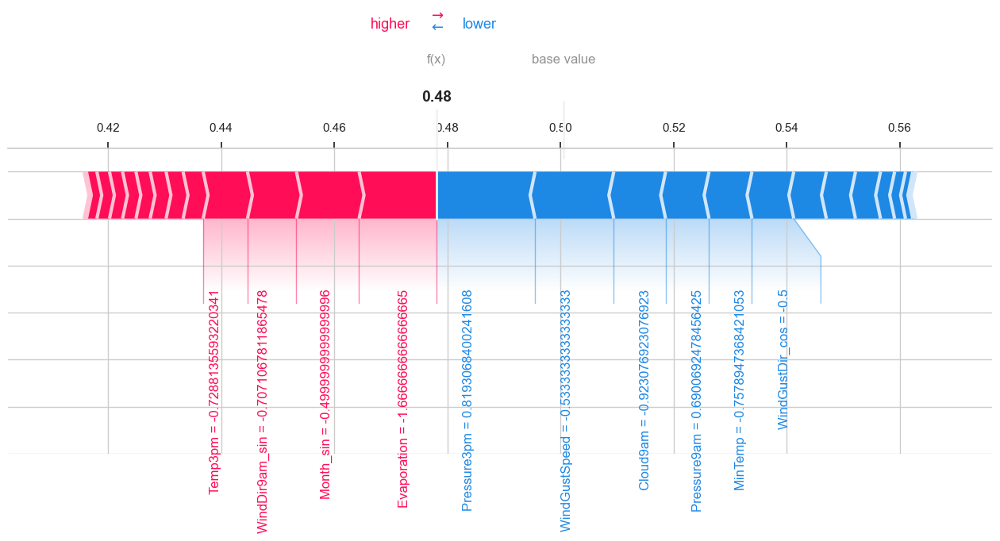

In [91]:
expected_value = np.mean(nn.predict(X_test_escalado))

shap.force_plot(expected_value, shap_values[index].values, X_test_escalado[index], feature_names=feature_names,matplotlib=True, figsize=(16, 5), text_rotation=90)

El gráfico de fuerza muestra cómo cada característica (feature, variable del modelo) contriuye a la predicción de una instancia específica, en este caso a la que tiene índice 0. Las barras de color magenta son las características que empujan la predicción hacia un valor más alto, que en este caso representarían una predicción de 'Yes' (día lluvioso). Las barras azules, por el contrario, son las características que empujan la predicción hacia un valor más bajo, es decir, un 'No' (día no lluvioso).

Se observa que la suma de las barras azules es mayor a la suma de las barras rojas, siendo la característica 'Humidity3pm' la que empuja la predicción más hacia la predicción 'No'. Siendo así, la predicción sobre esta instancia se inclina a ser la de un día no lluvioso, presentándose el valor final sobre la barra negra.

Se realiza un gráfico cascada (Waterfall Plot) sobre uno de los registros.

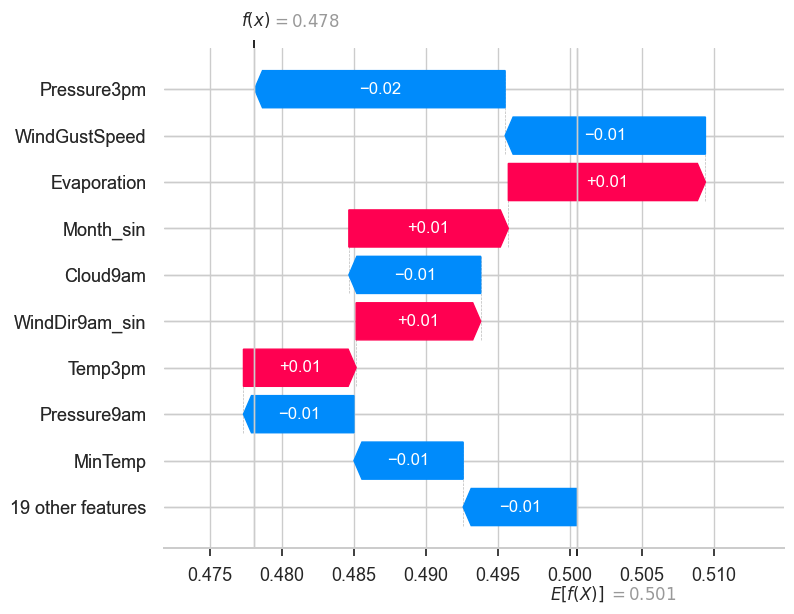

In [92]:
# Waterfall
explanation = shap.Explanation(values=shap_values[index].values,
                               base_values=expected_value,
                               feature_names=feature_names)
shap.plots.waterfall(explanation)

El gráfico de cascada muestra también la explicabilidad de cada característica sobre la predicción del modelo en la instancia especificada. El significado de los colores de las barras es identico al del gráfico de fuerza.

Rápidamente, se observa que 29 características poseen una explicación realmente baja sobre la predicción, acumulando tan solo un -0.01. Los aportes de las próximas 6 variables que se ecuentran por encima en el gráfico sobre la predicción es similiar en magnitud, pero son más las variables que empujan la predicción hacia un 'No'. Finalmente, la variable 'Pressure3pm' intenta llevar la predicción hacia el lado de 'Yes', pero no puede contra lo que se llevaba acumulado ni contra el peso de las variables 'Humidity3pm' y 'WindGustSpeed', que terminan de definir la explicabilidad hacia el lado de 'No'.

#### Gráficos Globales

Se realiza un gráfico de importancia de características (Feature Importance Plot).

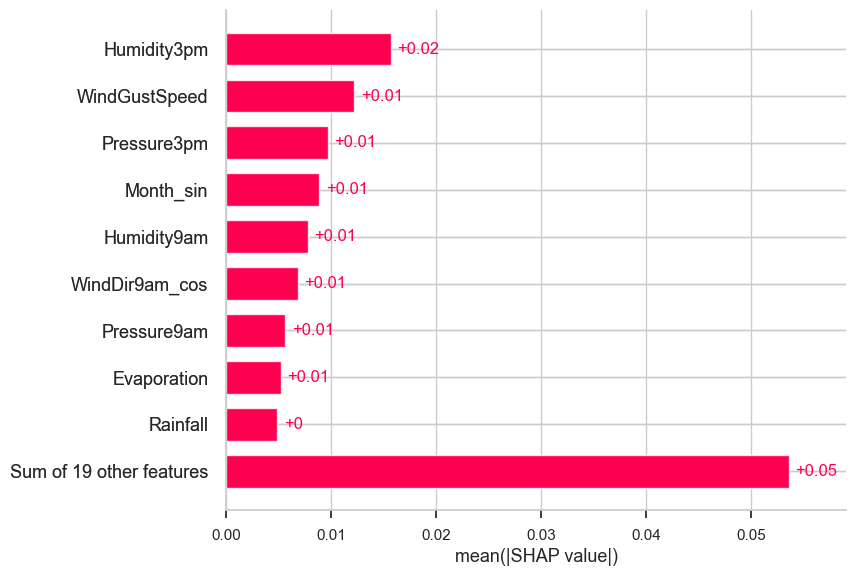

In [78]:
# Feature Importance
shap.plots.bar(shap_values)

El gráfico de barras anterior muestra las medias de los valores SHAP de cada característica y las ordena de mayor a menor.

Son 29 las características que sumadas explican casi el 44% del resultado de la predicción en promedio en el total de los datos. Sin embargo, se destaca la importancia de la variable 'Pressure3pm' en la explicabilidad de las predicciones globales, siendo en promedio del 23%. Otras variables que también tienen una relevancia muy alta en las predicciones son 'Humidity3pm', 'Pressure9am' y 'WindGustSpeed, con un 17%, 15% y 12% de explicabilidad promedio en los datos globales.

Se realiza un gráfico de enjambre de abejas (Bee Swarm Plot).

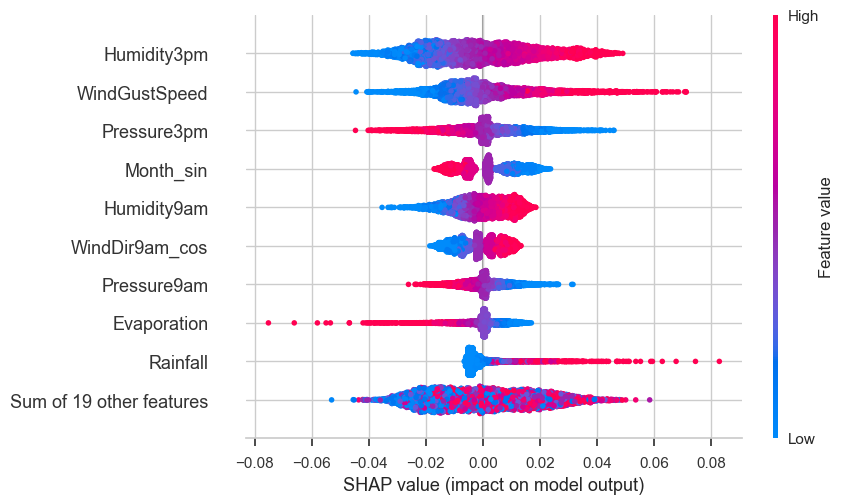

In [79]:
# Bee Swarm
shap.plots.beeswarm(shap_values)

El gráfico de enjambre de abejas muestra de cada característica los valores SHAP y los valores crudos de cada punto. Las características se ordenan de arriba hacia abajo, yendo de las que tienen mayor explicabilidad global promedio sobre las predicciones hacia las que tienen una menor. Los puntos que tienden al color rojo poseen valores crudos más altos, mientras que los puntos que tienden al color azul poseen valores crudos más bajos. Por otro lado, los puntos que se encuentran hacia la izquierda del eje central poseen valores SHAP negativos y los que se encuentran hacia la derecha del eje central poseen valores SHAP positivos.

Se interpretan algunos casos interesantes:
* La variable 'Pressure3pm' tiene una distribución de valores SHAP muy uniforme, donde los valores más bajos son las que tienen un SHAP más alto y visceversa. Esto se interpreta como que una baja presión a las 3 P.M. empuja la predicción hacia un día lluvioso y lo contrario para una alta presión. También se observa una alta concentración de puntos cerca del valor SHAP cero, indicando que muchos de los datos no influyen sobre la predicción.
* La variable 'Pressure9am' posee un comportamiento similar al caso anterior, con la excepción que en este caso los niveles alto de presión empujan la predicción hacia un día lluvioso y visceversa, presentando una explicación casi inversa que el caso anterior sobre las predicciones.
* La variable 'RainToday' tiene alta concentración de puntos en sus dos extremos, siendo el extremo izquierdo el que tiene mayor concentración. Del gráfico se podría interpretar que si el día de hoy no es lluvioso, la variable empujará la predicción hacia un día no lluvioso también. Lo contrario ocurre cuando la variable habla de que el día actual es lluvioso, sin embargo hay una concentración mejor. Esto quizá hable de que no siempre un día lluvioso en el día actual lleve a predecir un día lluvioso al día siguiente.
* La variable 'WindGustSpeed' muestra una alta concentración de puntos en torno a un valor de SHAP igual a 0, lo que indica que su explicación es relativamente baja sobre las predicciones en la mayoría de los casos. Por otro lado, los valores más altos de velocidad de viento tienden a empujar la predicción hacia un día lluvioso y lo contrario para velocidades de viento bajas.